# Encrypting audio into the videos frames and decoding the video back to original state using SNNs

Due to computational power the video has been cropped to one second.

In [1]:
#Downloading pydub
!pip install pip -U
!pip install pydub


Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 31.2 MB/s eta 0:00:00
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: python3 -m pip install --upgrade pip
Defaulting to user installation because normal site-packages is not writeable


In [36]:
#Importing Libraries
import sys
#accessing where pydub is kept within the container
sys.path.append('/home/ntu-user/.local/lib/python3.10/site-packages')

import nest
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
from IPython.display import display, clear_output
from tqdm import tqdm
import time
from pydub import AudioSegment
import io
from scipy.io import wavfile
import random

Press q to stop the video


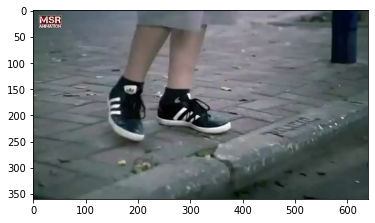

press q to stop q


Video stopped


In [148]:
#Loading video and saving all frames
cap = cv2.VideoCapture('COMP40731_video.mp4')

#Create error message if video cannot be opened
if not cap.isOpened():
    print('Error, unable to open video')
else:
    #Message to tell user how to stop video
    print('Press q to stop the video')

    #frame number
    frame_count = 0
    #folder to store frames
    folder = 'frames'
    os.makedirs(folder, exist_ok=True)
    
    while True:
        ret, frame = cap.read()
    
        #If video has finished breaks
        if not ret:
            break
    
        #transforming video into original colour
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        #writing frames into folder
        file_name = os.path.join(folder, f'frame_{frame_count}.png')
        cv2.imwrite(file_name, frame_rgb)

        frame_count+=1
        
        #showing video
        plt.imshow(frame_rgb)
        plt.show()
    
        #Stopping video if q is pressed
        user_input = input('press q to stop')
        if user_input == 'q':
            print('Video stopped')
            break
        clear_output(wait=True)

    cap.release()

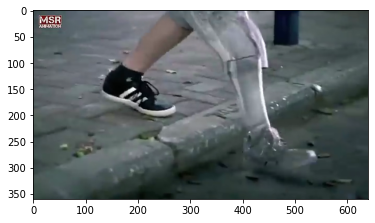

press q to stop q


Video stopped


In [150]:
#Loading video and saving frames between 14 & 15 seconds
cap = cv2.VideoCapture('COMP40731_video.mp4')

#Create error message if video cannot be opened
if not cap.isOpened():
    print('Error, unable to open video')
else:
    #Message to tell user how to stop video
    print('Press q to stop the video')

    fps = cap.get(cv2.CAP_PROP_FPS)
    #frame number
    frame_count = fps*14
    #folder to store frames between 14&15s
    folder = 'frames_between_14_and_15'
    os.makedirs(folder, exist_ok=True)
    
    while True:
        ret, frame = cap.read()

        
    
        #If video has finished breaks
        if not ret:
            break

        #Cropping frame betweent 14 & 15
        if (14*fps) <= frame_count and frame_count <= (15*fps):
    
            #transforming video into original colour
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
            #writing frames into folder
            file_name = os.path.join(folder, f'frame_{frame_count}.png')
            cv2.imwrite(file_name, frame_rgb)
    
            
            #showing video
            plt.imshow(frame_rgb)
            plt.show()

        #stopping after 15s
        if frame_count > fps*15:
            break
        
        frame_count+=1
    
        #Stopping video if q is pressed
        user_input = input('press q to stop')
        if user_input == 'q':
            print('Video stopped')
            break
        clear_output(wait=True)

    cap.release()

In [37]:
#Reading audio
def read_mp4(filename):
    sound = AudioSegment.from_file(filename, format='mp4')
    #Changing size so computer can handle
    sound = sound.set_frame_rate(16000)
    with io.BytesIO() as wav_data:
        sound.export(wav_data, format="wav")
        wav_data.seek(0)
        rate, data = wavfile.read(wav_data)
    return rate, data

#Saving audio from video
sample_rate, audio = read_mp4('COMP40731_video.mp4')

In [38]:
#Analysis of audio
print(f'The videos length is {len(audio)/sample_rate} seconds')
print(f'The sample rate is {sample_rate}')

#Trimming audio to 14-15s
trimmed_audio = audio[14*sample_rate:15*sample_rate]
check = len(trimmed_audio)/sample_rate
print(f'The length of the video is now {check} second')
print('Dimensions: ',trimmed_audio.shape)
print('Minimum: ', np.min(trimmed_audio))
print('Maximum: ', np.max(trimmed_audio))


The videos length is 29.74475 seconds
The sample rate is 16000
The length of the video is now 1.0 second
Dimensions:  (16000, 2)
Minimum:  -7281
Maximum:  6562


In [153]:
images_folder = "frames_between_14_and_15/"
image_extension = ".png"
image_files = 'frame_'
target_size = (120, 160)
colours = ['Red', 'Green', 'Blue']

#Reading frame and reducing to each colour
def reading_frames(number, colour):
    image_path = os.path.join(images_folder, image_files+str(number)+image_extension) 
    try:
        image = cv2.imread(image_path, cv2.COLOR_BGR2RGB)
        if image is None:
            raise FileNotFoundError(f"Error: Could not read image file: {image_path}")
        image = cv2.resize(image, (target_size[1], target_size[0]))
        test_vector = image[:,:,colour]
        print(f"\nProcessing image: {number}:{colours[colour]}")
        return image, test_vector
    except FileNotFoundError as e:
        print(e)
    except Exception as e:
        print(f"An error occurred while processing {number}: {e}")

The code below simulates a single neuron's spiking behavior in response to varying current intensities using the NEST simulator. It aims to find 256 unique spiking patterns (a pattern for each pixel) by incrementally increasing the input current. For each current value, it records the spike times, stores them as a unique pattern, and saves the corresponding current intensity. Finally, it visualizes the found unique spiking patterns against their pattern indices, and saves the results.

Progress: 0.00% ...
Progress: 10.94% ...
Progress: 21.88% ...
Progress: 32.81% ...
Progress: 43.75% ...
Progress: 54.69% ...
Progress: 65.62% ...
Progress: 76.56% ...
Progress: 87.50% ...
Progress: 98.44% ...
✅ Unique spiking patterns and currents saved successfully!


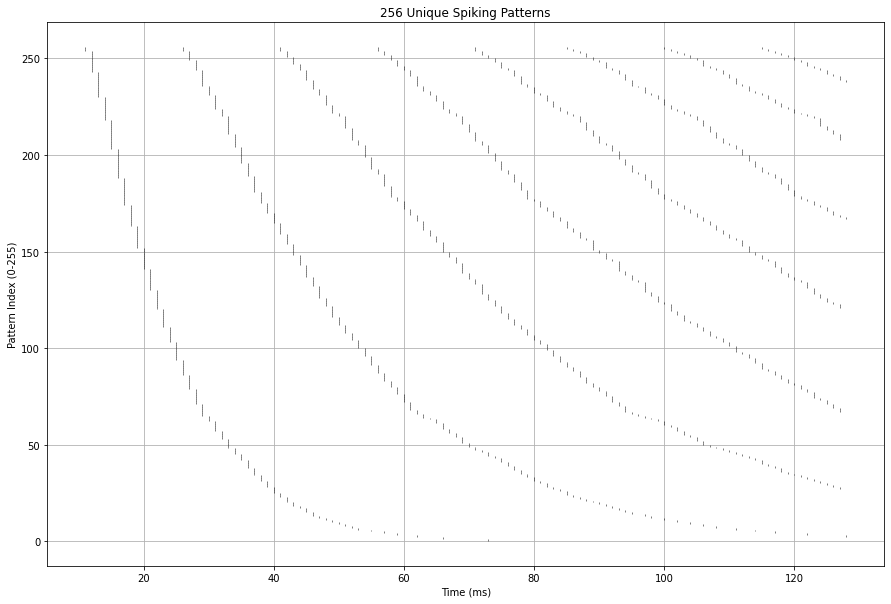

In [156]:
#Unique Spiking pattern for image

# Jupyter-specific setting for inline plots
%matplotlib inline

results_frames = "results_frames"
sim_length = 128  # for optimization, the simulation time must be a multiple of 8
num_patterns = 256
current_base_intensity = 350
max_current_intensity = 5000

pat = 0
sim_time = sim_length  # Simulation duration

# Initialize storage structures
currents_vector_for_frame = np.zeros(num_patterns, dtype=np.float32)  # Store currents for each pattern
unique_patterns_dict_for_frame = {}  # Dictionary to store unique patterns (indexed 0-255)

intensity = current_base_intensity  # Start from current base

# Ensure results directory exists
if not os.path.exists(results_frames):
    os.makedirs(results_frames)

# Loop until we find 256 unique patterns
while pat < num_patterns:
    # Simulate spike pattern for current intensity
    nest.ResetKernel()
    nest.set_verbosity("M_WARNING")

    neuron = nest.Create('iaf_psc_alpha')
    spikerecorder = nest.Create("spike_recorder")
    nest.Connect(neuron, spikerecorder)

    current = intensity
    nest.SetStatus(neuron, {"I_e": current, "V_th": -10.,"V_reset":-80})  # Set neuron parameters
    nest.Simulate(sim_time)

    events = spikerecorder.get("events")

    times = events["times"].astype(int)

    # Create a pattern key from the spike times
    pattern_key = tuple(times)  # Create a unique pattern from the spike times

    # Store only if the pattern is unique
    if len(pattern_key) > 0 and pattern_key not in unique_patterns_dict_for_frame.values():
        unique_patterns_dict_for_frame[pat] = pattern_key  # Store pattern with key from 0-255
        currents_vector_for_frame[pat] = current  # Store corresponding current

        # Progress tracking
        if pat % (num_patterns // 9) == 0:
            print(f"Progress: {pat / num_patterns * 100:.2f}% ...")
        pat += 1  # Move to next unique pattern

    if intensity + 1 < max_current_intensity:
        intensity += 1  # Increment intensity for next check
    else:
        print(f"Reached index {pat}")
        raise ValueError("Max current intensity reached. Increase simulation time or modify the number of patterns.")

# Save results
np.save(os.path.join(results_dir, "currents_vector_for_frame.npy"), currents_vector_for_frame)
np.save(os.path.join(results_dir, "unique_spiking_patterns_for_frame.npy"), unique_patterns_dict_for_frame)

print("✅ Unique spiking patterns and currents saved successfully!")

# Plot the spiking patterns
plt.figure(figsize=(15, 10))
for pat, pattern in unique_patterns_dict_for_frame.items():
    times = pattern if pattern else []
    if len(times) > 0:
        plt.vlines(times, pat, pat + 1, color='black', linewidth=0.5)  # Adjust pattern indexing for plotting

plt.xlabel('Time (ms)')
plt.ylabel('Pattern Index (0-255)')  # Updated label for clarity
plt.title(f'{num_patterns} Unique Spiking Patterns')
plt.grid(True)

# Save the figure to the results folder
plt.savefig(os.path.join(results_dir, "spiking_patterns_plot_for_frames.png"))
plt.show()


The code below uses temporal encoding to simulate a single neuron's spiking activity using the NEST simulator to generate 10 unique spiking patterns. As audio ranges between -99999 and 99999, 10 spiking patterns is enough to place each number within the audio into a pattern. It iteratively increases the input current, records the resulting spike times, and stores them as unique patterns. The code ensures that only distinct patterns are saved, along with their corresponding current intensities. Finally, it visualizes these unique spiking patterns against their pattern indices and saves the results to files.

Progress: 0.00% ...
Progress: 10.00% ...
Progress: 20.00% ...
Progress: 30.00% ...
Progress: 40.00% ...
Progress: 50.00% ...
Progress: 60.00% ...
Progress: 70.00% ...
Progress: 80.00% ...
Progress: 90.00% ...
Currents vector:
[1501. 1502. 1503. 1504. 1505. 1506. 1507. 1508. 1509. 1510.]
Unique spiking patterns:
{0: (73,), 1: (66,), 2: (62, 128), 3: (59, 122), 4: (57, 117), 5: (55, 114), 6: (53, 111), 7: (52, 108), 8: (51, 106), 9: (50, 104)}
Unique spiking patterns and currents saved successfully!


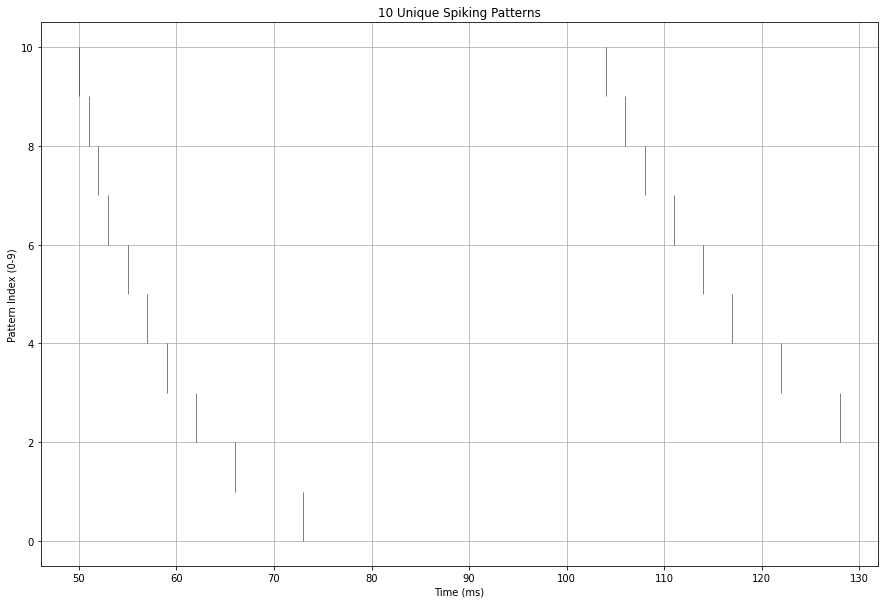

In [157]:
# Jupyter-specific setting for inline plots
%matplotlib inline

# Paths
results_audio = "results_audio"
sim_length = 128  # for optimisation, the simulation time must be a multiple of 8
num_patterns = 10  #
current_base_intensity = 340
max_current_intensity = 2900

"""Generates 10 different spiking patterns and currents, resetting per iteration."""

pat = 0
sim_time = sim_length  # Simulation duration

# Initialize storage structures
currents_vector = np.zeros(num_patterns, dtype=np.float32)  # Store currents for each pattern
unique_patterns_dict = {}  # Dictionary to store unique patterns (indexed 0-9)

current = current_base_intensity  # Start from current base

# Ensure results directory exists
if not os.path.exists(results_audio):
    os.makedirs(results_audio)

# Loop until we find 10 unique patterns
while pat < num_patterns:
    # Simulate spike pattern for current intensity
    nest.ResetKernel()
    nest.set_verbosity("M_WARNING")

    neuron = nest.Create('iaf_psc_alpha', params={"V_th": -10., "V_reset": -80})
    spikerecorder = nest.Create("spike_recorder")
    nest.Connect(neuron, spikerecorder)

    current +=1
    nest.SetStatus(neuron, {"I_e": current})  # Set neuron parameters
    nest.Simulate(sim_time)

    events = spikerecorder.get("events")

    times = events["times"].astype(int)

    # Create a pattern key from the spike times
    pattern_key = tuple(times)  # Create a unique pattern from the spike times

    # Store only if the pattern is unique
    if len(pattern_key) > 0 and pattern_key not in unique_patterns_dict.values():
        unique_patterns_dict[pat] = pattern_key  # Store pattern with key from 0-9
        currents_vector[pat] = current  # Store corresponding current

        # Progress tracking
        if pat % (num_patterns // 10) == 0:
            print(f"Progress: {pat / num_patterns * 100:.2f}% ...")
        pat += 1  # Move to next unique pattern
    if current > max_current_intensity:
        print(f"Reached index {pat}")
        raise ValueError("Max current intensity reached. Increase simulation time or modify the number of patterns.")

# Save results
print(f"Currents vector:\n{currents_vector}")
np.save(os.path.join(results_audio, "currents_vector.npy"), currents_vector)
print(f"Unique spiking patterns:\n{unique_patterns_dict}")
np.save(os.path.join(results_audio, "unique_spiking_patterns.npy"), unique_patterns_dict)

print("Unique spiking patterns and currents saved successfully!")

# Plot the spiking patterns
plt.figure(figsize=(15, 10))
for pat, pattern in unique_patterns_dict.items():
    times = pattern if pattern else []
    if len(times) > 0:
        plt.vlines(times, pat, pat + 1, color='black', linewidth=0.5)  # Adjust pattern indexing for plotting

plt.xlabel('Time (ms)')
plt.ylabel('Pattern Index (0-9)')  # Updated label for clarity
plt.title(f'{num_patterns} Unique Spiking Patterns')
plt.grid(True)

# Save the figure to the results folder
plt.savefig(os.path.join(results_dir, "spiking_patterns_plot.png"))
plt.show()

The below code seperates the left and right channels for the audio between 14 and 15 seconds and visualises each channels audio.

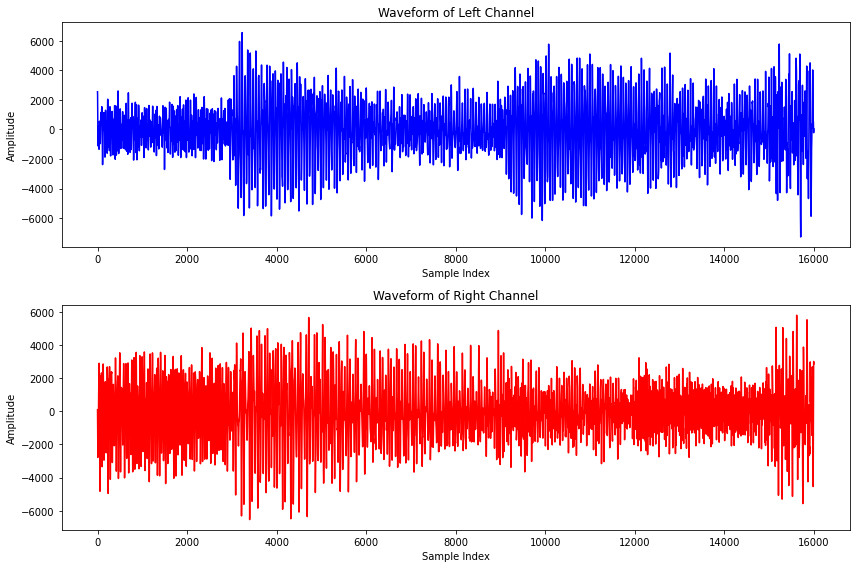

In [39]:
results_audio='results_audio'

# Ensure the results directory exists
os.makedirs(results_audio, exist_ok=True)

# Check if the audio is stereo
if trimmed_audio.ndim > 1 and trimmed_audio.shape[1] == 2:
    left, right = trimmed_audio[:, 0], trimmed_audio[:, 1]
else:
    left, right = trimmed_audio, trimmed_audio # if mono, assign data to both left and right

# Save the data to NumPy files in the results directory
np.save(os.path.join(results_audio, 'data_left.npy'), left)
np.save(os.path.join(results_audio, 'data_right.npy'), right)
np.save(os.path.join(results_audio, 'rate.npy'), sample_rate)

# Plot the data with separate left and right channels
plt.figure(figsize=(12, 8))

plt.subplot(2, 1, 1)
plt.plot(left, color='blue')
plt.title('Waveform of Left Channel')
plt.xlabel('Sample Index')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.plot(right, color='red')
plt.title('Waveform of Right Channel')
plt.xlabel('Sample Index')
plt.ylabel('Amplitude')

plt.tight_layout()
plt.show()

The code below loads the unique 10 spiking patterns and currents previously found. It then defines a neuron encoding scheme, mapping numerical ranges to specific spiking patterns. Where if the audio is negative neuron fives value is 0 and 1 if positive. A function encode_value translates numerical inputs into these patterns. It generates test values, encodes them, and visualizes the resulting spiking patterns for each neuron in raster plots.

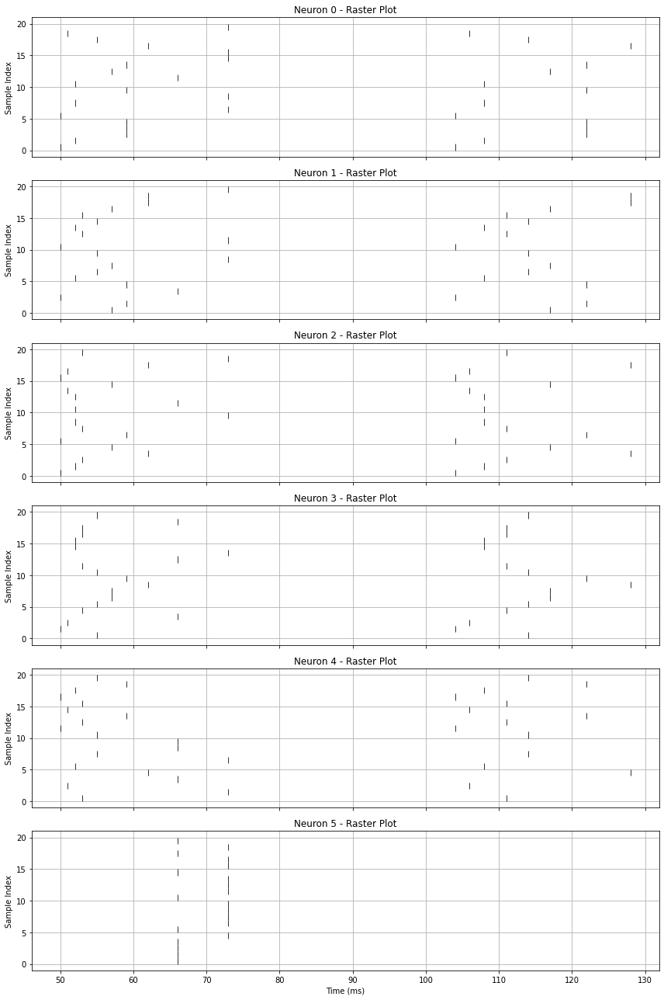

In [159]:
# Load saved spiking patterns and current vectors
currents_vector = np.load(os.path.join(results_audio, "currents_vector.npy"), allow_pickle=True)
unique_patterns_dict = np.load(os.path.join(results_audio, "unique_spiking_patterns.npy"), allow_pickle=True).item()

# Define the neuron encoding scheme
neuron_encoding = {
    0: {"range": range(0, 10), "step": 1},  # [0,1,2,3,...,9]
    1: {"range": range(0, 100, 10), "step": 10},  # [0,10,20,...,90]
    2: {"range": range(0, 1000, 100), "step": 100},  # [0,100,200,...,900]
    3: {"range": range(0, 10000, 1000), "step": 1000},  # [0,1000,2000,...,9000]
    4: {"range": range(0, 100000, 10000), "step": 10000},  # [0,10000,20000,...,90000]
    5: {"range": [0, 1], "step": None},  # Binary representation: -1 → pattern 0, 1 → pattern 1
}

# Function to encode a given value into a spiking pattern
def encode_value(neuron, value):
    if neuron not in neuron_encoding:
        raise ValueError("Invalid neuron index")

    encoding_info = neuron_encoding[neuron]

    if neuron == 5:
        # Neuron 5: Special case, only 0 and 1
        if value == 0:
            return unique_patterns_dict[0]  # First pattern for 0
        elif value == 1:
            return unique_patterns_dict[1]  # Second pattern for 1
        else:
            raise ValueError(f"Invalid value for Neuron 5: {value}. Only 0 and 1 allowed.")

    # Standard neurons (0 to 4)
    if value not in encoding_info["range"]:
        raise ValueError(f"Invalid value {value} for Neuron {neuron}. Must be in {list(encoding_info['range'])}.")

    index = value // encoding_info["step"] if encoding_info["step"] else 0
    return unique_patterns_dict[index]

# Generate 20 random test values for each neuron
test_values = {neuron: random.choices(list(neuron_encoding[neuron]["range"]), k=20) for neuron in neuron_encoding}

# Encode the test values
encoded_patterns = {
    neuron: [encode_value(neuron, value) for value in values]
    for neuron, values in test_values.items()
}

# Plot raster plots for each neuron
fig, axes = plt.subplots(6, 1, figsize=(12, 18), sharex=True)

for neuron, ax in zip(encoded_patterns.keys(), axes):
    ax.set_title(f"Neuron {neuron} - Raster Plot")

    for i, pattern in enumerate(encoded_patterns[neuron]):
        if pattern:  # Check if the pattern is not empty
            ax.vlines(pattern, i, i + 1, color="black", linewidth=0.8)

    ax.set_ylabel("Sample Index")
    ax.grid(True)

axes[-1].set_xlabel("Time (ms)")
plt.tight_layout()
plt.show()


The code below simulates a spiking neural network (SNN) that processes audio data. It loads the previously generated spiking patterns and corresponding current values, along with the audio's sample rate. For each audio channel (left and right), it initializes a NEST simulation, creates a population of neurons, and connects them to a spike recorder. The audio samples are then encoded into spiking patterns using a predefined encoding scheme, where each sample is mapped to a sequence of neuron values. These neuron values are then translated into corresponding current intensities, which are applied to the neurons. The network is simulated, and the resulting spike times and neuron IDs are recorded and saved. Finally, a raster plot visualizes the spiking activity, showing the timing of spikes for each neuron in the population.


Processing - left channel using 96000 neurons...
Initialising NEST...
Building the neural network...
Neural network built and connected. [100%]
Converting samples into currents...
Progress: 10%
Progress: 20%
Progress: 30%
Progress: 40%
Progress: 50%
Progress: 60%
Progress: 70%
Progress: 80%
Progress: 90%
Progress: 100%
Samples converted into currents. [100%]
Setting neuron currents...
Progress: 10%
Progress: 20%
Progress: 30%
Progress: 40%
Progress: 50%
Progress: 60%
Progress: 70%
Progress: 80%
Progress: 90%
Progress: 100%
Progress: 100%
Neuron currents set. [100%]
Simulating the network...
Simulation complete. [100%]
Saving spiking events...
Spiking events saved to 'spiking_events_population_left.npy'.
Plotting spike data...


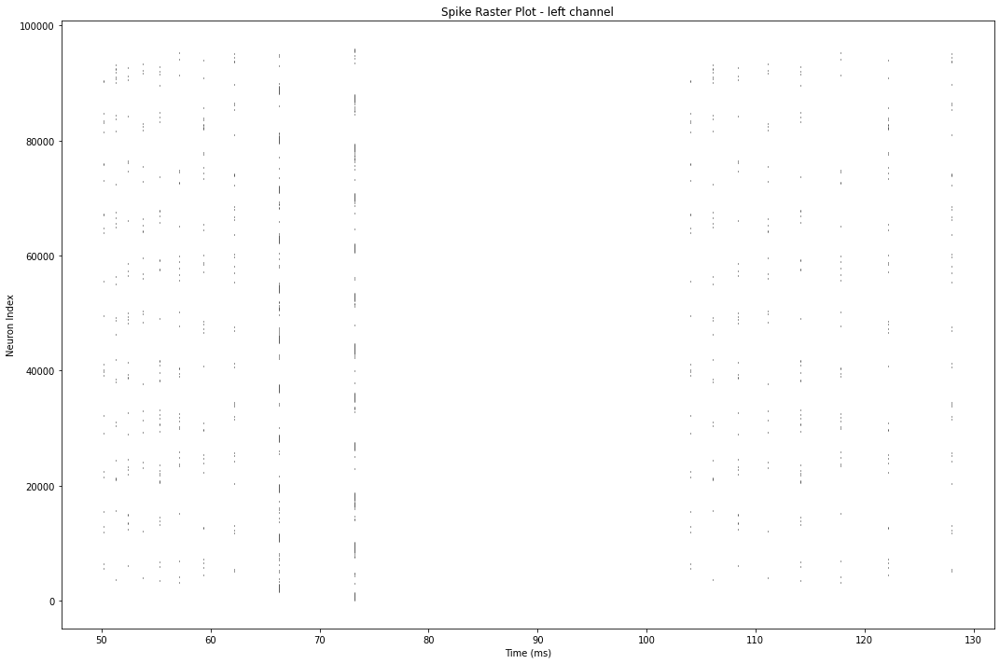

Spike data plotted. [100%]
left - SNN with 96000 neurons simulated.

Processing - right channel using 96000 neurons...
Initialising NEST...
Building the neural network...
Neural network built and connected. [100%]
Converting samples into currents...
Progress: 10%
Progress: 20%
Progress: 30%
Progress: 40%
Progress: 50%
Progress: 60%
Progress: 70%
Progress: 80%
Progress: 90%
Progress: 100%
Samples converted into currents. [100%]
Setting neuron currents...
Progress: 10%
Progress: 20%
Progress: 30%
Progress: 40%
Progress: 50%
Progress: 60%
Progress: 70%
Progress: 80%
Progress: 90%
Progress: 100%
Progress: 100%
Neuron currents set. [100%]
Simulating the network...
Simulation complete. [100%]
Saving spiking events...
Spiking events saved to 'spiking_events_population_right.npy'.
Plotting spike data...


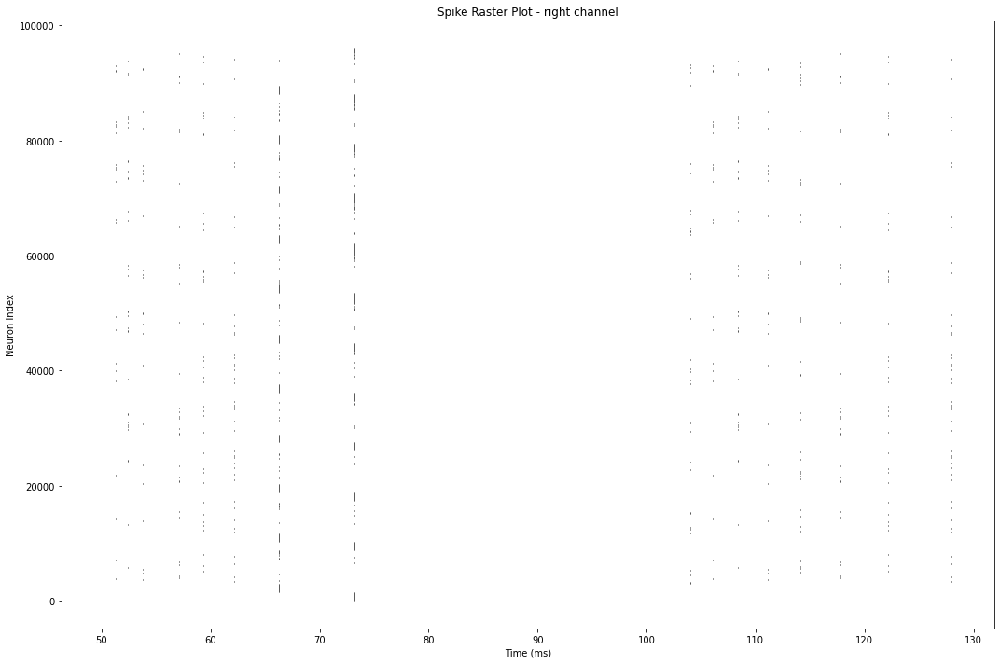

Spike data plotted. [100%]
right - SNN with 96000 neurons simulated.


In [160]:
import numpy as np
import os
import matplotlib.pyplot as plt
import nest

# Enable inline plotting for Jupyter Notebook
%matplotlib inline

# Define results directory
results_audio = "results_audio"
num_neurons_per_sample = 6
num_channels = 2
sim_length = 128

# Ensure the results directory exists
os.makedirs(results_dir, exist_ok=True)

# Load saved spiking patterns and current vectors
currents_vector = np.load(os.path.join(results_dir, "currents_vector.npy"), allow_pickle=True)
unique_patterns_dict = np.load(os.path.join(results_dir, "unique_spiking_patterns.npy"), allow_pickle=True).item()

# Load the cropped data from NumPy files
left = np.load(os.path.join(results_audio, 'data_left.npy'))
right = np.load(os.path.join(results_audio, 'data_right.npy'))


# Create the sound_data list
sound_data = [left, right]

# Define the neuron encoding scheme
neuron_encoding = {
    0: {"range": range(0, 10), "step": 1},
    1: {"range": range(0, 10), "step": 1},
    2: {"range": range(0, 10), "step": 1},
    3: {"range": range(0, 10), "step": 1},
    4: {"range": range(0, 10), "step": 1},
    5: {"range": [-1, 1], "step": None},
}

# Function to encode a given value into a spiking pattern
def encode_value(neuron, value):
    if neuron not in neuron_encoding:
        raise ValueError("Invalid neuron index")

    encoding_info = neuron_encoding[neuron]

    if neuron == 5:
        if value == 0:
            return unique_patterns_dict[0]
        elif value == 1:
            return unique_patterns_dict[1]
        else:
            raise ValueError(f"Invalid value for Neuron 5: {value}. Only 0 and 1 allowed.")

    if value not in encoding_info["range"]:
        raise ValueError(f"Invalid value {value} for Neuron {neuron}. Must be in {list(encoding_info['range'])}.")

    index = value // encoding_info["step"] if encoding_info["step"] else 0
    return unique_patterns_dict[index]

# Function to process a single test number
def process_test_number(test_number):
    # Check if the input is a valid number
    try:
        test_number = float(test_number)  # Attempt to convert to float
    except ValueError:
        return {}, []  # Return empty encoded patterns and neuron values for invalid input

    # Determine the sign
    if test_number >= 0:
        sign_neuron_value = 1
    else:
        sign_neuron_value = 0
        test_number = abs(test_number)

    # Extract digits and reverse them
    digits = [int(d) for d in str(int(test_number))][::-1] #convert to int before str.

    # Pad zeros to the LEFT to make the length 5
    while len(digits) < 5:
        digits.append(0)

    # Construct the neuron values (digits in reverse order + sign)
    neuron_values = digits + [sign_neuron_value]
    encoded_patterns = {
        neuron: encode_value(neuron, value)
        for neuron, value in enumerate(neuron_values)
    }

    return encoded_patterns, neuron_values

# Load data from NumPy files
rate = np.load(os.path.join(results_audio, "rate.npy"))

# Define neuron populations
num_neurons_per_population = num_neurons_per_sample * rate
channels = ["left", "right"]

for idx in range(len(channels)):  # Left and right channels
    print(f"\nProcessing - {channels[idx]} channel using {num_neurons_per_population} neurons...")
    # Initialize NEST
    print("Initialising NEST...")
    nest.ResetKernel()
    nest.set_verbosity("M_WARNING")
    
    # Build the neural network
    print("Building the neural network...")
    neurons = nest.Create("iaf_psc_alpha", num_neurons_per_population, params={"V_th": -10., "V_reset": -80.})
    spike_recorder = nest.Create("spike_recorder")
    
    # Connect neurons to spike recorder
    nest.Connect(neurons, spike_recorder)
    print("Neural network built and connected. [100%]")
    
    # Encode test numbers
    print("Converting samples into currents...")
    samples = sound_data[idx]
    all_encoded_patterns = []
    all_neuron_values = []
    total_samples = len(samples)
    processed_samples = 0
    progress_interval = 10  # Show progress every 10%
    next_progress_threshold = progress_interval  # Initialize the next threshold
    for num in samples:
        encoded_patterns, neuron_values = process_test_number(num)
        all_encoded_patterns.append(encoded_patterns)
        all_neuron_values.append(neuron_values)
        processed_samples += 1
        progress = (processed_samples / total_samples) * 100

        # Show progress every 10%
        if progress >= next_progress_threshold:
            print(f"Progress: {next_progress_threshold}%")
            next_progress_threshold += progress_interval
    print("Samples converted into currents. [100%]")
    
    # Set neuron currents based on encoded patterns
    print("Setting neuron currents...")
    neuron_index = 0
    total_neurons = len(all_neuron_values) * len(all_neuron_values[0])
    progress_interval = 10  # Show progress every 10%
    next_progress_threshold = progress_interval  # Initialize the next threshold

    for test_pattern in all_neuron_values:
        for i in range(len(test_pattern)):
            if i < 5:
                nest.SetStatus(neurons[neuron_index], {"I_e": currents_vector[test_pattern[i]]})
            else:
                if test_pattern[i] == -1:
                    nest.SetStatus(neurons[neuron_index], {"I_e": currents_vector[0]})
                else:
                    nest.SetStatus(neurons[neuron_index], {"I_e": currents_vector[1]})
            neuron_index += 1
            progress = (neuron_index / total_neurons) * 100

            # Show progress every 10%
            if progress >= next_progress_threshold:
                print(f"Progress: {next_progress_threshold}%")
                next_progress_threshold += progress_interval
        
    print("Progress: 100%")
    print("Neuron currents set. [100%]")
    
    # Simulate the network
    print("Simulating the network...")
    nest.Simulate(sim_length)
    print("Simulation complete. [100%]")
    
    # Retrieve and save spiking events
    print("Saving spiking events...")
    events = nest.GetStatus(spike_recorder, "events")[0]
    spike_times = events["times"]
    spike_senders = events["senders"]
    
    # Save spike times and senders to a .npy file
    spiking_events = {"times": spike_times, "senders": spike_senders}
    np.save(os.path.join(results_audio, f"spiking_events_population_{channels[idx]}.npy"), spiking_events)
    print(f"Spiking events saved to 'spiking_events_population_{channels[idx]}.npy'.")
    
    # Plot spike data
    print("Plotting spike data...")
    plt.figure(figsize=(15, 10))
    plt.vlines(spike_times, spike_senders, spike_senders + 1, color="black", linewidth=0.8)
    plt.title(f"Spike Raster Plot - {channels[idx]} channel")
    plt.xlabel("Time (ms)")
    plt.ylabel("Neuron Index")
    plt.tight_layout()
    plt.savefig(os.path.join(results_audio, f"neuron_population_{channels[idx]}_spikes.png"))  # Save figure
    plt.show()
    print("Spike data plotted. [100%]")
    
    total_neurons = num_neurons_per_population
    print(f"{channels[idx]} - SNN with {total_neurons} neurons simulated.")

The code below defines a function process_samples that takes a list of numerical samples as input. It iterates through each sample, determines its sign, and extracts its digits, padding them with zeros to ensure a length of 5. This is so each digit is in the format of between -99999 and 99999. It then creates a neuron_value list by reversing the digits and appending the sign. For each digit and the sign, it encodes the value into a spiking pattern using the encode_value function and stores it in the encoded_patterns dictionary. Finally, it returns the encoded_patterns and neuron_values, which represent the spiking pattern encodings and the numerical representation for each sample.

In [161]:
# Function to process multiple numbers
def process_samples(samples):
    encoded_patterns = {}
    neuron_values = []
    for num in samples:
        # Check if the input is a valid number
        try:
            num = float(num)  # Attempt to convert to float
        except ValueError:
            return {}, []  # Return empty encoded patterns and neuron values for invalid input
    
        # Determine the sign
        if num >= 0:
            sign_neuron_value = 1
        else:
            sign_neuron_value = 0
            num = abs(num)
    
        # Extract digits and reverse them
        digits = [int(d) for d in str(int(num))][::-1] #convert to int before str.
    
        # Pad zeros to the LEFT to make the length 5
        while len(digits) < 5:
            digits.append(0)
    
        # Construct the neuron values (digits in reverse order + sign)
        neuron_value = digits + [sign_neuron_value]
        
        neuron_values.append(neuron_value)
        for neuron, value in enumerate(neuron_value):
            if neuron in encoded_patterns:
                encoded_patterns[neuron].append(encode_value(neuron, value))
            else:
                encoded_patterns[neuron] = [encode_value(neuron, value)]
        
    return encoded_patterns, neuron_values


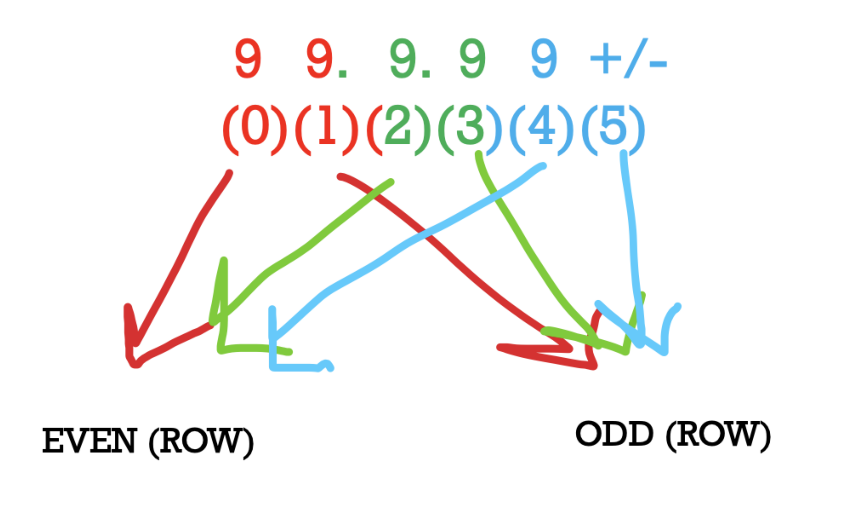

In [162]:
#Loading proposed method for audio embedding
plt.figure(figsize=(15,15))
image = cv2.imread('Order.png')
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.axis(False)
plt.imshow(image_rgb)
plt.show()

To hide the audio within each frame the audio will be divided by the amount of frames so the audio matches the correct timing of the frames. The image will be divided into a left and right side where the left audio will be on the left half of the image and the right side with the right audio. 

Red frames will contain the ten thousandths and thousandths, green frames will contain the hundreths and tenths and blue will contain units and the sign.

For selected pixels to hide the audio those which are on an even row within the image will hide ten thousandths, hundreths and units and odd rows will contain thousandths, tenths and the sign.


The code below aims to embed the audio information for the green frame of an image to check the embedding is correct. Therefore, in this test only the tenths and hundreths are being embedded. The code begins by creating a function which removes all pixels between 0-9 and mapping them to 10. The samples of audio for the first frame is found and passed through the function process_samples to put the audio into the correct format. Then from the format the hundreths and tenths are extracted. by loading an image frame and a segment of audio data. The audio data is processed, extracting pairs of digits for embedding. The image's pixel values are then manipulated: pixels with a value of 10 are prioritized, and remaining pixels are sorted by their value. A subset of these pixels is selected to hold the audio data. The extracted digit pairs from the audio are then sequentially embedded into the selected pixels, with the first digit of each pair (hundreths) being placed in pixels where the row index is even, and the second digit (tenths) in pixels where the row index is odd. Finally, the code prints a few examples of the modified pixels and their embedded values to verify the embedding process.

In [163]:
#Checking one frame

#Function which maps any pixels between 0-9 to 10
def map_to_10_levels(image):

    """Maps pixel values 0-9 to 10 levels (0-255)."""
    #mapped_image = np.where(image <= 9, 10, image)
    mapped_image = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            if image[i,j] <= 9:
                mapped_image[i,j]=10
            else:
                mapped_image[i,j]=image[i,j]
    return mapped_image.astype(np.uint8)

#Loading green image
image, test_vector = reading_frames(float(420), 1)

#Size of audio per frame
size = sample_rate//30

samples = left
samples = samples[:size]
encoded, values = process_samples(samples)

#Making values into a list
#Just testing Green channel
val=[]
for i in values:
    i=i[2:4]
    val.append(i)


num_values = int(2*(sample_rate/30)*6)

mapped_image = map_to_10_levels(test_vector)

total_pixels = test_vector.size

# Initialize the list of candidate pixels
candidate_pixels = []

# Start with pixels of value 10
pixels_10 = np.where(test_vector == 10)
pixels_10_indices = list(zip(pixels_10[0], pixels_10[1]))
pixels_10_indices.sort()  # Sort by row index, then column index
candidate_pixels.extend(pixels_10_indices)

# Create a list of unique pixel values in the image (excluding value 10)
unique_values = np.unique(test_vector)
unique_values = unique_values[unique_values != 10]  # Exclude value 10
unique_values.sort()  # Sort from lowest to highest


# If we still need more pixels, find the next lowest values
if len(candidate_pixels) < num_values:
    # Iterate through the sorted unique values and add their pixels to the candidate list
    for value in unique_values:
        if len(candidate_pixels) >= num_values:
            break  # Stop if we have enough candidates

        # Find pixels with the current value
        value_pixels = np.where(test_vector == value)
        value_pixels_indices = list(zip(value_pixels[0], value_pixels[1]))
        value_pixels_indices.sort()  # Sort by row index, then column index
        candidate_pixels.extend(value_pixels_indices)

# Select the first num_values pixels from the sorted candidate list
selected_pixels = candidate_pixels[:num_values]

# Encode random values into the selected pixels
encoded_image = test_vector.copy()
modified_pixels = []
test_values=[]

count = 0
while count < len(val):
    for pixel in selected_pixels:    
        if pixel[0]%2==0:
            encoded_image[pixel] = val[count][0]
            modified_pixels.append((pixel, val[count][0]))
            test_values.append(val[count][0])
            count+=1
        if count == len(val):
            break
            
        
count = 0
while count < len(val):
    for pixel in selected_pixels:
        if pixel[0]%2!=0:
            encoded_image[pixel] = val[count][1]
            modified_pixels.append((pixel, val[count][1]))
            test_values.append(val[count][1])
            count+=1
        if count == len(val):
            break

#Checking evens that first digit in pixel is even and value is first number in values
for index, (pixel, value) in enumerate(modified_pixels[0:5]):
    print(pixel, value, '-----', selected_pixels[0:3], '---', val[0:5])
print()
#Checking odds that first digit in pixel is odd and value is second number in values
for index, (pixel, value) in enumerate(modified_pixels[-5:]):
    print(pixel, value, '-----', selected_pixels[0:3], '---', val[-5:])



Processing image: 420.0:Green
(4, 151) 5 ----- [(3, 151), (4, 151), (5, 151)] --- [[5, 2], [4, 2], [3, 2], [0, 2], [6, 1]]
(6, 151) 4 ----- [(3, 151), (4, 151), (5, 151)] --- [[5, 2], [4, 2], [3, 2], [0, 2], [6, 1]]
(12, 143) 3 ----- [(3, 151), (4, 151), (5, 151)] --- [[5, 2], [4, 2], [3, 2], [0, 2], [6, 1]]
(14, 143) 0 ----- [(3, 151), (4, 151), (5, 151)] --- [[5, 2], [4, 2], [3, 2], [0, 2], [6, 1]]
(16, 143) 6 ----- [(3, 151), (4, 151), (5, 151)] --- [[5, 2], [4, 2], [3, 2], [0, 2], [6, 1]]

(117, 103) 0 ----- [(3, 151), (4, 151), (5, 151)] --- [[2, 0], [1, 0], [0, 0], [0, 0], [0, 0]]
(119, 98) 0 ----- [(3, 151), (4, 151), (5, 151)] --- [[2, 0], [1, 0], [0, 0], [0, 0], [0, 0]]
(15, 152) 0 ----- [(3, 151), (4, 151), (5, 151)] --- [[2, 0], [1, 0], [0, 0], [0, 0], [0, 0]]
(21, 152) 0 ----- [(3, 151), (4, 151), (5, 151)] --- [[2, 0], [1, 0], [0, 0], [0, 0], [0, 0]]
(29, 153) 0 ----- [(3, 151), (4, 151), (5, 151)] --- [[2, 0], [1, 0], [0, 0], [0, 0], [0, 0]]


Similar to the above code but now dividing sample rate by the frames and implementing each sample into the respective colours and side of the frame.


Processing image: 420.0:Red
Encoded audio saved to 'chunk1_encoded_Left.npy'.
Encoded audio saved to 'chunk1_neuron_values_Left.npy'.
Selected pixels saved to: encoded_results/420_Red_Left_selected_pixels.npy
[7, 4, 6, 0, 5, 1, 5, 4, 4, 2, 9, 8, 6, 4, 7, 7, 7, 5, 7, 4, 2, 3, 2, 9, 7, 8, 7, 3, 3, 7, 7, 5, 0, 5, 1, 0, 4, 4, 3, 3, 8, 4, 0, 3, 8, 9, 5, 5, 9, 2, 4, 8, 0, 7, 2, 4, 9, 4, 0, 1, 4, 0, 8, 6, 6, 4, 6, 4, 2, 5, 6, 4, 3, 2, 2, 6, 9, 9, 9, 1, 0, 8, 8, 6, 5, 4, 3, 9, 4, 3, 4, 0, 7, 9, 6, 6, 3, 1, 0, 1, 6, 7, 4, 4, 3, 4, 6, 4, 2, 1, 4, 0, 4, 0, 2, 1, 1, 6, 1, 9, 1, 6, 4, 0, 7, 9, 4, 5, 6, 7, 4, 2, 4, 3, 4, 8, 6, 9, 5, 8, 9, 5, 9, 7, 8, 3, 9, 0, 7, 9, 8, 3, 7, 4, 6, 2, 7, 5, 1, 7, 2, 5, 6, 3, 0, 6, 7, 1, 8, 8, 3, 4, 3, 0, 7, 4, 9, 2, 0, 7, 2, 1, 9, 7, 6, 1, 9, 3, 6, 5, 3, 6, 3, 1, 0, 7, 5, 2, 0, 6, 3, 4, 6, 5, 9, 3, 7, 1, 1, 2, 1, 2, 5, 6, 8, 7, 3, 2, 5, 8, 6, 3, 8, 1, 4, 5, 7, 9, 2, 2, 8, 6, 6, 7, 8, 2, 0, 5, 3, 9, 5, 7, 3, 0, 6, 9, 7, 6, 9, 8, 9, 2, 6, 1, 3, 0, 1, 8, 4, 1, 1, 0, 2, 

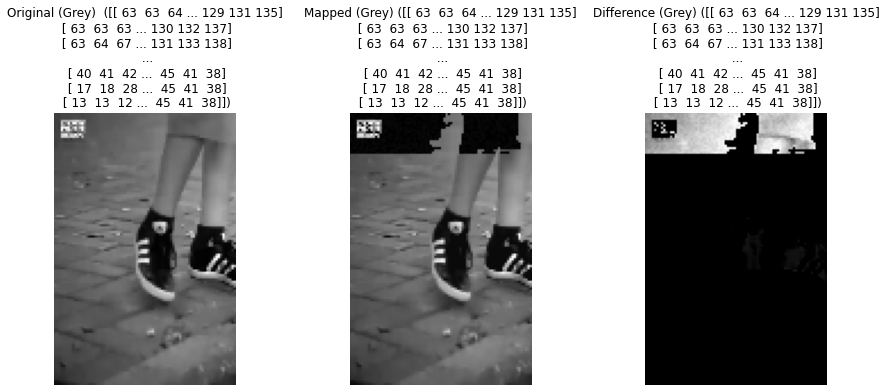

Modified Pixels for 420_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 7
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 4
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 6
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 0
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 5
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 1
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 5
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 4
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 4
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 2
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 9
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 8
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 6
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 4
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 7
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

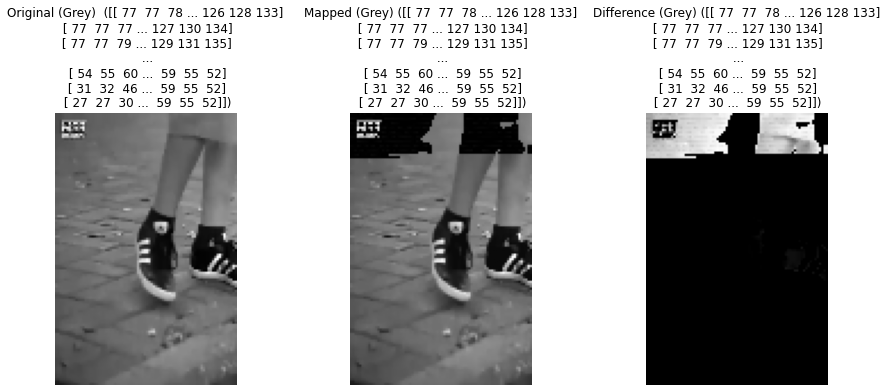

Modified Pixels for 420_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 5
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 4
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 3
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 0
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 6
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 2
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 7
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 2
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 2
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 6
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 9
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 0
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 1
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 0
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 8
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

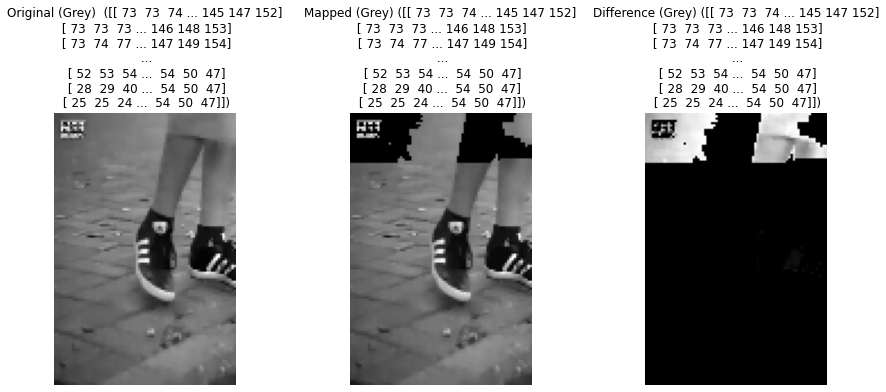

Modified Pixels for 420_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

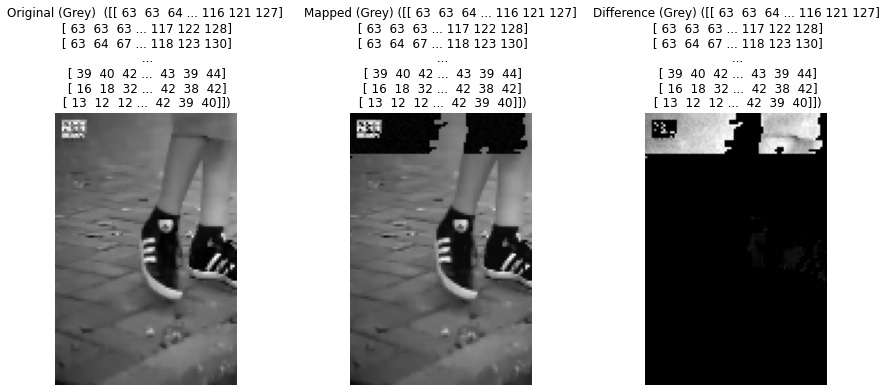

Modified Pixels for 421_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 7
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 5
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 5
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 7
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 5
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 4
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 5
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 6
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 3
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 4
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 3
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 4
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 1
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 5
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 8
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

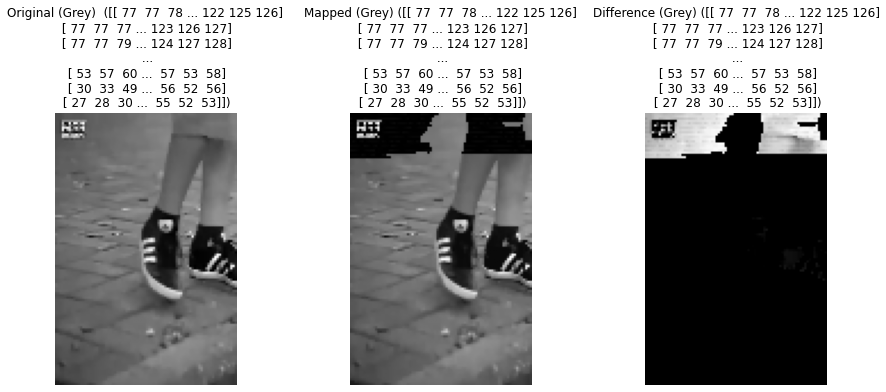

Modified Pixels for 421_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 0
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 0
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 0
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 1
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 2
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 2
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 3
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 3
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 2
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 1
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 0
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 3
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 5
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 6
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

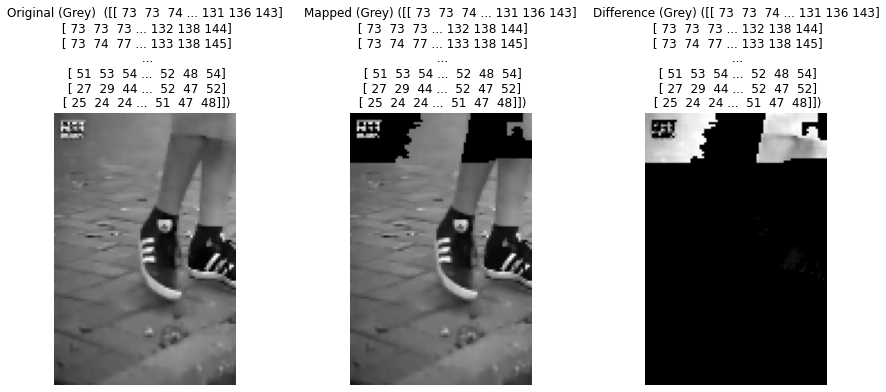

Modified Pixels for 421_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

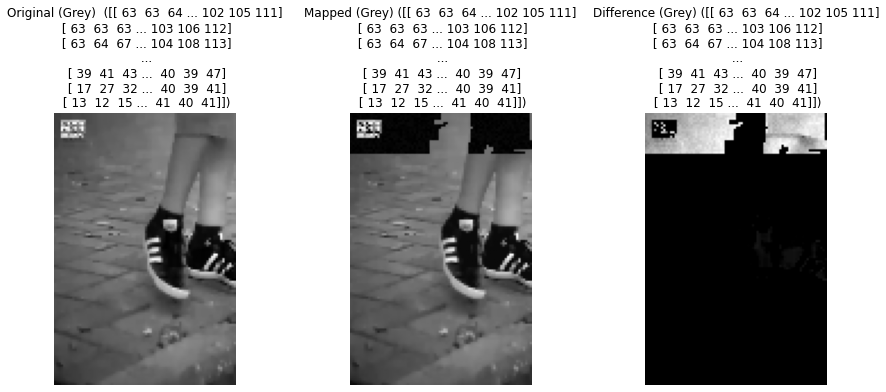

Modified Pixels for 422_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 5
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 4
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 5
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 8
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 3
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 3
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 4
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 0
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 3
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 9
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 4
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 0
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 5
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 4
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

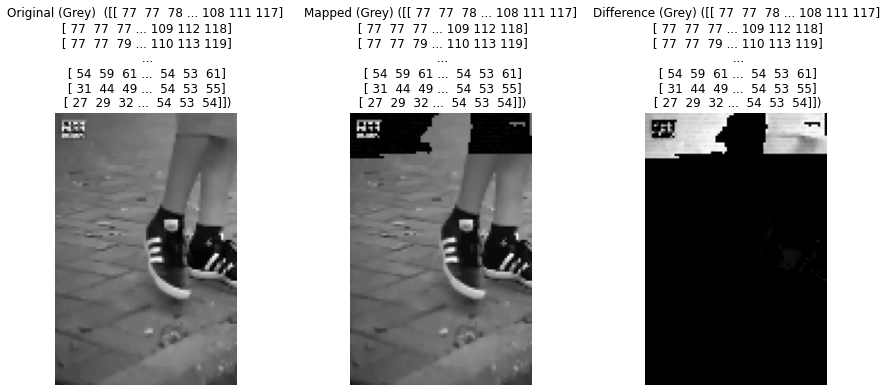

Modified Pixels for 422_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 4
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 2
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 0
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 2
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 4
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 7
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 9
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 1
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 2
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 2
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 2
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 1
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 0
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 8
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 5
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

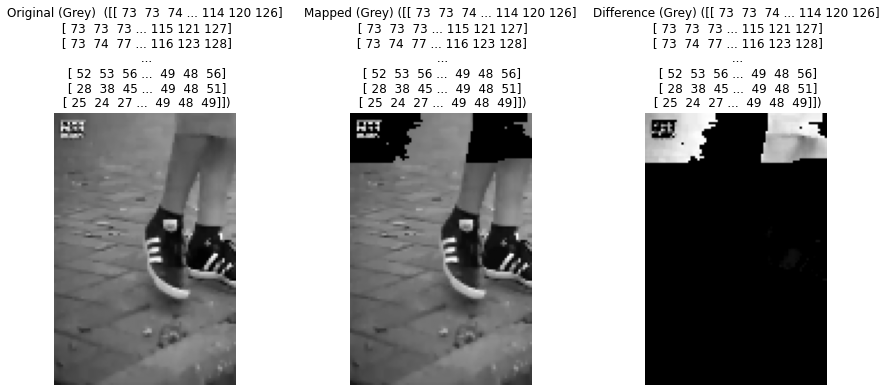

Modified Pixels for 422_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

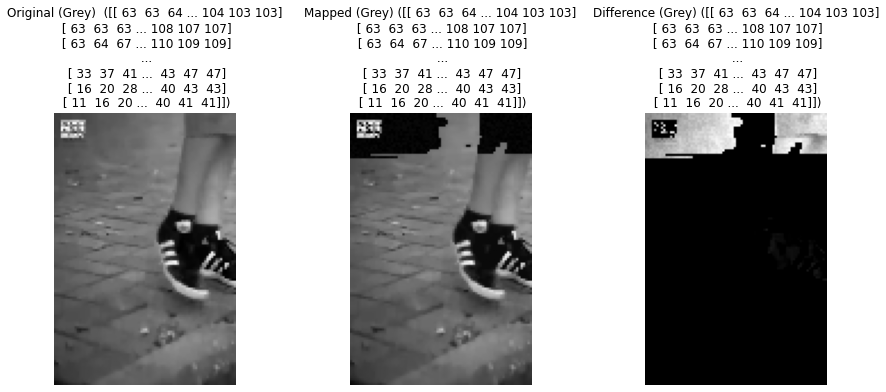

Modified Pixels for 423_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 1
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 3
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 4
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 2
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 6
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 2
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 8
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 0
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 5
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 6
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 2
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 6
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 6
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 6
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

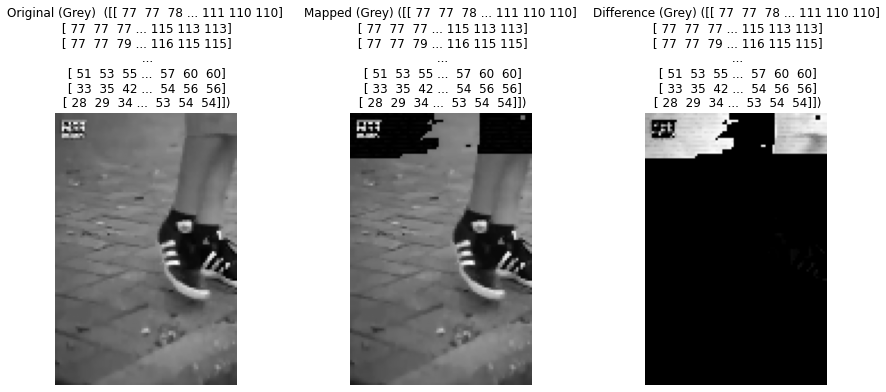

Modified Pixels for 423_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 2
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 3
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 4
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 6
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 8
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 2
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 5
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 6
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 7
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 8
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 8
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 7
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 5
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

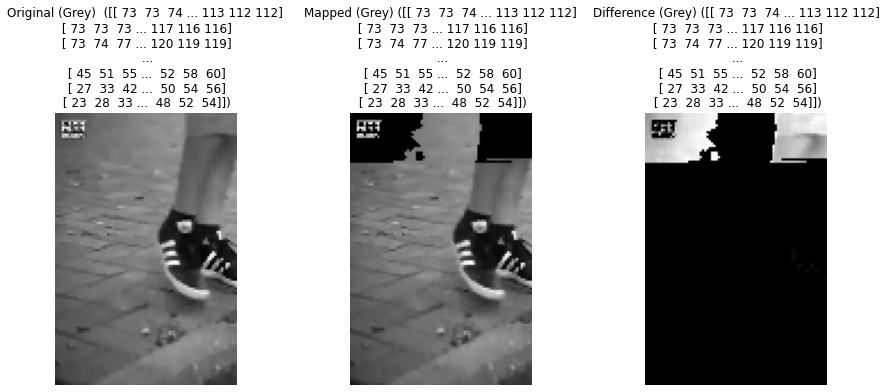

Modified Pixels for 423_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

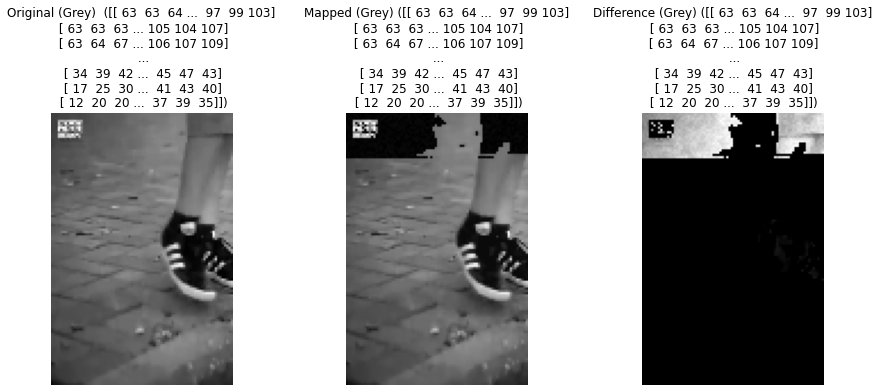

Modified Pixels for 424_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 3
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 5
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 7
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 8
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 9
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 4
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 5
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 0
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 7
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 6
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 2
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 0
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 2
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 5
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 5
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

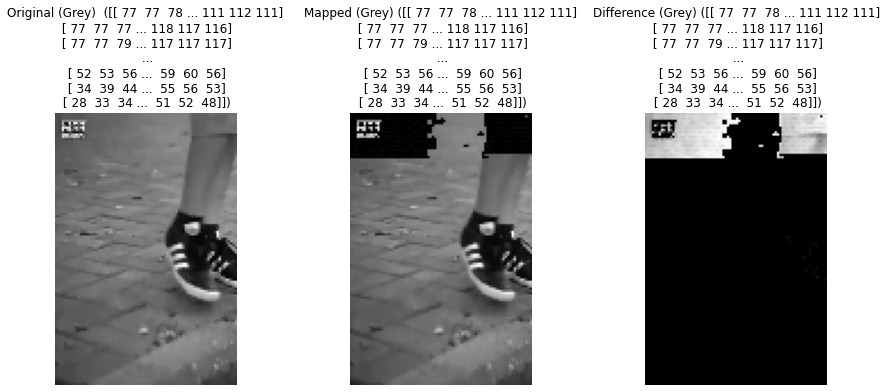

Modified Pixels for 424_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 0
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 3
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 6
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 8
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 0
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 2
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 3
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 1
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 9
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 6
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 3
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 0
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 4
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 8
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

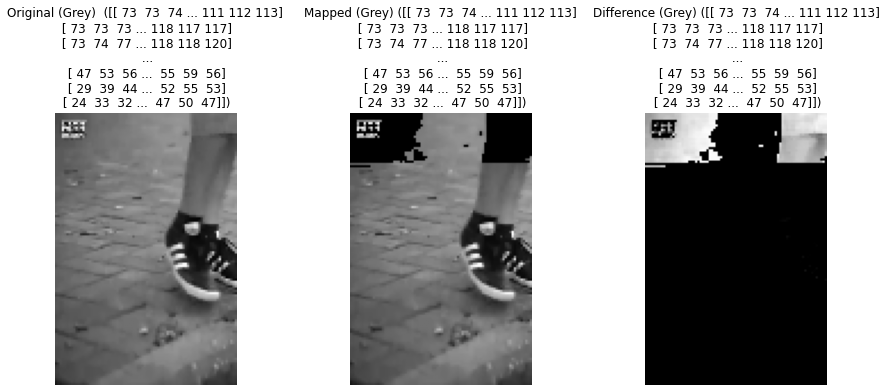

Modified Pixels for 424_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

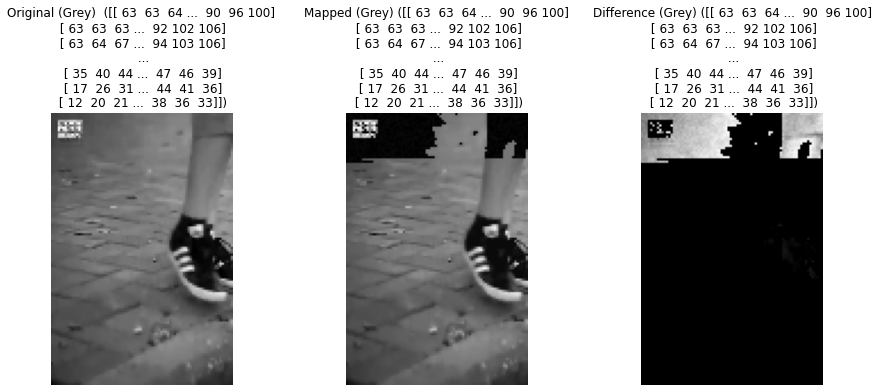

Modified Pixels for 425_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 4
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 6
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 4
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 9
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 4
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 6
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 2
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 5
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 9
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 7
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 8
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 2
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 0
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 8
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

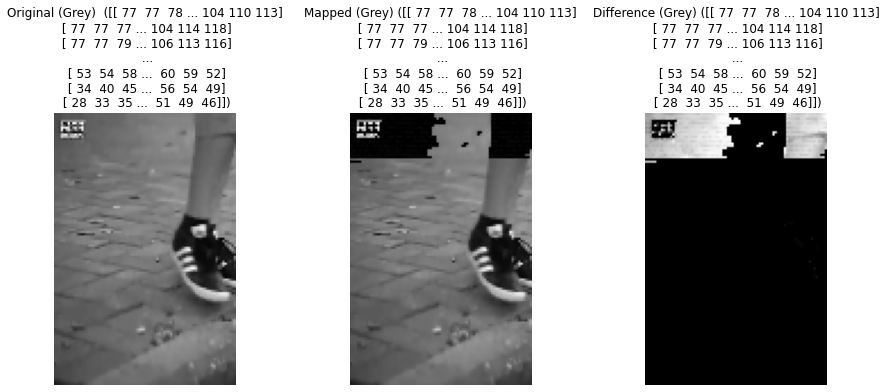

Modified Pixels for 425_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 4
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 4
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 3
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 2
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 1
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 1
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 5
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 6
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 7
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 8
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 9
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 9
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 8
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

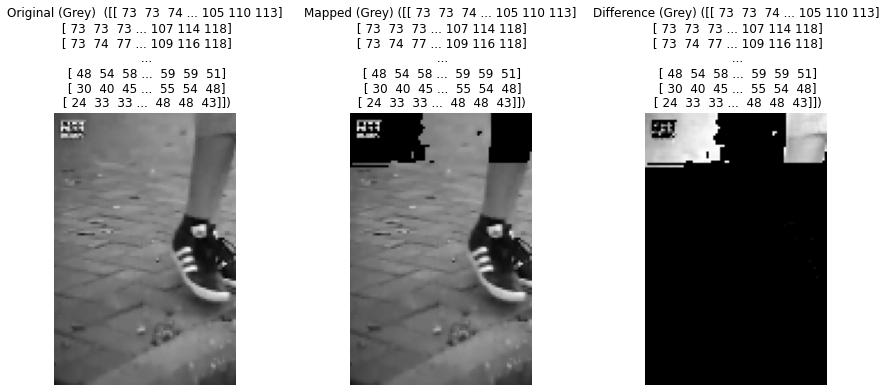

Modified Pixels for 425_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

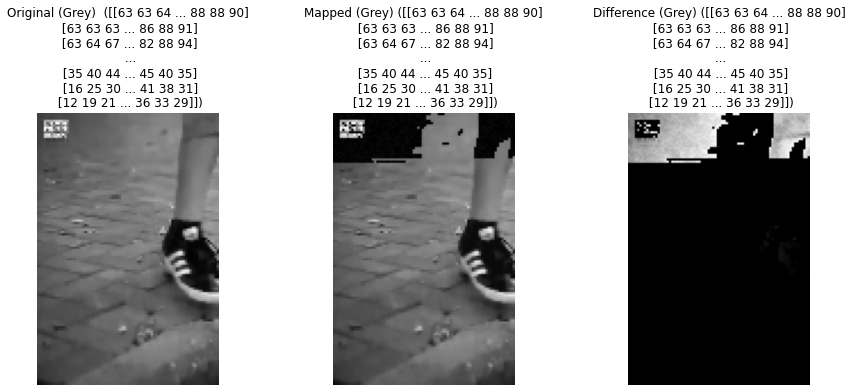

Modified Pixels for 426_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 6
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 0
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 7
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 6
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 0
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 8
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 9
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 0
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 8
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 9
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 1
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 2
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 4
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 4
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

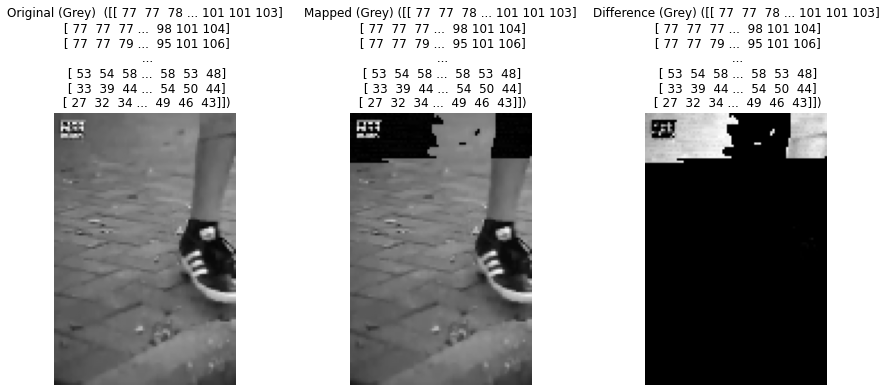

Modified Pixels for 426_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 7
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 0
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 3
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 5
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 8
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 1
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 2
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 4
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 5
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 6
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 6
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 5
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 4
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 3
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 2
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

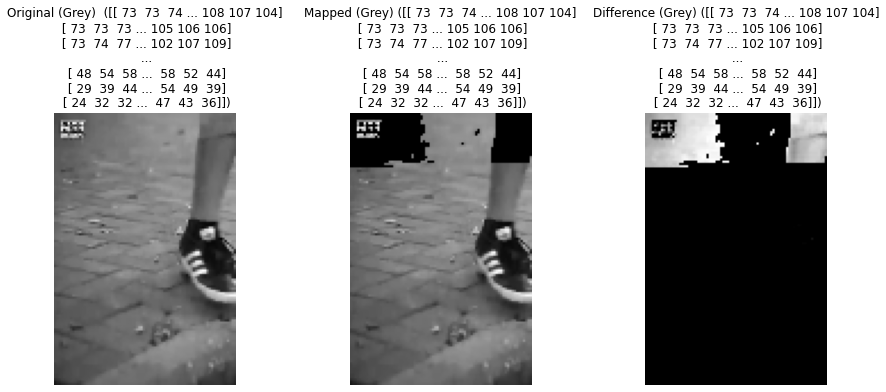

Modified Pixels for 426_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

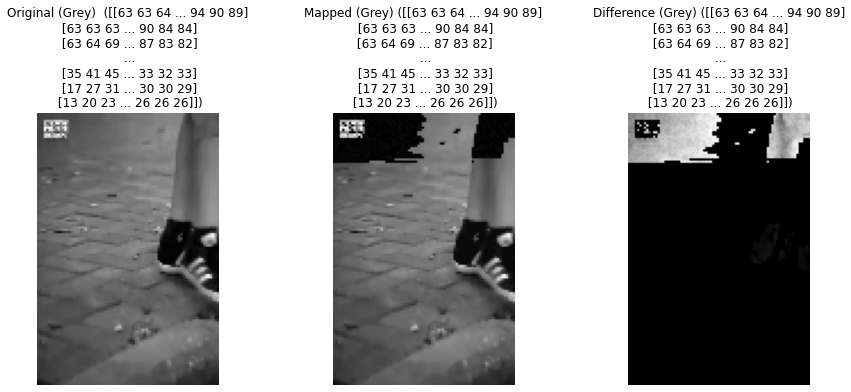

Modified Pixels for 427_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 8
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 2
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 4
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 8
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 9
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 6
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 8
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 0
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 1
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 7
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 1
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 1
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 6
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 5
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 6
  Index: 15, Pixel: (0, 15), Original: 75, Mapped: 75, N

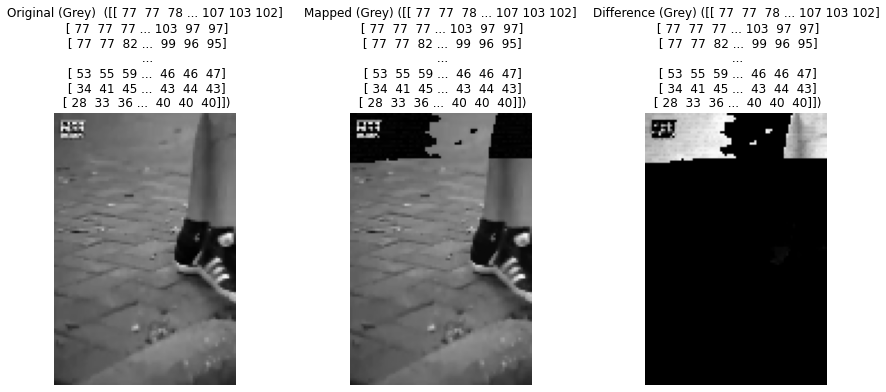

Modified Pixels for 427_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 3
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 2
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 0
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 9
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 9
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 8
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 8
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 9
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 9
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 8
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 8
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 6
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 3
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 0
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 5
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

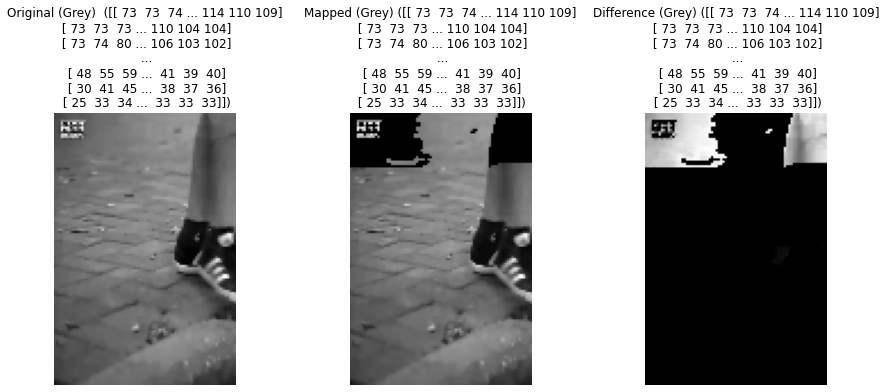

Modified Pixels for 427_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96, 

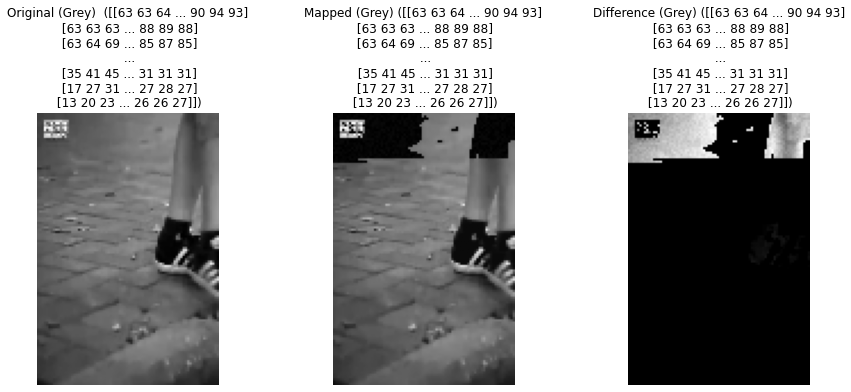

Modified Pixels for 428_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 4
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 2
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 5
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 5
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 5
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 0
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 5
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 0
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 2
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 8
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 5
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 8
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 8
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 7
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

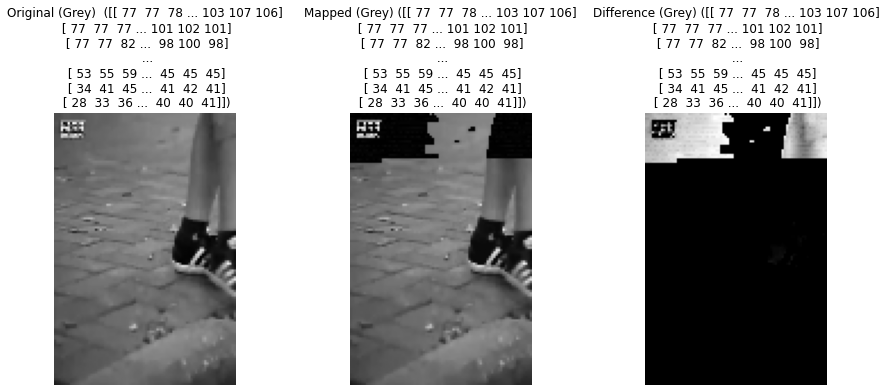

Modified Pixels for 428_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 7
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 5
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 2
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 0
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 2
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 5
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 8
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 2
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 6
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 9
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 3
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 7
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 0
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 2
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 3
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

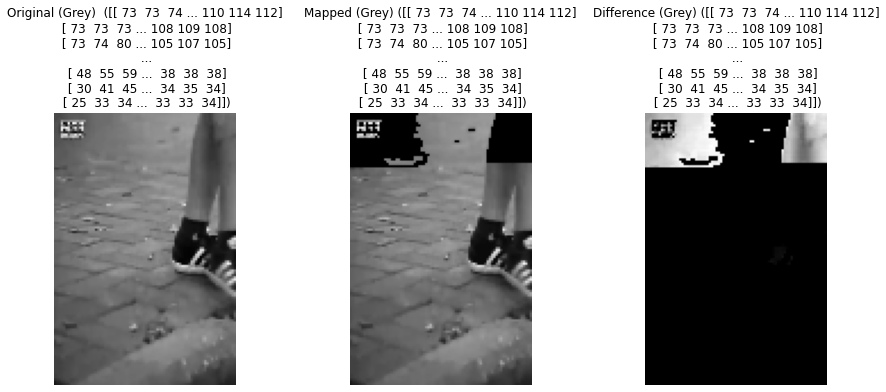

Modified Pixels for 428_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

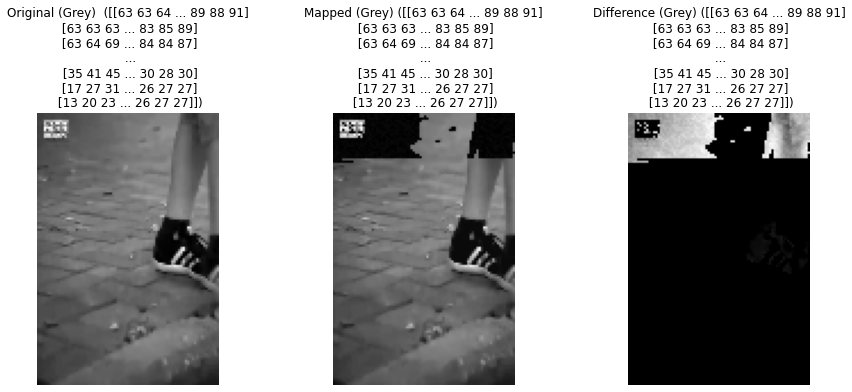

Modified Pixels for 429_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 6
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 7
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 0
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 0
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 8
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 8
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 9
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 1
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 5
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 0
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 2
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 7
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 4
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 3
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

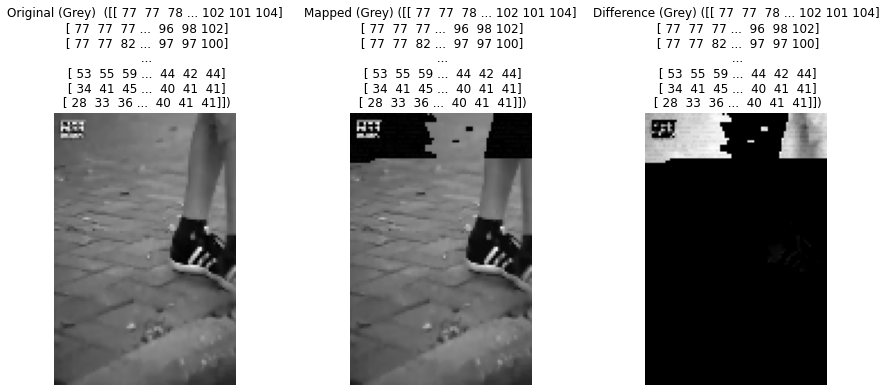

Modified Pixels for 429_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 3
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 8
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 3
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 8
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 3
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 6
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 9
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 0
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 0
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 8
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 5
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 2
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 7
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 2
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 7
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

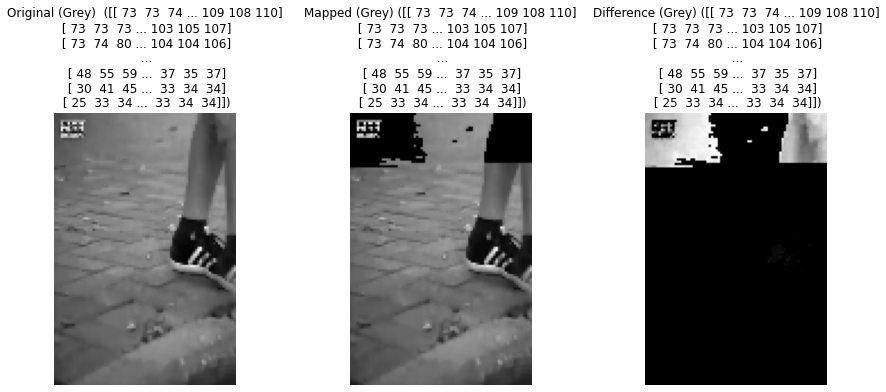

Modified Pixels for 429_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

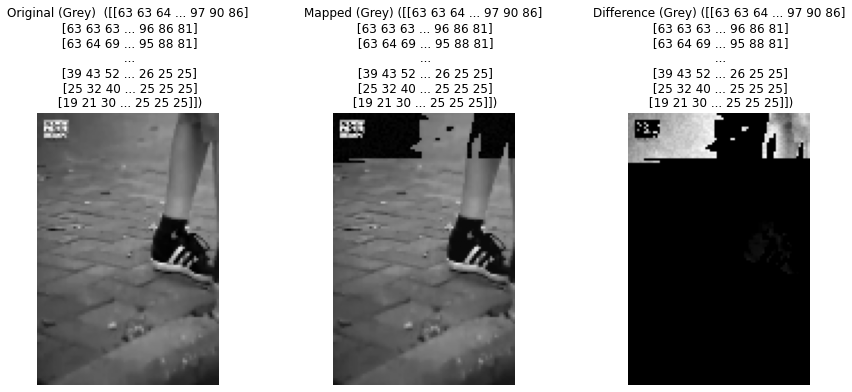

Modified Pixels for 430_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 9
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 1
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 8
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 7
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 8
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 7
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 8
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 1
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 6
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 0
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 7
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 0
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 7
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 5
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 7
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

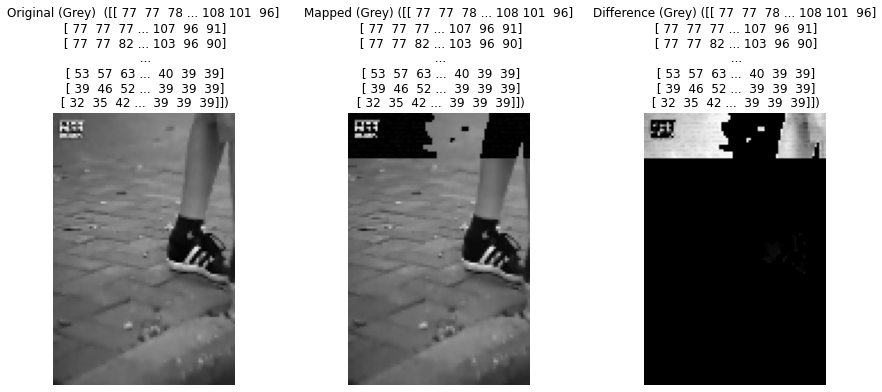

Modified Pixels for 430_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 8
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 0
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 1
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 1
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 9
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 6
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 2
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 7
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 1
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 5
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 8
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 2
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 3
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 9
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 4
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

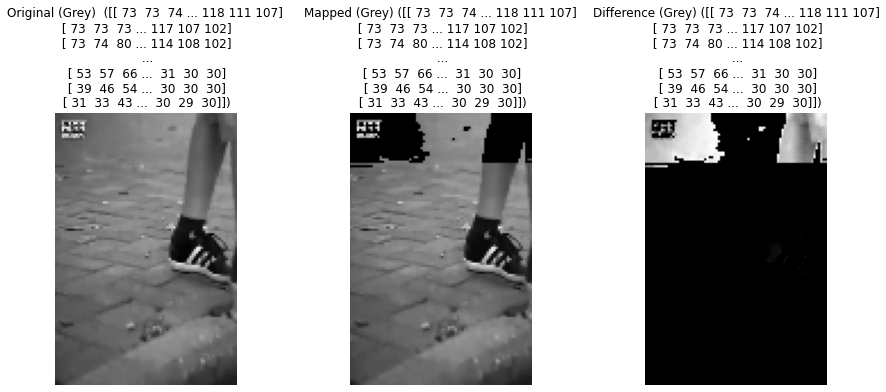

Modified Pixels for 430_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

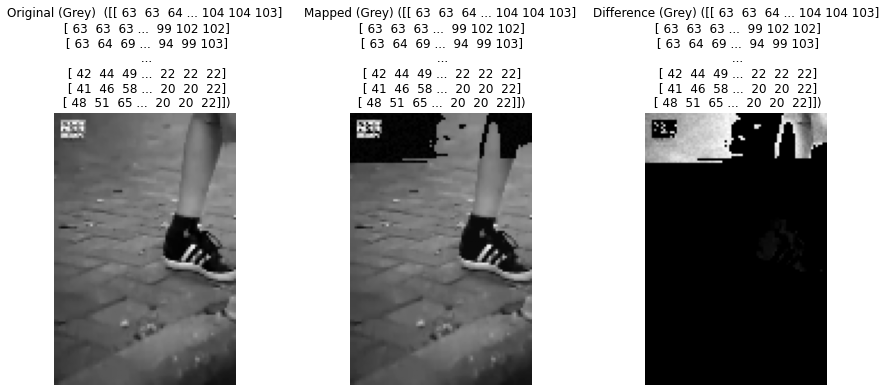

Modified Pixels for 431_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 8
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 7
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 1
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 2
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 1
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 6
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 3
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 7
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 7
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 1
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 8
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 6
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 3
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 5
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

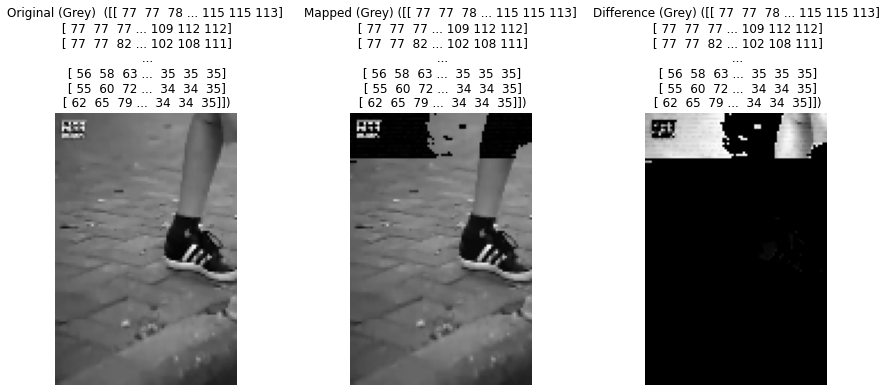

Modified Pixels for 431_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 5
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 3
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 1
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 0
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 2
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 3
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 5
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 6
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 7
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 9
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 2
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 4
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 6
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 8
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 0
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

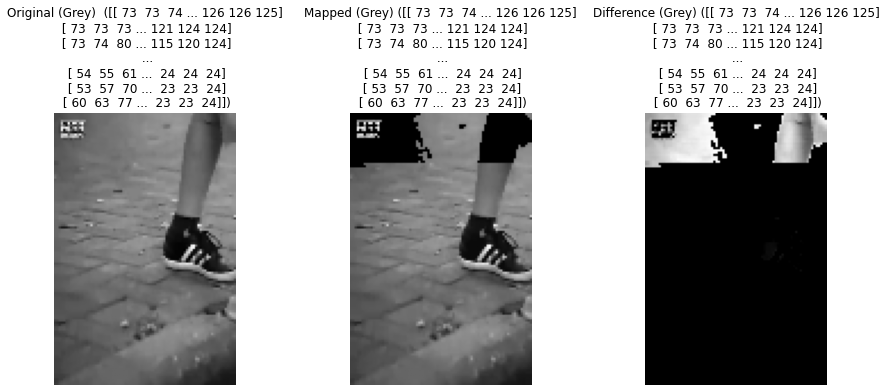

Modified Pixels for 431_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

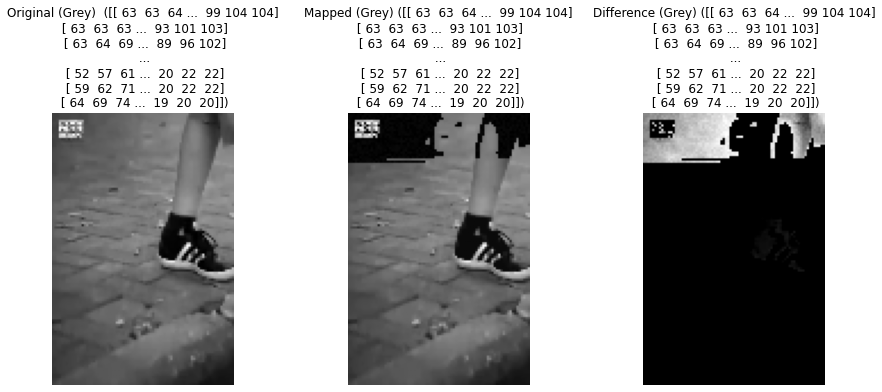

Modified Pixels for 432_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 3
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 3
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 5
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 0
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 4
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 7
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 1
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 9
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 9
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 7
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 7
  Index: 11, Pixel: (0, 11), Original: 73, Mapped: 73, New: 5
  Index: 12, Pixel: (0, 12), Original: 70, Mapped: 70, New: 6
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 8
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

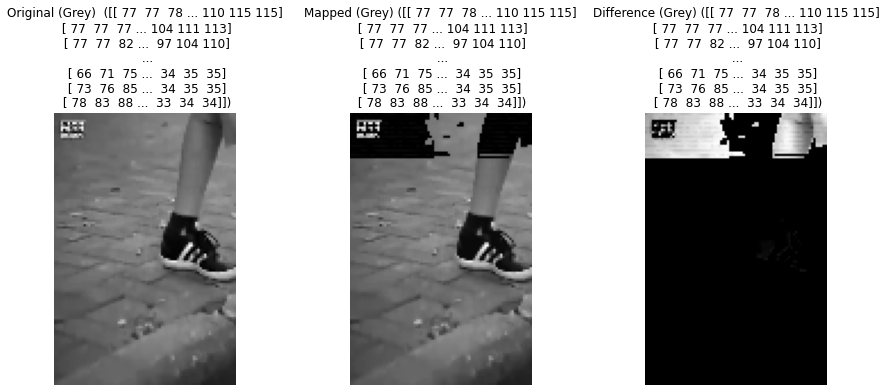

Modified Pixels for 432_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 9
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 1
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 3
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 4
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 4
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 4
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 2
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 0
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 8
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 4
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 1
  Index: 11, Pixel: (0, 11), Original: 86, Mapped: 86, New: 7
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 3
  Index: 13, Pixel: (0, 13), Original: 93, Mapped: 93, New: 0
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 4
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

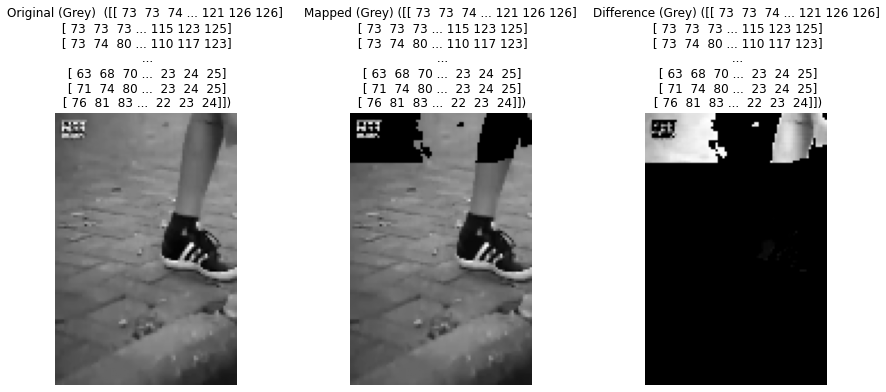

Modified Pixels for 432_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 90, Mapped: 90, New: 0
  Index: 12, Pixel: (0, 12), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

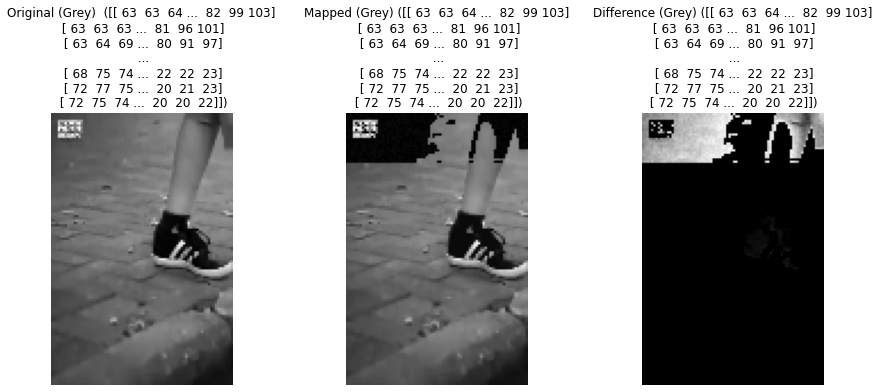

Modified Pixels for 433_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 5
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 9
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 7
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 9
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 7
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 1
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 2
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 9
  Index: 10, Pixel: (0, 10), Original: 75, Mapped: 75, New: 0
  Index: 11, Pixel: (0, 11), Original: 76, Mapped: 76, New: 3
  Index: 12, Pixel: (0, 12), Original: 76, Mapped: 76, New: 2
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 8
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 0
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

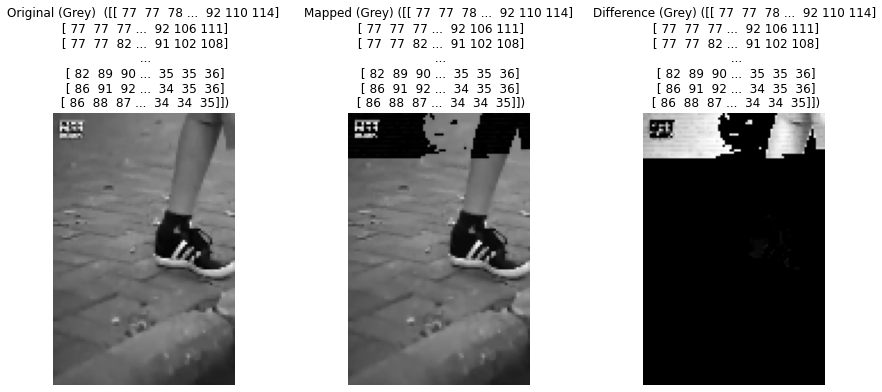

Modified Pixels for 433_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 2
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 0
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 8
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 6
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 3
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 9
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 5
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 1
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 2
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 6
  Index: 10, Pixel: (0, 10), Original: 88, Mapped: 88, New: 0
  Index: 11, Pixel: (0, 11), Original: 89, Mapped: 89, New: 3
  Index: 12, Pixel: (0, 12), Original: 94, Mapped: 94, New: 5
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 7
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 8
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

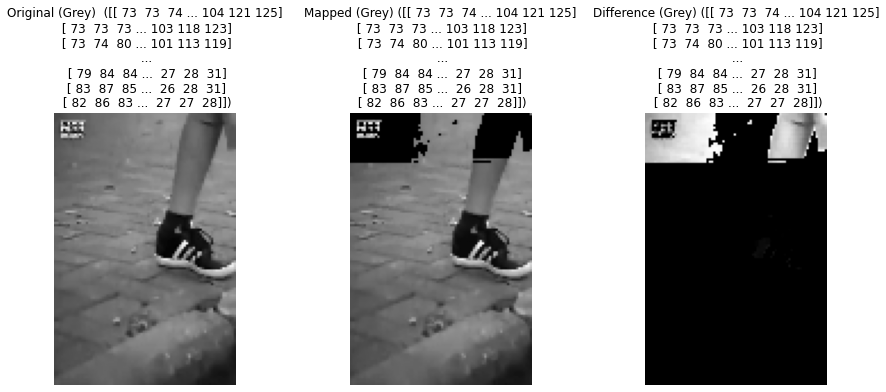

Modified Pixels for 433_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 91, Mapped: 91, New: 0
  Index: 10, Pixel: (0, 10), Original: 93, Mapped: 93, New: 0
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 0
  Index: 12, Pixel: (0, 12), Original: 97, Mapped: 97, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

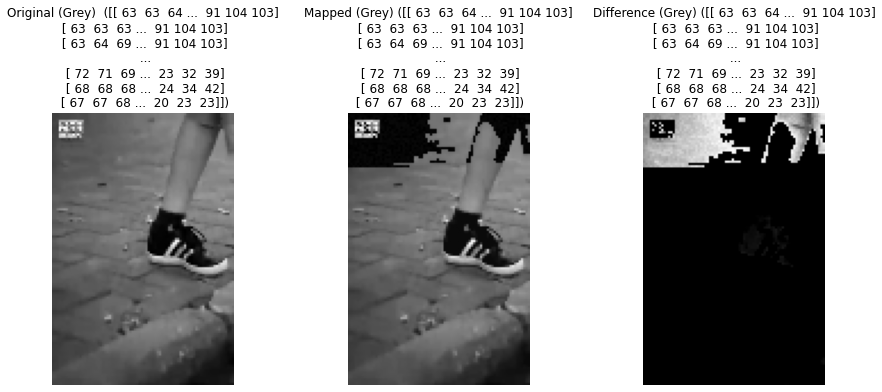

Modified Pixels for 434_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 3
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 5
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 6
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 4
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 7
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 6
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 7
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 2
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 4
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 4
  Index: 10, Pixel: (0, 10), Original: 77, Mapped: 77, New: 4
  Index: 11, Pixel: (0, 11), Original: 79, Mapped: 79, New: 5
  Index: 12, Pixel: (0, 12), Original: 75, Mapped: 75, New: 4
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 2
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

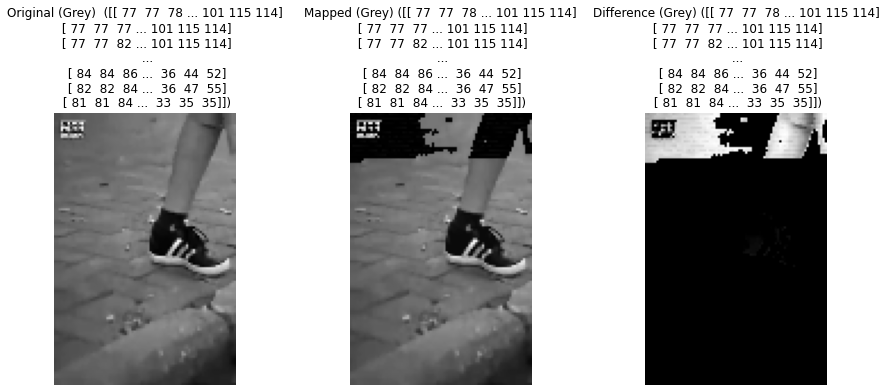

Modified Pixels for 434_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 4
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 7
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 1
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 5
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 8
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 2
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 4
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 4
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 3
  Index: 11, Pixel: (0, 11), Original: 91, Mapped: 91, New: 1
  Index: 12, Pixel: (0, 12), Original: 93, Mapped: 93, New: 9
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 7
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 5
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

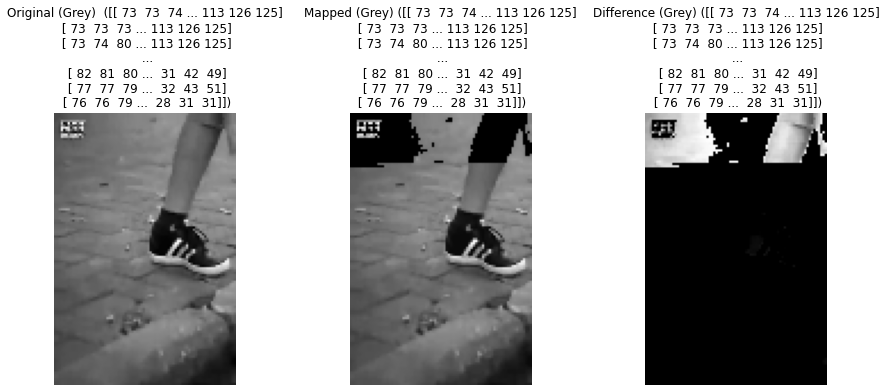

Modified Pixels for 434_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 91, Mapped: 91, New: 0
  Index: 10, Pixel: (0, 10), Original: 95, Mapped: 95, New: 0
  Index: 11, Pixel: (0, 11), Original: 96, Mapped: 96, New: 0
  Index: 12, Pixel: (0, 12), Original: 96, Mapped: 96, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

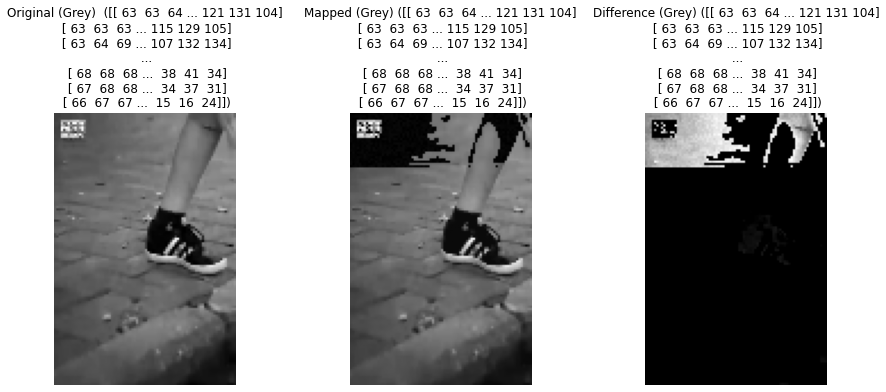

Modified Pixels for 435_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 1
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 0
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 1
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 2
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 1
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 1
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 2
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 7
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 8
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 9
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 8
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 2
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 6
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

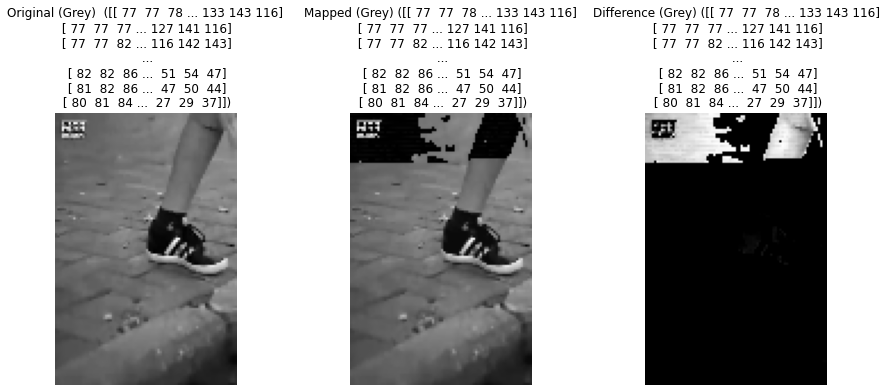

Modified Pixels for 435_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 77, Mapped: 77, New: 9
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 8
  Index: 2, Pixel: (0, 2), Original: 78, Mapped: 78, New: 7
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 6
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 5
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 4
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 3
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 2
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 2
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 2
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 1
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 1
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 1
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 0
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

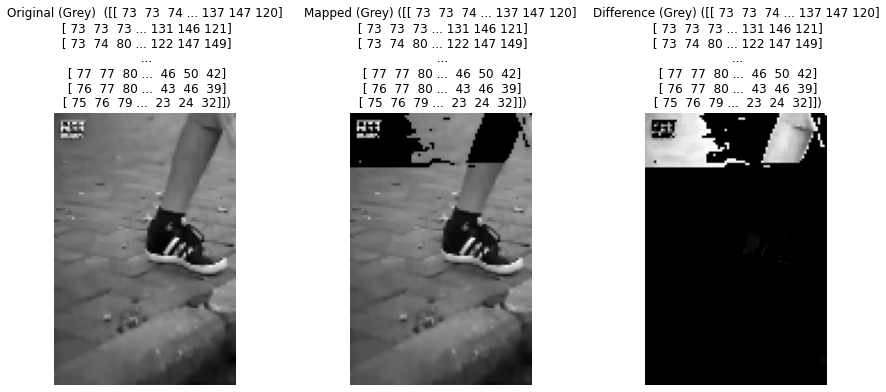

Modified Pixels for 435_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 73, Mapped: 73, New: 0
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 78, Mapped: 78, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

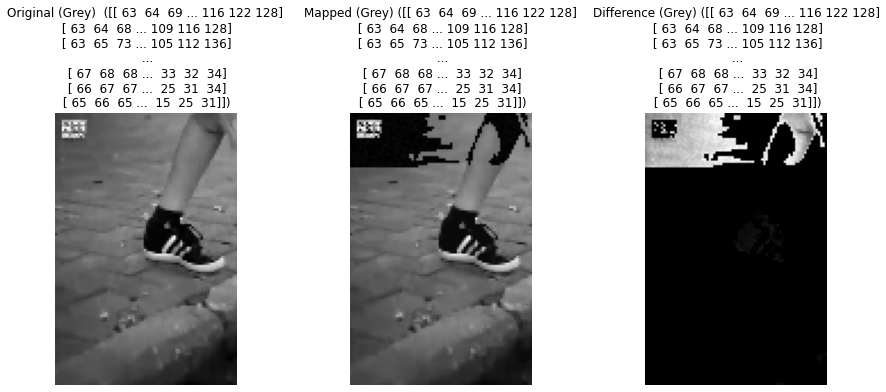

Modified Pixels for 436_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 2
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 5
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 3
  Index: 4, Pixel: (0, 4), Original: 69, Mapped: 69, New: 9
  Index: 5, Pixel: (0, 5), Original: 69, Mapped: 69, New: 1
  Index: 6, Pixel: (0, 6), Original: 69, Mapped: 69, New: 8
  Index: 7, Pixel: (0, 7), Original: 70, Mapped: 70, New: 0
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 4
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 2
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 2
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 5
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 9
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 5
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

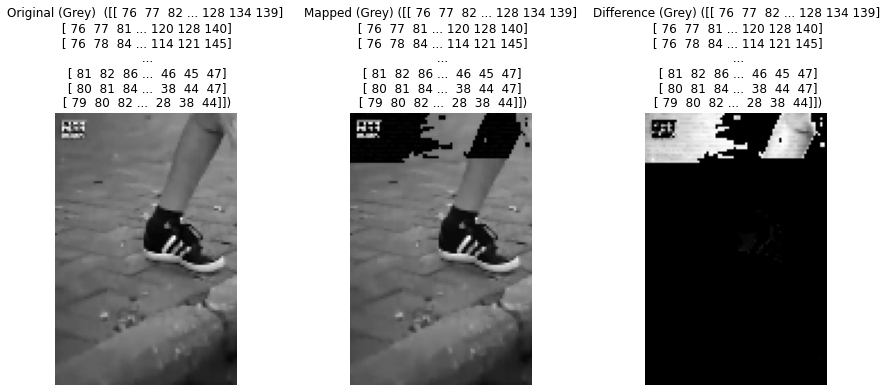

Modified Pixels for 436_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 7
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 9
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 0
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 0
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 0
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 88, Mapped: 88, New: 9
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 9
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 7
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 6
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 5
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 3
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 2
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 2
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

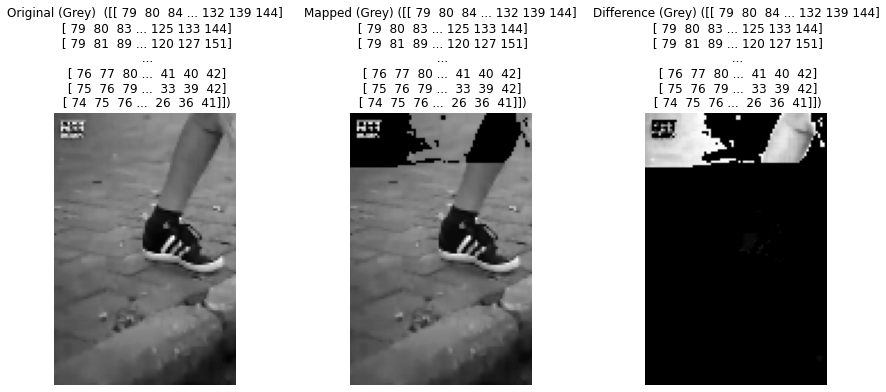

Modified Pixels for 436_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

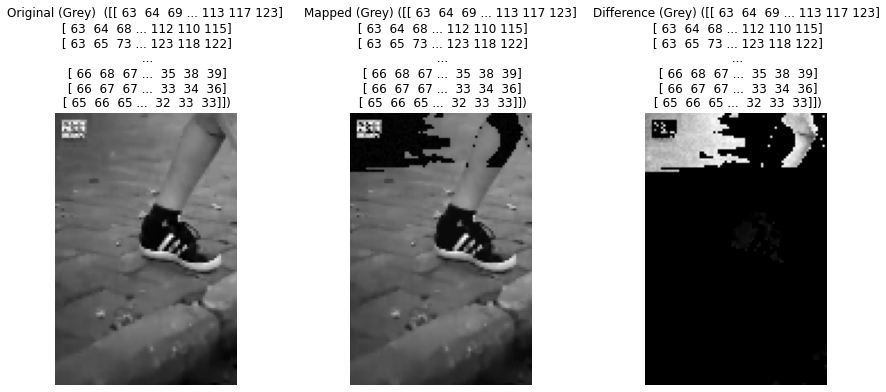

Modified Pixels for 437_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 3
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 8
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 73, Mapped: 73, New: 6
  Index: 5, Pixel: (0, 5), Original: 73, Mapped: 73, New: 7
  Index: 6, Pixel: (0, 6), Original: 73, Mapped: 73, New: 6
  Index: 7, Pixel: (0, 7), Original: 74, Mapped: 74, New: 3
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 0
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 4
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 9
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 7
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 2
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 0
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 6
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

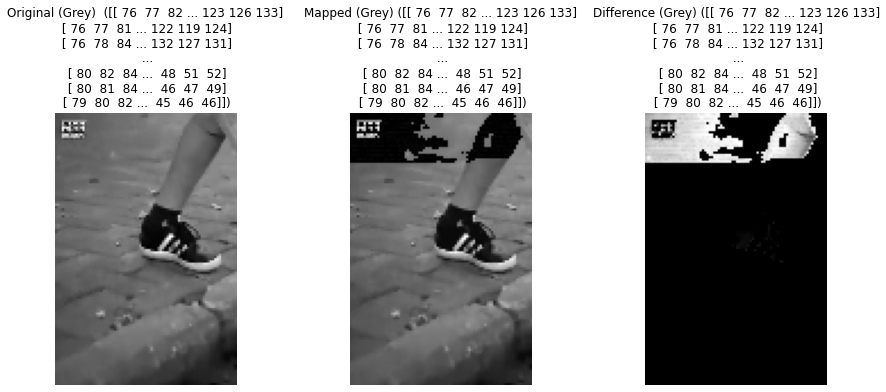

Modified Pixels for 437_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 7
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 7
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 7
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 6
  Index: 4, Pixel: (0, 4), Original: 86, Mapped: 86, New: 4
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 2
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 0
  Index: 7, Pixel: (0, 7), Original: 86, Mapped: 86, New: 2
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 4
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 6
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 6
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 5
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 4
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 2
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 0
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

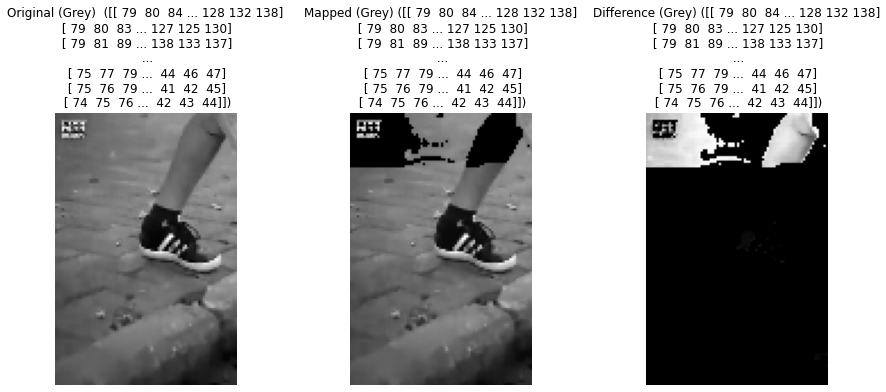

Modified Pixels for 437_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

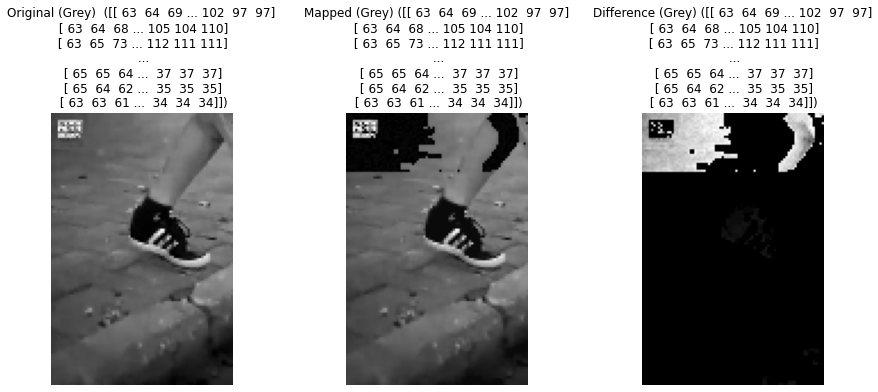

Modified Pixels for 438_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 6
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 7
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 2
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 4
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 9
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 5
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 0
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 8
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 1
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 2
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 6
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 6
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 2
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 2
  Index: 15, Pixel: (0, 15), Original: 76, Mapped: 76, N

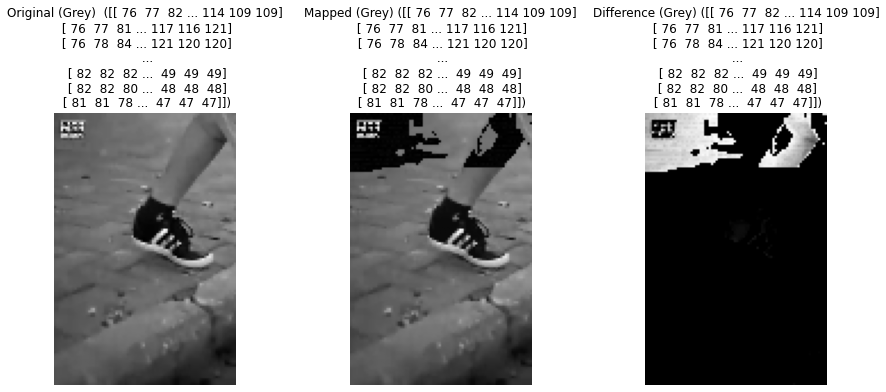

Modified Pixels for 438_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 2
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 2
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 2
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 3
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 3
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 3
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 2
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 9
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 5
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 3
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 3
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 0
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 7
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 3
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

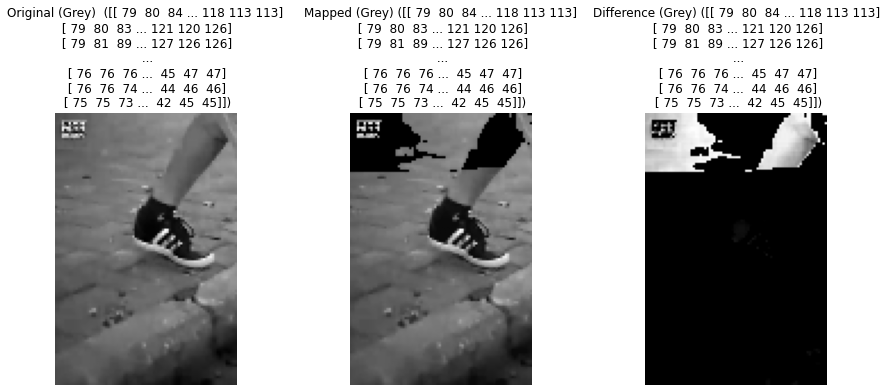

Modified Pixels for 438_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

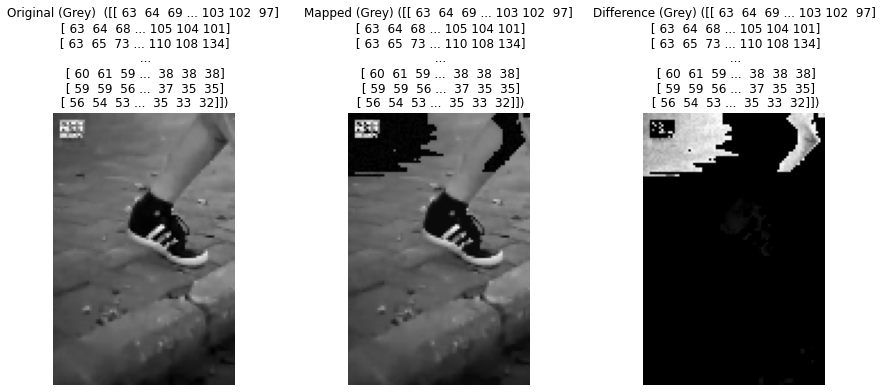

Modified Pixels for 439_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 5
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 6
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 2
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 6
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 1
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 1
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 6
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 7
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 3
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 9
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 7
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 3
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 5
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 9
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 0
  Index: 15, Pixel: (0, 15), Original: 78, Mapped: 78, N

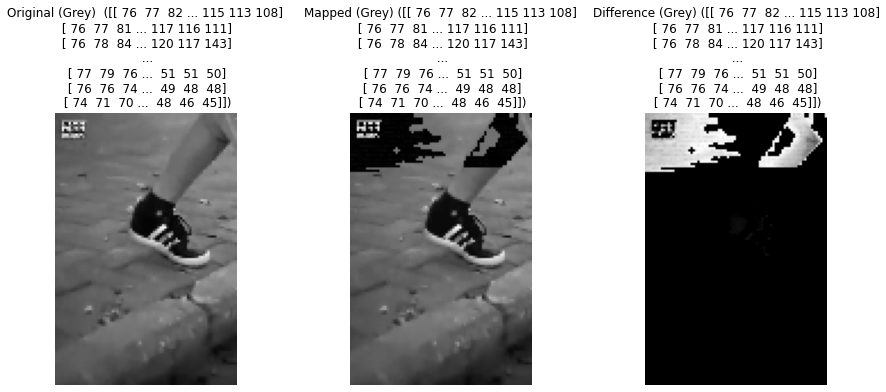

Modified Pixels for 439_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 1
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 3
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 4
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 5
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 5
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 5
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 4
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 2
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 0
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 7
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 4
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 1
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 8
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 6
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 5
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

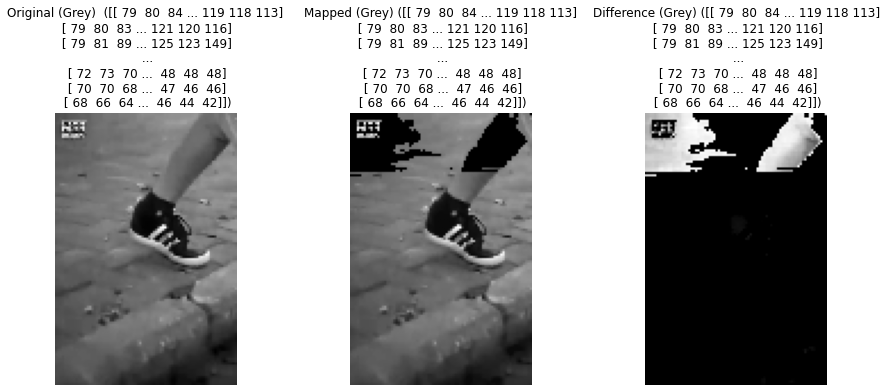

Modified Pixels for 439_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 99, Mapped: 99, 

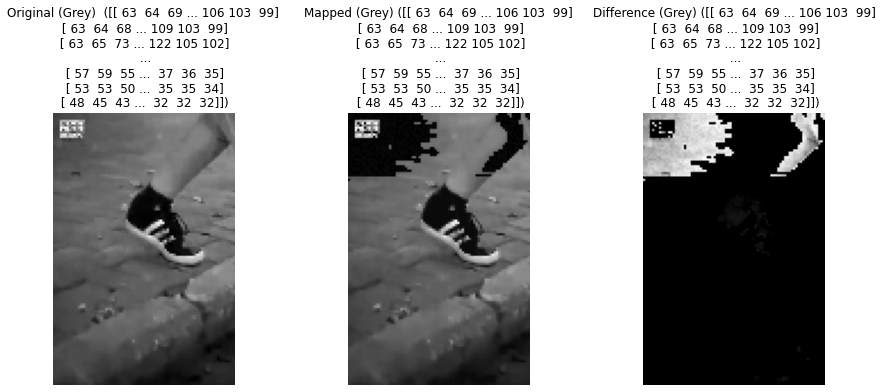

Modified Pixels for 440_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 7
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 2
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 9
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 9
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 8
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 6
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 8
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 4
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 7
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 7
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 6
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 2
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 15), Original: 78, Mapped: 78, N

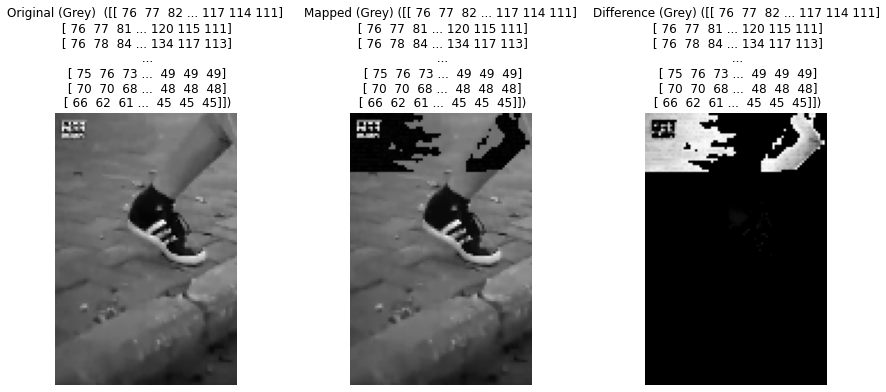

Modified Pixels for 440_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 2
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 9
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 6
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 3
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 0
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 7
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 5
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 3
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 0
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 1
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 5
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 9
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 4
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 9
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 4
  Index: 15, Pixel: (0, 15), Original: 94, Mapped: 94,

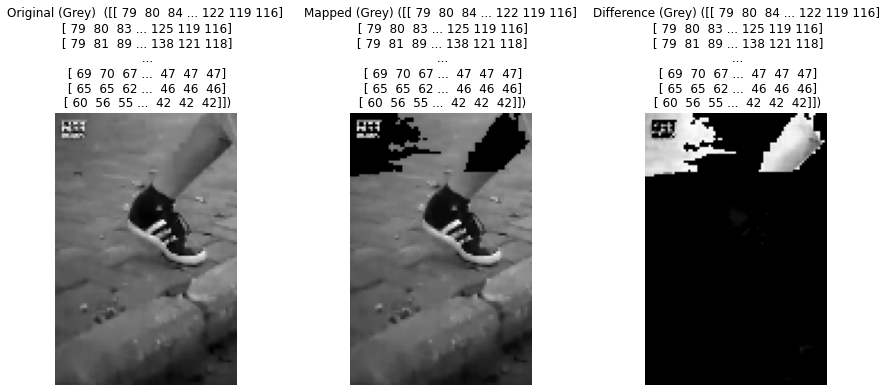

Modified Pixels for 440_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 99, Mapped: 99, 

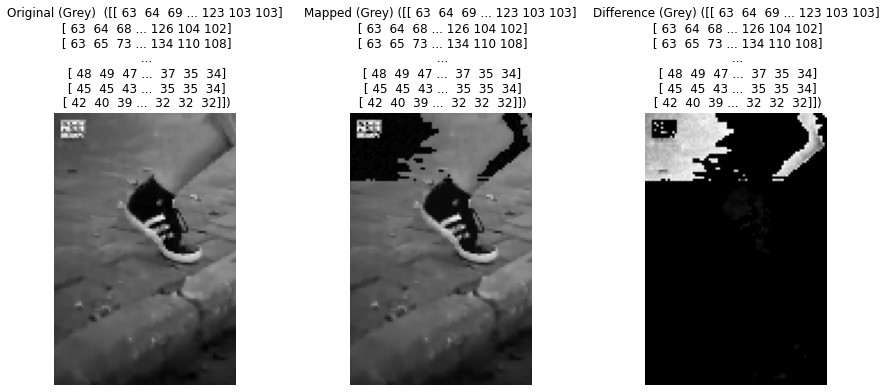

Modified Pixels for 441_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 3
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 8
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 7
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 5
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 8
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 2
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 5
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 9
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 3
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 7
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 8
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 6
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 0
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 15), Original: 79, Mapped: 79, N

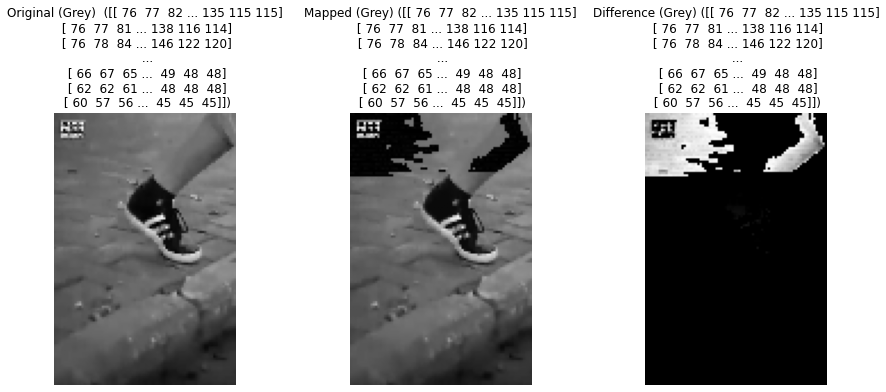

Modified Pixels for 441_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 6
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 8
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 0
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 1
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 3
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 4
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 4
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 4
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 4
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 2
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 1
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 9
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 6
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 4
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 2
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

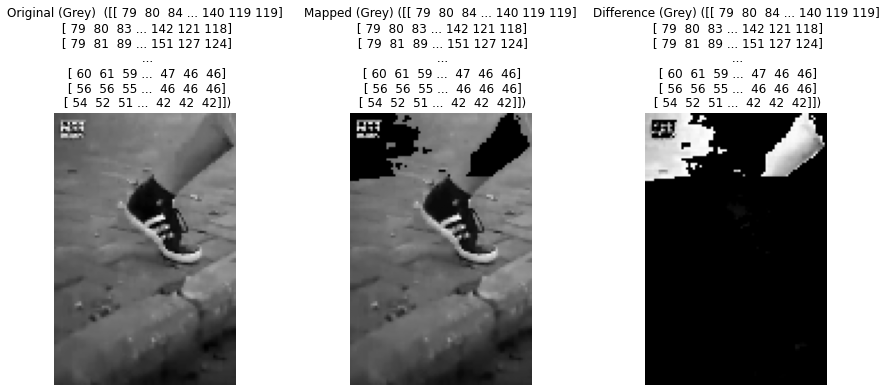

Modified Pixels for 441_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 99, Mapped: 99, 

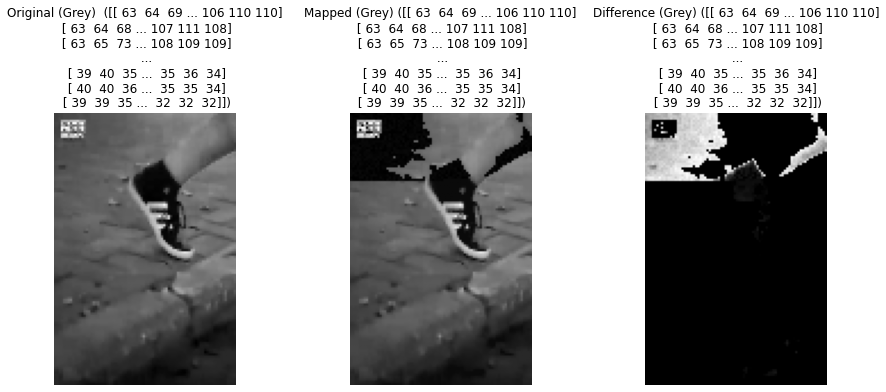

Modified Pixels for 442_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 1
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 5
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 6
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 7
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 1
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 1
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 6
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 5
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 9
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 3
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 0
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 8
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 8
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 15), Original: 78, Mapped: 78, N

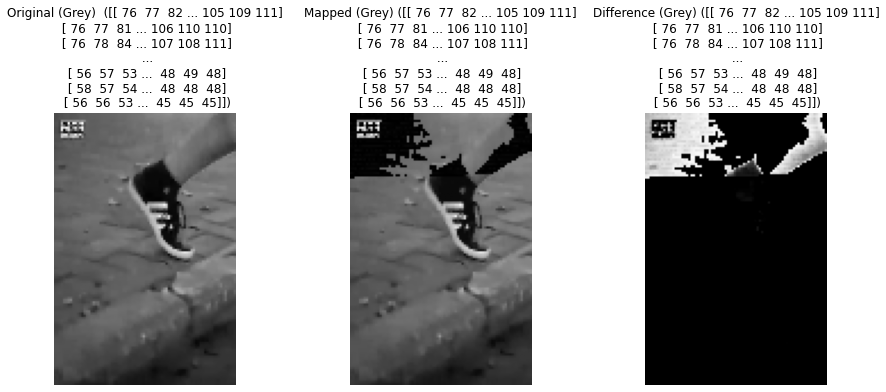

Modified Pixels for 442_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 3
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 2
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 0
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 7
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 3
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 9
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 5
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 1
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 2
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 6
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 1
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 5
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 9
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 3
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 6
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96,

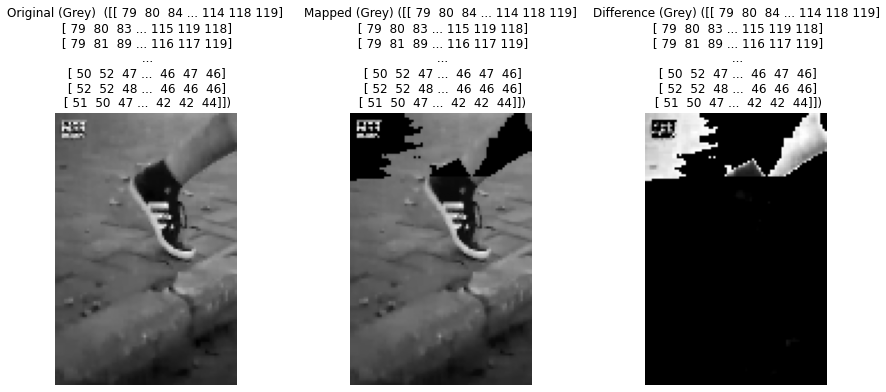

Modified Pixels for 442_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 99, Mapped: 99, 

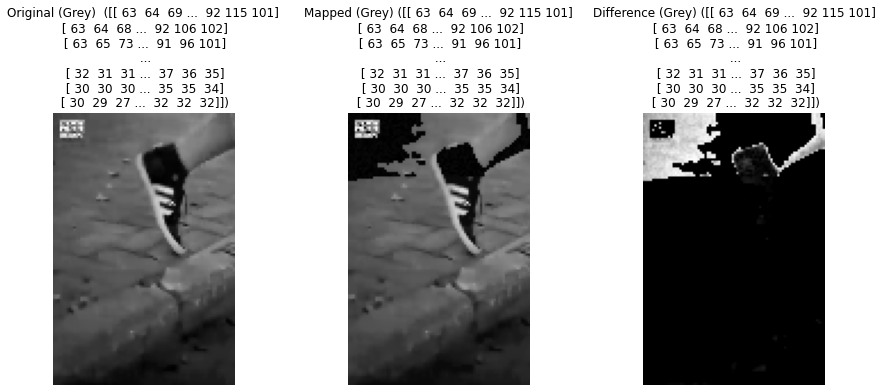

Modified Pixels for 443_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 6
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 3
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 7
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 5
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 4
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 9
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 2
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 8
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 0
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 5
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 7
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 4
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 1
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 4
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 2
  Index: 15, Pixel: (0, 15), Original: 79, Mapped: 79, N

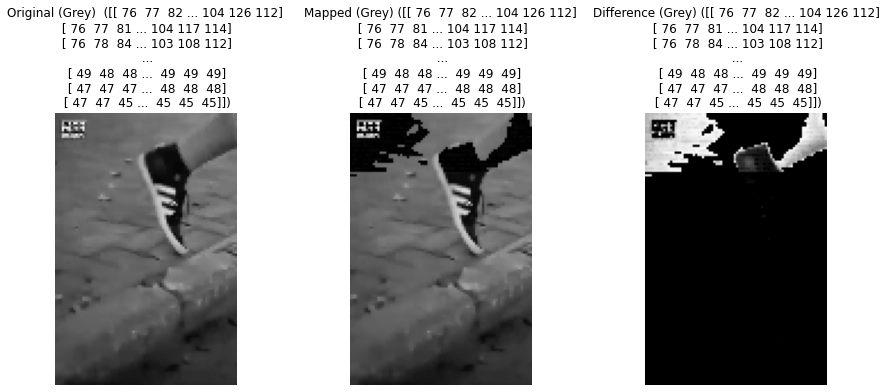

Modified Pixels for 443_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 2
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 3
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 4
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 5
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 6
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 8
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 1
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 4
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 7
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 9
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 1
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 2
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 2
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 9
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 6
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96,

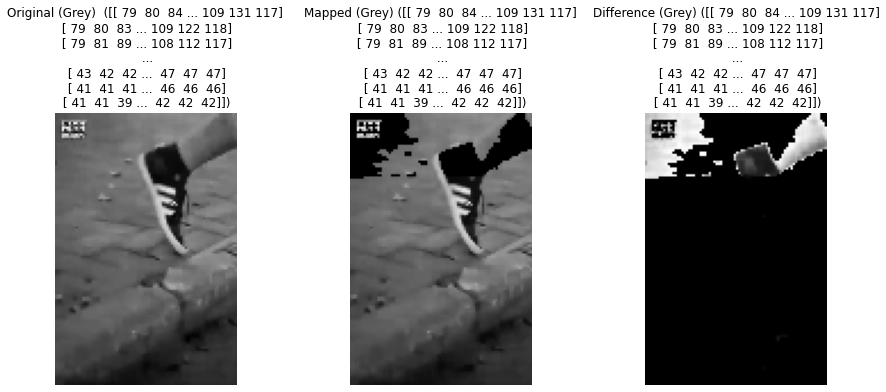

Modified Pixels for 443_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 99, Mapped: 99, 

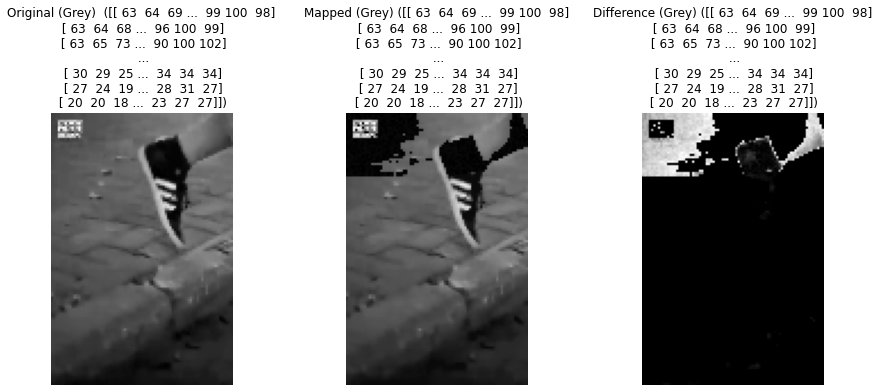

Modified Pixels for 444_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 2
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 8
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 4
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 5
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 0
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 0
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 9
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 5
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 6
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 4
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 1
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 1
  Index: 12, Pixel: (0, 12), Original: 78, Mapped: 78, New: 3
  Index: 13, Pixel: (0, 13), Original: 75, Mapped: 75, New: 1
  Index: 14, Pixel: (0, 14), Original: 75, Mapped: 75, New: 2
  Index: 15, Pixel: (0, 15), Original: 78, Mapped: 78, N

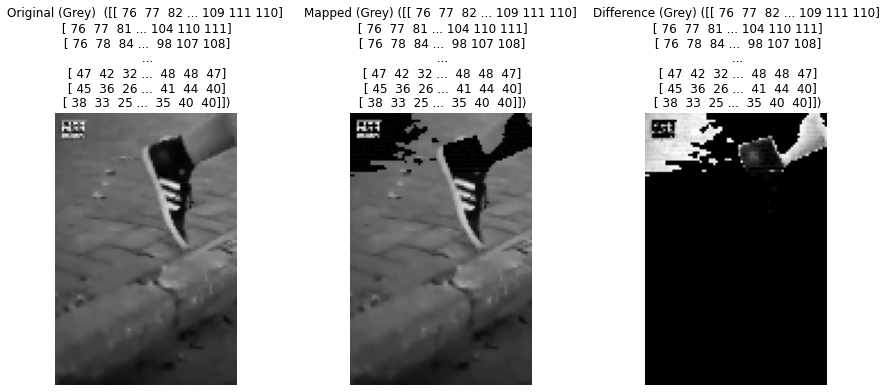

Modified Pixels for 444_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 7
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 9
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 2
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 3
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 6
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 1
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 7
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 2
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 7
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 4
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 6
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 9
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 2
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 4
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96,

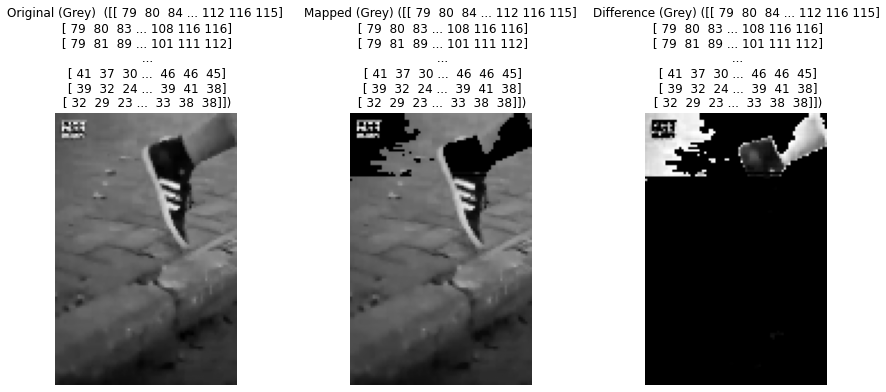

Modified Pixels for 444_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 98, Mapped: 98, New: 0
  Index: 13, Pixel: (0, 13), Original: 96, Mapped: 96, New: 0
  Index: 14, Pixel: (0, 14), Original: 96, Mapped: 96, New: 0
  Index: 15, Pixel: (0, 15), Original: 98, Mapped: 98, 

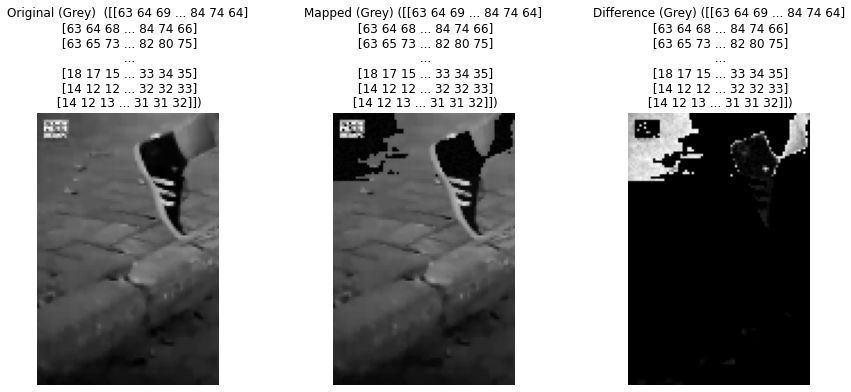

Modified Pixels for 445_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 8
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 6
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 7
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 7
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 9
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 4
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 3
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 7
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 2
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 9
  Index: 10, Pixel: (0, 10), Original: 80, Mapped: 80, New: 2
  Index: 11, Pixel: (0, 11), Original: 81, Mapped: 81, New: 8
  Index: 12, Pixel: (0, 12), Original: 76, Mapped: 76, New: 8
  Index: 13, Pixel: (0, 13), Original: 74, Mapped: 74, New: 5
  Index: 14, Pixel: (0, 14), Original: 74, Mapped: 74, New: 9
  Index: 15, Pixel: (0, 15), Original: 77, Mapped: 77, N

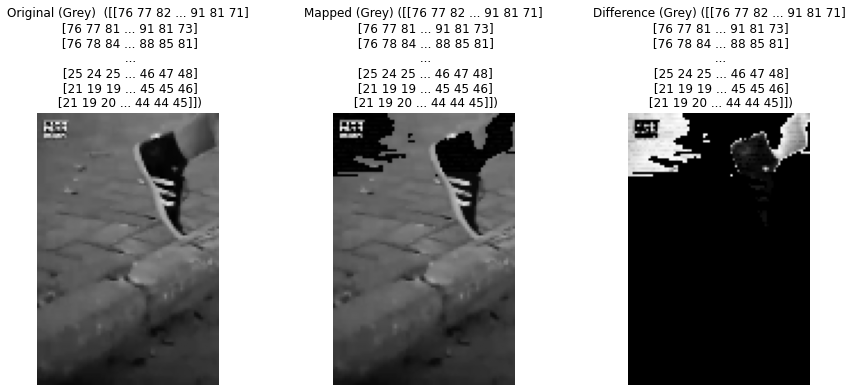

Modified Pixels for 445_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 0
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 0
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 1
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 2
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 2
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 1
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 0
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 9
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 7
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 4
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 2
  Index: 11, Pixel: (0, 11), Original: 94, Mapped: 94, New: 1
  Index: 12, Pixel: (0, 12), Original: 94, Mapped: 94, New: 0
  Index: 13, Pixel: (0, 13), Original: 92, Mapped: 92, New: 0
  Index: 14, Pixel: (0, 14), Original: 93, Mapped: 93, New: 0
  Index: 15, Pixel: (0, 15), Original: 95, Mapped: 95,

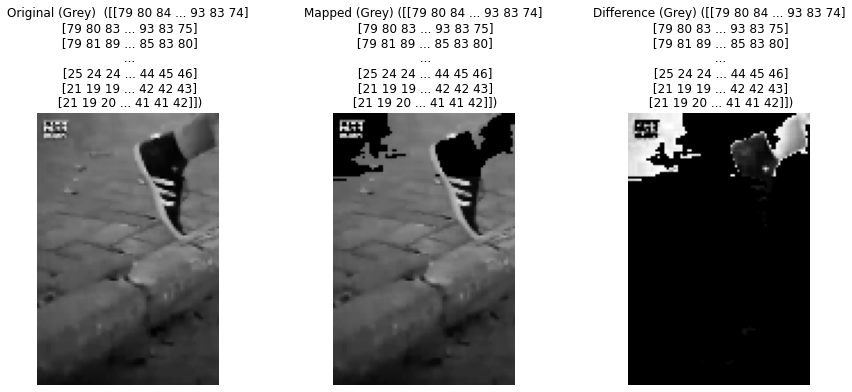

Modified Pixels for 445_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 10), Original: 97, Mapped: 97, New: 0
  Index: 11, Pixel: (0, 11), Original: 98, Mapped: 98, New: 0
  Index: 12, Pixel: (0, 12), Original: 97, Mapped: 97, New: 0
  Index: 13, Pixel: (0, 13), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 14), Original: 95, Mapped: 95, New: 0
  Index: 15, Pixel: (0, 15), Original: 97, Mapped: 97, 

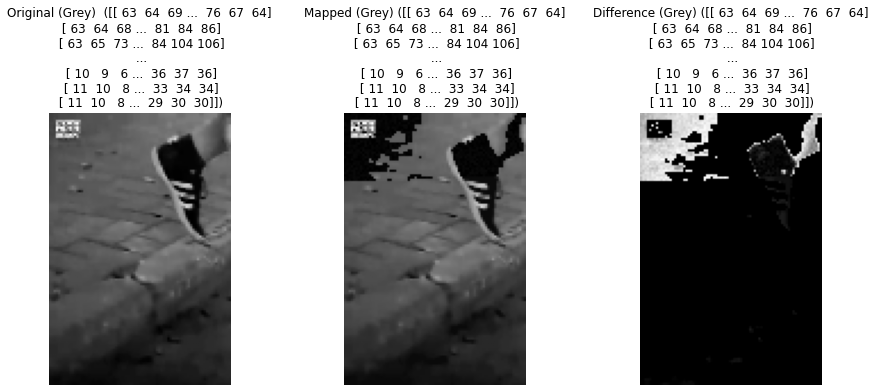

Modified Pixels for 446_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 0
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 4
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 0
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 6
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 8
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 6
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 3
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 1
  Index: 8, Pixel: (0, 8), Original: 73, Mapped: 73, New: 0
  Index: 9, Pixel: (0, 9), Original: 73, Mapped: 73, New: 2
  Index: 10, Pixel: (0, 10), Original: 75, Mapped: 75, New: 5
  Index: 11, Pixel: (0, 11), Original: 76, Mapped: 76, New: 6
  Index: 12, Pixel: (0, 12), Original: 80, Mapped: 80, New: 3
  Index: 13, Pixel: (0, 13), Original: 78, Mapped: 78, New: 7
  Index: 14, Pixel: (0, 14), Original: 79, Mapped: 79, New: 3
  Index: 15, Pixel: (0, 15), Original: 82, Mapped: 82, N

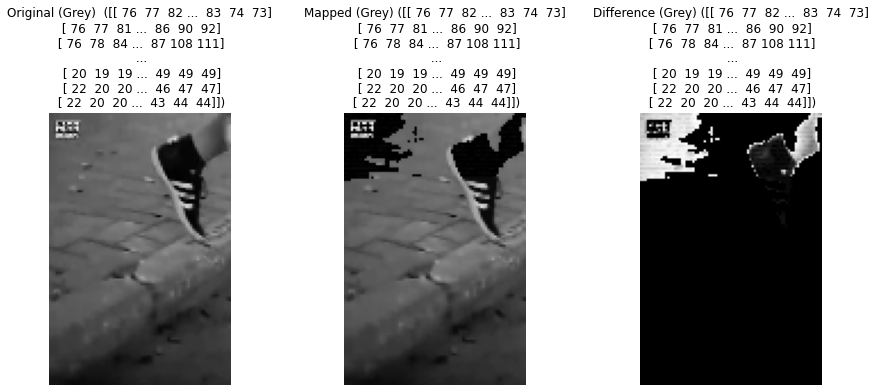

Modified Pixels for 446_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 0
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 9
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 8
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 7
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 6
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 4
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 3
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 1
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 1
  Index: 9, Pixel: (0, 9), Original: 86, Mapped: 86, New: 3
  Index: 10, Pixel: (0, 10), Original: 88, Mapped: 88, New: 5
  Index: 11, Pixel: (0, 11), Original: 88, Mapped: 88, New: 7
  Index: 12, Pixel: (0, 12), Original: 89, Mapped: 89, New: 8
  Index: 13, Pixel: (0, 13), Original: 88, Mapped: 88, New: 9
  Index: 14, Pixel: (0, 14), Original: 88, Mapped: 88, New: 0
  Index: 15, Pixel: (0, 15), Original: 90, Mapped: 90,

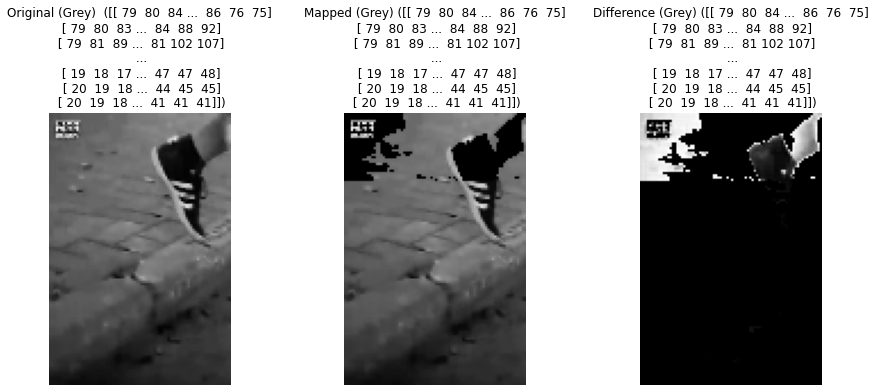

Modified Pixels for 446_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 90, Mapped: 90, New: 0
  Index: 10, Pixel: (0, 10), Original: 92, Mapped: 92, New: 0
  Index: 11, Pixel: (0, 11), Original: 93, Mapped: 93, New: 0
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 0
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 0
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 0
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96, 

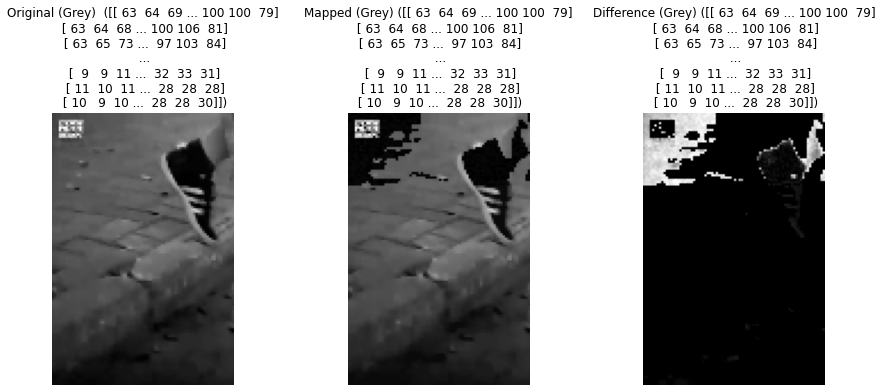

Modified Pixels for 447_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 63, Mapped: 63, New: 8
  Index: 1, Pixel: (0, 1), Original: 64, Mapped: 64, New: 3
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 4
  Index: 3, Pixel: (0, 3), Original: 69, Mapped: 69, New: 1
  Index: 4, Pixel: (0, 4), Original: 74, Mapped: 74, New: 9
  Index: 5, Pixel: (0, 5), Original: 74, Mapped: 74, New: 4
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 7
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 6
  Index: 8, Pixel: (0, 8), Original: 72, Mapped: 72, New: 2
  Index: 9, Pixel: (0, 9), Original: 71, Mapped: 71, New: 4
  Index: 10, Pixel: (0, 10), Original: 69, Mapped: 69, New: 4
  Index: 11, Pixel: (0, 11), Original: 71, Mapped: 71, New: 6
  Index: 12, Pixel: (0, 12), Original: 79, Mapped: 79, New: 6
  Index: 13, Pixel: (0, 13), Original: 78, Mapped: 78, New: 3
  Index: 14, Pixel: (0, 14), Original: 79, Mapped: 79, New: 9
  Index: 15, Pixel: (0, 15), Original: 82, Mapped: 82, N

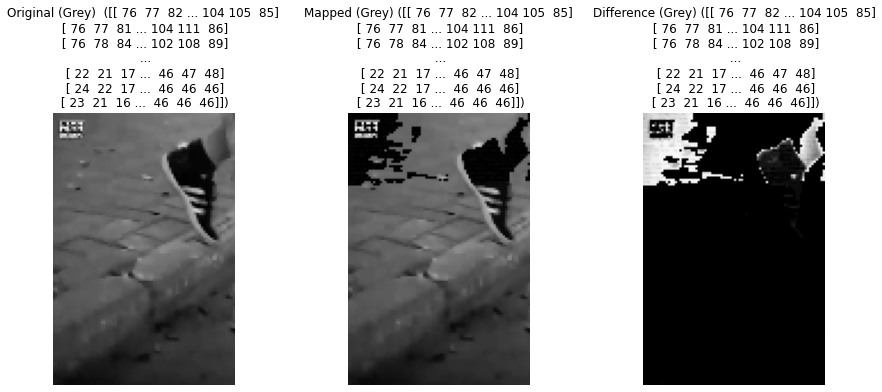

Modified Pixels for 447_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 0
  Index: 1, Pixel: (0, 1), Original: 77, Mapped: 77, New: 0
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 0
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 0
  Index: 4, Pixel: (0, 4), Original: 85, Mapped: 85, New: 0
  Index: 5, Pixel: (0, 5), Original: 87, Mapped: 87, New: 2
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 5
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 8
  Index: 8, Pixel: (0, 8), Original: 84, Mapped: 84, New: 2
  Index: 9, Pixel: (0, 9), Original: 84, Mapped: 84, New: 6
  Index: 10, Pixel: (0, 10), Original: 82, Mapped: 82, New: 9
  Index: 11, Pixel: (0, 11), Original: 83, Mapped: 83, New: 2
  Index: 12, Pixel: (0, 12), Original: 88, Mapped: 88, New: 5
  Index: 13, Pixel: (0, 13), Original: 88, Mapped: 88, New: 6
  Index: 14, Pixel: (0, 14), Original: 88, Mapped: 88, New: 6
  Index: 15, Pixel: (0, 15), Original: 90, Mapped: 90,

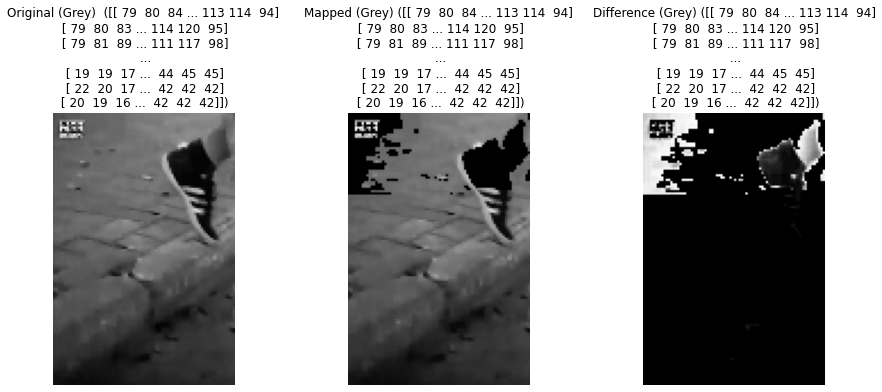

Modified Pixels for 447_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 79, Mapped: 79, New: 0
  Index: 1, Pixel: (0, 1), Original: 80, Mapped: 80, New: 0
  Index: 2, Pixel: (0, 2), Original: 84, Mapped: 84, New: 0
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 89, Mapped: 89, New: 0
  Index: 9, Pixel: (0, 9), Original: 89, Mapped: 89, New: 0
  Index: 10, Pixel: (0, 10), Original: 87, Mapped: 87, New: 0
  Index: 11, Pixel: (0, 11), Original: 88, Mapped: 88, New: 0
  Index: 12, Pixel: (0, 12), Original: 94, Mapped: 94, New: 0
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 0
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 0
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96, 

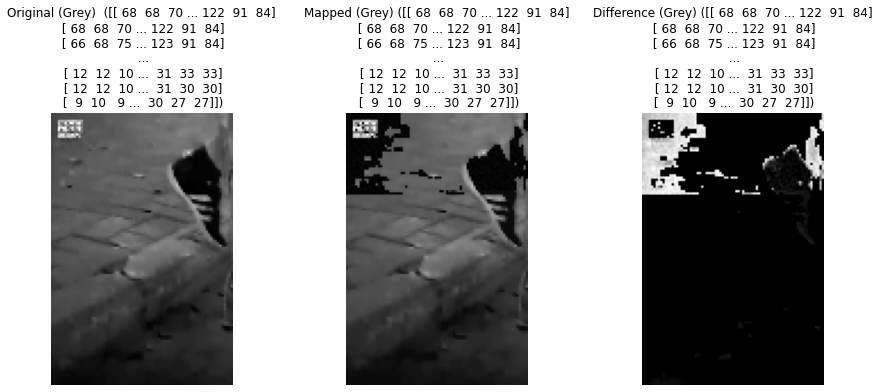

Modified Pixels for 448_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 68, Mapped: 68, New: 2
  Index: 1, Pixel: (0, 1), Original: 68, Mapped: 68, New: 7
  Index: 2, Pixel: (0, 2), Original: 70, Mapped: 70, New: 3
  Index: 3, Pixel: (0, 3), Original: 70, Mapped: 70, New: 6
  Index: 4, Pixel: (0, 4), Original: 76, Mapped: 76, New: 6
  Index: 5, Pixel: (0, 5), Original: 75, Mapped: 75, New: 7
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 1
  Index: 7, Pixel: (0, 7), Original: 75, Mapped: 75, New: 1
  Index: 8, Pixel: (0, 8), Original: 72, Mapped: 72, New: 0
  Index: 9, Pixel: (0, 9), Original: 72, Mapped: 72, New: 5
  Index: 10, Pixel: (0, 10), Original: 73, Mapped: 73, New: 0
  Index: 11, Pixel: (0, 11), Original: 74, Mapped: 74, New: 5
  Index: 12, Pixel: (0, 12), Original: 80, Mapped: 80, New: 5
  Index: 13, Pixel: (0, 13), Original: 78, Mapped: 78, New: 2
  Index: 14, Pixel: (0, 14), Original: 79, Mapped: 79, New: 2
  Index: 15, Pixel: (0, 15), Original: 82, Mapped: 82, N

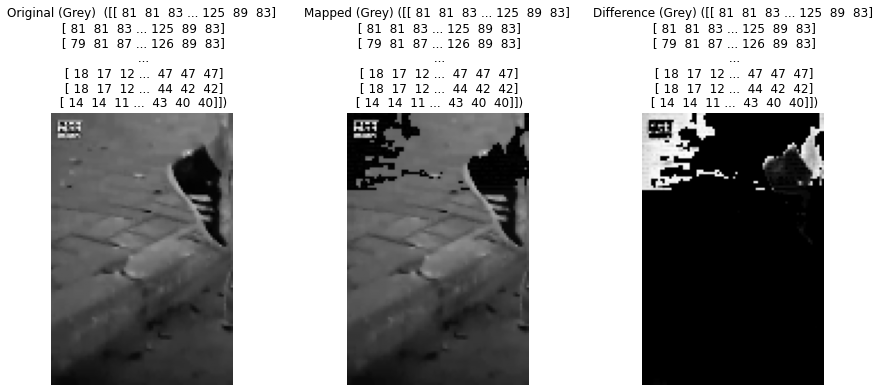

Modified Pixels for 448_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 81, Mapped: 81, New: 7
  Index: 1, Pixel: (0, 1), Original: 81, Mapped: 81, New: 4
  Index: 2, Pixel: (0, 2), Original: 83, Mapped: 83, New: 8
  Index: 3, Pixel: (0, 3), Original: 83, Mapped: 83, New: 1
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 5
  Index: 5, Pixel: (0, 5), Original: 88, Mapped: 88, New: 8
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 3
  Index: 7, Pixel: (0, 7), Original: 85, Mapped: 85, New: 0
  Index: 8, Pixel: (0, 8), Original: 84, Mapped: 84, New: 2
  Index: 9, Pixel: (0, 9), Original: 84, Mapped: 84, New: 4
  Index: 10, Pixel: (0, 10), Original: 86, Mapped: 86, New: 5
  Index: 11, Pixel: (0, 11), Original: 87, Mapped: 87, New: 4
  Index: 12, Pixel: (0, 12), Original: 89, Mapped: 89, New: 4
  Index: 13, Pixel: (0, 13), Original: 88, Mapped: 88, New: 3
  Index: 14, Pixel: (0, 14), Original: 88, Mapped: 88, New: 3
  Index: 15, Pixel: (0, 15), Original: 90, Mapped: 90,

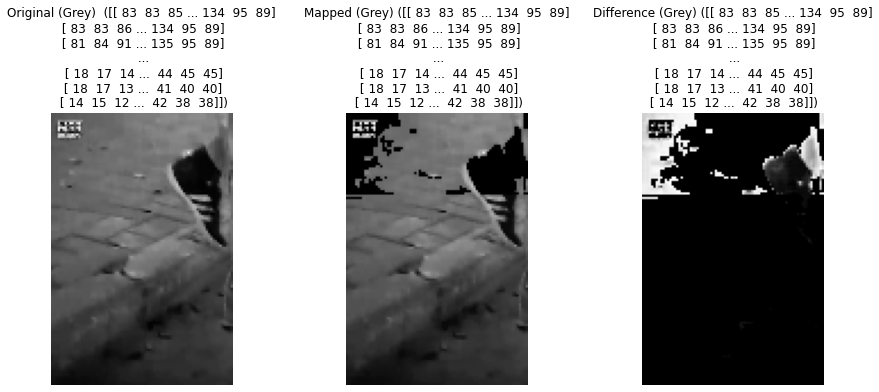

Modified Pixels for 448_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 83, Mapped: 83, New: 0
  Index: 1, Pixel: (0, 1), Original: 83, Mapped: 83, New: 0
  Index: 2, Pixel: (0, 2), Original: 85, Mapped: 85, New: 0
  Index: 3, Pixel: (0, 3), Original: 85, Mapped: 85, New: 0
  Index: 4, Pixel: (0, 4), Original: 83, Mapped: 83, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 89, Mapped: 89, New: 0
  Index: 9, Pixel: (0, 9), Original: 89, Mapped: 89, New: 0
  Index: 10, Pixel: (0, 10), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 11), Original: 91, Mapped: 91, New: 0
  Index: 12, Pixel: (0, 12), Original: 95, Mapped: 95, New: 0
  Index: 13, Pixel: (0, 13), Original: 94, Mapped: 94, New: 0
  Index: 14, Pixel: (0, 14), Original: 94, Mapped: 94, New: 0
  Index: 15, Pixel: (0, 15), Original: 96, Mapped: 96, 

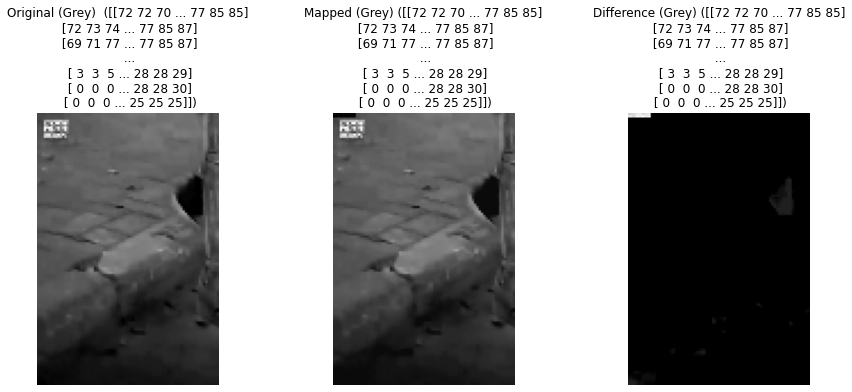

Modified Pixels for 449_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 72, Mapped: 72, New: 9
  Index: 1, Pixel: (0, 1), Original: 72, Mapped: 72, New: 7
  Index: 2, Pixel: (0, 2), Original: 70, Mapped: 70, New: 4
  Index: 3, Pixel: (0, 3), Original: 71, Mapped: 71, New: 3
  Index: 4, Pixel: (0, 4), Original: 79, Mapped: 79, New: 8
  Index: 5, Pixel: (0, 5), Original: 75, Mapped: 75, New: 3
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 9
  Index: 7, Pixel: (0, 7), Original: 74, Mapped: 74, New: 7
  Index: 8, Pixel: (0, 8), Original: 74, Mapped: 74, New: 5
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 4
  Index: 10, Pixel: (1, 0), Original: 72, Mapped: 72, New: 0
  Index: 11, Pixel: (1, 1), Original: 73, Mapped: 73, New: 2
  Index: 12, Pixel: (1, 2), Original: 74, Mapped: 74, New: 9
  Index: 13, Pixel: (1, 3), Original: 75, Mapped: 75, New: 2
  Index: 14, Pixel: (1, 4), Original: 79, Mapped: 79, New: 4
  Index: 15, Pixel: (1, 5), Original: 80, Mapped: 80, New: 7


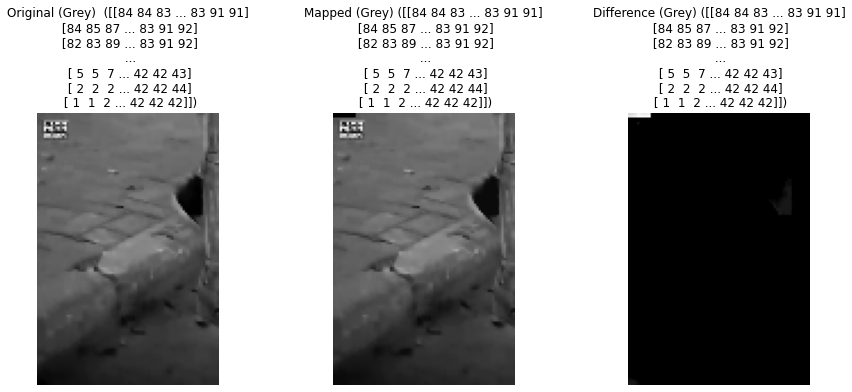

Modified Pixels for 449_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 84, Mapped: 84, New: 5
  Index: 1, Pixel: (0, 1), Original: 84, Mapped: 84, New: 4
  Index: 2, Pixel: (0, 2), Original: 83, Mapped: 83, New: 2
  Index: 3, Pixel: (0, 3), Original: 84, Mapped: 84, New: 1
  Index: 4, Pixel: (0, 4), Original: 91, Mapped: 91, New: 0
  Index: 5, Pixel: (0, 5), Original: 88, Mapped: 88, New: 1
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 2
  Index: 7, Pixel: (0, 7), Original: 86, Mapped: 86, New: 1
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 0
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (1, 0), Original: 84, Mapped: 84, New: 0
  Index: 11, Pixel: (1, 1), Original: 85, Mapped: 85, New: 0
  Index: 12, Pixel: (1, 2), Original: 87, Mapped: 87, New: 0
  Index: 13, Pixel: (1, 3), Original: 88, Mapped: 88, New: 0
  Index: 14, Pixel: (1, 4), Original: 91, Mapped: 91, New: 0
  Index: 15, Pixel: (1, 5), Original: 92, Mapped: 92, New: 

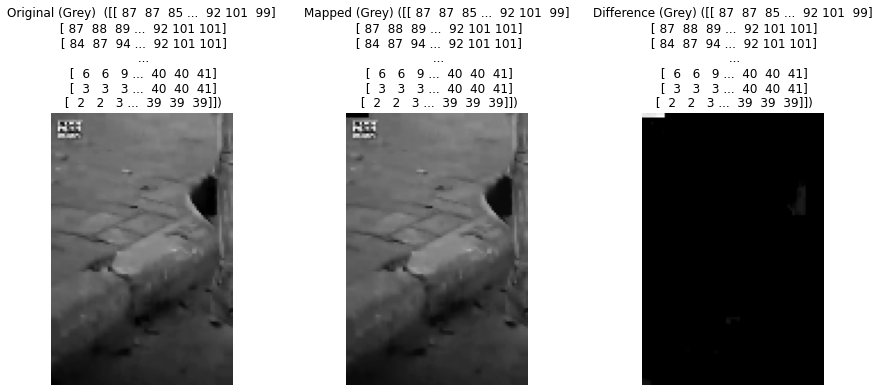

Modified Pixels for 449_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 87, Mapped: 87, New: 0
  Index: 1, Pixel: (0, 1), Original: 87, Mapped: 87, New: 0
  Index: 2, Pixel: (0, 2), Original: 85, Mapped: 85, New: 0
  Index: 3, Pixel: (0, 3), Original: 85, Mapped: 85, New: 0
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 0
  Index: 5, Pixel: (0, 5), Original: 85, Mapped: 85, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 91, Mapped: 91, New: 0
  Index: 10, Pixel: (1, 0), Original: 87, Mapped: 87, New: 1
  Index: 11, Pixel: (1, 1), Original: 88, Mapped: 88, New: 1
  Index: 12, Pixel: (1, 2), Original: 89, Mapped: 89, New: 1
  Index: 13, Pixel: (1, 3), Original: 89, Mapped: 89, New: 1
  Index: 14, Pixel: (1, 4), Original: 88, Mapped: 88, New: 0
  Index: 15, Pixel: (1, 5), Original: 90, Mapped: 90, New: 0

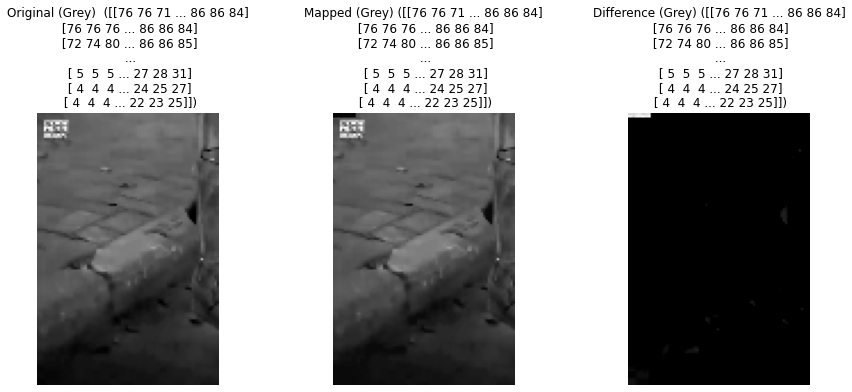

Modified Pixels for 450_Red_Left:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 9
  Index: 1, Pixel: (0, 1), Original: 76, Mapped: 76, New: 7
  Index: 2, Pixel: (0, 2), Original: 71, Mapped: 71, New: 4
  Index: 3, Pixel: (0, 3), Original: 72, Mapped: 72, New: 3
  Index: 4, Pixel: (0, 4), Original: 81, Mapped: 81, New: 8
  Index: 5, Pixel: (0, 5), Original: 75, Mapped: 75, New: 3
  Index: 6, Pixel: (0, 6), Original: 74, Mapped: 74, New: 9
  Index: 7, Pixel: (0, 7), Original: 74, Mapped: 74, New: 7
  Index: 8, Pixel: (0, 8), Original: 74, Mapped: 74, New: 5
  Index: 9, Pixel: (0, 9), Original: 74, Mapped: 74, New: 4
  Index: 10, Pixel: (1, 0), Original: 76, Mapped: 76, New: 0
  Index: 11, Pixel: (1, 1), Original: 76, Mapped: 76, New: 2
  Index: 12, Pixel: (1, 2), Original: 76, Mapped: 76, New: 9
  Index: 13, Pixel: (1, 3), Original: 78, Mapped: 78, New: 2
  Index: 14, Pixel: (1, 4), Original: 82, Mapped: 82, New: 4
  Index: 15, Pixel: (1, 5), Original: 82, Mapped: 82, New: 7


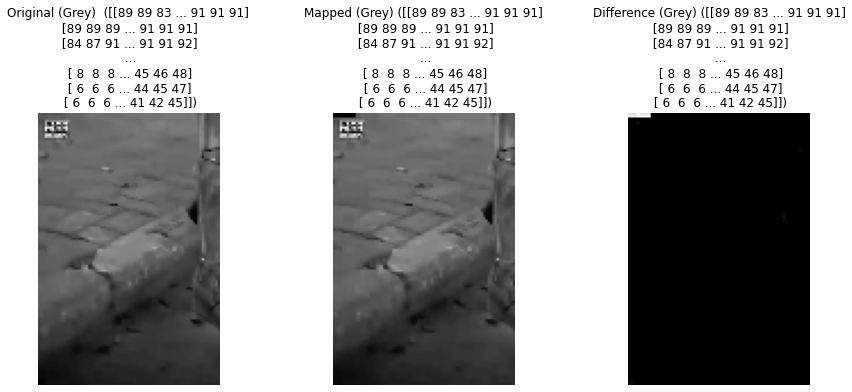

Modified Pixels for 450_Green_Left:
  Index: 0, Pixel: (0, 0), Original: 89, Mapped: 89, New: 5
  Index: 1, Pixel: (0, 1), Original: 89, Mapped: 89, New: 4
  Index: 2, Pixel: (0, 2), Original: 83, Mapped: 83, New: 2
  Index: 3, Pixel: (0, 3), Original: 85, Mapped: 85, New: 1
  Index: 4, Pixel: (0, 4), Original: 94, Mapped: 94, New: 0
  Index: 5, Pixel: (0, 5), Original: 88, Mapped: 88, New: 1
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 2
  Index: 7, Pixel: (0, 7), Original: 86, Mapped: 86, New: 1
  Index: 8, Pixel: (0, 8), Original: 86, Mapped: 86, New: 0
  Index: 9, Pixel: (0, 9), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (1, 0), Original: 89, Mapped: 89, New: 0
  Index: 11, Pixel: (1, 1), Original: 89, Mapped: 89, New: 0
  Index: 12, Pixel: (1, 2), Original: 89, Mapped: 89, New: 0
  Index: 13, Pixel: (1, 3), Original: 90, Mapped: 90, New: 0
  Index: 14, Pixel: (1, 4), Original: 95, Mapped: 95, New: 0
  Index: 15, Pixel: (1, 5), Original: 95, Mapped: 95, New: 

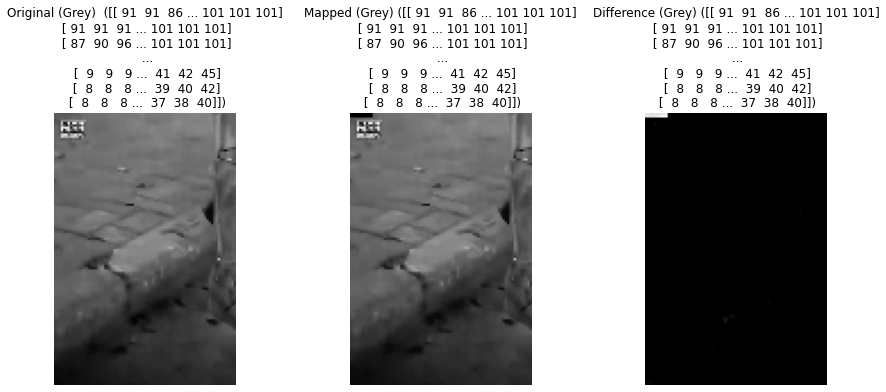

Modified Pixels for 450_Blue_Left:
  Index: 0, Pixel: (0, 0), Original: 91, Mapped: 91, New: 0
  Index: 1, Pixel: (0, 1), Original: 91, Mapped: 91, New: 0
  Index: 2, Pixel: (0, 2), Original: 86, Mapped: 86, New: 0
  Index: 3, Pixel: (0, 3), Original: 86, Mapped: 86, New: 0
  Index: 4, Pixel: (0, 4), Original: 90, Mapped: 90, New: 0
  Index: 5, Pixel: (0, 5), Original: 86, Mapped: 86, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 7), Original: 90, Mapped: 90, New: 0
  Index: 8, Pixel: (0, 8), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (1, 0), Original: 91, Mapped: 91, New: 1
  Index: 11, Pixel: (1, 1), Original: 91, Mapped: 91, New: 1
  Index: 12, Pixel: (1, 2), Original: 91, Mapped: 91, New: 1
  Index: 13, Pixel: (1, 3), Original: 91, Mapped: 91, New: 1
  Index: 14, Pixel: (1, 4), Original: 92, Mapped: 92, New: 0
  Index: 15, Pixel: (1, 5), Original: 92, Mapped: 92, New: 0

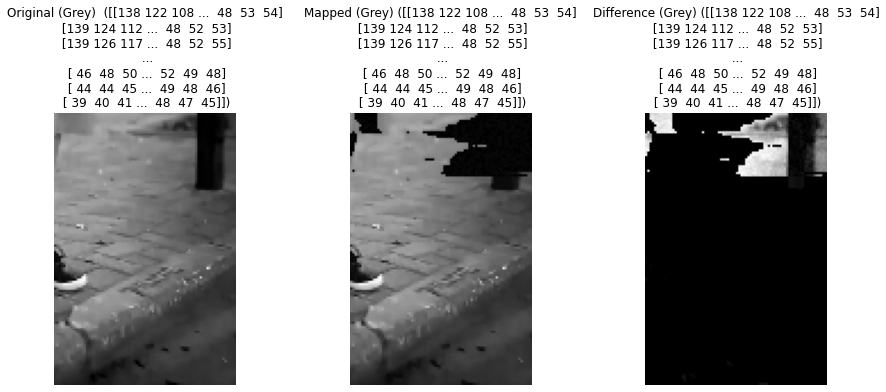

Modified Pixels for 420_Red_Right:
  Index: 0, Pixel: (0, 2), Original: 108, Mapped: 108, New: 8
  Index: 1, Pixel: (0, 3), Original: 107, Mapped: 107, New: 2
  Index: 2, Pixel: (0, 4), Original: 105, Mapped: 105, New: 8
  Index: 3, Pixel: (0, 5), Original: 105, Mapped: 105, New: 6
  Index: 4, Pixel: (0, 6), Original: 108, Mapped: 108, New: 1
  Index: 5, Pixel: (0, 7), Original: 109, Mapped: 109, New: 2
  Index: 6, Pixel: (0, 8), Original: 108, Mapped: 108, New: 4
  Index: 7, Pixel: (0, 9), Original: 108, Mapped: 108, New: 2
  Index: 8, Pixel: (0, 10), Original: 110, Mapped: 110, New: 0
  Index: 9, Pixel: (0, 11), Original: 113, Mapped: 113, New: 7
  Index: 10, Pixel: (0, 56), Original: 114, Mapped: 114, New: 8
  Index: 11, Pixel: (0, 57), Original: 108, Mapped: 108, New: 1
  Index: 12, Pixel: (0, 58), Original: 102, Mapped: 102, New: 4
  Index: 13, Pixel: (0, 59), Original: 95, Mapped: 95, New: 1
  Index: 14, Pixel: (0, 60), Original: 95, Mapped: 95, New: 5
  Index: 15, Pixel: (0, 61)

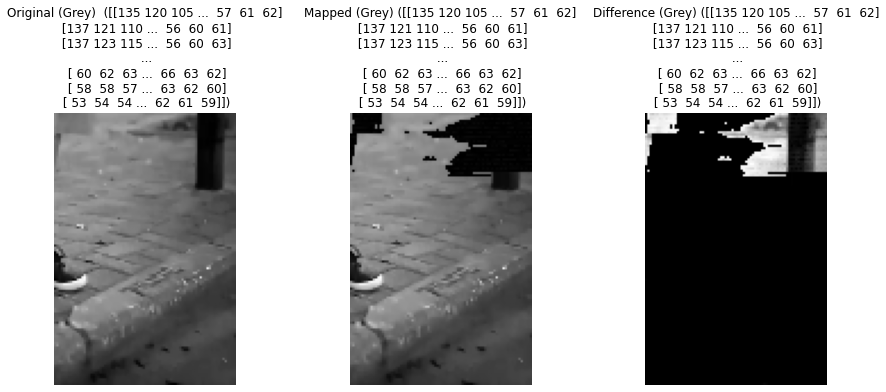

Modified Pixels for 420_Green_Right:
  Index: 0, Pixel: (0, 1), Original: 120, Mapped: 120, New: 0
  Index: 1, Pixel: (0, 2), Original: 105, Mapped: 105, New: 4
  Index: 2, Pixel: (0, 3), Original: 106, Mapped: 106, New: 9
  Index: 3, Pixel: (0, 4), Original: 110, Mapped: 110, New: 4
  Index: 4, Pixel: (0, 5), Original: 111, Mapped: 111, New: 8
  Index: 5, Pixel: (0, 6), Original: 113, Mapped: 113, New: 2
  Index: 6, Pixel: (0, 7), Original: 115, Mapped: 115, New: 5
  Index: 7, Pixel: (0, 8), Original: 113, Mapped: 113, New: 7
  Index: 8, Pixel: (0, 9), Original: 113, Mapped: 113, New: 7
  Index: 9, Pixel: (0, 10), Original: 116, Mapped: 116, New: 7
  Index: 10, Pixel: (0, 11), Original: 118, Mapped: 118, New: 6
  Index: 11, Pixel: (0, 12), Original: 120, Mapped: 120, New: 5
  Index: 12, Pixel: (0, 13), Original: 121, Mapped: 121, New: 4
  Index: 13, Pixel: (0, 57), Original: 121, Mapped: 121, New: 2
  Index: 14, Pixel: (0, 58), Original: 114, Mapped: 114, New: 0
  Index: 15, Pixel: (0

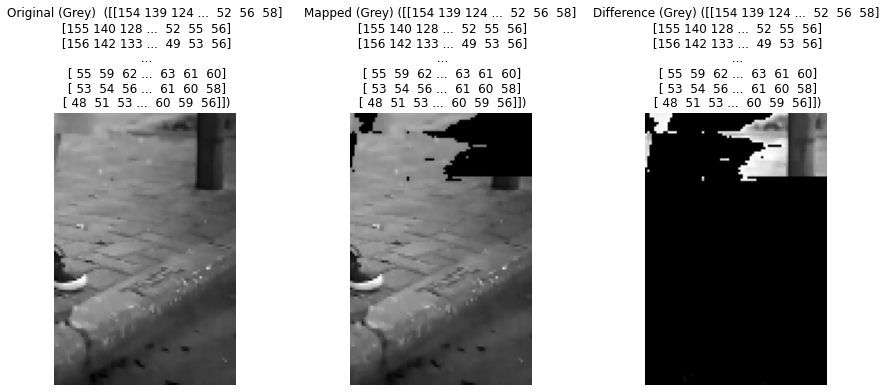

Modified Pixels for 420_Blue_Right:
  Index: 0, Pixel: (0, 2), Original: 124, Mapped: 124, New: 0
  Index: 1, Pixel: (0, 3), Original: 123, Mapped: 123, New: 0
  Index: 2, Pixel: (0, 4), Original: 121, Mapped: 121, New: 0
  Index: 3, Pixel: (0, 5), Original: 120, Mapped: 120, New: 0
  Index: 4, Pixel: (0, 6), Original: 123, Mapped: 123, New: 0
  Index: 5, Pixel: (0, 7), Original: 124, Mapped: 124, New: 0
  Index: 6, Pixel: (0, 8), Original: 123, Mapped: 123, New: 0
  Index: 7, Pixel: (0, 9), Original: 123, Mapped: 123, New: 0
  Index: 8, Pixel: (0, 10), Original: 125, Mapped: 125, New: 0
  Index: 9, Pixel: (0, 11), Original: 127, Mapped: 127, New: 0
  Index: 10, Pixel: (0, 56), Original: 127, Mapped: 127, New: 0
  Index: 11, Pixel: (0, 57), Original: 121, Mapped: 121, New: 0
  Index: 12, Pixel: (0, 58), Original: 114, Mapped: 114, New: 0
  Index: 13, Pixel: (0, 59), Original: 108, Mapped: 108, New: 0
  Index: 14, Pixel: (0, 60), Original: 112, Mapped: 112, New: 0
  Index: 15, Pixel: (0

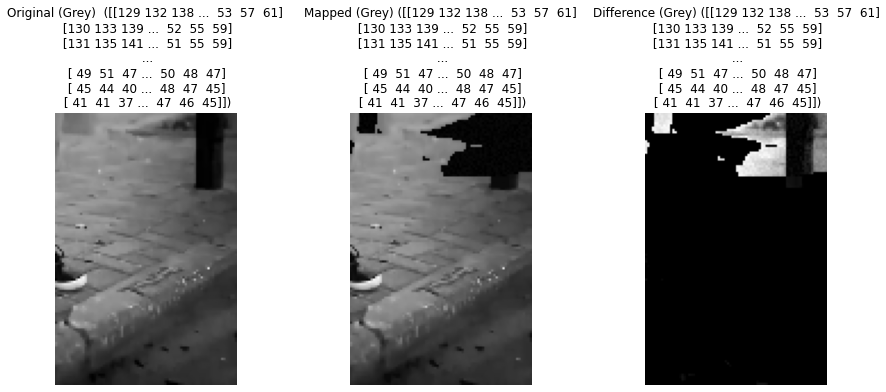

Modified Pixels for 421_Red_Right:
  Index: 0, Pixel: (0, 4), Original: 107, Mapped: 107, New: 0
  Index: 1, Pixel: (0, 5), Original: 105, Mapped: 105, New: 9
  Index: 2, Pixel: (0, 6), Original: 108, Mapped: 108, New: 0
  Index: 3, Pixel: (0, 7), Original: 109, Mapped: 109, New: 4
  Index: 4, Pixel: (0, 8), Original: 108, Mapped: 108, New: 5
  Index: 5, Pixel: (0, 9), Original: 108, Mapped: 108, New: 3
  Index: 6, Pixel: (0, 10), Original: 110, Mapped: 110, New: 3
  Index: 7, Pixel: (0, 11), Original: 113, Mapped: 113, New: 1
  Index: 8, Pixel: (0, 55), Original: 114, Mapped: 114, New: 8
  Index: 9, Pixel: (0, 56), Original: 97, Mapped: 97, New: 8
  Index: 10, Pixel: (0, 57), Original: 92, Mapped: 92, New: 0
  Index: 11, Pixel: (0, 58), Original: 83, Mapped: 83, New: 4
  Index: 12, Pixel: (0, 59), Original: 82, Mapped: 82, New: 8
  Index: 13, Pixel: (0, 60), Original: 84, Mapped: 84, New: 6
  Index: 14, Pixel: (0, 61), Original: 74, Mapped: 74, New: 9
  Index: 15, Pixel: (0, 62), Orig

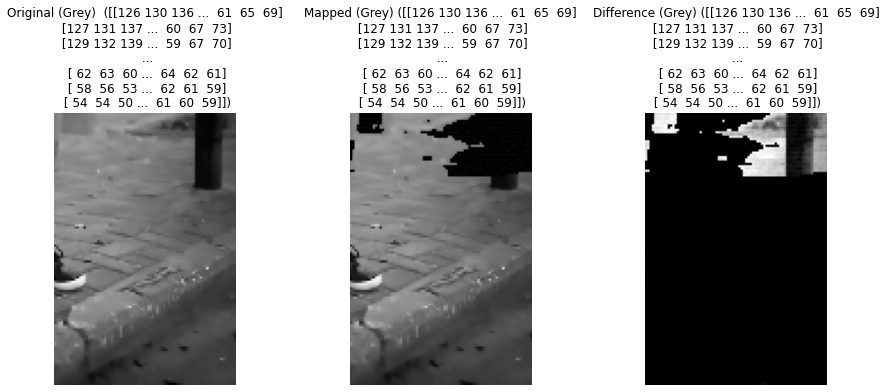

Modified Pixels for 421_Green_Right:
  Index: 0, Pixel: (0, 4), Original: 110, Mapped: 110, New: 4
  Index: 1, Pixel: (0, 5), Original: 111, Mapped: 111, New: 4
  Index: 2, Pixel: (0, 6), Original: 113, Mapped: 113, New: 3
  Index: 3, Pixel: (0, 7), Original: 115, Mapped: 115, New: 2
  Index: 4, Pixel: (0, 8), Original: 113, Mapped: 113, New: 0
  Index: 5, Pixel: (0, 9), Original: 113, Mapped: 113, New: 8
  Index: 6, Pixel: (0, 10), Original: 116, Mapped: 116, New: 7
  Index: 7, Pixel: (0, 11), Original: 118, Mapped: 118, New: 6
  Index: 8, Pixel: (0, 12), Original: 120, Mapped: 120, New: 5
  Index: 9, Pixel: (0, 13), Original: 121, Mapped: 121, New: 5
  Index: 10, Pixel: (0, 55), Original: 122, Mapped: 122, New: 7
  Index: 11, Pixel: (0, 56), Original: 110, Mapped: 110, New: 9
  Index: 12, Pixel: (0, 57), Original: 104, Mapped: 104, New: 1
  Index: 13, Pixel: (0, 58), Original: 96, Mapped: 96, New: 2
  Index: 14, Pixel: (0, 59), Original: 101, Mapped: 101, New: 3
  Index: 15, Pixel: (

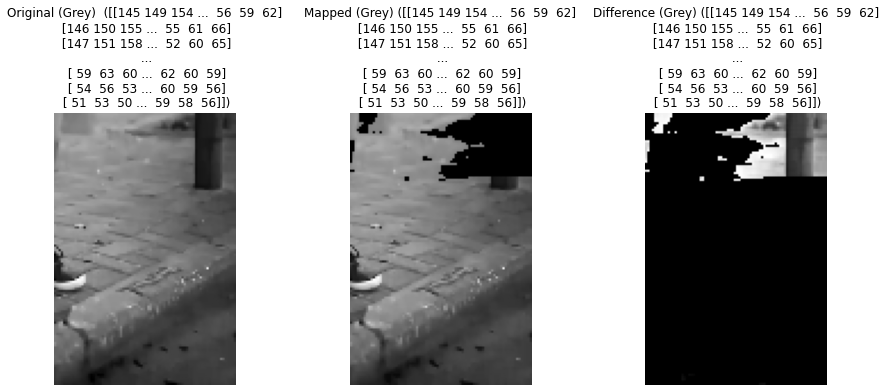

Modified Pixels for 421_Blue_Right:
  Index: 0, Pixel: (0, 4), Original: 122, Mapped: 122, New: 0
  Index: 1, Pixel: (0, 5), Original: 120, Mapped: 120, New: 0
  Index: 2, Pixel: (0, 6), Original: 123, Mapped: 123, New: 0
  Index: 3, Pixel: (0, 7), Original: 124, Mapped: 124, New: 0
  Index: 4, Pixel: (0, 8), Original: 123, Mapped: 123, New: 0
  Index: 5, Pixel: (0, 9), Original: 123, Mapped: 123, New: 0
  Index: 6, Pixel: (0, 10), Original: 125, Mapped: 125, New: 0
  Index: 7, Pixel: (0, 11), Original: 127, Mapped: 127, New: 0
  Index: 8, Pixel: (0, 55), Original: 127, Mapped: 127, New: 0
  Index: 9, Pixel: (0, 56), Original: 110, Mapped: 110, New: 0
  Index: 10, Pixel: (0, 57), Original: 104, Mapped: 104, New: 0
  Index: 11, Pixel: (0, 58), Original: 96, Mapped: 96, New: 0
  Index: 12, Pixel: (0, 59), Original: 99, Mapped: 99, New: 0
  Index: 13, Pixel: (0, 60), Original: 102, Mapped: 102, New: 0
  Index: 14, Pixel: (0, 61), Original: 91, Mapped: 91, New: 0
  Index: 15, Pixel: (0, 62

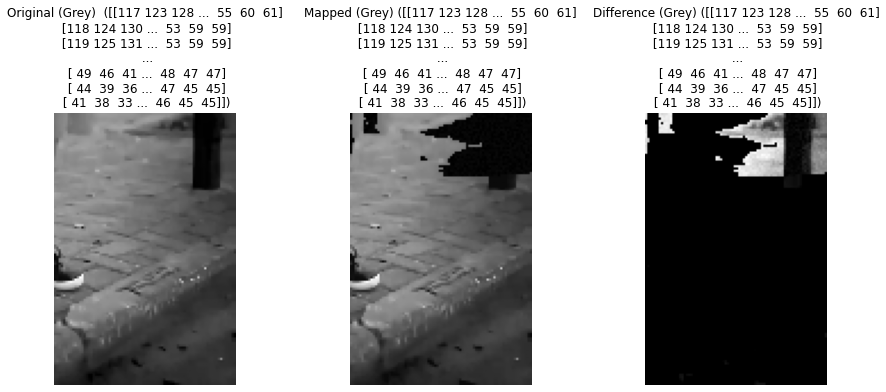

Modified Pixels for 422_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 117, Mapped: 117, New: 3
  Index: 1, Pixel: (0, 6), Original: 116, Mapped: 116, New: 7
  Index: 2, Pixel: (0, 7), Original: 108, Mapped: 108, New: 8
  Index: 3, Pixel: (0, 8), Original: 107, Mapped: 107, New: 4
  Index: 4, Pixel: (0, 9), Original: 110, Mapped: 110, New: 6
  Index: 5, Pixel: (0, 10), Original: 112, Mapped: 112, New: 1
  Index: 6, Pixel: (0, 11), Original: 118, Mapped: 118, New: 1
  Index: 7, Pixel: (0, 54), Original: 119, Mapped: 119, New: 8
  Index: 8, Pixel: (0, 55), Original: 105, Mapped: 105, New: 2
  Index: 9, Pixel: (0, 56), Original: 94, Mapped: 94, New: 9
  Index: 10, Pixel: (0, 57), Original: 86, Mapped: 86, New: 7
  Index: 11, Pixel: (0, 58), Original: 81, Mapped: 81, New: 4
  Index: 12, Pixel: (0, 59), Original: 84, Mapped: 84, New: 2
  Index: 13, Pixel: (0, 60), Original: 77, Mapped: 77, New: 3
  Index: 14, Pixel: (0, 61), Original: 32, Mapped: 32, New: 6
  Index: 15, Pixel: (0, 62), Ori

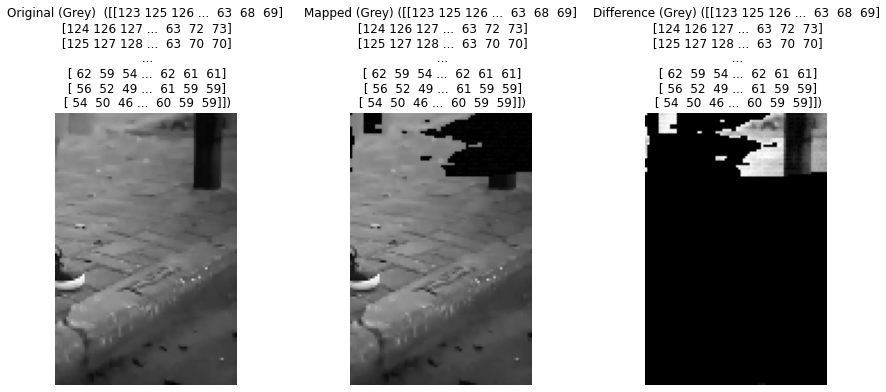

Modified Pixels for 422_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 123, Mapped: 123, New: 7
  Index: 1, Pixel: (0, 6), Original: 114, Mapped: 114, New: 2
  Index: 2, Pixel: (0, 7), Original: 106, Mapped: 106, New: 7
  Index: 3, Pixel: (0, 8), Original: 111, Mapped: 111, New: 1
  Index: 4, Pixel: (0, 9), Original: 116, Mapped: 116, New: 6
  Index: 5, Pixel: (0, 10), Original: 118, Mapped: 118, New: 1
  Index: 6, Pixel: (0, 11), Original: 120, Mapped: 120, New: 2
  Index: 7, Pixel: (0, 12), Original: 120, Mapped: 120, New: 5
  Index: 8, Pixel: (0, 13), Original: 123, Mapped: 123, New: 6
  Index: 9, Pixel: (0, 55), Original: 116, Mapped: 116, New: 7
  Index: 10, Pixel: (0, 56), Original: 106, Mapped: 106, New: 6
  Index: 11, Pixel: (0, 57), Original: 99, Mapped: 99, New: 5
  Index: 12, Pixel: (0, 58), Original: 97, Mapped: 97, New: 3
  Index: 13, Pixel: (0, 59), Original: 104, Mapped: 104, New: 2
  Index: 14, Pixel: (0, 60), Original: 97, Mapped: 97, New: 2
  Index: 15, Pixel: (0, 

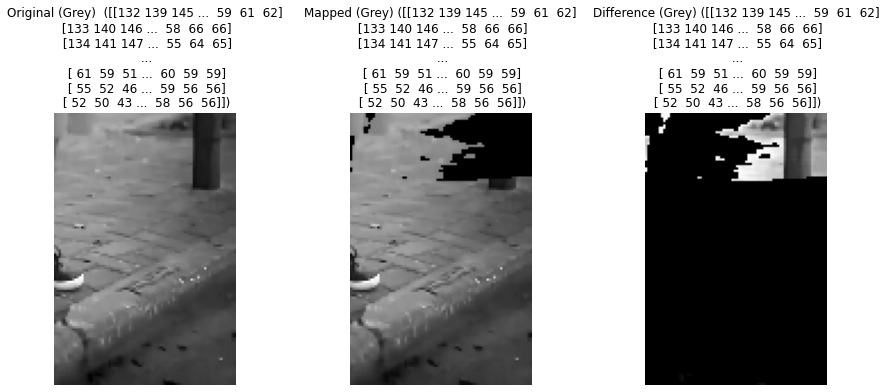

Modified Pixels for 422_Blue_Right:
  Index: 0, Pixel: (0, 7), Original: 123, Mapped: 123, New: 0
  Index: 1, Pixel: (0, 8), Original: 123, Mapped: 123, New: 0
  Index: 2, Pixel: (0, 9), Original: 125, Mapped: 125, New: 0
  Index: 3, Pixel: (0, 10), Original: 127, Mapped: 127, New: 0
  Index: 4, Pixel: (0, 55), Original: 117, Mapped: 117, New: 0
  Index: 5, Pixel: (0, 56), Original: 106, Mapped: 106, New: 0
  Index: 6, Pixel: (0, 57), Original: 99, Mapped: 99, New: 0
  Index: 7, Pixel: (0, 58), Original: 96, Mapped: 96, New: 0
  Index: 8, Pixel: (0, 59), Original: 102, Mapped: 102, New: 0
  Index: 9, Pixel: (0, 60), Original: 95, Mapped: 95, New: 0
  Index: 10, Pixel: (0, 61), Original: 49, Mapped: 49, New: 0
  Index: 11, Pixel: (0, 62), Original: 17, Mapped: 17, New: 0
  Index: 12, Pixel: (0, 63), Original: 26, Mapped: 26, New: 0
  Index: 13, Pixel: (0, 64), Original: 29, Mapped: 29, New: 0
  Index: 14, Pixel: (0, 65), Original: 31, Mapped: 31, New: 0
  Index: 15, Pixel: (0, 66), Orig

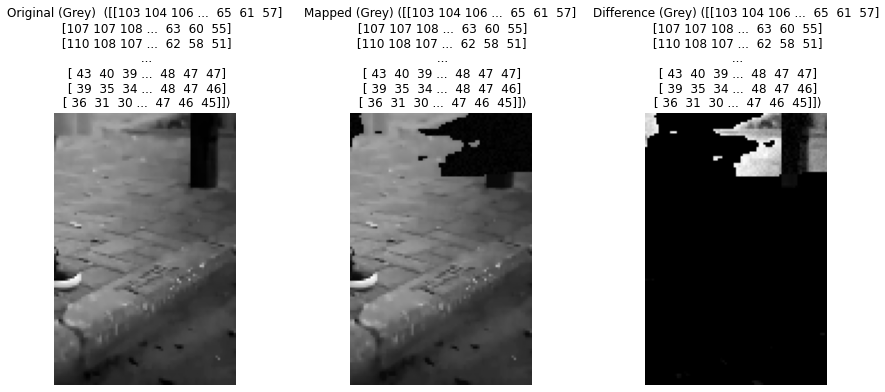

Modified Pixels for 423_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 103, Mapped: 103, New: 5
  Index: 1, Pixel: (0, 1), Original: 104, Mapped: 104, New: 4
  Index: 2, Pixel: (0, 2), Original: 106, Mapped: 106, New: 2
  Index: 3, Pixel: (0, 3), Original: 111, Mapped: 111, New: 3
  Index: 4, Pixel: (0, 4), Original: 118, Mapped: 118, New: 5
  Index: 5, Pixel: (0, 52), Original: 116, Mapped: 116, New: 0
  Index: 6, Pixel: (0, 53), Original: 110, Mapped: 110, New: 3
  Index: 7, Pixel: (0, 54), Original: 93, Mapped: 93, New: 2
  Index: 8, Pixel: (0, 55), Original: 79, Mapped: 79, New: 2
  Index: 9, Pixel: (0, 56), Original: 69, Mapped: 69, New: 2
  Index: 10, Pixel: (0, 57), Original: 72, Mapped: 72, New: 5
  Index: 11, Pixel: (0, 58), Original: 73, Mapped: 73, New: 1
  Index: 12, Pixel: (0, 59), Original: 63, Mapped: 63, New: 7
  Index: 13, Pixel: (0, 60), Original: 10, Mapped: 10, New: 5
  Index: 14, Pixel: (0, 61), Original: 1, Mapped: 10, New: 9
  Index: 15, Pixel: (0, 62), Original

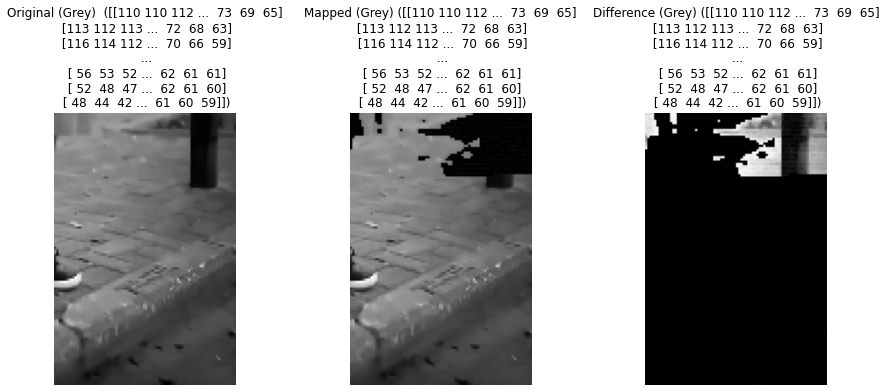

Modified Pixels for 423_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 110, Mapped: 110, New: 5
  Index: 1, Pixel: (0, 1), Original: 110, Mapped: 110, New: 2
  Index: 2, Pixel: (0, 2), Original: 112, Mapped: 112, New: 8
  Index: 3, Pixel: (0, 3), Original: 117, Mapped: 117, New: 4
  Index: 4, Pixel: (0, 11), Original: 120, Mapped: 120, New: 0
  Index: 5, Pixel: (0, 12), Original: 120, Mapped: 120, New: 3
  Index: 6, Pixel: (0, 13), Original: 121, Mapped: 121, New: 6
  Index: 7, Pixel: (0, 54), Original: 111, Mapped: 111, New: 0
  Index: 8, Pixel: (0, 55), Original: 99, Mapped: 99, New: 2
  Index: 9, Pixel: (0, 56), Original: 89, Mapped: 89, New: 5
  Index: 10, Pixel: (0, 57), Original: 88, Mapped: 88, New: 6
  Index: 11, Pixel: (0, 58), Original: 92, Mapped: 92, New: 8
  Index: 12, Pixel: (0, 59), Original: 83, Mapped: 83, New: 0
  Index: 13, Pixel: (0, 60), Original: 24, Mapped: 24, New: 1
  Index: 14, Pixel: (0, 61), Original: 9, Mapped: 10, New: 3
  Index: 15, Pixel: (0, 62), Ori

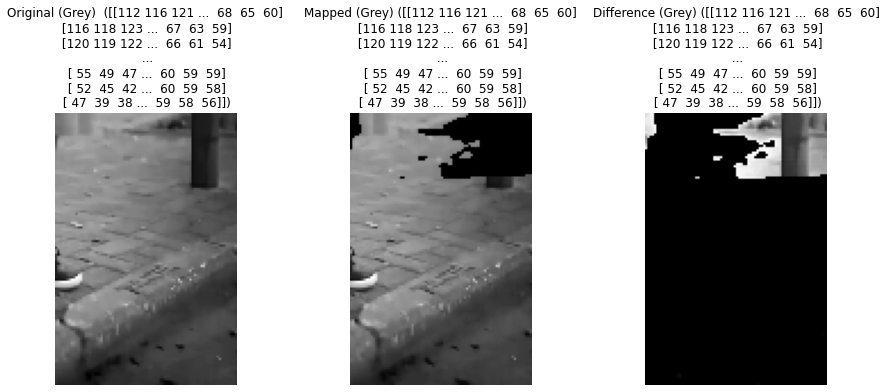

Modified Pixels for 423_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 112, Mapped: 112, New: 0
  Index: 1, Pixel: (0, 1), Original: 116, Mapped: 116, New: 0
  Index: 2, Pixel: (0, 2), Original: 121, Mapped: 121, New: 0
  Index: 3, Pixel: (0, 3), Original: 126, Mapped: 126, New: 0
  Index: 4, Pixel: (0, 52), Original: 129, Mapped: 129, New: 0
  Index: 5, Pixel: (0, 53), Original: 128, Mapped: 128, New: 0
  Index: 6, Pixel: (0, 54), Original: 110, Mapped: 110, New: 0
  Index: 7, Pixel: (0, 55), Original: 96, Mapped: 96, New: 0
  Index: 8, Pixel: (0, 56), Original: 87, Mapped: 87, New: 0
  Index: 9, Pixel: (0, 57), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (0, 58), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 59), Original: 81, Mapped: 81, New: 0
  Index: 12, Pixel: (0, 60), Original: 31, Mapped: 31, New: 0
  Index: 13, Pixel: (0, 61), Original: 26, Mapped: 26, New: 0
  Index: 14, Pixel: (0, 62), Original: 31, Mapped: 31, New: 0
  Index: 15, Pixel: (0, 63), Origi

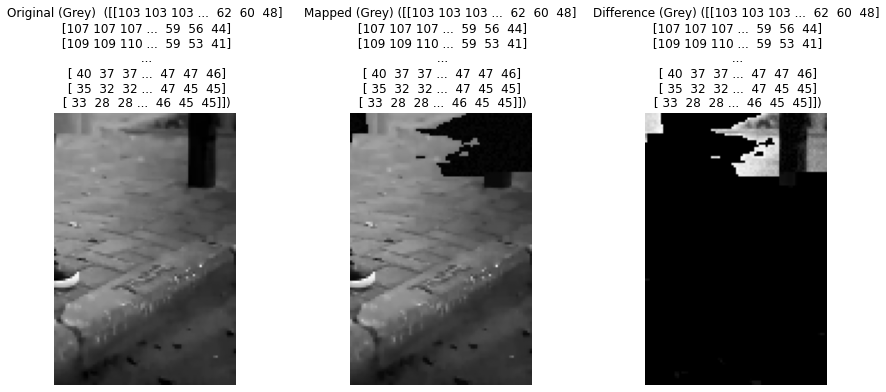

Modified Pixels for 424_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 103, Mapped: 103, New: 5
  Index: 1, Pixel: (0, 1), Original: 103, Mapped: 103, New: 6
  Index: 2, Pixel: (0, 2), Original: 103, Mapped: 103, New: 4
  Index: 3, Pixel: (0, 3), Original: 104, Mapped: 104, New: 1
  Index: 4, Pixel: (0, 4), Original: 105, Mapped: 105, New: 4
  Index: 5, Pixel: (0, 5), Original: 109, Mapped: 109, New: 2
  Index: 6, Pixel: (0, 6), Original: 116, Mapped: 116, New: 3
  Index: 7, Pixel: (0, 51), Original: 114, Mapped: 114, New: 7
  Index: 8, Pixel: (0, 52), Original: 106, Mapped: 106, New: 6
  Index: 9, Pixel: (0, 53), Original: 92, Mapped: 92, New: 6
  Index: 10, Pixel: (0, 54), Original: 74, Mapped: 74, New: 5
  Index: 11, Pixel: (0, 55), Original: 65, Mapped: 65, New: 6
  Index: 12, Pixel: (0, 56), Original: 65, Mapped: 65, New: 8
  Index: 13, Pixel: (0, 57), Original: 65, Mapped: 65, New: 3
  Index: 14, Pixel: (0, 58), Original: 58, Mapped: 58, New: 3
  Index: 15, Pixel: (0, 59), Origi

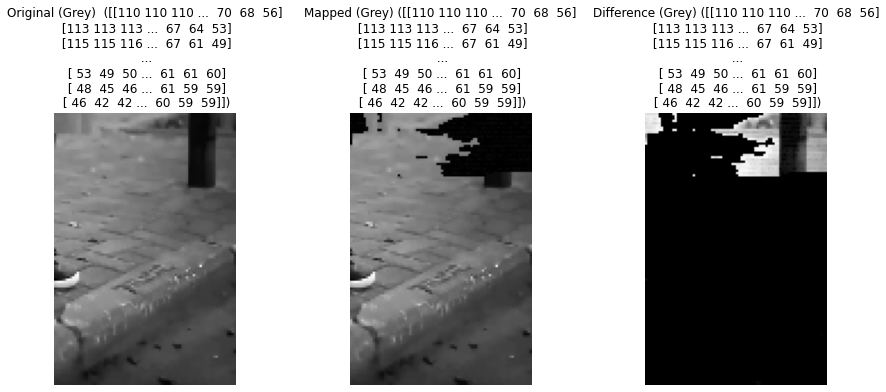

Modified Pixels for 424_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 110, Mapped: 110, New: 4
  Index: 1, Pixel: (0, 1), Original: 110, Mapped: 110, New: 5
  Index: 2, Pixel: (0, 2), Original: 110, Mapped: 110, New: 5
  Index: 3, Pixel: (0, 3), Original: 111, Mapped: 111, New: 6
  Index: 4, Pixel: (0, 4), Original: 111, Mapped: 111, New: 6
  Index: 5, Pixel: (0, 5), Original: 115, Mapped: 115, New: 6
  Index: 6, Pixel: (0, 12), Original: 121, Mapped: 121, New: 6
  Index: 7, Pixel: (0, 13), Original: 121, Mapped: 121, New: 6
  Index: 8, Pixel: (0, 52), Original: 118, Mapped: 118, New: 7
  Index: 9, Pixel: (0, 53), Original: 110, Mapped: 110, New: 8
  Index: 10, Pixel: (0, 54), Original: 94, Mapped: 94, New: 0
  Index: 11, Pixel: (0, 55), Original: 85, Mapped: 85, New: 2
  Index: 12, Pixel: (0, 56), Original: 81, Mapped: 81, New: 5
  Index: 13, Pixel: (0, 57), Original: 84, Mapped: 84, New: 8
  Index: 14, Pixel: (0, 58), Original: 78, Mapped: 78, New: 0
  Index: 15, Pixel: (0, 59), 

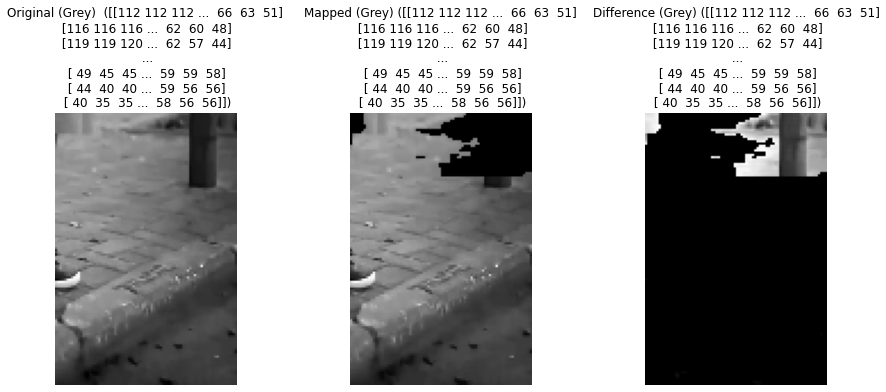

Modified Pixels for 424_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 112, Mapped: 112, New: 0
  Index: 1, Pixel: (0, 1), Original: 112, Mapped: 112, New: 0
  Index: 2, Pixel: (0, 2), Original: 112, Mapped: 112, New: 0
  Index: 3, Pixel: (0, 3), Original: 114, Mapped: 114, New: 0
  Index: 4, Pixel: (0, 4), Original: 119, Mapped: 119, New: 0
  Index: 5, Pixel: (0, 5), Original: 124, Mapped: 124, New: 0
  Index: 6, Pixel: (0, 51), Original: 126, Mapped: 126, New: 0
  Index: 7, Pixel: (0, 52), Original: 124, Mapped: 124, New: 0
  Index: 8, Pixel: (0, 53), Original: 109, Mapped: 109, New: 0
  Index: 9, Pixel: (0, 54), Original: 92, Mapped: 92, New: 0
  Index: 10, Pixel: (0, 55), Original: 82, Mapped: 82, New: 0
  Index: 11, Pixel: (0, 56), Original: 80, Mapped: 80, New: 0
  Index: 12, Pixel: (0, 57), Original: 82, Mapped: 82, New: 0
  Index: 13, Pixel: (0, 58), Original: 76, Mapped: 76, New: 0
  Index: 14, Pixel: (0, 59), Original: 43, Mapped: 43, New: 0
  Index: 15, Pixel: (0, 60), Ori

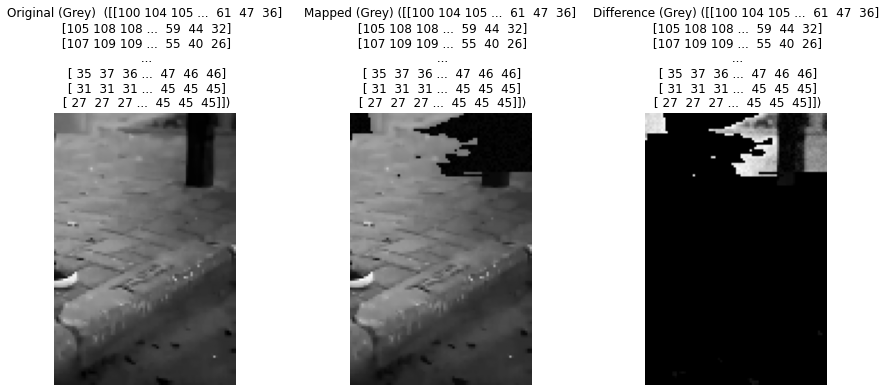

Modified Pixels for 425_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 100, Mapped: 100, New: 5
  Index: 1, Pixel: (0, 1), Original: 104, Mapped: 104, New: 9
  Index: 2, Pixel: (0, 2), Original: 105, Mapped: 105, New: 1
  Index: 3, Pixel: (0, 3), Original: 105, Mapped: 105, New: 0
  Index: 4, Pixel: (0, 4), Original: 107, Mapped: 107, New: 4
  Index: 5, Pixel: (0, 5), Original: 107, Mapped: 107, New: 7
  Index: 6, Pixel: (0, 6), Original: 107, Mapped: 107, New: 6
  Index: 7, Pixel: (0, 7), Original: 113, Mapped: 113, New: 2
  Index: 8, Pixel: (0, 50), Original: 114, Mapped: 114, New: 6
  Index: 9, Pixel: (0, 51), Original: 106, Mapped: 106, New: 2
  Index: 10, Pixel: (0, 52), Original: 94, Mapped: 94, New: 7
  Index: 11, Pixel: (0, 53), Original: 76, Mapped: 76, New: 1
  Index: 12, Pixel: (0, 54), Original: 66, Mapped: 66, New: 9
  Index: 13, Pixel: (0, 55), Original: 62, Mapped: 62, New: 3
  Index: 14, Pixel: (0, 56), Original: 62, Mapped: 62, New: 5
  Index: 15, Pixel: (0, 57), Orig

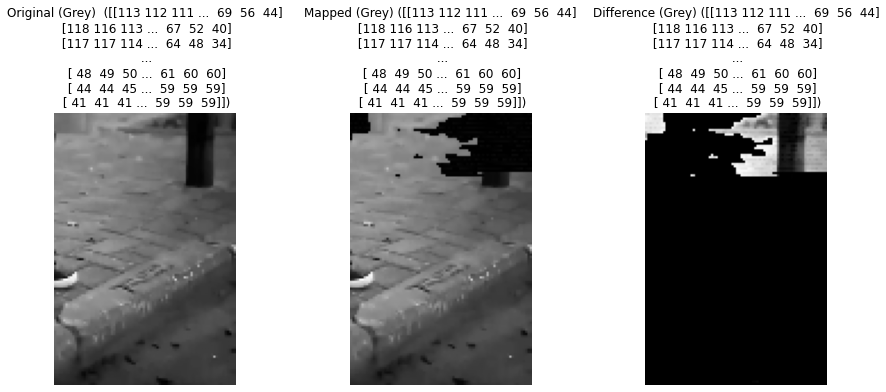

Modified Pixels for 425_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 113, Mapped: 113, New: 7
  Index: 1, Pixel: (0, 1), Original: 112, Mapped: 112, New: 9
  Index: 2, Pixel: (0, 2), Original: 111, Mapped: 111, New: 1
  Index: 3, Pixel: (0, 3), Original: 111, Mapped: 111, New: 3
  Index: 4, Pixel: (0, 4), Original: 112, Mapped: 112, New: 4
  Index: 5, Pixel: (0, 5), Original: 112, Mapped: 112, New: 5
  Index: 6, Pixel: (0, 6), Original: 112, Mapped: 112, New: 5
  Index: 7, Pixel: (0, 7), Original: 119, Mapped: 119, New: 5
  Index: 8, Pixel: (0, 51), Original: 117, Mapped: 117, New: 4
  Index: 9, Pixel: (0, 52), Original: 109, Mapped: 109, New: 3
  Index: 10, Pixel: (0, 53), Original: 96, Mapped: 96, New: 1
  Index: 11, Pixel: (0, 54), Original: 86, Mapped: 86, New: 9
  Index: 12, Pixel: (0, 55), Original: 77, Mapped: 77, New: 6
  Index: 13, Pixel: (0, 56), Original: 81, Mapped: 81, New: 3
  Index: 14, Pixel: (0, 57), Original: 80, Mapped: 80, New: 0
  Index: 15, Pixel: (0, 58), Or

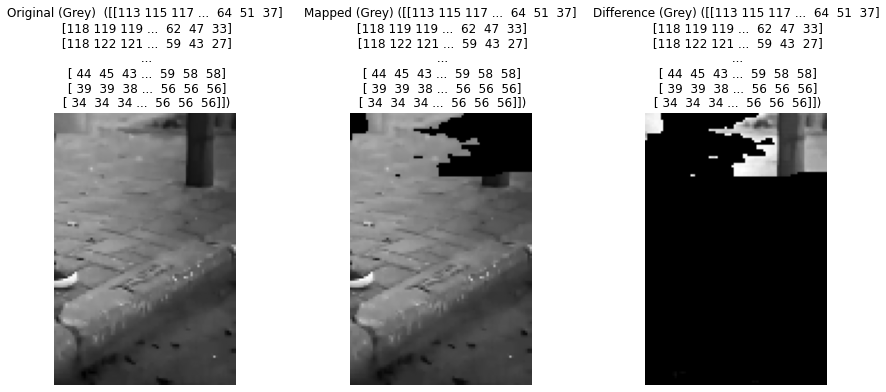

Modified Pixels for 425_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 113, Mapped: 113, New: 0
  Index: 1, Pixel: (0, 1), Original: 115, Mapped: 115, New: 0
  Index: 2, Pixel: (0, 2), Original: 117, Mapped: 117, New: 0
  Index: 3, Pixel: (0, 3), Original: 118, Mapped: 118, New: 0
  Index: 4, Pixel: (0, 4), Original: 122, Mapped: 122, New: 0
  Index: 5, Pixel: (0, 5), Original: 122, Mapped: 122, New: 0
  Index: 6, Pixel: (0, 6), Original: 122, Mapped: 122, New: 0
  Index: 7, Pixel: (0, 50), Original: 126, Mapped: 126, New: 0
  Index: 8, Pixel: (0, 51), Original: 123, Mapped: 123, New: 0
  Index: 9, Pixel: (0, 52), Original: 112, Mapped: 112, New: 0
  Index: 10, Pixel: (0, 53), Original: 93, Mapped: 93, New: 0
  Index: 11, Pixel: (0, 54), Original: 83, Mapped: 83, New: 0
  Index: 12, Pixel: (0, 55), Original: 77, Mapped: 77, New: 0
  Index: 13, Pixel: (0, 56), Original: 79, Mapped: 79, New: 0
  Index: 14, Pixel: (0, 57), Original: 78, Mapped: 78, New: 0
  Index: 15, Pixel: (0, 58), Or

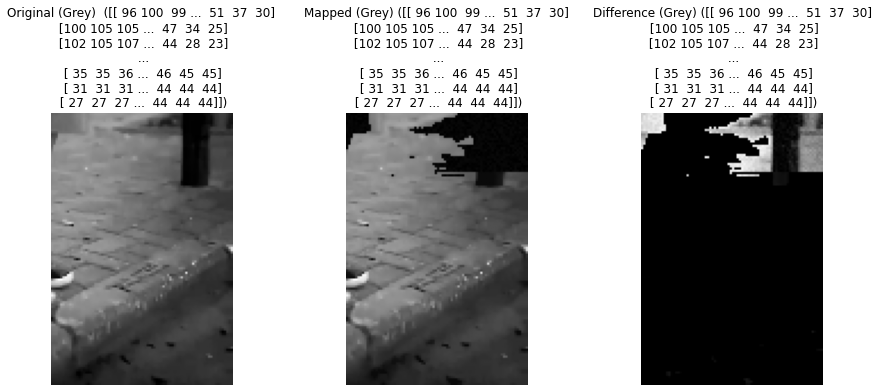

Modified Pixels for 426_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 96, Mapped: 96, New: 2
  Index: 1, Pixel: (0, 1), Original: 100, Mapped: 100, New: 8
  Index: 2, Pixel: (0, 2), Original: 99, Mapped: 99, New: 1
  Index: 3, Pixel: (0, 3), Original: 104, Mapped: 104, New: 2
  Index: 4, Pixel: (0, 4), Original: 107, Mapped: 107, New: 0
  Index: 5, Pixel: (0, 5), Original: 107, Mapped: 107, New: 7
  Index: 6, Pixel: (0, 6), Original: 107, Mapped: 107, New: 7
  Index: 7, Pixel: (0, 7), Original: 107, Mapped: 107, New: 4
  Index: 8, Pixel: (0, 8), Original: 107, Mapped: 107, New: 3
  Index: 9, Pixel: (0, 9), Original: 112, Mapped: 112, New: 3
  Index: 10, Pixel: (0, 49), Original: 111, Mapped: 111, New: 2
  Index: 11, Pixel: (0, 50), Original: 103, Mapped: 103, New: 5
  Index: 12, Pixel: (0, 51), Original: 93, Mapped: 93, New: 7
  Index: 13, Pixel: (0, 52), Original: 78, Mapped: 78, New: 5
  Index: 14, Pixel: (0, 53), Original: 65, Mapped: 65, New: 3
  Index: 15, Pixel: (0, 54), Origin

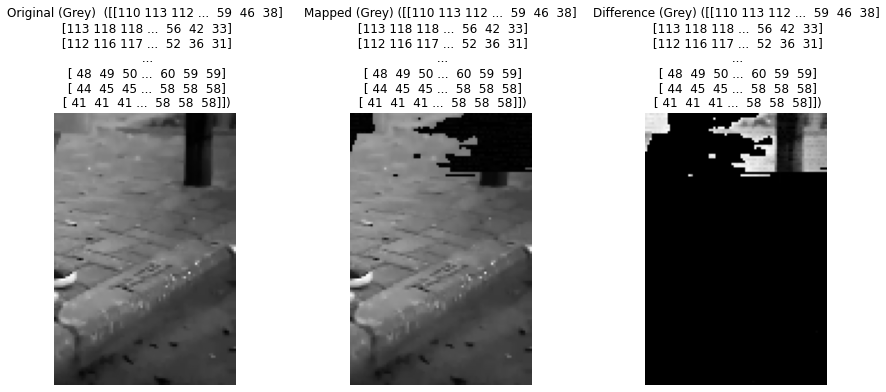

Modified Pixels for 426_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 110, Mapped: 110, New: 1
  Index: 1, Pixel: (0, 1), Original: 113, Mapped: 113, New: 1
  Index: 2, Pixel: (0, 2), Original: 112, Mapped: 112, New: 9
  Index: 3, Pixel: (0, 3), Original: 112, Mapped: 112, New: 7
  Index: 4, Pixel: (0, 4), Original: 112, Mapped: 112, New: 3
  Index: 5, Pixel: (0, 5), Original: 112, Mapped: 112, New: 9
  Index: 6, Pixel: (0, 6), Original: 112, Mapped: 112, New: 3
  Index: 7, Pixel: (0, 7), Original: 112, Mapped: 112, New: 6
  Index: 8, Pixel: (0, 8), Original: 112, Mapped: 112, New: 1
  Index: 9, Pixel: (0, 9), Original: 118, Mapped: 118, New: 0
  Index: 10, Pixel: (0, 50), Original: 114, Mapped: 114, New: 9
  Index: 11, Pixel: (0, 51), Original: 108, Mapped: 108, New: 7
  Index: 12, Pixel: (0, 52), Original: 98, Mapped: 98, New: 5
  Index: 13, Pixel: (0, 53), Original: 85, Mapped: 85, New: 2
  Index: 14, Pixel: (0, 54), Original: 74, Mapped: 74, New: 8
  Index: 15, Pixel: (0, 55), 

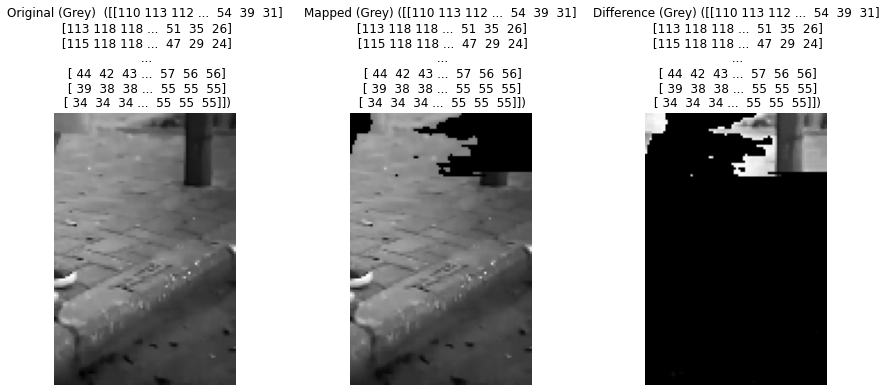

Modified Pixels for 426_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 110, Mapped: 110, New: 0
  Index: 1, Pixel: (0, 1), Original: 113, Mapped: 113, New: 0
  Index: 2, Pixel: (0, 2), Original: 112, Mapped: 112, New: 0
  Index: 3, Pixel: (0, 3), Original: 115, Mapped: 115, New: 0
  Index: 4, Pixel: (0, 4), Original: 121, Mapped: 121, New: 0
  Index: 5, Pixel: (0, 5), Original: 122, Mapped: 122, New: 0
  Index: 6, Pixel: (0, 6), Original: 122, Mapped: 122, New: 0
  Index: 7, Pixel: (0, 7), Original: 122, Mapped: 122, New: 0
  Index: 8, Pixel: (0, 8), Original: 122, Mapped: 122, New: 0
  Index: 9, Pixel: (0, 49), Original: 124, Mapped: 124, New: 0
  Index: 10, Pixel: (0, 50), Original: 119, Mapped: 119, New: 0
  Index: 11, Pixel: (0, 51), Original: 110, Mapped: 110, New: 0
  Index: 12, Pixel: (0, 52), Original: 95, Mapped: 95, New: 0
  Index: 13, Pixel: (0, 53), Original: 82, Mapped: 82, New: 0
  Index: 14, Pixel: (0, 54), Original: 73, Mapped: 73, New: 0
  Index: 15, Pixel: (0, 55), 

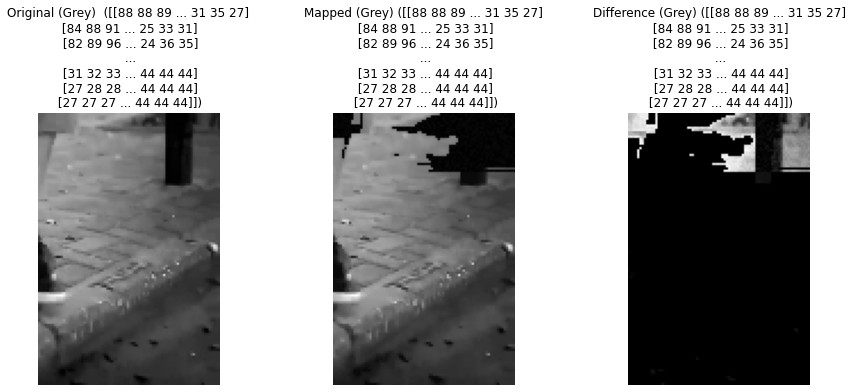

Modified Pixels for 427_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 88, Mapped: 88, New: 9
  Index: 1, Pixel: (0, 1), Original: 88, Mapped: 88, New: 4
  Index: 2, Pixel: (0, 2), Original: 89, Mapped: 89, New: 2
  Index: 3, Pixel: (0, 3), Original: 97, Mapped: 97, New: 8
  Index: 4, Pixel: (0, 4), Original: 103, Mapped: 103, New: 1
  Index: 5, Pixel: (0, 5), Original: 104, Mapped: 104, New: 2
  Index: 6, Pixel: (0, 6), Original: 104, Mapped: 104, New: 1
  Index: 7, Pixel: (0, 7), Original: 105, Mapped: 105, New: 4
  Index: 8, Pixel: (0, 8), Original: 111, Mapped: 111, New: 4
  Index: 9, Pixel: (0, 12), Original: 110, Mapped: 110, New: 9
  Index: 10, Pixel: (0, 47), Original: 102, Mapped: 102, New: 9
  Index: 11, Pixel: (0, 48), Original: 95, Mapped: 95, New: 0
  Index: 12, Pixel: (0, 49), Original: 86, Mapped: 86, New: 8
  Index: 13, Pixel: (0, 50), Original: 72, Mapped: 72, New: 6
  Index: 14, Pixel: (0, 51), Original: 59, Mapped: 59, New: 1
  Index: 15, Pixel: (0, 52), Original: 4

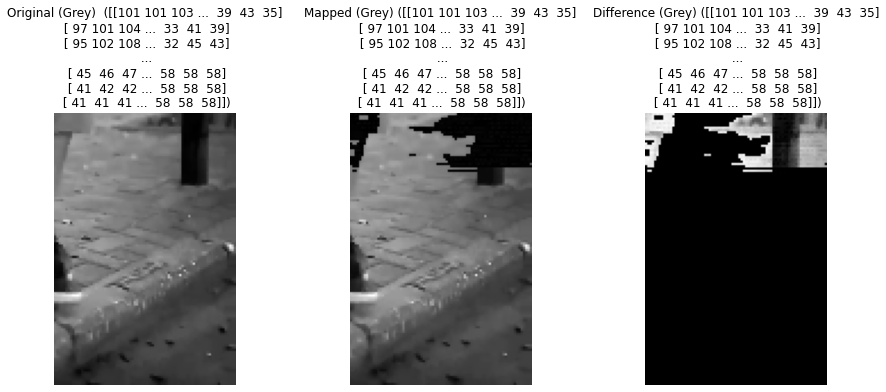

Modified Pixels for 427_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 101, Mapped: 101, New: 7
  Index: 1, Pixel: (0, 1), Original: 101, Mapped: 101, New: 2
  Index: 2, Pixel: (0, 2), Original: 103, Mapped: 103, New: 8
  Index: 3, Pixel: (0, 3), Original: 111, Mapped: 111, New: 3
  Index: 4, Pixel: (0, 4), Original: 114, Mapped: 114, New: 8
  Index: 5, Pixel: (0, 5), Original: 115, Mapped: 115, New: 3
  Index: 6, Pixel: (0, 6), Original: 115, Mapped: 115, New: 7
  Index: 7, Pixel: (0, 7), Original: 114, Mapped: 114, New: 0
  Index: 8, Pixel: (0, 8), Original: 113, Mapped: 113, New: 2
  Index: 9, Pixel: (0, 9), Original: 112, Mapped: 112, New: 4
  Index: 10, Pixel: (0, 10), Original: 112, Mapped: 112, New: 5
  Index: 11, Pixel: (0, 11), Original: 112, Mapped: 112, New: 5
  Index: 12, Pixel: (0, 12), Original: 116, Mapped: 116, New: 4
  Index: 13, Pixel: (0, 47), Original: 115, Mapped: 115, New: 2
  Index: 14, Pixel: (0, 48), Original: 107, Mapped: 107, New: 0
  Index: 15, Pixel: (0,

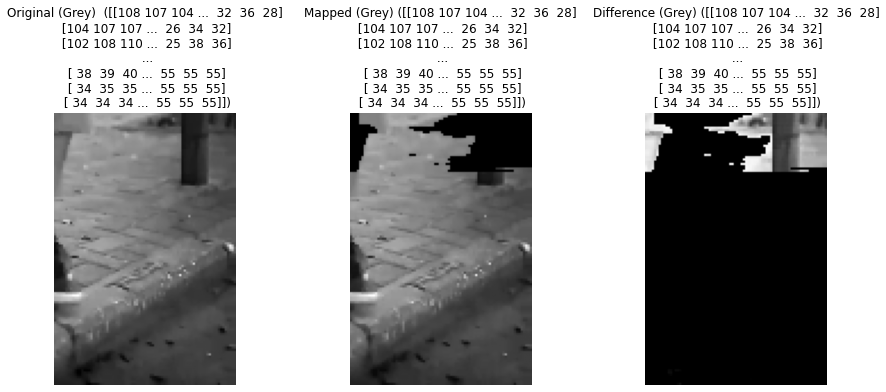

Modified Pixels for 427_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 108, Mapped: 108, New: 0
  Index: 1, Pixel: (0, 1), Original: 107, Mapped: 107, New: 0
  Index: 2, Pixel: (0, 2), Original: 104, Mapped: 104, New: 0
  Index: 3, Pixel: (0, 3), Original: 112, Mapped: 112, New: 0
  Index: 4, Pixel: (0, 47), Original: 115, Mapped: 115, New: 0
  Index: 5, Pixel: (0, 48), Original: 108, Mapped: 108, New: 0
  Index: 6, Pixel: (0, 49), Original: 104, Mapped: 104, New: 0
  Index: 7, Pixel: (0, 50), Original: 89, Mapped: 89, New: 0
  Index: 8, Pixel: (0, 51), Original: 76, Mapped: 76, New: 0
  Index: 9, Pixel: (0, 52), Original: 60, Mapped: 60, New: 0
  Index: 10, Pixel: (0, 53), Original: 59, Mapped: 59, New: 0
  Index: 11, Pixel: (0, 54), Original: 59, Mapped: 59, New: 0
  Index: 12, Pixel: (0, 55), Original: 59, Mapped: 59, New: 0
  Index: 13, Pixel: (0, 56), Original: 27, Mapped: 27, New: 0
  Index: 14, Pixel: (0, 57), Original: 25, Mapped: 25, New: 0
  Index: 15, Pixel: (0, 58), Origi

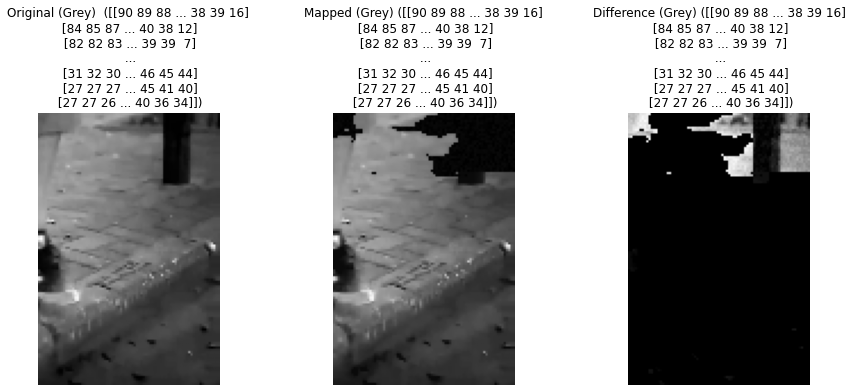

Modified Pixels for 428_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 90, Mapped: 90, New: 8
  Index: 1, Pixel: (0, 1), Original: 89, Mapped: 89, New: 8
  Index: 2, Pixel: (0, 2), Original: 88, Mapped: 88, New: 9
  Index: 3, Pixel: (0, 3), Original: 89, Mapped: 89, New: 4
  Index: 4, Pixel: (0, 4), Original: 93, Mapped: 93, New: 7
  Index: 5, Pixel: (0, 5), Original: 102, Mapped: 102, New: 4
  Index: 6, Pixel: (0, 6), Original: 104, Mapped: 104, New: 7
  Index: 7, Pixel: (0, 7), Original: 104, Mapped: 104, New: 6
  Index: 8, Pixel: (0, 8), Original: 104, Mapped: 104, New: 1
  Index: 9, Pixel: (0, 9), Original: 108, Mapped: 108, New: 4
  Index: 10, Pixel: (0, 46), Original: 103, Mapped: 103, New: 7
  Index: 11, Pixel: (0, 47), Original: 93, Mapped: 93, New: 5
  Index: 12, Pixel: (0, 48), Original: 84, Mapped: 84, New: 5
  Index: 13, Pixel: (0, 49), Original: 68, Mapped: 68, New: 0
  Index: 14, Pixel: (0, 50), Original: 55, Mapped: 55, New: 8
  Index: 15, Pixel: (0, 51), Original: 41, 

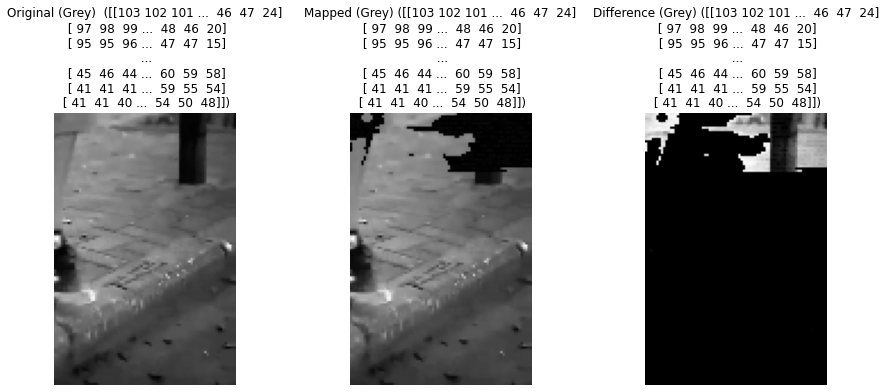

Modified Pixels for 428_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 103, Mapped: 103, New: 3
  Index: 1, Pixel: (0, 1), Original: 102, Mapped: 102, New: 4
  Index: 2, Pixel: (0, 2), Original: 101, Mapped: 101, New: 4
  Index: 3, Pixel: (0, 3), Original: 102, Mapped: 102, New: 4
  Index: 4, Pixel: (0, 4), Original: 107, Mapped: 107, New: 4
  Index: 5, Pixel: (0, 5), Original: 114, Mapped: 114, New: 3
  Index: 6, Pixel: (0, 9), Original: 113, Mapped: 113, New: 2
  Index: 7, Pixel: (0, 10), Original: 112, Mapped: 112, New: 0
  Index: 8, Pixel: (0, 11), Original: 112, Mapped: 112, New: 8
  Index: 9, Pixel: (0, 12), Original: 112, Mapped: 112, New: 6
  Index: 10, Pixel: (0, 13), Original: 112, Mapped: 112, New: 3
  Index: 11, Pixel: (0, 14), Original: 114, Mapped: 114, New: 0
  Index: 12, Pixel: (0, 47), Original: 105, Mapped: 105, New: 3
  Index: 13, Pixel: (0, 48), Original: 96, Mapped: 96, New: 8
  Index: 14, Pixel: (0, 49), Original: 86, Mapped: 86, New: 2
  Index: 15, Pixel: (0, 

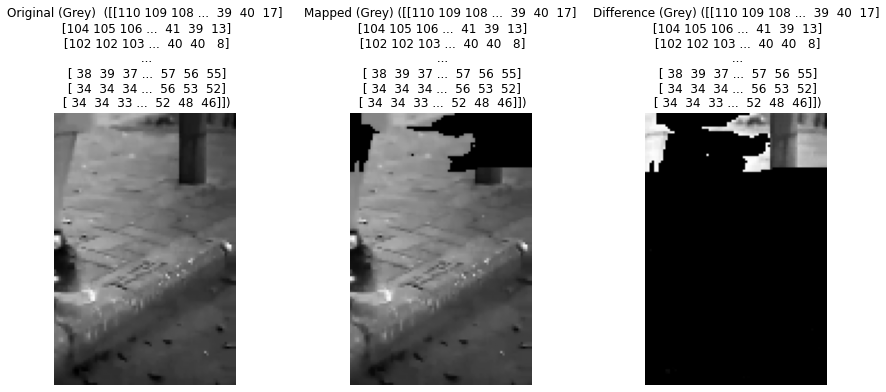

Modified Pixels for 428_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 110, Mapped: 110, New: 0
  Index: 1, Pixel: (0, 1), Original: 109, Mapped: 109, New: 0
  Index: 2, Pixel: (0, 2), Original: 108, Mapped: 108, New: 0
  Index: 3, Pixel: (0, 3), Original: 106, Mapped: 106, New: 0
  Index: 4, Pixel: (0, 4), Original: 107, Mapped: 107, New: 0
  Index: 5, Pixel: (0, 46), Original: 115, Mapped: 115, New: 0
  Index: 6, Pixel: (0, 47), Original: 108, Mapped: 108, New: 0
  Index: 7, Pixel: (0, 48), Original: 101, Mapped: 101, New: 0
  Index: 8, Pixel: (0, 49), Original: 85, Mapped: 85, New: 0
  Index: 9, Pixel: (0, 50), Original: 73, Mapped: 73, New: 0
  Index: 10, Pixel: (0, 51), Original: 58, Mapped: 58, New: 0
  Index: 11, Pixel: (0, 52), Original: 58, Mapped: 58, New: 0
  Index: 12, Pixel: (0, 53), Original: 60, Mapped: 60, New: 0
  Index: 13, Pixel: (0, 54), Original: 60, Mapped: 60, New: 0
  Index: 14, Pixel: (0, 55), Original: 29, Mapped: 29, New: 0
  Index: 15, Pixel: (0, 56), Orig

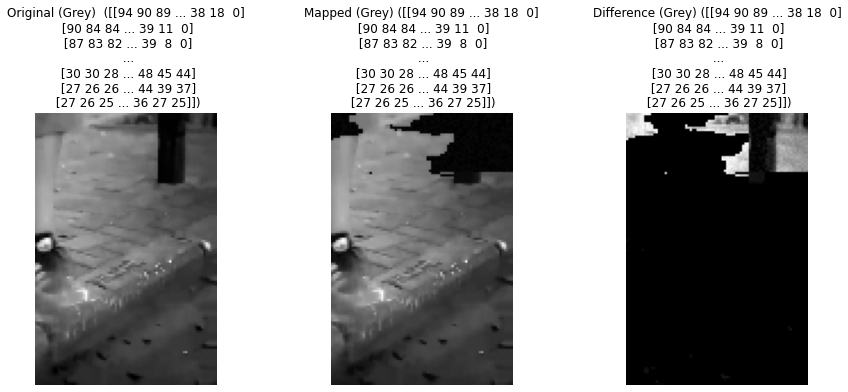

Modified Pixels for 429_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 94, Mapped: 94, New: 9
  Index: 1, Pixel: (0, 1), Original: 90, Mapped: 90, New: 1
  Index: 2, Pixel: (0, 2), Original: 89, Mapped: 89, New: 6
  Index: 3, Pixel: (0, 3), Original: 88, Mapped: 88, New: 8
  Index: 4, Pixel: (0, 4), Original: 88, Mapped: 88, New: 4
  Index: 5, Pixel: (0, 5), Original: 89, Mapped: 89, New: 3
  Index: 6, Pixel: (0, 6), Original: 97, Mapped: 97, New: 6
  Index: 7, Pixel: (0, 7), Original: 103, Mapped: 103, New: 1
  Index: 8, Pixel: (0, 8), Original: 104, Mapped: 104, New: 3
  Index: 9, Pixel: (0, 9), Original: 104, Mapped: 104, New: 0
  Index: 10, Pixel: (0, 10), Original: 105, Mapped: 105, New: 3
  Index: 11, Pixel: (0, 45), Original: 91, Mapped: 91, New: 8
  Index: 12, Pixel: (0, 46), Original: 85, Mapped: 85, New: 4
  Index: 13, Pixel: (0, 47), Original: 77, Mapped: 77, New: 3
  Index: 14, Pixel: (0, 48), Original: 64, Mapped: 64, New: 0
  Index: 15, Pixel: (0, 49), Original: 52, Mapp

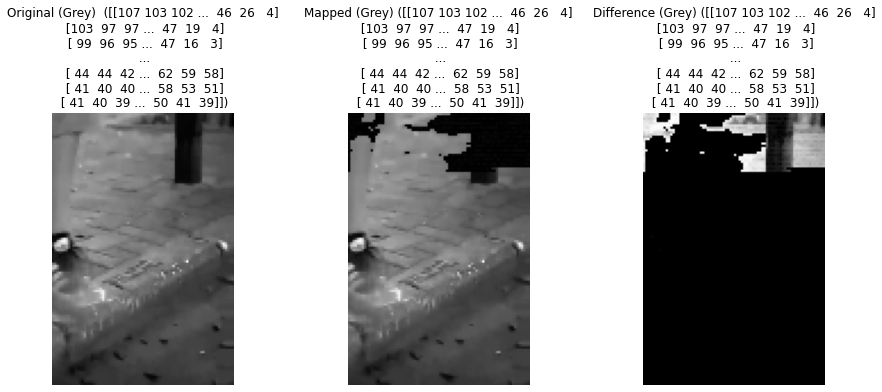

Modified Pixels for 429_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 107, Mapped: 107, New: 1
  Index: 1, Pixel: (0, 1), Original: 103, Mapped: 103, New: 5
  Index: 2, Pixel: (0, 2), Original: 102, Mapped: 102, New: 9
  Index: 3, Pixel: (0, 3), Original: 101, Mapped: 101, New: 3
  Index: 4, Pixel: (0, 4), Original: 101, Mapped: 101, New: 7
  Index: 5, Pixel: (0, 5), Original: 103, Mapped: 103, New: 1
  Index: 6, Pixel: (0, 6), Original: 111, Mapped: 111, New: 4
  Index: 7, Pixel: (0, 12), Original: 112, Mapped: 112, New: 6
  Index: 8, Pixel: (0, 13), Original: 112, Mapped: 112, New: 8
  Index: 9, Pixel: (0, 14), Original: 112, Mapped: 112, New: 9
  Index: 10, Pixel: (0, 15), Original: 112, Mapped: 112, New: 0
  Index: 11, Pixel: (0, 45), Original: 103, Mapped: 103, New: 9
  Index: 12, Pixel: (0, 46), Original: 97, Mapped: 97, New: 8
  Index: 13, Pixel: (0, 47), Original: 89, Mapped: 89, New: 6
  Index: 14, Pixel: (0, 48), Original: 82, Mapped: 82, New: 4
  Index: 15, Pixel: (0, 49

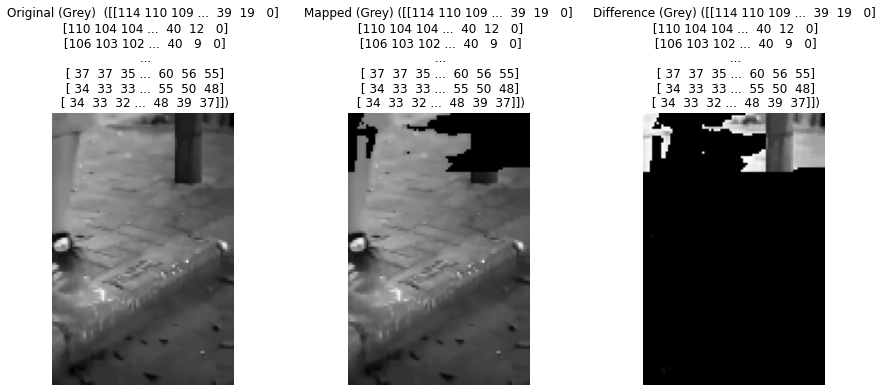

Modified Pixels for 429_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 114, Mapped: 114, New: 0
  Index: 1, Pixel: (0, 1), Original: 110, Mapped: 110, New: 0
  Index: 2, Pixel: (0, 2), Original: 109, Mapped: 109, New: 0
  Index: 3, Pixel: (0, 3), Original: 108, Mapped: 108, New: 0
  Index: 4, Pixel: (0, 4), Original: 107, Mapped: 107, New: 0
  Index: 5, Pixel: (0, 5), Original: 104, Mapped: 104, New: 0
  Index: 6, Pixel: (0, 6), Original: 112, Mapped: 112, New: 0
  Index: 7, Pixel: (0, 45), Original: 103, Mapped: 103, New: 0
  Index: 8, Pixel: (0, 46), Original: 98, Mapped: 98, New: 0
  Index: 9, Pixel: (0, 47), Original: 95, Mapped: 95, New: 0
  Index: 10, Pixel: (0, 48), Original: 81, Mapped: 81, New: 0
  Index: 11, Pixel: (0, 49), Original: 69, Mapped: 69, New: 0
  Index: 12, Pixel: (0, 50), Original: 60, Mapped: 60, New: 0
  Index: 13, Pixel: (0, 51), Original: 60, Mapped: 60, New: 0
  Index: 14, Pixel: (0, 52), Original: 60, Mapped: 60, New: 0
  Index: 15, Pixel: (0, 53), Origin

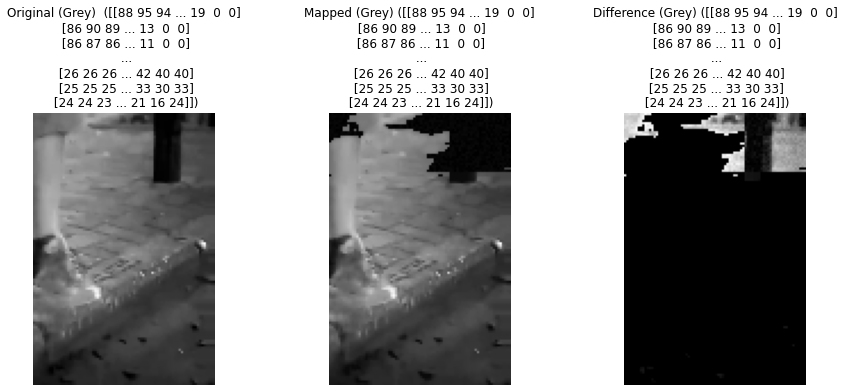

Modified Pixels for 430_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 88, Mapped: 88, New: 1
  Index: 1, Pixel: (0, 1), Original: 95, Mapped: 95, New: 7
  Index: 2, Pixel: (0, 2), Original: 94, Mapped: 94, New: 2
  Index: 3, Pixel: (0, 3), Original: 90, Mapped: 90, New: 2
  Index: 4, Pixel: (0, 4), Original: 89, Mapped: 89, New: 2
  Index: 5, Pixel: (0, 5), Original: 88, Mapped: 88, New: 0
  Index: 6, Pixel: (0, 6), Original: 89, Mapped: 89, New: 8
  Index: 7, Pixel: (0, 7), Original: 93, Mapped: 93, New: 0
  Index: 8, Pixel: (0, 8), Original: 102, Mapped: 102, New: 8
  Index: 9, Pixel: (0, 9), Original: 104, Mapped: 104, New: 0
  Index: 10, Pixel: (0, 10), Original: 104, Mapped: 104, New: 7
  Index: 11, Pixel: (0, 11), Original: 104, Mapped: 104, New: 5
  Index: 12, Pixel: (0, 41), Original: 102, Mapped: 102, New: 9
  Index: 13, Pixel: (0, 42), Original: 98, Mapped: 98, New: 9
  Index: 14, Pixel: (0, 43), Original: 94, Mapped: 94, New: 9
  Index: 15, Pixel: (0, 44), Original: 78, Ma

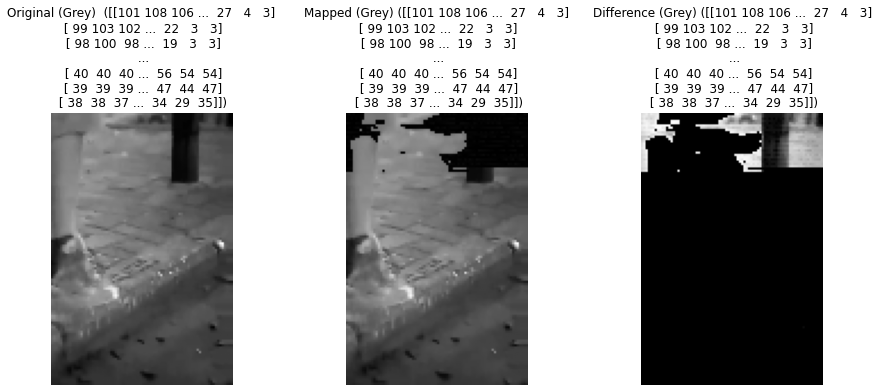

Modified Pixels for 430_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 101, Mapped: 101, New: 5
  Index: 1, Pixel: (0, 1), Original: 108, Mapped: 108, New: 9
  Index: 2, Pixel: (0, 2), Original: 106, Mapped: 106, New: 3
  Index: 3, Pixel: (0, 3), Original: 103, Mapped: 103, New: 7
  Index: 4, Pixel: (0, 4), Original: 102, Mapped: 102, New: 0
  Index: 5, Pixel: (0, 5), Original: 101, Mapped: 101, New: 2
  Index: 6, Pixel: (0, 6), Original: 102, Mapped: 102, New: 3
  Index: 7, Pixel: (0, 7), Original: 107, Mapped: 107, New: 4
  Index: 8, Pixel: (0, 41), Original: 107, Mapped: 107, New: 3
  Index: 9, Pixel: (0, 42), Original: 109, Mapped: 109, New: 1
  Index: 10, Pixel: (0, 43), Original: 107, Mapped: 107, New: 8
  Index: 11, Pixel: (0, 44), Original: 91, Mapped: 91, New: 4
  Index: 12, Pixel: (0, 45), Original: 83, Mapped: 83, New: 9
  Index: 13, Pixel: (0, 46), Original: 76, Mapped: 76, New: 4
  Index: 14, Pixel: (0, 47), Original: 73, Mapped: 73, New: 9
  Index: 15, Pixel: (0, 48), 

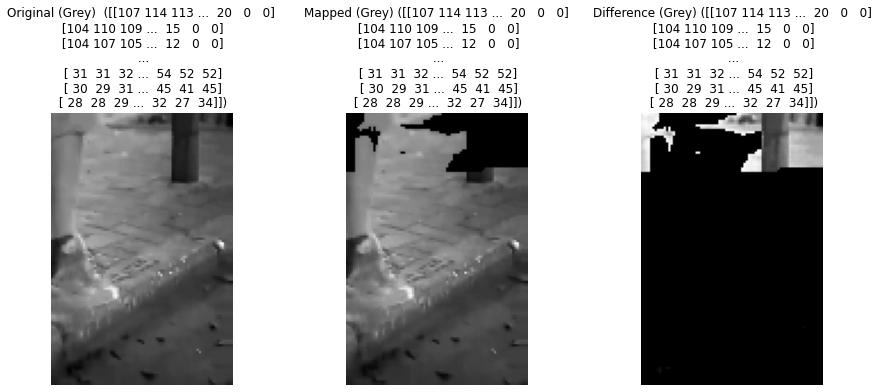

Modified Pixels for 430_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 107, Mapped: 107, New: 0
  Index: 1, Pixel: (0, 1), Original: 114, Mapped: 114, New: 0
  Index: 2, Pixel: (0, 2), Original: 113, Mapped: 113, New: 0
  Index: 3, Pixel: (0, 3), Original: 110, Mapped: 110, New: 0
  Index: 4, Pixel: (0, 4), Original: 109, Mapped: 109, New: 0
  Index: 5, Pixel: (0, 5), Original: 108, Mapped: 108, New: 0
  Index: 6, Pixel: (0, 6), Original: 106, Mapped: 106, New: 0
  Index: 7, Pixel: (0, 7), Original: 107, Mapped: 107, New: 0
  Index: 8, Pixel: (0, 42), Original: 111, Mapped: 111, New: 0
  Index: 9, Pixel: (0, 43), Original: 107, Mapped: 107, New: 0
  Index: 10, Pixel: (0, 44), Original: 91, Mapped: 91, New: 0
  Index: 11, Pixel: (0, 45), Original: 84, Mapped: 84, New: 0
  Index: 12, Pixel: (0, 46), Original: 82, Mapped: 82, New: 0
  Index: 13, Pixel: (0, 47), Original: 72, Mapped: 72, New: 0
  Index: 14, Pixel: (0, 48), Original: 68, Mapped: 68, New: 0
  Index: 15, Pixel: (0, 49), Ori

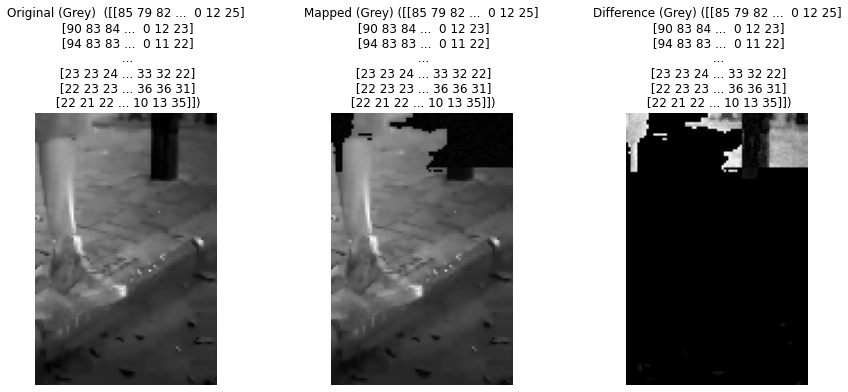

Modified Pixels for 431_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 85, Mapped: 85, New: 4
  Index: 1, Pixel: (0, 1), Original: 79, Mapped: 79, New: 7
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 1
  Index: 3, Pixel: (0, 3), Original: 90, Mapped: 90, New: 6
  Index: 4, Pixel: (0, 4), Original: 90, Mapped: 90, New: 0
  Index: 5, Pixel: (0, 5), Original: 90, Mapped: 90, New: 3
  Index: 6, Pixel: (0, 6), Original: 87, Mapped: 87, New: 2
  Index: 7, Pixel: (0, 7), Original: 89, Mapped: 89, New: 1
  Index: 8, Pixel: (0, 8), Original: 92, Mapped: 92, New: 7
  Index: 9, Pixel: (0, 9), Original: 100, Mapped: 100, New: 5
  Index: 10, Pixel: (0, 36), Original: 103, Mapped: 103, New: 2
  Index: 11, Pixel: (0, 37), Original: 80, Mapped: 80, New: 0
  Index: 12, Pixel: (0, 38), Original: 84, Mapped: 84, New: 9
  Index: 13, Pixel: (0, 39), Original: 88, Mapped: 88, New: 9
  Index: 14, Pixel: (0, 40), Original: 83, Mapped: 83, New: 7
  Index: 15, Pixel: (0, 41), Original: 76, Mapped: 

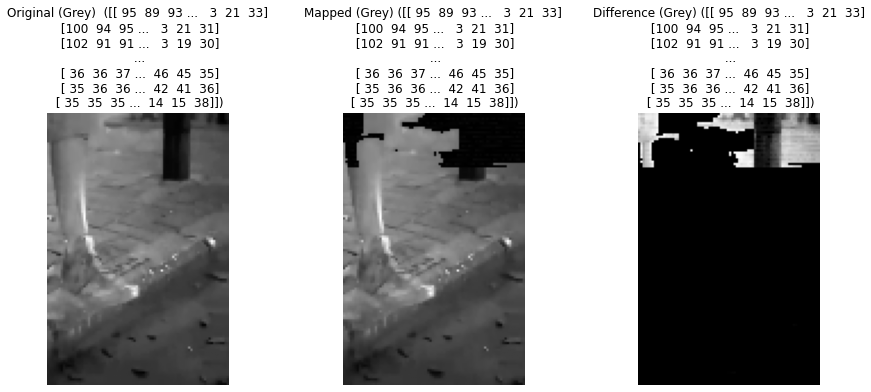

Modified Pixels for 431_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 95, Mapped: 95, New: 6
  Index: 1, Pixel: (0, 1), Original: 89, Mapped: 89, New: 5
  Index: 2, Pixel: (0, 2), Original: 93, Mapped: 93, New: 5
  Index: 3, Pixel: (0, 3), Original: 102, Mapped: 102, New: 4
  Index: 4, Pixel: (0, 4), Original: 103, Mapped: 103, New: 4
  Index: 5, Pixel: (0, 5), Original: 103, Mapped: 103, New: 3
  Index: 6, Pixel: (0, 6), Original: 100, Mapped: 100, New: 3
  Index: 7, Pixel: (0, 7), Original: 102, Mapped: 102, New: 2
  Index: 8, Pixel: (0, 8), Original: 106, Mapped: 106, New: 1
  Index: 9, Pixel: (0, 36), Original: 103, Mapped: 103, New: 0
  Index: 10, Pixel: (0, 37), Original: 83, Mapped: 83, New: 0
  Index: 11, Pixel: (0, 38), Original: 89, Mapped: 89, New: 0
  Index: 12, Pixel: (0, 39), Original: 93, Mapped: 93, New: 0
  Index: 13, Pixel: (0, 40), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 41), Original: 89, Mapped: 89, New: 1
  Index: 15, Pixel: (0, 42), Original:

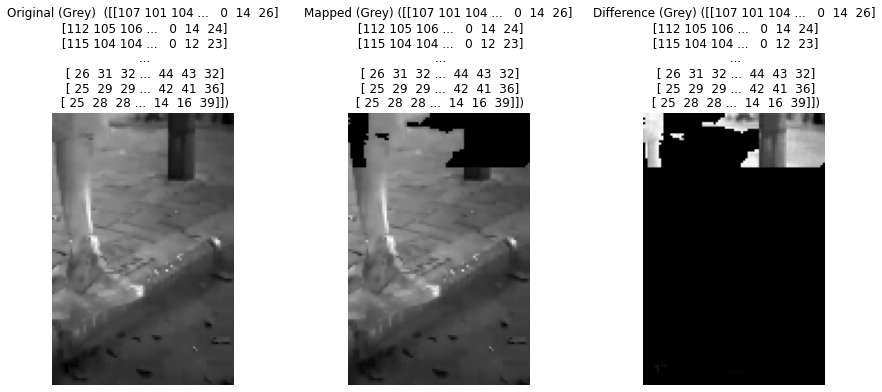

Modified Pixels for 431_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 107, Mapped: 107, New: 0
  Index: 1, Pixel: (0, 1), Original: 101, Mapped: 101, New: 0
  Index: 2, Pixel: (0, 2), Original: 104, Mapped: 104, New: 0
  Index: 3, Pixel: (0, 3), Original: 111, Mapped: 111, New: 0
  Index: 4, Pixel: (0, 4), Original: 110, Mapped: 110, New: 0
  Index: 5, Pixel: (0, 5), Original: 110, Mapped: 110, New: 0
  Index: 6, Pixel: (0, 6), Original: 107, Mapped: 107, New: 0
  Index: 7, Pixel: (0, 7), Original: 106, Mapped: 106, New: 0
  Index: 8, Pixel: (0, 8), Original: 106, Mapped: 106, New: 0
  Index: 9, Pixel: (0, 36), Original: 112, Mapped: 112, New: 0
  Index: 10, Pixel: (0, 37), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 38), Original: 96, Mapped: 96, New: 0
  Index: 12, Pixel: (0, 39), Original: 100, Mapped: 100, New: 0
  Index: 13, Pixel: (0, 40), Original: 93, Mapped: 93, New: 0
  Index: 14, Pixel: (0, 41), Original: 84, Mapped: 84, New: 0
  Index: 15, Pixel: (0, 42), Or

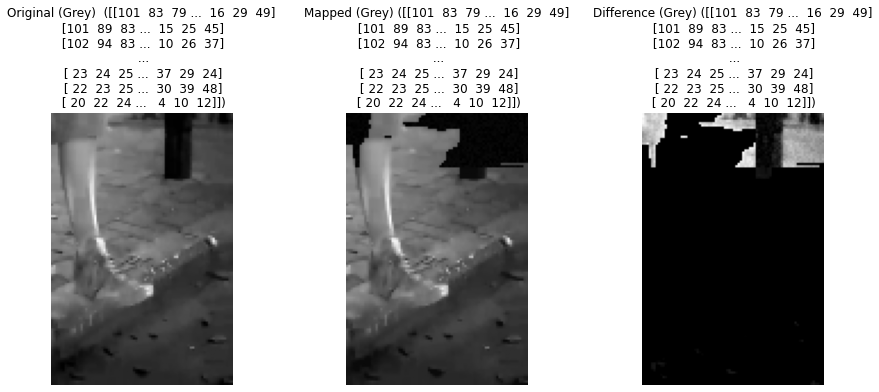

Modified Pixels for 432_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 101, Mapped: 101, New: 2
  Index: 1, Pixel: (0, 1), Original: 83, Mapped: 83, New: 6
  Index: 2, Pixel: (0, 2), Original: 79, Mapped: 79, New: 2
  Index: 3, Pixel: (0, 3), Original: 82, Mapped: 82, New: 3
  Index: 4, Pixel: (0, 4), Original: 90, Mapped: 90, New: 2
  Index: 5, Pixel: (0, 5), Original: 90, Mapped: 90, New: 8
  Index: 6, Pixel: (0, 6), Original: 90, Mapped: 90, New: 1
  Index: 7, Pixel: (0, 7), Original: 87, Mapped: 87, New: 8
  Index: 8, Pixel: (0, 8), Original: 89, Mapped: 89, New: 5
  Index: 9, Pixel: (0, 9), Original: 92, Mapped: 92, New: 5
  Index: 10, Pixel: (0, 10), Original: 100, Mapped: 100, New: 9
  Index: 11, Pixel: (0, 35), Original: 95, Mapped: 95, New: 5
  Index: 12, Pixel: (0, 36), Original: 75, Mapped: 75, New: 5
  Index: 13, Pixel: (0, 37), Original: 80, Mapped: 80, New: 9
  Index: 14, Pixel: (0, 38), Original: 83, Mapped: 83, New: 8
  Index: 15, Pixel: (0, 39), Original: 77, Mapped: 

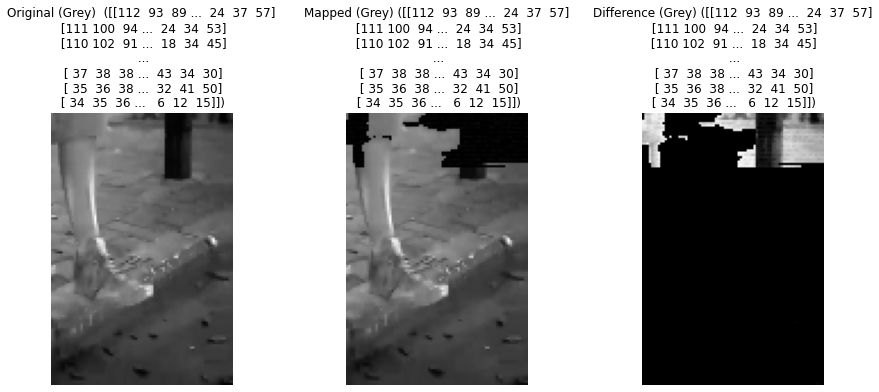

Modified Pixels for 432_Green_Right:
  Index: 0, Pixel: (0, 1), Original: 93, Mapped: 93, New: 9
  Index: 1, Pixel: (0, 2), Original: 89, Mapped: 89, New: 9
  Index: 2, Pixel: (0, 3), Original: 93, Mapped: 93, New: 8
  Index: 3, Pixel: (0, 4), Original: 102, Mapped: 102, New: 6
  Index: 4, Pixel: (0, 5), Original: 103, Mapped: 103, New: 3
  Index: 5, Pixel: (0, 6), Original: 103, Mapped: 103, New: 0
  Index: 6, Pixel: (0, 7), Original: 100, Mapped: 100, New: 6
  Index: 7, Pixel: (0, 8), Original: 102, Mapped: 102, New: 1
  Index: 8, Pixel: (0, 9), Original: 106, Mapped: 106, New: 6
  Index: 9, Pixel: (0, 35), Original: 95, Mapped: 95, New: 2
  Index: 10, Pixel: (0, 36), Original: 78, Mapped: 78, New: 1
  Index: 11, Pixel: (0, 37), Original: 85, Mapped: 85, New: 4
  Index: 12, Pixel: (0, 38), Original: 88, Mapped: 88, New: 7
  Index: 13, Pixel: (0, 39), Original: 89, Mapped: 89, New: 9
  Index: 14, Pixel: (0, 40), Original: 79, Mapped: 79, New: 1
  Index: 15, Pixel: (0, 41), Original: 4

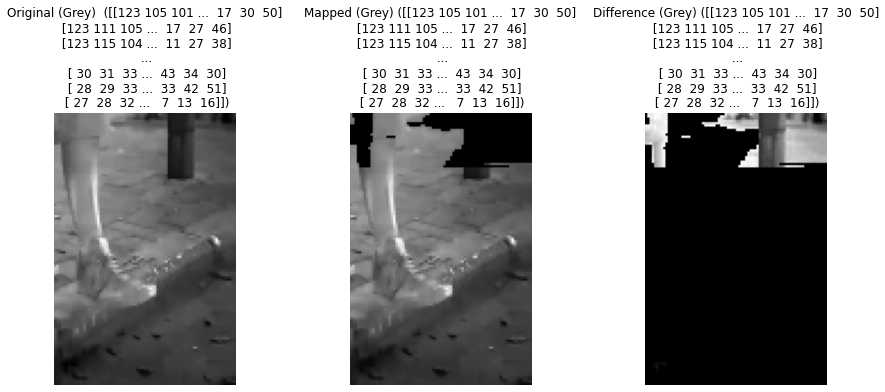

Modified Pixels for 432_Blue_Right:
  Index: 0, Pixel: (0, 1), Original: 105, Mapped: 105, New: 0
  Index: 1, Pixel: (0, 2), Original: 101, Mapped: 101, New: 0
  Index: 2, Pixel: (0, 3), Original: 104, Mapped: 104, New: 0
  Index: 3, Pixel: (0, 4), Original: 111, Mapped: 111, New: 0
  Index: 4, Pixel: (0, 5), Original: 110, Mapped: 110, New: 0
  Index: 5, Pixel: (0, 6), Original: 110, Mapped: 110, New: 0
  Index: 6, Pixel: (0, 7), Original: 107, Mapped: 107, New: 0
  Index: 7, Pixel: (0, 8), Original: 106, Mapped: 106, New: 0
  Index: 8, Pixel: (0, 9), Original: 106, Mapped: 106, New: 0
  Index: 9, Pixel: (0, 35), Original: 104, Mapped: 104, New: 0
  Index: 10, Pixel: (0, 36), Original: 85, Mapped: 85, New: 0
  Index: 11, Pixel: (0, 37), Original: 92, Mapped: 92, New: 0
  Index: 12, Pixel: (0, 38), Original: 95, Mapped: 95, New: 0
  Index: 13, Pixel: (0, 39), Original: 87, Mapped: 87, New: 0
  Index: 14, Pixel: (0, 40), Original: 75, Mapped: 75, New: 0
  Index: 15, Pixel: (0, 41), Orig

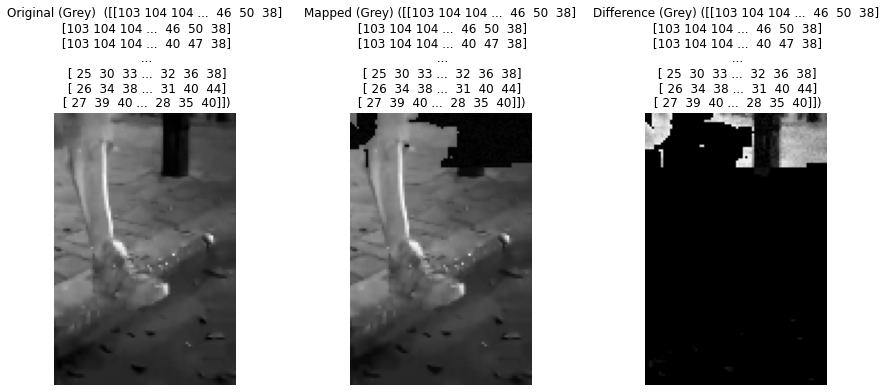

Modified Pixels for 433_Red_Right:
  Index: 0, Pixel: (0, 3), Original: 94, Mapped: 94, New: 6
  Index: 1, Pixel: (0, 4), Original: 82, Mapped: 82, New: 8
  Index: 2, Pixel: (0, 5), Original: 78, Mapped: 78, New: 1
  Index: 3, Pixel: (0, 6), Original: 66, Mapped: 66, New: 9
  Index: 4, Pixel: (0, 7), Original: 63, Mapped: 63, New: 6
  Index: 5, Pixel: (0, 8), Original: 59, Mapped: 59, New: 0
  Index: 6, Pixel: (0, 9), Original: 71, Mapped: 71, New: 1
  Index: 7, Pixel: (0, 10), Original: 87, Mapped: 87, New: 1
  Index: 8, Pixel: (0, 11), Original: 96, Mapped: 96, New: 1
  Index: 9, Pixel: (0, 30), Original: 97, Mapped: 97, New: 4
  Index: 10, Pixel: (0, 31), Original: 90, Mapped: 90, New: 9
  Index: 11, Pixel: (0, 32), Original: 79, Mapped: 79, New: 3
  Index: 12, Pixel: (0, 33), Original: 63, Mapped: 63, New: 9
  Index: 13, Pixel: (0, 34), Original: 53, Mapped: 53, New: 9
  Index: 14, Pixel: (0, 35), Original: 57, Mapped: 57, New: 1
  Index: 15, Pixel: (0, 36), Original: 70, Mapped: 7

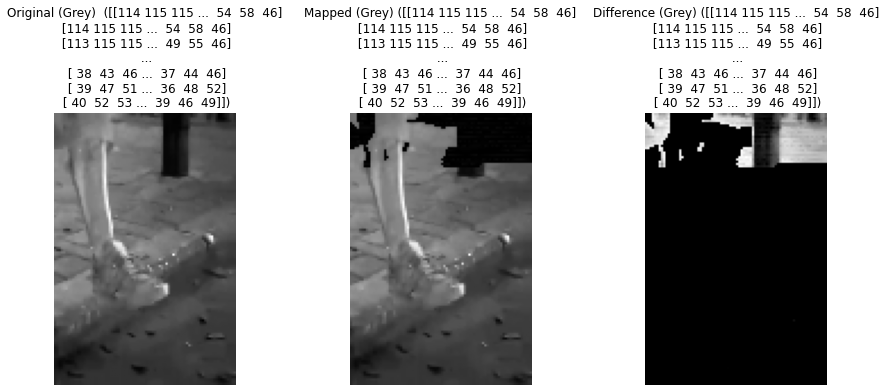

Modified Pixels for 433_Green_Right:
  Index: 0, Pixel: (0, 3), Original: 105, Mapped: 105, New: 2
  Index: 1, Pixel: (0, 4), Original: 92, Mapped: 92, New: 7
  Index: 2, Pixel: (0, 5), Original: 88, Mapped: 88, New: 3
  Index: 3, Pixel: (0, 6), Original: 76, Mapped: 76, New: 8
  Index: 4, Pixel: (0, 7), Original: 74, Mapped: 74, New: 3
  Index: 5, Pixel: (0, 8), Original: 71, Mapped: 71, New: 1
  Index: 6, Pixel: (0, 9), Original: 84, Mapped: 84, New: 5
  Index: 7, Pixel: (0, 10), Original: 100, Mapped: 100, New: 9
  Index: 8, Pixel: (0, 30), Original: 103, Mapped: 103, New: 3
  Index: 9, Pixel: (0, 31), Original: 96, Mapped: 96, New: 6
  Index: 10, Pixel: (0, 32), Original: 83, Mapped: 83, New: 9
  Index: 11, Pixel: (0, 33), Original: 67, Mapped: 67, New: 2
  Index: 12, Pixel: (0, 34), Original: 59, Mapped: 59, New: 4
  Index: 13, Pixel: (0, 35), Original: 62, Mapped: 62, New: 5
  Index: 14, Pixel: (0, 36), Original: 76, Mapped: 76, New: 7
  Index: 15, Pixel: (0, 37), Original: 71, M

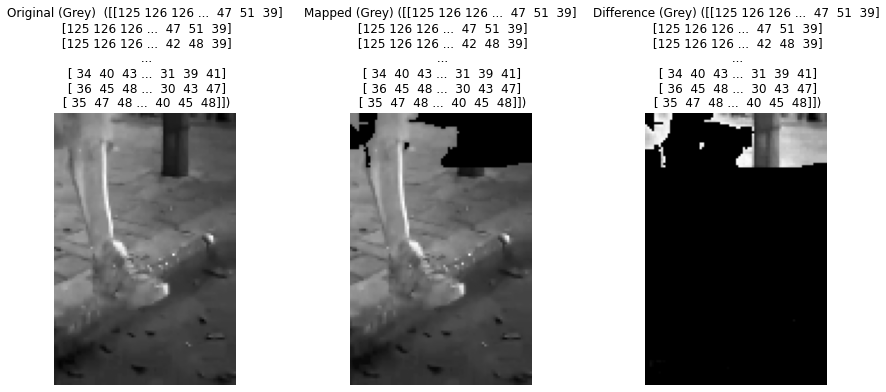

Modified Pixels for 433_Blue_Right:
  Index: 0, Pixel: (0, 4), Original: 104, Mapped: 104, New: 0
  Index: 1, Pixel: (0, 5), Original: 100, Mapped: 100, New: 0
  Index: 2, Pixel: (0, 6), Original: 88, Mapped: 88, New: 0
  Index: 3, Pixel: (0, 7), Original: 85, Mapped: 85, New: 0
  Index: 4, Pixel: (0, 8), Original: 80, Mapped: 80, New: 0
  Index: 5, Pixel: (0, 9), Original: 89, Mapped: 89, New: 0
  Index: 6, Pixel: (0, 10), Original: 102, Mapped: 102, New: 0
  Index: 7, Pixel: (0, 11), Original: 111, Mapped: 111, New: 0
  Index: 8, Pixel: (0, 30), Original: 107, Mapped: 107, New: 0
  Index: 9, Pixel: (0, 31), Original: 100, Mapped: 100, New: 0
  Index: 10, Pixel: (0, 32), Original: 88, Mapped: 88, New: 0
  Index: 11, Pixel: (0, 33), Original: 72, Mapped: 72, New: 0
  Index: 12, Pixel: (0, 34), Original: 61, Mapped: 61, New: 0
  Index: 13, Pixel: (0, 35), Original: 65, Mapped: 65, New: 0
  Index: 14, Pixel: (0, 36), Original: 75, Mapped: 75, New: 0
  Index: 15, Pixel: (0, 37), Original:

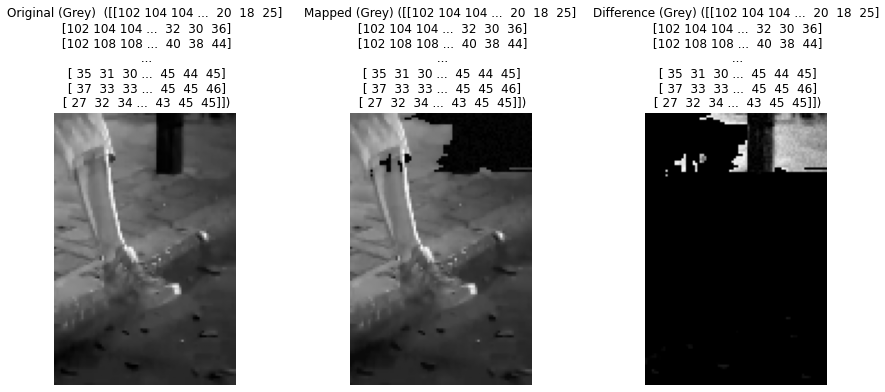

Modified Pixels for 434_Red_Right:
  Index: 0, Pixel: (0, 29), Original: 97, Mapped: 97, New: 7
  Index: 1, Pixel: (0, 30), Original: 92, Mapped: 92, New: 7
  Index: 2, Pixel: (0, 31), Original: 89, Mapped: 89, New: 0
  Index: 3, Pixel: (0, 32), Original: 82, Mapped: 82, New: 0
  Index: 4, Pixel: (0, 33), Original: 81, Mapped: 81, New: 9
  Index: 5, Pixel: (0, 34), Original: 80, Mapped: 80, New: 3
  Index: 6, Pixel: (0, 35), Original: 65, Mapped: 65, New: 0
  Index: 7, Pixel: (0, 36), Original: 66, Mapped: 66, New: 3
  Index: 8, Pixel: (0, 37), Original: 74, Mapped: 74, New: 3
  Index: 9, Pixel: (0, 38), Original: 77, Mapped: 77, New: 8
  Index: 10, Pixel: (0, 39), Original: 65, Mapped: 65, New: 7
  Index: 11, Pixel: (0, 40), Original: 42, Mapped: 42, New: 1
  Index: 12, Pixel: (0, 41), Original: 43, Mapped: 43, New: 3
  Index: 13, Pixel: (0, 42), Original: 50, Mapped: 50, New: 7
  Index: 14, Pixel: (0, 43), Original: 54, Mapped: 54, New: 3
  Index: 15, Pixel: (0, 44), Original: 43, Ma

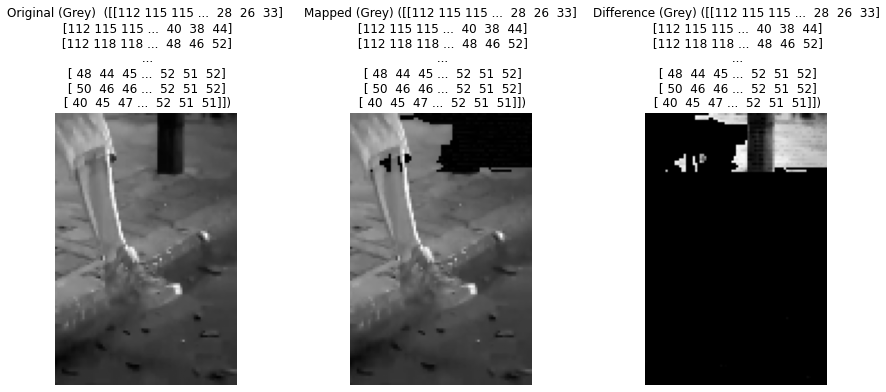

Modified Pixels for 434_Green_Right:
  Index: 0, Pixel: (0, 28), Original: 108, Mapped: 108, New: 9
  Index: 1, Pixel: (0, 29), Original: 107, Mapped: 107, New: 3
  Index: 2, Pixel: (0, 30), Original: 102, Mapped: 102, New: 7
  Index: 3, Pixel: (0, 31), Original: 97, Mapped: 97, New: 0
  Index: 4, Pixel: (0, 32), Original: 88, Mapped: 88, New: 3
  Index: 5, Pixel: (0, 33), Original: 86, Mapped: 86, New: 5
  Index: 6, Pixel: (0, 34), Original: 88, Mapped: 88, New: 7
  Index: 7, Pixel: (0, 35), Original: 77, Mapped: 77, New: 9
  Index: 8, Pixel: (0, 36), Original: 80, Mapped: 80, New: 0
  Index: 9, Pixel: (0, 37), Original: 88, Mapped: 88, New: 0
  Index: 10, Pixel: (0, 38), Original: 90, Mapped: 90, New: 0
  Index: 11, Pixel: (0, 39), Original: 77, Mapped: 77, New: 0
  Index: 12, Pixel: (0, 40), Original: 53, Mapped: 53, New: 9
  Index: 13, Pixel: (0, 41), Original: 55, Mapped: 55, New: 8
  Index: 14, Pixel: (0, 42), Original: 61, Mapped: 61, New: 6
  Index: 15, Pixel: (0, 43), Original

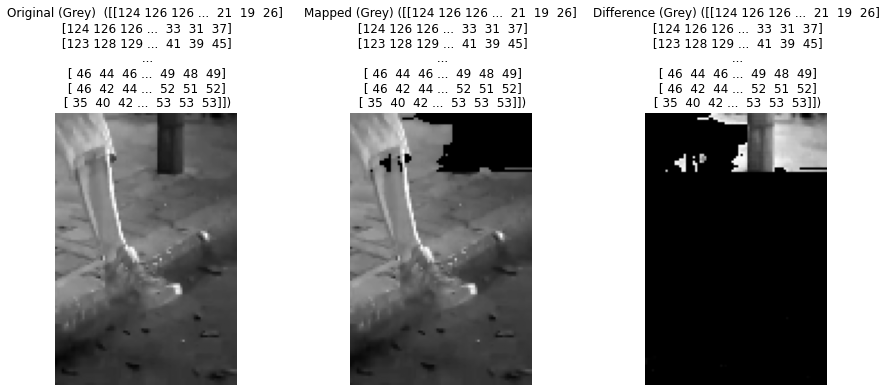

Modified Pixels for 434_Blue_Right:
  Index: 0, Pixel: (0, 29), Original: 110, Mapped: 110, New: 0
  Index: 1, Pixel: (0, 30), Original: 105, Mapped: 105, New: 0
  Index: 2, Pixel: (0, 31), Original: 100, Mapped: 100, New: 0
  Index: 3, Pixel: (0, 32), Original: 88, Mapped: 88, New: 0
  Index: 4, Pixel: (0, 33), Original: 86, Mapped: 86, New: 0
  Index: 5, Pixel: (0, 34), Original: 79, Mapped: 79, New: 0
  Index: 6, Pixel: (0, 35), Original: 56, Mapped: 56, New: 0
  Index: 7, Pixel: (0, 36), Original: 56, Mapped: 56, New: 0
  Index: 8, Pixel: (0, 37), Original: 62, Mapped: 62, New: 0
  Index: 9, Pixel: (0, 38), Original: 75, Mapped: 75, New: 0
  Index: 10, Pixel: (0, 39), Original: 66, Mapped: 66, New: 0
  Index: 11, Pixel: (0, 40), Original: 44, Mapped: 44, New: 0
  Index: 12, Pixel: (0, 41), Original: 47, Mapped: 47, New: 0
  Index: 13, Pixel: (0, 42), Original: 54, Mapped: 54, New: 0
  Index: 14, Pixel: (0, 43), Original: 62, Mapped: 62, New: 0
  Index: 15, Pixel: (0, 44), Original:

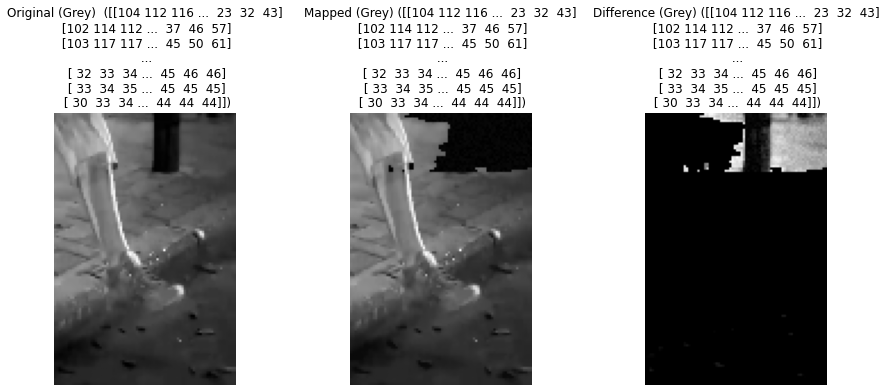

Modified Pixels for 435_Red_Right:
  Index: 0, Pixel: (0, 26), Original: 93, Mapped: 93, New: 1
  Index: 1, Pixel: (0, 27), Original: 92, Mapped: 92, New: 6
  Index: 2, Pixel: (0, 28), Original: 97, Mapped: 97, New: 3
  Index: 3, Pixel: (0, 29), Original: 97, Mapped: 97, New: 2
  Index: 4, Pixel: (0, 30), Original: 92, Mapped: 92, New: 2
  Index: 5, Pixel: (0, 31), Original: 89, Mapped: 89, New: 5
  Index: 6, Pixel: (0, 32), Original: 88, Mapped: 88, New: 8
  Index: 7, Pixel: (0, 33), Original: 82, Mapped: 82, New: 2
  Index: 8, Pixel: (0, 34), Original: 79, Mapped: 79, New: 9
  Index: 9, Pixel: (0, 35), Original: 81, Mapped: 81, New: 4
  Index: 10, Pixel: (0, 36), Original: 81, Mapped: 81, New: 9
  Index: 11, Pixel: (0, 37), Original: 79, Mapped: 79, New: 1
  Index: 12, Pixel: (0, 38), Original: 77, Mapped: 77, New: 9
  Index: 13, Pixel: (0, 39), Original: 76, Mapped: 76, New: 0
  Index: 14, Pixel: (0, 40), Original: 69, Mapped: 69, New: 7
  Index: 15, Pixel: (0, 41), Original: 66, Ma

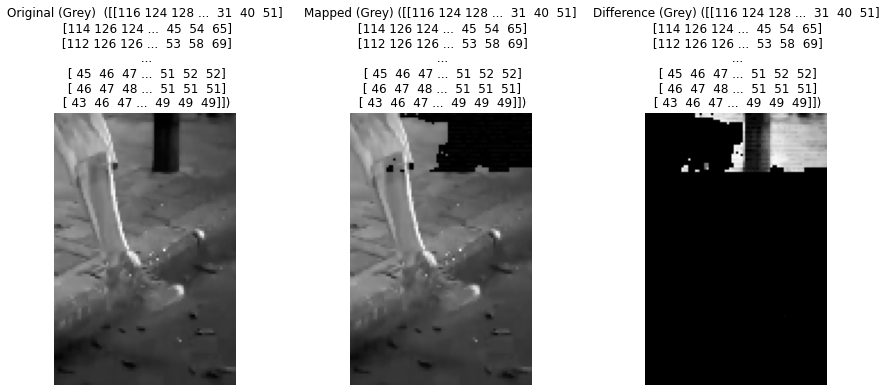

Modified Pixels for 435_Green_Right:
  Index: 0, Pixel: (0, 22), Original: 103, Mapped: 103, New: 9
  Index: 1, Pixel: (0, 23), Original: 105, Mapped: 105, New: 9
  Index: 2, Pixel: (0, 25), Original: 105, Mapped: 105, New: 9
  Index: 3, Pixel: (0, 26), Original: 102, Mapped: 102, New: 8
  Index: 4, Pixel: (0, 27), Original: 102, Mapped: 102, New: 8
  Index: 5, Pixel: (0, 28), Original: 106, Mapped: 106, New: 7
  Index: 6, Pixel: (0, 30), Original: 102, Mapped: 102, New: 6
  Index: 7, Pixel: (0, 31), Original: 99, Mapped: 99, New: 4
  Index: 8, Pixel: (0, 32), Original: 96, Mapped: 96, New: 2
  Index: 9, Pixel: (0, 33), Original: 94, Mapped: 94, New: 1
  Index: 10, Pixel: (0, 34), Original: 95, Mapped: 95, New: 8
  Index: 11, Pixel: (0, 35), Original: 97, Mapped: 97, New: 6
  Index: 12, Pixel: (0, 36), Original: 96, Mapped: 96, New: 4
  Index: 13, Pixel: (0, 37), Original: 93, Mapped: 93, New: 1
  Index: 14, Pixel: (0, 38), Original: 91, Mapped: 91, New: 0
  Index: 15, Pixel: (0, 39), 

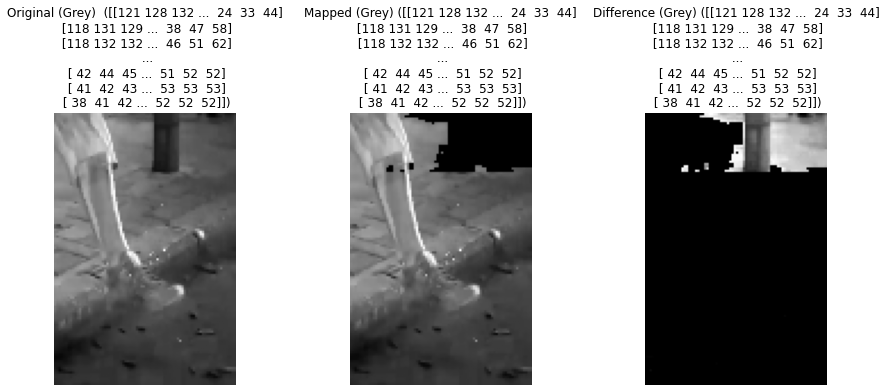

Modified Pixels for 435_Blue_Right:
  Index: 0, Pixel: (0, 26), Original: 105, Mapped: 105, New: 0
  Index: 1, Pixel: (0, 27), Original: 105, Mapped: 105, New: 0
  Index: 2, Pixel: (0, 28), Original: 110, Mapped: 110, New: 0
  Index: 3, Pixel: (0, 29), Original: 110, Mapped: 110, New: 0
  Index: 4, Pixel: (0, 30), Original: 105, Mapped: 105, New: 0
  Index: 5, Pixel: (0, 31), Original: 102, Mapped: 102, New: 0
  Index: 6, Pixel: (0, 32), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 33), Original: 78, Mapped: 78, New: 0
  Index: 8, Pixel: (0, 34), Original: 74, Mapped: 74, New: 0
  Index: 9, Pixel: (0, 35), Original: 76, Mapped: 76, New: 0
  Index: 10, Pixel: (0, 36), Original: 80, Mapped: 80, New: 0
  Index: 11, Pixel: (0, 37), Original: 83, Mapped: 83, New: 0
  Index: 12, Pixel: (0, 38), Original: 83, Mapped: 83, New: 0
  Index: 13, Pixel: (0, 39), Original: 84, Mapped: 84, New: 0
  Index: 14, Pixel: (0, 40), Original: 75, Mapped: 75, New: 0
  Index: 15, Pixel: (0, 41), Ori

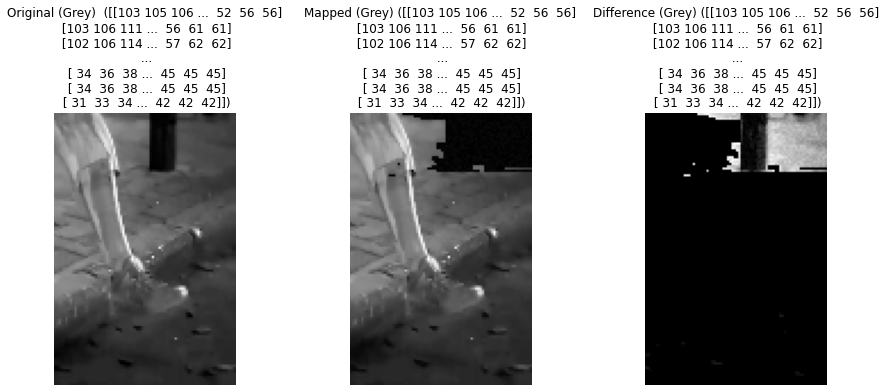

Modified Pixels for 436_Red_Right:
  Index: 0, Pixel: (0, 23), Original: 94, Mapped: 94, New: 5
  Index: 1, Pixel: (0, 24), Original: 91, Mapped: 91, New: 7
  Index: 2, Pixel: (0, 25), Original: 89, Mapped: 89, New: 3
  Index: 3, Pixel: (0, 26), Original: 92, Mapped: 92, New: 1
  Index: 4, Pixel: (0, 27), Original: 95, Mapped: 95, New: 2
  Index: 5, Pixel: (0, 28), Original: 91, Mapped: 91, New: 3
  Index: 6, Pixel: (0, 29), Original: 87, Mapped: 87, New: 5
  Index: 7, Pixel: (0, 30), Original: 84, Mapped: 84, New: 6
  Index: 8, Pixel: (0, 31), Original: 84, Mapped: 84, New: 6
  Index: 9, Pixel: (0, 32), Original: 82, Mapped: 82, New: 6
  Index: 10, Pixel: (0, 33), Original: 80, Mapped: 80, New: 5
  Index: 11, Pixel: (0, 34), Original: 82, Mapped: 82, New: 4
  Index: 12, Pixel: (0, 35), Original: 81, Mapped: 81, New: 6
  Index: 13, Pixel: (0, 36), Original: 76, Mapped: 76, New: 0
  Index: 14, Pixel: (0, 37), Original: 75, Mapped: 75, New: 3
  Index: 15, Pixel: (0, 38), Original: 76, Ma

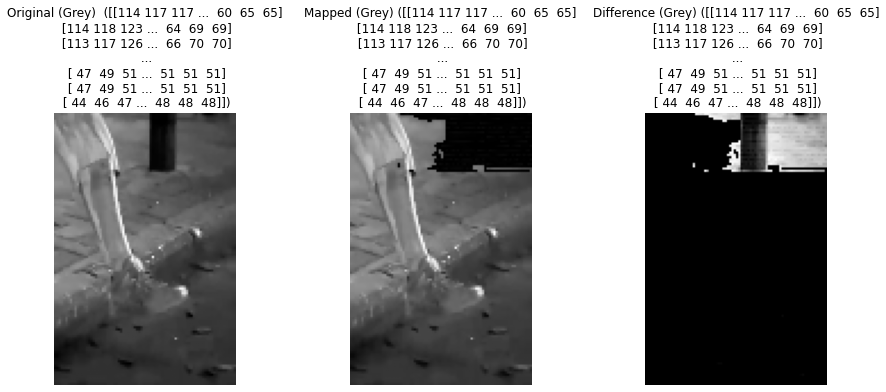

Modified Pixels for 436_Green_Right:
  Index: 0, Pixel: (0, 22), Original: 103, Mapped: 103, New: 4
  Index: 1, Pixel: (0, 23), Original: 97, Mapped: 97, New: 0
  Index: 2, Pixel: (0, 24), Original: 99, Mapped: 99, New: 5
  Index: 3, Pixel: (0, 25), Original: 99, Mapped: 99, New: 8
  Index: 4, Pixel: (0, 26), Original: 102, Mapped: 102, New: 1
  Index: 5, Pixel: (0, 27), Original: 104, Mapped: 104, New: 3
  Index: 6, Pixel: (0, 28), Original: 101, Mapped: 101, New: 4
  Index: 7, Pixel: (0, 29), Original: 96, Mapped: 96, New: 4
  Index: 8, Pixel: (0, 30), Original: 93, Mapped: 93, New: 4
  Index: 9, Pixel: (0, 31), Original: 92, Mapped: 92, New: 4
  Index: 10, Pixel: (0, 32), Original: 95, Mapped: 95, New: 3
  Index: 11, Pixel: (0, 33), Original: 94, Mapped: 94, New: 2
  Index: 12, Pixel: (0, 34), Original: 96, Mapped: 96, New: 2
  Index: 13, Pixel: (0, 35), Original: 95, Mapped: 95, New: 2
  Index: 14, Pixel: (0, 36), Original: 90, Mapped: 90, New: 2
  Index: 15, Pixel: (0, 37), Origin

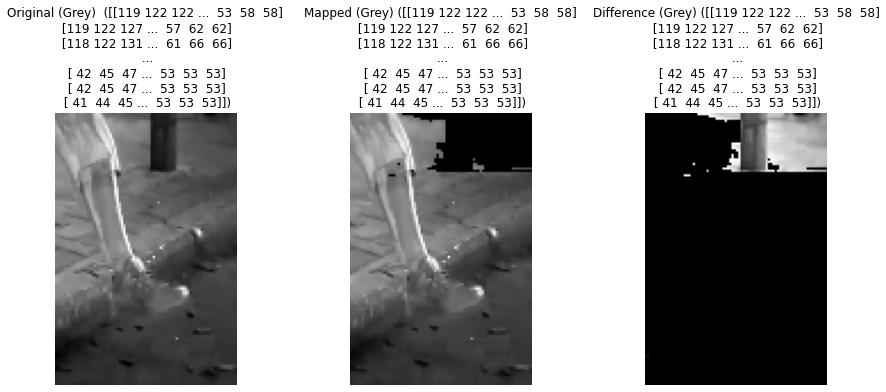

Modified Pixels for 436_Blue_Right:
  Index: 0, Pixel: (0, 23), Original: 107, Mapped: 107, New: 0
  Index: 1, Pixel: (0, 24), Original: 106, Mapped: 106, New: 0
  Index: 2, Pixel: (0, 25), Original: 102, Mapped: 102, New: 0
  Index: 3, Pixel: (0, 26), Original: 105, Mapped: 105, New: 0
  Index: 4, Pixel: (0, 27), Original: 108, Mapped: 108, New: 0
  Index: 5, Pixel: (0, 28), Original: 104, Mapped: 104, New: 0
  Index: 6, Pixel: (0, 29), Original: 100, Mapped: 100, New: 0
  Index: 7, Pixel: (0, 30), Original: 93, Mapped: 93, New: 0
  Index: 8, Pixel: (0, 31), Original: 88, Mapped: 88, New: 0
  Index: 9, Pixel: (0, 32), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (0, 33), Original: 83, Mapped: 83, New: 0
  Index: 11, Pixel: (0, 34), Original: 84, Mapped: 84, New: 0
  Index: 12, Pixel: (0, 35), Original: 87, Mapped: 87, New: 0
  Index: 13, Pixel: (0, 36), Original: 84, Mapped: 84, New: 0
  Index: 14, Pixel: (0, 37), Original: 85, Mapped: 85, New: 0
  Index: 15, Pixel: (0, 38), O

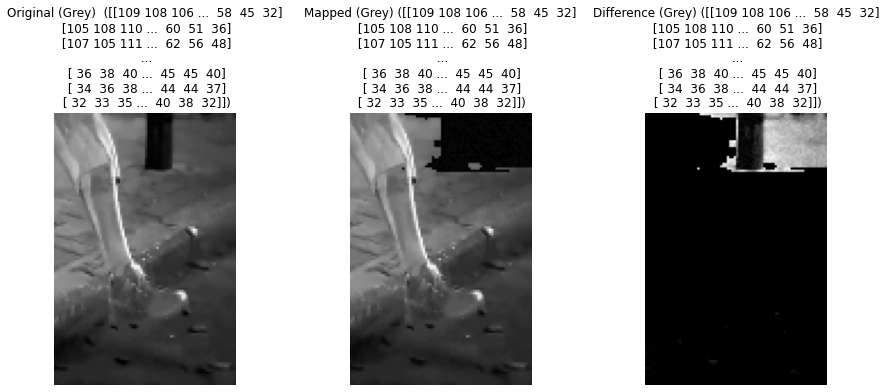

Modified Pixels for 437_Red_Right:
  Index: 0, Pixel: (0, 24), Original: 93, Mapped: 93, New: 8
  Index: 1, Pixel: (0, 25), Original: 93, Mapped: 93, New: 1
  Index: 2, Pixel: (0, 26), Original: 94, Mapped: 94, New: 9
  Index: 3, Pixel: (0, 27), Original: 89, Mapped: 89, New: 1
  Index: 4, Pixel: (0, 28), Original: 87, Mapped: 87, New: 9
  Index: 5, Pixel: (0, 29), Original: 88, Mapped: 88, New: 4
  Index: 6, Pixel: (0, 30), Original: 85, Mapped: 85, New: 9
  Index: 7, Pixel: (0, 31), Original: 81, Mapped: 81, New: 9
  Index: 8, Pixel: (0, 32), Original: 80, Mapped: 80, New: 9
  Index: 9, Pixel: (0, 33), Original: 80, Mapped: 80, New: 5
  Index: 10, Pixel: (0, 34), Original: 78, Mapped: 78, New: 7
  Index: 11, Pixel: (0, 35), Original: 76, Mapped: 76, New: 1
  Index: 12, Pixel: (0, 36), Original: 73, Mapped: 73, New: 5
  Index: 13, Pixel: (0, 37), Original: 72, Mapped: 72, New: 4
  Index: 14, Pixel: (0, 38), Original: 76, Mapped: 76, New: 4
  Index: 15, Pixel: (0, 39), Original: 76, Ma

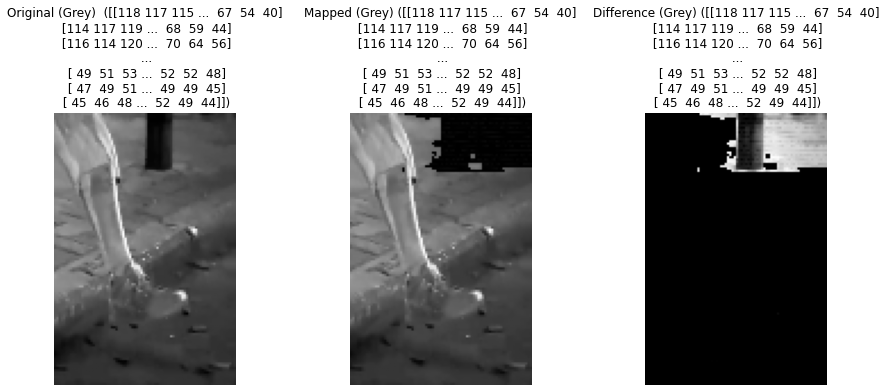

Modified Pixels for 437_Green_Right:
  Index: 0, Pixel: (0, 24), Original: 102, Mapped: 102, New: 2
  Index: 1, Pixel: (0, 25), Original: 102, Mapped: 102, New: 8
  Index: 2, Pixel: (0, 26), Original: 103, Mapped: 103, New: 4
  Index: 3, Pixel: (0, 27), Original: 99, Mapped: 99, New: 0
  Index: 4, Pixel: (0, 28), Original: 96, Mapped: 96, New: 4
  Index: 5, Pixel: (0, 29), Original: 95, Mapped: 95, New: 8
  Index: 6, Pixel: (0, 30), Original: 94, Mapped: 94, New: 1
  Index: 7, Pixel: (0, 31), Original: 94, Mapped: 94, New: 3
  Index: 8, Pixel: (0, 32), Original: 94, Mapped: 94, New: 4
  Index: 9, Pixel: (0, 33), Original: 94, Mapped: 94, New: 5
  Index: 10, Pixel: (0, 34), Original: 91, Mapped: 91, New: 4
  Index: 11, Pixel: (0, 35), Original: 89, Mapped: 89, New: 3
  Index: 12, Pixel: (0, 36), Original: 86, Mapped: 86, New: 8
  Index: 13, Pixel: (0, 37), Original: 84, Mapped: 84, New: 2
  Index: 14, Pixel: (0, 38), Original: 89, Mapped: 89, New: 5
  Index: 15, Pixel: (0, 39), Original

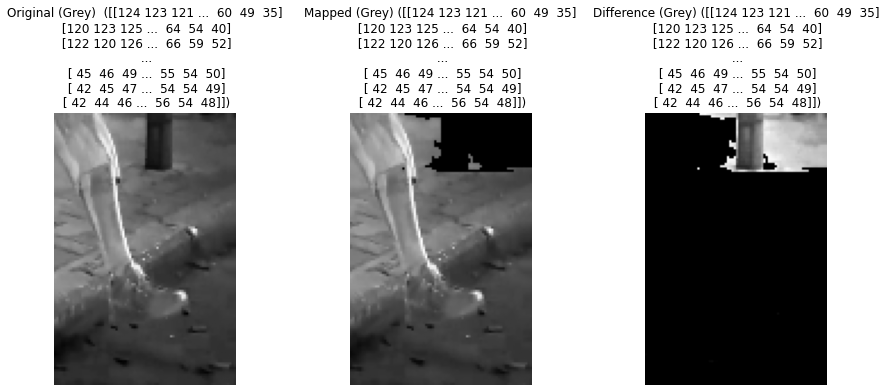

Modified Pixels for 437_Blue_Right:
  Index: 0, Pixel: (0, 24), Original: 107, Mapped: 107, New: 0
  Index: 1, Pixel: (0, 25), Original: 105, Mapped: 105, New: 0
  Index: 2, Pixel: (0, 26), Original: 107, Mapped: 107, New: 0
  Index: 3, Pixel: (0, 27), Original: 102, Mapped: 102, New: 0
  Index: 4, Pixel: (0, 28), Original: 100, Mapped: 100, New: 0
  Index: 5, Pixel: (0, 29), Original: 96, Mapped: 96, New: 0
  Index: 6, Pixel: (0, 30), Original: 94, Mapped: 94, New: 0
  Index: 7, Pixel: (0, 31), Original: 89, Mapped: 89, New: 0
  Index: 8, Pixel: (0, 32), Original: 88, Mapped: 88, New: 0
  Index: 9, Pixel: (0, 33), Original: 87, Mapped: 87, New: 0
  Index: 10, Pixel: (0, 34), Original: 85, Mapped: 85, New: 0
  Index: 11, Pixel: (0, 35), Original: 86, Mapped: 86, New: 0
  Index: 12, Pixel: (0, 36), Original: 83, Mapped: 83, New: 0
  Index: 13, Pixel: (0, 37), Original: 82, Mapped: 82, New: 0
  Index: 14, Pixel: (0, 38), Original: 87, Mapped: 87, New: 0
  Index: 15, Pixel: (0, 39), Origi

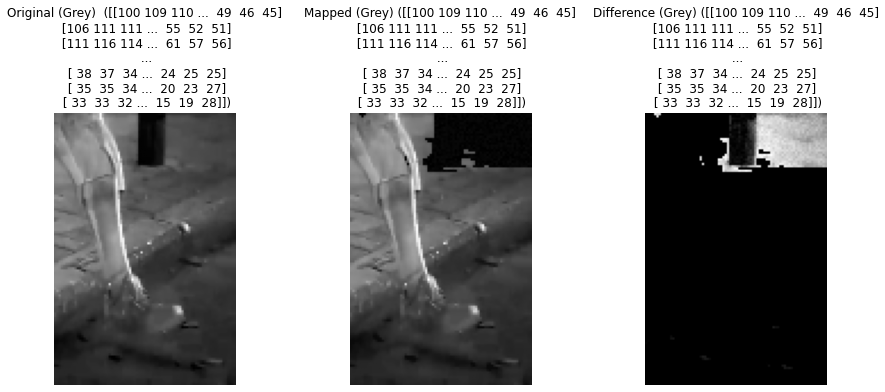

Modified Pixels for 438_Red_Right:
  Index: 0, Pixel: (0, 4), Original: 83, Mapped: 83, New: 1
  Index: 1, Pixel: (0, 5), Original: 76, Mapped: 76, New: 3
  Index: 2, Pixel: (0, 6), Original: 83, Mapped: 83, New: 7
  Index: 3, Pixel: (0, 37), Original: 10, Mapped: 10, New: 8
  Index: 4, Pixel: (0, 38), Original: 4, Mapped: 10, New: 5
  Index: 5, Pixel: (0, 39), Original: 4, Mapped: 10, New: 4
  Index: 6, Pixel: (0, 40), Original: 4, Mapped: 10, New: 0
  Index: 7, Pixel: (0, 41), Original: 4, Mapped: 10, New: 2
  Index: 8, Pixel: (0, 42), Original: 4, Mapped: 10, New: 8
  Index: 9, Pixel: (0, 43), Original: 4, Mapped: 10, New: 7
  Index: 10, Pixel: (0, 44), Original: 4, Mapped: 10, New: 6
  Index: 11, Pixel: (0, 45), Original: 7, Mapped: 10, New: 5
  Index: 12, Pixel: (0, 46), Original: 11, Mapped: 11, New: 9
  Index: 13, Pixel: (0, 47), Original: 7, Mapped: 10, New: 9
  Index: 14, Pixel: (0, 48), Original: 13, Mapped: 13, New: 7
  Index: 15, Pixel: (0, 49), Original: 50, Mapped: 50, Ne

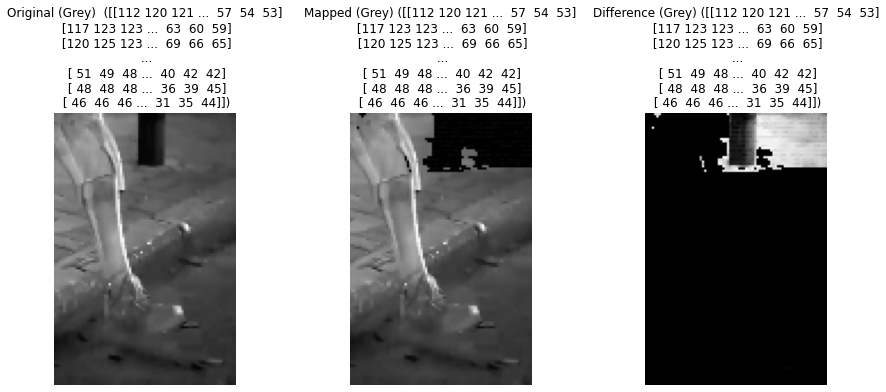

Modified Pixels for 438_Green_Right:
  Index: 0, Pixel: (0, 4), Original: 95, Mapped: 95, New: 9
  Index: 1, Pixel: (0, 5), Original: 88, Mapped: 88, New: 3
  Index: 2, Pixel: (0, 6), Original: 95, Mapped: 95, New: 5
  Index: 3, Pixel: (0, 36), Original: 99, Mapped: 99, New: 6
  Index: 4, Pixel: (0, 37), Original: 19, Mapped: 19, New: 6
  Index: 5, Pixel: (0, 38), Original: 7, Mapped: 10, New: 5
  Index: 6, Pixel: (0, 39), Original: 6, Mapped: 10, New: 3
  Index: 7, Pixel: (0, 40), Original: 6, Mapped: 10, New: 2
  Index: 8, Pixel: (0, 41), Original: 6, Mapped: 10, New: 9
  Index: 9, Pixel: (0, 42), Original: 6, Mapped: 10, New: 7
  Index: 10, Pixel: (0, 43), Original: 6, Mapped: 10, New: 4
  Index: 11, Pixel: (0, 44), Original: 6, Mapped: 10, New: 0
  Index: 12, Pixel: (0, 45), Original: 16, Mapped: 16, New: 6
  Index: 13, Pixel: (0, 46), Original: 29, Mapped: 29, New: 3
  Index: 14, Pixel: (0, 47), Original: 29, Mapped: 29, New: 0
  Index: 15, Pixel: (0, 48), Original: 35, Mapped: 35

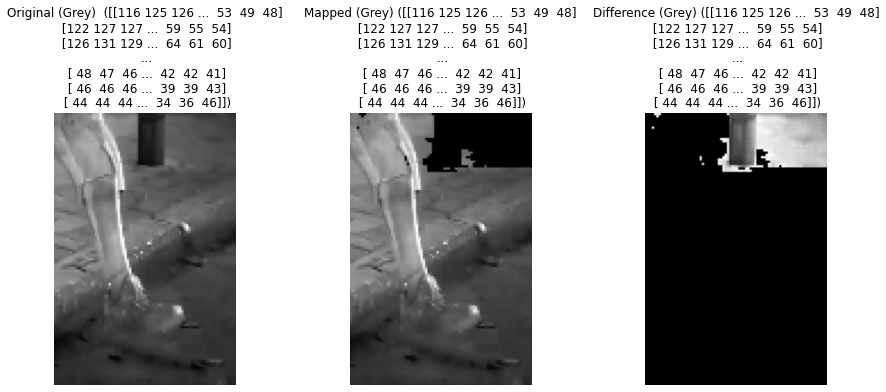

Modified Pixels for 438_Blue_Right:
  Index: 0, Pixel: (0, 4), Original: 99, Mapped: 99, New: 0
  Index: 1, Pixel: (0, 5), Original: 93, Mapped: 93, New: 0
  Index: 2, Pixel: (0, 6), Original: 100, Mapped: 100, New: 0
  Index: 3, Pixel: (0, 36), Original: 103, Mapped: 103, New: 0
  Index: 4, Pixel: (0, 37), Original: 31, Mapped: 31, New: 0
  Index: 5, Pixel: (0, 38), Original: 31, Mapped: 31, New: 0
  Index: 6, Pixel: (0, 39), Original: 33, Mapped: 33, New: 0
  Index: 7, Pixel: (0, 40), Original: 33, Mapped: 33, New: 0
  Index: 8, Pixel: (0, 41), Original: 33, Mapped: 33, New: 0
  Index: 9, Pixel: (0, 42), Original: 33, Mapped: 33, New: 0
  Index: 10, Pixel: (0, 43), Original: 33, Mapped: 33, New: 0
  Index: 11, Pixel: (0, 44), Original: 35, Mapped: 35, New: 0
  Index: 12, Pixel: (0, 45), Original: 43, Mapped: 43, New: 0
  Index: 13, Pixel: (0, 46), Original: 54, Mapped: 54, New: 0
  Index: 14, Pixel: (0, 47), Original: 54, Mapped: 54, New: 0
  Index: 15, Pixel: (0, 48), Original: 57, 

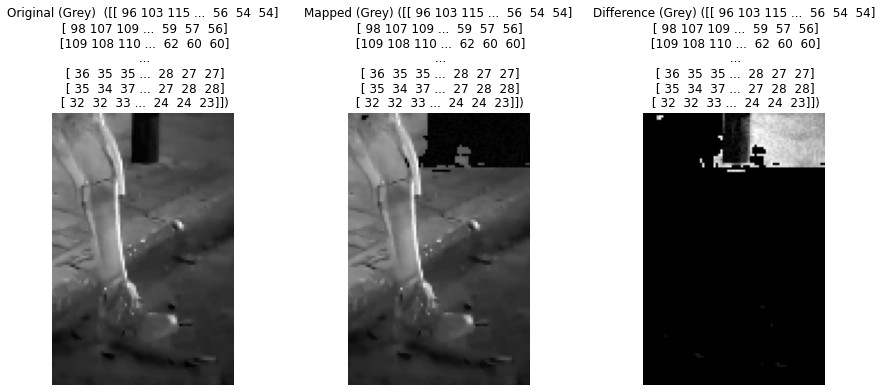

Modified Pixels for 439_Red_Right:
  Index: 0, Pixel: (0, 35), Original: 37, Mapped: 37, New: 8
  Index: 1, Pixel: (0, 36), Original: 5, Mapped: 10, New: 5
  Index: 2, Pixel: (0, 37), Original: 4, Mapped: 10, New: 5
  Index: 3, Pixel: (0, 38), Original: 4, Mapped: 10, New: 8
  Index: 4, Pixel: (0, 39), Original: 4, Mapped: 10, New: 4
  Index: 5, Pixel: (0, 40), Original: 4, Mapped: 10, New: 9
  Index: 6, Pixel: (0, 41), Original: 4, Mapped: 10, New: 5
  Index: 7, Pixel: (0, 42), Original: 5, Mapped: 10, New: 0
  Index: 8, Pixel: (0, 43), Original: 6, Mapped: 10, New: 2
  Index: 9, Pixel: (0, 44), Original: 1, Mapped: 10, New: 6
  Index: 10, Pixel: (0, 45), Original: 0, Mapped: 10, New: 2
  Index: 11, Pixel: (0, 46), Original: 5, Mapped: 10, New: 4
  Index: 12, Pixel: (0, 47), Original: 59, Mapped: 59, New: 7
  Index: 13, Pixel: (0, 48), Original: 77, Mapped: 77, New: 4
  Index: 14, Pixel: (0, 49), Original: 76, Mapped: 76, New: 0
  Index: 15, Pixel: (0, 50), Original: 73, Mapped: 73, N

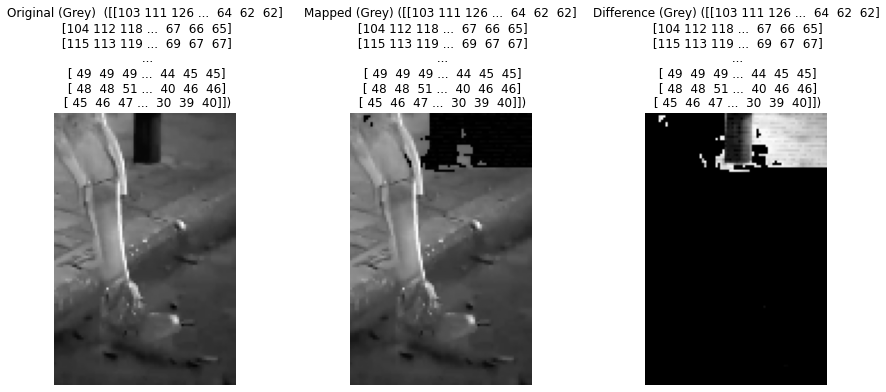

Modified Pixels for 439_Green_Right:
  Index: 0, Pixel: (0, 35), Original: 41, Mapped: 41, New: 2
  Index: 1, Pixel: (0, 36), Original: 8, Mapped: 10, New: 0
  Index: 2, Pixel: (0, 37), Original: 8, Mapped: 10, New: 2
  Index: 3, Pixel: (0, 38), Original: 7, Mapped: 10, New: 4
  Index: 4, Pixel: (0, 39), Original: 6, Mapped: 10, New: 6
  Index: 5, Pixel: (0, 40), Original: 6, Mapped: 10, New: 8
  Index: 6, Pixel: (0, 41), Original: 6, Mapped: 10, New: 0
  Index: 7, Pixel: (0, 42), Original: 9, Mapped: 10, New: 2
  Index: 8, Pixel: (0, 43), Original: 11, Mapped: 11, New: 4
  Index: 9, Pixel: (0, 44), Original: 13, Mapped: 13, New: 6
  Index: 10, Pixel: (0, 45), Original: 21, Mapped: 21, New: 8
  Index: 11, Pixel: (0, 46), Original: 27, Mapped: 27, New: 9
  Index: 12, Pixel: (0, 47), Original: 79, Mapped: 79, New: 9
  Index: 13, Pixel: (0, 48), Original: 91, Mapped: 91, New: 9
  Index: 14, Pixel: (0, 49), Original: 89, Mapped: 89, New: 7
  Index: 15, Pixel: (0, 50), Original: 87, Mapped:

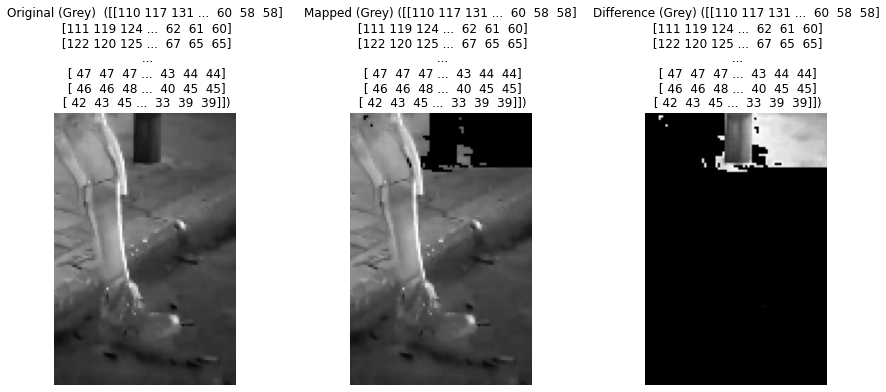

Modified Pixels for 439_Blue_Right:
  Index: 0, Pixel: (0, 35), Original: 53, Mapped: 53, New: 0
  Index: 1, Pixel: (0, 36), Original: 28, Mapped: 28, New: 0
  Index: 2, Pixel: (0, 37), Original: 31, Mapped: 31, New: 0
  Index: 3, Pixel: (0, 38), Original: 32, Mapped: 32, New: 0
  Index: 4, Pixel: (0, 39), Original: 33, Mapped: 33, New: 0
  Index: 5, Pixel: (0, 40), Original: 33, Mapped: 33, New: 0
  Index: 6, Pixel: (0, 41), Original: 33, Mapped: 33, New: 0
  Index: 7, Pixel: (0, 42), Original: 33, Mapped: 33, New: 0
  Index: 8, Pixel: (0, 43), Original: 37, Mapped: 37, New: 0
  Index: 9, Pixel: (0, 44), Original: 36, Mapped: 36, New: 0
  Index: 10, Pixel: (0, 45), Original: 43, Mapped: 43, New: 0
  Index: 11, Pixel: (0, 46), Original: 48, Mapped: 48, New: 0
  Index: 12, Pixel: (0, 47), Original: 92, Mapped: 92, New: 0
  Index: 13, Pixel: (0, 48), Original: 97, Mapped: 97, New: 0
  Index: 14, Pixel: (0, 49), Original: 90, Mapped: 90, New: 0
  Index: 15, Pixel: (0, 50), Original: 87, M

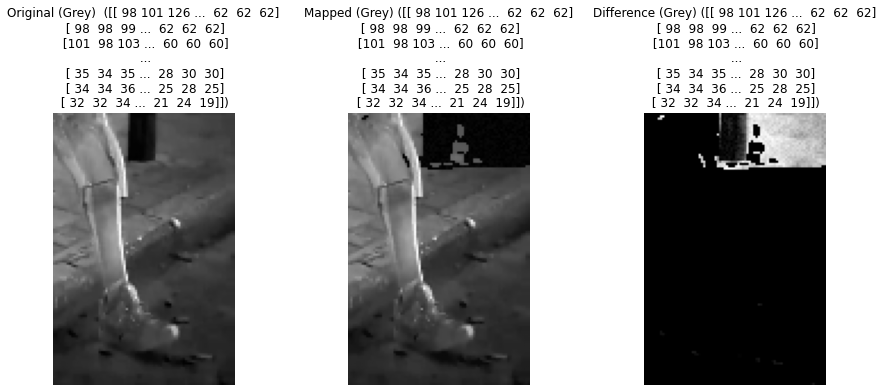

Modified Pixels for 440_Red_Right:
  Index: 0, Pixel: (0, 33), Original: 57, Mapped: 57, New: 1
  Index: 1, Pixel: (0, 34), Original: 5, Mapped: 10, New: 3
  Index: 2, Pixel: (0, 35), Original: 4, Mapped: 10, New: 9
  Index: 3, Pixel: (0, 36), Original: 4, Mapped: 10, New: 9
  Index: 4, Pixel: (0, 37), Original: 4, Mapped: 10, New: 0
  Index: 5, Pixel: (0, 38), Original: 4, Mapped: 10, New: 2
  Index: 6, Pixel: (0, 39), Original: 4, Mapped: 10, New: 9
  Index: 7, Pixel: (0, 40), Original: 4, Mapped: 10, New: 9
  Index: 8, Pixel: (0, 41), Original: 6, Mapped: 10, New: 1
  Index: 9, Pixel: (0, 42), Original: 12, Mapped: 12, New: 2
  Index: 10, Pixel: (0, 43), Original: 14, Mapped: 14, New: 5
  Index: 11, Pixel: (0, 44), Original: 22, Mapped: 22, New: 1
  Index: 12, Pixel: (0, 45), Original: 60, Mapped: 60, New: 4
  Index: 13, Pixel: (0, 46), Original: 82, Mapped: 82, New: 2
  Index: 14, Pixel: (0, 47), Original: 83, Mapped: 83, New: 7
  Index: 15, Pixel: (0, 48), Original: 83, Mapped: 83

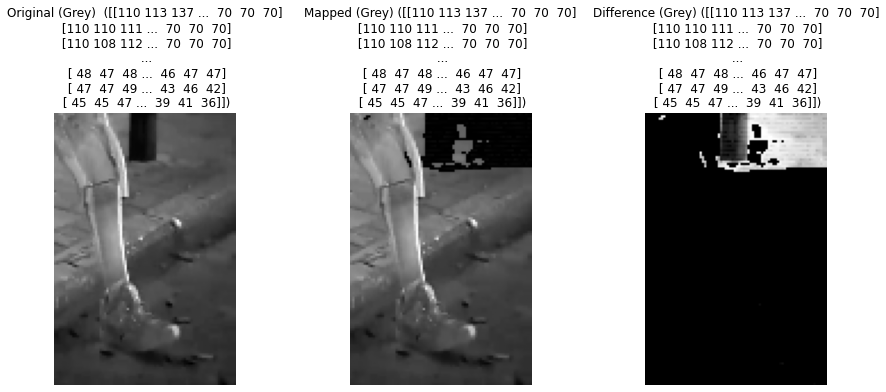

Modified Pixels for 440_Green_Right:
  Index: 0, Pixel: (0, 33), Original: 63, Mapped: 63, New: 5
  Index: 1, Pixel: (0, 34), Original: 10, Mapped: 10, New: 4
  Index: 2, Pixel: (0, 35), Original: 8, Mapped: 10, New: 2
  Index: 3, Pixel: (0, 36), Original: 8, Mapped: 10, New: 0
  Index: 4, Pixel: (0, 37), Original: 8, Mapped: 10, New: 8
  Index: 5, Pixel: (0, 38), Original: 8, Mapped: 10, New: 5
  Index: 6, Pixel: (0, 39), Original: 8, Mapped: 10, New: 1
  Index: 7, Pixel: (0, 40), Original: 9, Mapped: 10, New: 7
  Index: 8, Pixel: (0, 41), Original: 13, Mapped: 13, New: 2
  Index: 9, Pixel: (0, 42), Original: 23, Mapped: 23, New: 1
  Index: 10, Pixel: (0, 43), Original: 29, Mapped: 29, New: 6
  Index: 11, Pixel: (0, 44), Original: 38, Mapped: 38, New: 0
  Index: 12, Pixel: (0, 45), Original: 76, Mapped: 76, New: 3
  Index: 13, Pixel: (0, 46), Original: 94, Mapped: 94, New: 5
  Index: 14, Pixel: (0, 47), Original: 95, Mapped: 95, New: 6
  Index: 15, Pixel: (0, 48), Original: 95, Mapped

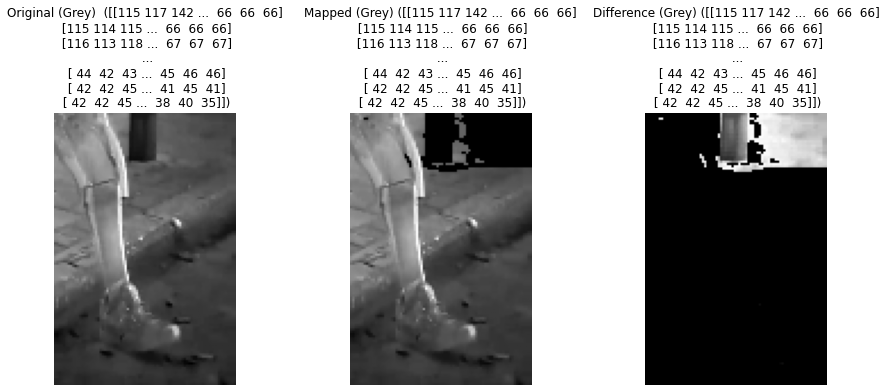

Modified Pixels for 440_Blue_Right:
  Index: 0, Pixel: (0, 33), Original: 71, Mapped: 71, New: 0
  Index: 1, Pixel: (0, 34), Original: 25, Mapped: 25, New: 0
  Index: 2, Pixel: (0, 35), Original: 27, Mapped: 27, New: 0
  Index: 3, Pixel: (0, 36), Original: 31, Mapped: 31, New: 0
  Index: 4, Pixel: (0, 37), Original: 31, Mapped: 31, New: 0
  Index: 5, Pixel: (0, 38), Original: 31, Mapped: 31, New: 0
  Index: 6, Pixel: (0, 39), Original: 31, Mapped: 31, New: 0
  Index: 7, Pixel: (0, 40), Original: 31, Mapped: 31, New: 0
  Index: 8, Pixel: (0, 41), Original: 34, Mapped: 34, New: 0
  Index: 9, Pixel: (0, 42), Original: 42, Mapped: 42, New: 0
  Index: 10, Pixel: (0, 43), Original: 50, Mapped: 50, New: 0
  Index: 11, Pixel: (0, 44), Original: 60, Mapped: 60, New: 0
  Index: 12, Pixel: (0, 45), Original: 91, Mapped: 91, New: 0
  Index: 13, Pixel: (0, 49), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 50), Original: 93, Mapped: 93, New: 0
  Index: 15, Pixel: (0, 51), Original: 93, M

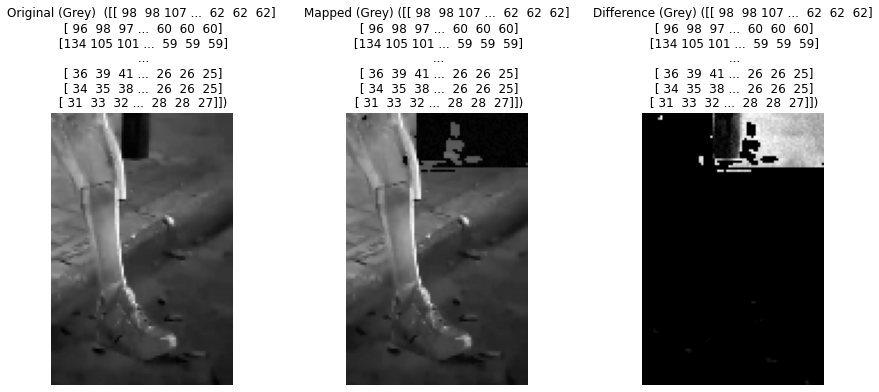

Modified Pixels for 441_Red_Right:
  Index: 0, Pixel: (0, 31), Original: 48, Mapped: 48, New: 9
  Index: 1, Pixel: (0, 32), Original: 5, Mapped: 10, New: 6
  Index: 2, Pixel: (0, 33), Original: 4, Mapped: 10, New: 3
  Index: 3, Pixel: (0, 34), Original: 4, Mapped: 10, New: 0
  Index: 4, Pixel: (0, 35), Original: 4, Mapped: 10, New: 3
  Index: 5, Pixel: (0, 36), Original: 4, Mapped: 10, New: 9
  Index: 6, Pixel: (0, 37), Original: 4, Mapped: 10, New: 3
  Index: 7, Pixel: (0, 38), Original: 4, Mapped: 10, New: 1
  Index: 8, Pixel: (0, 39), Original: 6, Mapped: 10, New: 3
  Index: 9, Pixel: (0, 40), Original: 19, Mapped: 19, New: 5
  Index: 10, Pixel: (0, 41), Original: 25, Mapped: 25, New: 6
  Index: 11, Pixel: (0, 42), Original: 30, Mapped: 30, New: 0
  Index: 12, Pixel: (0, 43), Original: 57, Mapped: 57, New: 4
  Index: 13, Pixel: (0, 44), Original: 80, Mapped: 80, New: 9
  Index: 14, Pixel: (0, 45), Original: 83, Mapped: 83, New: 8
  Index: 15, Pixel: (0, 46), Original: 83, Mapped: 83

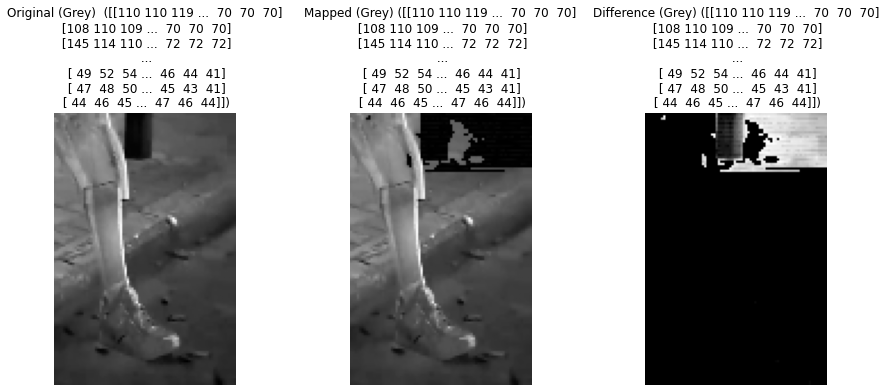

Modified Pixels for 441_Green_Right:
  Index: 0, Pixel: (0, 31), Original: 54, Mapped: 54, New: 3
  Index: 1, Pixel: (0, 32), Original: 10, Mapped: 10, New: 6
  Index: 2, Pixel: (0, 33), Original: 8, Mapped: 10, New: 8
  Index: 3, Pixel: (0, 34), Original: 8, Mapped: 10, New: 9
  Index: 4, Pixel: (0, 35), Original: 8, Mapped: 10, New: 9
  Index: 5, Pixel: (0, 36), Original: 8, Mapped: 10, New: 8
  Index: 6, Pixel: (0, 37), Original: 8, Mapped: 10, New: 7
  Index: 7, Pixel: (0, 38), Original: 10, Mapped: 10, New: 5
  Index: 8, Pixel: (0, 39), Original: 13, Mapped: 13, New: 3
  Index: 9, Pixel: (0, 40), Original: 29, Mapped: 29, New: 1
  Index: 10, Pixel: (0, 41), Original: 39, Mapped: 39, New: 0
  Index: 11, Pixel: (0, 42), Original: 45, Mapped: 45, New: 9
  Index: 12, Pixel: (0, 43), Original: 73, Mapped: 73, New: 8
  Index: 13, Pixel: (0, 44), Original: 92, Mapped: 92, New: 7
  Index: 14, Pixel: (0, 45), Original: 95, Mapped: 95, New: 7
  Index: 15, Pixel: (0, 46), Original: 95, Mappe

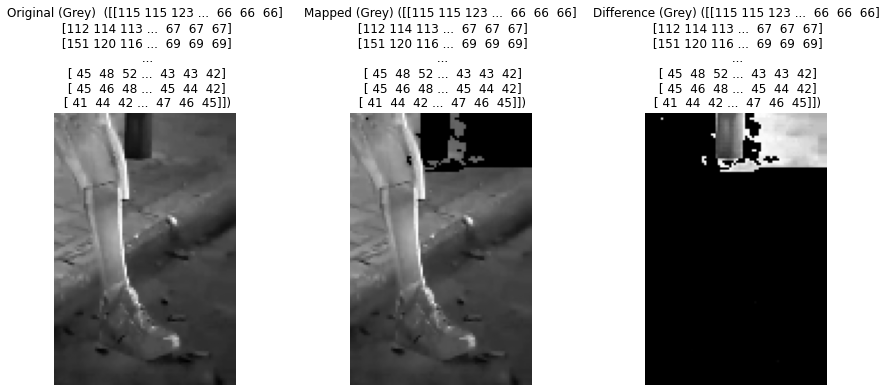

Modified Pixels for 441_Blue_Right:
  Index: 0, Pixel: (0, 31), Original: 63, Mapped: 63, New: 0
  Index: 1, Pixel: (0, 32), Original: 25, Mapped: 25, New: 0
  Index: 2, Pixel: (0, 33), Original: 27, Mapped: 27, New: 0
  Index: 3, Pixel: (0, 34), Original: 31, Mapped: 31, New: 0
  Index: 4, Pixel: (0, 35), Original: 31, Mapped: 31, New: 0
  Index: 5, Pixel: (0, 36), Original: 31, Mapped: 31, New: 0
  Index: 6, Pixel: (0, 37), Original: 31, Mapped: 31, New: 0
  Index: 7, Pixel: (0, 38), Original: 32, Mapped: 32, New: 0
  Index: 8, Pixel: (0, 39), Original: 34, Mapped: 34, New: 0
  Index: 9, Pixel: (0, 40), Original: 48, Mapped: 48, New: 0
  Index: 10, Pixel: (0, 41), Original: 60, Mapped: 60, New: 0
  Index: 11, Pixel: (0, 42), Original: 67, Mapped: 67, New: 0
  Index: 12, Pixel: (0, 43), Original: 90, Mapped: 90, New: 0
  Index: 13, Pixel: (0, 48), Original: 95, Mapped: 95, New: 0
  Index: 14, Pixel: (0, 49), Original: 95, Mapped: 95, New: 0
  Index: 15, Pixel: (0, 50), Original: 94, M

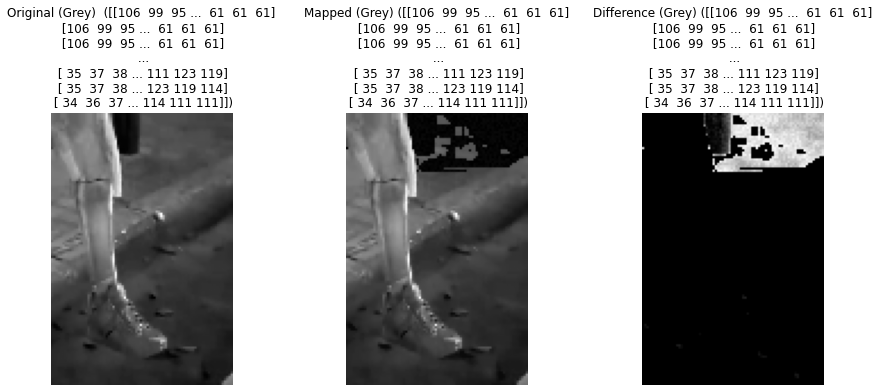

Modified Pixels for 442_Red_Right:
  Index: 0, Pixel: (0, 27), Original: 25, Mapped: 25, New: 3
  Index: 1, Pixel: (0, 28), Original: 5, Mapped: 10, New: 8
  Index: 2, Pixel: (0, 29), Original: 8, Mapped: 10, New: 0
  Index: 3, Pixel: (0, 30), Original: 8, Mapped: 10, New: 6
  Index: 4, Pixel: (0, 31), Original: 12, Mapped: 12, New: 3
  Index: 5, Pixel: (0, 32), Original: 12, Mapped: 12, New: 0
  Index: 6, Pixel: (0, 33), Original: 5, Mapped: 10, New: 3
  Index: 7, Pixel: (0, 34), Original: 9, Mapped: 10, New: 9
  Index: 8, Pixel: (0, 35), Original: 19, Mapped: 19, New: 7
  Index: 9, Pixel: (0, 36), Original: 26, Mapped: 26, New: 3
  Index: 10, Pixel: (0, 37), Original: 32, Mapped: 32, New: 9
  Index: 11, Pixel: (0, 38), Original: 44, Mapped: 44, New: 6
  Index: 12, Pixel: (0, 39), Original: 71, Mapped: 71, New: 5
  Index: 13, Pixel: (0, 40), Original: 78, Mapped: 78, New: 4
  Index: 14, Pixel: (0, 41), Original: 77, Mapped: 77, New: 2
  Index: 15, Pixel: (0, 42), Original: 77, Mapped:

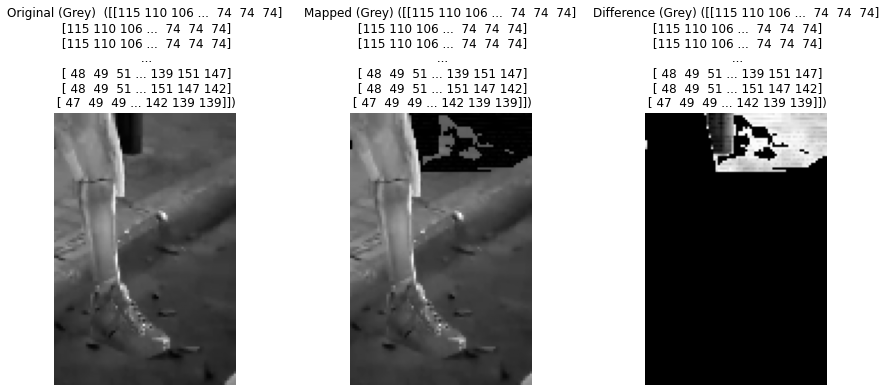

Modified Pixels for 442_Green_Right:
  Index: 0, Pixel: (0, 26), Original: 82, Mapped: 82, New: 0
  Index: 1, Pixel: (0, 27), Original: 26, Mapped: 26, New: 0
  Index: 2, Pixel: (0, 28), Original: 8, Mapped: 10, New: 9
  Index: 3, Pixel: (0, 29), Original: 10, Mapped: 10, New: 7
  Index: 4, Pixel: (0, 30), Original: 10, Mapped: 10, New: 4
  Index: 5, Pixel: (0, 31), Original: 15, Mapped: 15, New: 1
  Index: 6, Pixel: (0, 32), Original: 14, Mapped: 14, New: 0
  Index: 7, Pixel: (0, 33), Original: 11, Mapped: 11, New: 3
  Index: 8, Pixel: (0, 34), Original: 18, Mapped: 18, New: 4
  Index: 9, Pixel: (0, 35), Original: 32, Mapped: 32, New: 5
  Index: 10, Pixel: (0, 36), Original: 42, Mapped: 42, New: 6
  Index: 11, Pixel: (0, 37), Original: 49, Mapped: 49, New: 6
  Index: 12, Pixel: (0, 38), Original: 60, Mapped: 60, New: 5
  Index: 13, Pixel: (0, 39), Original: 84, Mapped: 84, New: 5
  Index: 14, Pixel: (0, 40), Original: 90, Mapped: 90, New: 5
  Index: 15, Pixel: (0, 41), Original: 89, M

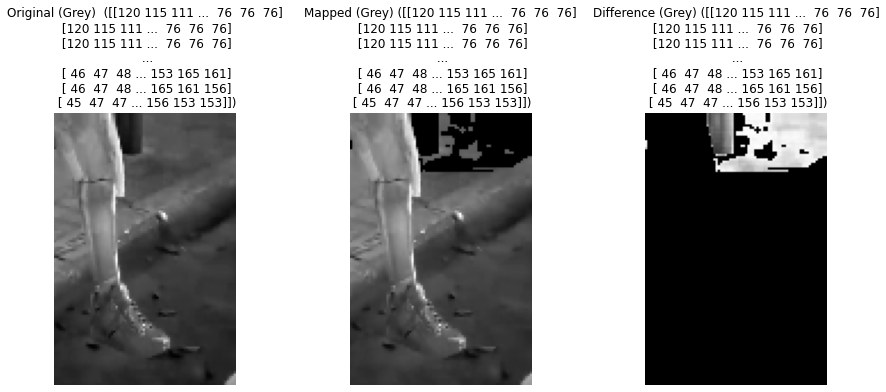

Modified Pixels for 442_Blue_Right:
  Index: 0, Pixel: (0, 27), Original: 41, Mapped: 41, New: 0
  Index: 1, Pixel: (0, 28), Original: 26, Mapped: 26, New: 0
  Index: 2, Pixel: (0, 29), Original: 35, Mapped: 35, New: 0
  Index: 3, Pixel: (0, 30), Original: 37, Mapped: 37, New: 0
  Index: 4, Pixel: (0, 31), Original: 41, Mapped: 41, New: 0
  Index: 5, Pixel: (0, 32), Original: 41, Mapped: 41, New: 0
  Index: 6, Pixel: (0, 33), Original: 33, Mapped: 33, New: 0
  Index: 7, Pixel: (0, 34), Original: 38, Mapped: 38, New: 0
  Index: 8, Pixel: (0, 35), Original: 51, Mapped: 51, New: 0
  Index: 9, Pixel: (0, 36), Original: 60, Mapped: 60, New: 0
  Index: 10, Pixel: (0, 37), Original: 68, Mapped: 68, New: 0
  Index: 11, Pixel: (0, 38), Original: 77, Mapped: 77, New: 0
  Index: 12, Pixel: (0, 43), Original: 92, Mapped: 92, New: 0
  Index: 13, Pixel: (0, 44), Original: 90, Mapped: 90, New: 0
  Index: 14, Pixel: (0, 45), Original: 90, Mapped: 90, New: 0
  Index: 15, Pixel: (0, 46), Original: 90, M

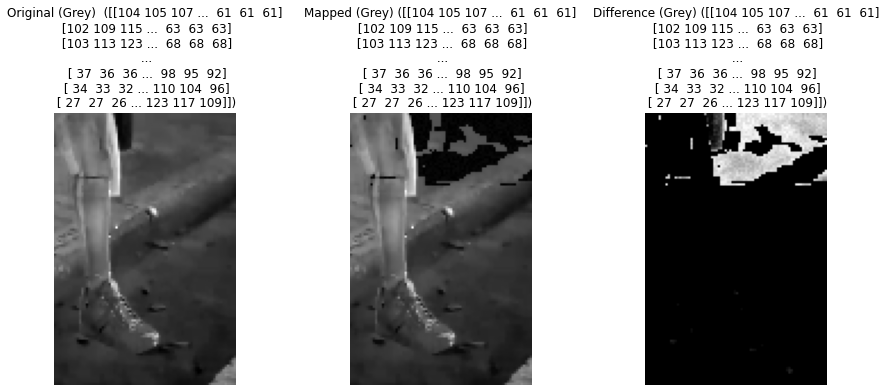

Modified Pixels for 443_Red_Right:
  Index: 0, Pixel: (0, 26), Original: 47, Mapped: 47, New: 0
  Index: 1, Pixel: (0, 27), Original: 12, Mapped: 12, New: 6
  Index: 2, Pixel: (0, 28), Original: 5, Mapped: 10, New: 9
  Index: 3, Pixel: (0, 29), Original: 7, Mapped: 10, New: 3
  Index: 4, Pixel: (0, 30), Original: 19, Mapped: 19, New: 3
  Index: 5, Pixel: (0, 31), Original: 24, Mapped: 24, New: 7
  Index: 6, Pixel: (0, 32), Original: 24, Mapped: 24, New: 5
  Index: 7, Pixel: (0, 33), Original: 34, Mapped: 34, New: 9
  Index: 8, Pixel: (0, 34), Original: 60, Mapped: 60, New: 1
  Index: 9, Pixel: (0, 40), Original: 77, Mapped: 77, New: 3
  Index: 10, Pixel: (0, 41), Original: 76, Mapped: 76, New: 9
  Index: 11, Pixel: (0, 42), Original: 76, Mapped: 76, New: 5
  Index: 12, Pixel: (0, 43), Original: 76, Mapped: 76, New: 1
  Index: 13, Pixel: (0, 44), Original: 74, Mapped: 74, New: 6
  Index: 14, Pixel: (0, 45), Original: 73, Mapped: 73, New: 2
  Index: 15, Pixel: (0, 46), Original: 73, Mapp

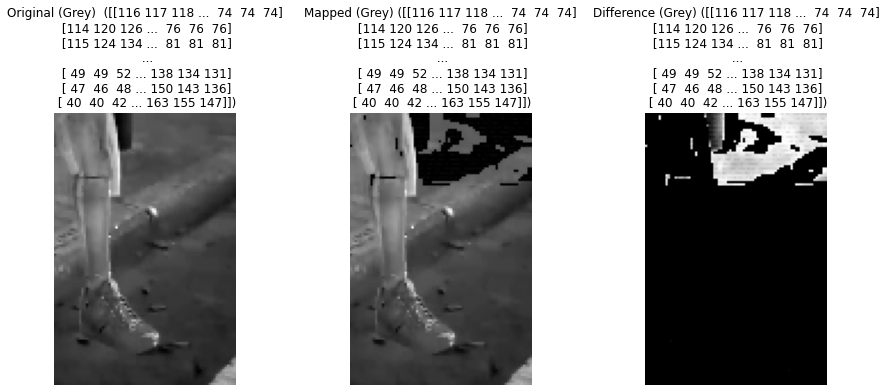

Modified Pixels for 443_Green_Right:
  Index: 0, Pixel: (0, 26), Original: 44, Mapped: 44, New: 6
  Index: 1, Pixel: (0, 27), Original: 10, Mapped: 10, New: 0
  Index: 2, Pixel: (0, 28), Original: 12, Mapped: 12, New: 4
  Index: 3, Pixel: (0, 29), Original: 15, Mapped: 15, New: 1
  Index: 4, Pixel: (0, 30), Original: 27, Mapped: 27, New: 6
  Index: 5, Pixel: (0, 31), Original: 33, Mapped: 33, New: 9
  Index: 6, Pixel: (0, 32), Original: 43, Mapped: 43, New: 9
  Index: 7, Pixel: (0, 33), Original: 55, Mapped: 55, New: 8
  Index: 8, Pixel: (0, 34), Original: 80, Mapped: 80, New: 6
  Index: 9, Pixel: (0, 41), Original: 89, Mapped: 89, New: 4
  Index: 10, Pixel: (0, 42), Original: 89, Mapped: 89, New: 3
  Index: 11, Pixel: (0, 43), Original: 89, Mapped: 89, New: 3
  Index: 12, Pixel: (0, 44), Original: 87, Mapped: 87, New: 4
  Index: 13, Pixel: (0, 45), Original: 86, Mapped: 86, New: 6
  Index: 14, Pixel: (0, 46), Original: 86, Mapped: 86, New: 0
  Index: 15, Pixel: (0, 47), Original: 86, 

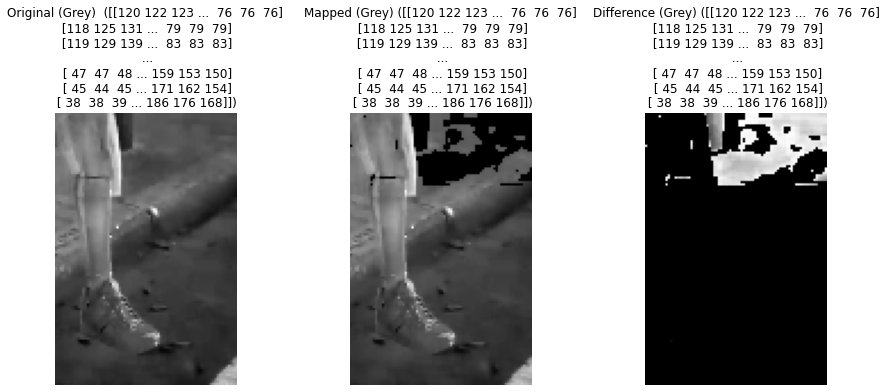

Modified Pixels for 443_Blue_Right:
  Index: 0, Pixel: (0, 26), Original: 66, Mapped: 66, New: 0
  Index: 1, Pixel: (0, 27), Original: 32, Mapped: 32, New: 0
  Index: 2, Pixel: (0, 28), Original: 40, Mapped: 40, New: 0
  Index: 3, Pixel: (0, 29), Original: 44, Mapped: 44, New: 0
  Index: 4, Pixel: (0, 30), Original: 57, Mapped: 57, New: 0
  Index: 5, Pixel: (0, 31), Original: 61, Mapped: 61, New: 0
  Index: 6, Pixel: (0, 32), Original: 62, Mapped: 62, New: 0
  Index: 7, Pixel: (0, 33), Original: 70, Mapped: 70, New: 0
  Index: 8, Pixel: (0, 34), Original: 90, Mapped: 90, New: 0
  Index: 9, Pixel: (0, 44), Original: 89, Mapped: 89, New: 0
  Index: 10, Pixel: (0, 45), Original: 88, Mapped: 88, New: 0
  Index: 11, Pixel: (0, 46), Original: 88, Mapped: 88, New: 0
  Index: 12, Pixel: (0, 47), Original: 88, Mapped: 88, New: 0
  Index: 13, Pixel: (0, 48), Original: 88, Mapped: 88, New: 0
  Index: 14, Pixel: (0, 49), Original: 89, Mapped: 89, New: 0
  Index: 15, Pixel: (0, 56), Original: 86, M

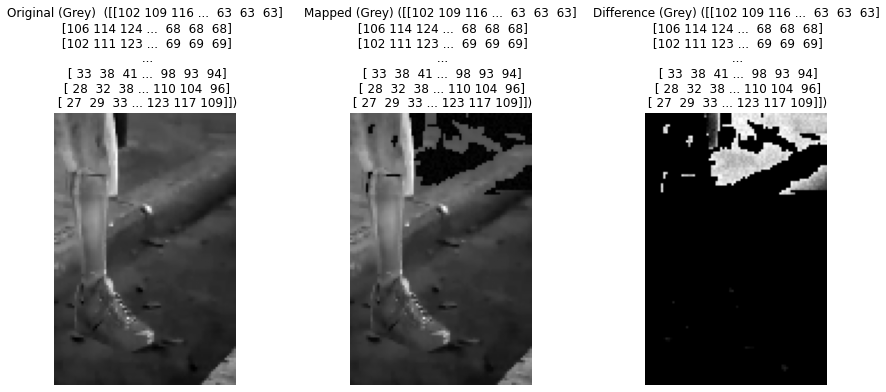

Modified Pixels for 444_Red_Right:
  Index: 0, Pixel: (0, 26), Original: 26, Mapped: 26, New: 9
  Index: 1, Pixel: (0, 27), Original: 10, Mapped: 10, New: 7
  Index: 2, Pixel: (0, 28), Original: 21, Mapped: 21, New: 9
  Index: 3, Pixel: (0, 29), Original: 23, Mapped: 23, New: 4
  Index: 4, Pixel: (0, 30), Original: 26, Mapped: 26, New: 2
  Index: 5, Pixel: (0, 31), Original: 35, Mapped: 35, New: 2
  Index: 6, Pixel: (0, 32), Original: 67, Mapped: 67, New: 1
  Index: 7, Pixel: (0, 38), Original: 76, Mapped: 76, New: 0
  Index: 8, Pixel: (0, 39), Original: 76, Mapped: 76, New: 7
  Index: 9, Pixel: (0, 40), Original: 76, Mapped: 76, New: 6
  Index: 10, Pixel: (0, 41), Original: 75, Mapped: 75, New: 9
  Index: 11, Pixel: (0, 42), Original: 74, Mapped: 74, New: 3
  Index: 12, Pixel: (0, 43), Original: 74, Mapped: 74, New: 9
  Index: 13, Pixel: (0, 44), Original: 74, Mapped: 74, New: 8
  Index: 14, Pixel: (0, 45), Original: 74, Mapped: 74, New: 2
  Index: 15, Pixel: (0, 46), Original: 73, Ma

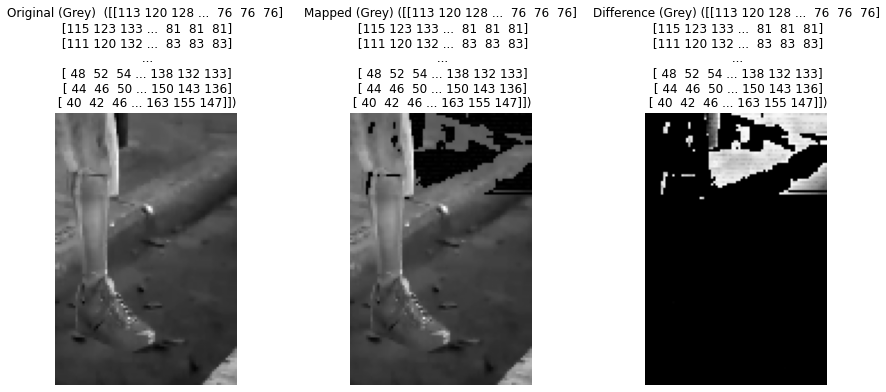

Modified Pixels for 444_Green_Right:
  Index: 0, Pixel: (0, 26), Original: 22, Mapped: 22, New: 4
  Index: 1, Pixel: (0, 27), Original: 12, Mapped: 12, New: 8
  Index: 2, Pixel: (0, 28), Original: 29, Mapped: 29, New: 1
  Index: 3, Pixel: (0, 29), Original: 33, Mapped: 33, New: 3
  Index: 4, Pixel: (0, 30), Original: 44, Mapped: 44, New: 3
  Index: 5, Pixel: (0, 31), Original: 57, Mapped: 57, New: 2
  Index: 6, Pixel: (0, 32), Original: 88, Mapped: 88, New: 0
  Index: 7, Pixel: (0, 38), Original: 89, Mapped: 89, New: 7
  Index: 8, Pixel: (0, 39), Original: 89, Mapped: 89, New: 3
  Index: 9, Pixel: (0, 40), Original: 89, Mapped: 89, New: 0
  Index: 10, Pixel: (0, 41), Original: 88, Mapped: 88, New: 2
  Index: 11, Pixel: (0, 42), Original: 87, Mapped: 87, New: 5
  Index: 12, Pixel: (0, 43), Original: 87, Mapped: 87, New: 7
  Index: 13, Pixel: (0, 44), Original: 87, Mapped: 87, New: 7
  Index: 14, Pixel: (0, 45), Original: 87, Mapped: 87, New: 5
  Index: 15, Pixel: (0, 46), Original: 86, 

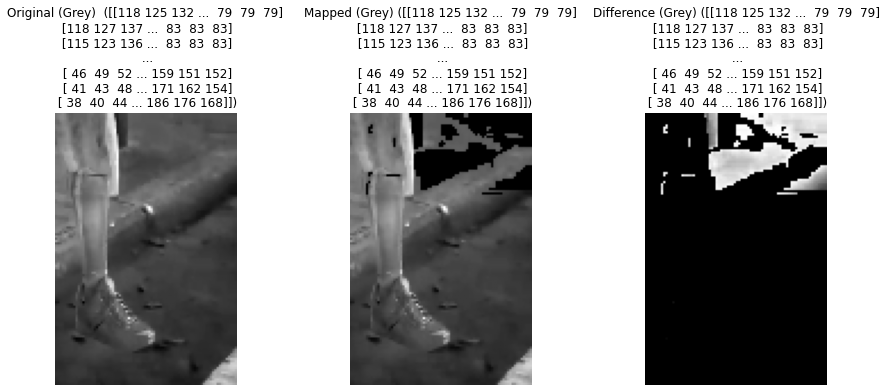

Modified Pixels for 444_Blue_Right:
  Index: 0, Pixel: (0, 26), Original: 44, Mapped: 44, New: 0
  Index: 1, Pixel: (0, 27), Original: 37, Mapped: 37, New: 0
  Index: 2, Pixel: (0, 28), Original: 58, Mapped: 58, New: 0
  Index: 3, Pixel: (0, 29), Original: 61, Mapped: 61, New: 0
  Index: 4, Pixel: (0, 30), Original: 64, Mapped: 64, New: 0
  Index: 5, Pixel: (0, 31), Original: 72, Mapped: 72, New: 0
  Index: 6, Pixel: (0, 42), Original: 89, Mapped: 89, New: 0
  Index: 7, Pixel: (0, 43), Original: 89, Mapped: 89, New: 0
  Index: 8, Pixel: (0, 44), Original: 89, Mapped: 89, New: 0
  Index: 9, Pixel: (0, 45), Original: 89, Mapped: 89, New: 0
  Index: 10, Pixel: (0, 46), Original: 88, Mapped: 88, New: 0
  Index: 11, Pixel: (0, 47), Original: 88, Mapped: 88, New: 0
  Index: 12, Pixel: (0, 48), Original: 88, Mapped: 88, New: 0
  Index: 13, Pixel: (0, 49), Original: 89, Mapped: 89, New: 0
  Index: 14, Pixel: (0, 52), Original: 83, Mapped: 83, New: 0
  Index: 15, Pixel: (0, 53), Original: 84, M

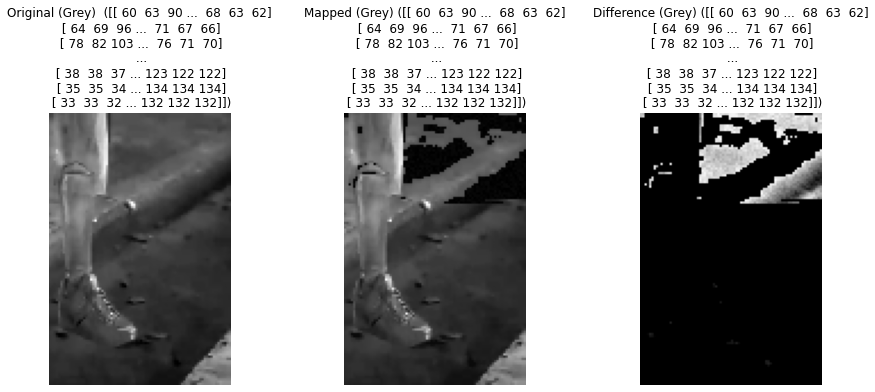

Modified Pixels for 445_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 60, Mapped: 60, New: 2
  Index: 1, Pixel: (0, 1), Original: 63, Mapped: 63, New: 8
  Index: 2, Pixel: (0, 26), Original: 38, Mapped: 38, New: 2
  Index: 3, Pixel: (0, 27), Original: 72, Mapped: 72, New: 7
  Index: 4, Pixel: (0, 32), Original: 76, Mapped: 76, New: 7
  Index: 5, Pixel: (0, 33), Original: 76, Mapped: 76, New: 9
  Index: 6, Pixel: (0, 34), Original: 76, Mapped: 76, New: 0
  Index: 7, Pixel: (0, 35), Original: 76, Mapped: 76, New: 9
  Index: 8, Pixel: (0, 36), Original: 75, Mapped: 75, New: 6
  Index: 9, Pixel: (0, 37), Original: 75, Mapped: 75, New: 9
  Index: 10, Pixel: (0, 38), Original: 75, Mapped: 75, New: 8
  Index: 11, Pixel: (0, 39), Original: 74, Mapped: 74, New: 2
  Index: 12, Pixel: (0, 40), Original: 73, Mapped: 73, New: 0
  Index: 13, Pixel: (0, 41), Original: 73, Mapped: 73, New: 0
  Index: 14, Pixel: (0, 42), Original: 70, Mapped: 70, New: 0
  Index: 15, Pixel: (0, 43), Original: 69, Mapp

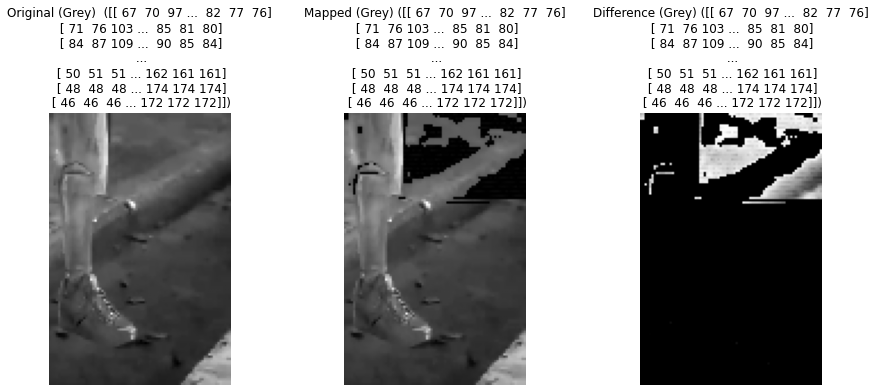

Modified Pixels for 445_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 67, Mapped: 67, New: 5
  Index: 1, Pixel: (0, 1), Original: 70, Mapped: 70, New: 2
  Index: 2, Pixel: (0, 26), Original: 47, Mapped: 47, New: 0
  Index: 3, Pixel: (0, 27), Original: 82, Mapped: 82, New: 1
  Index: 4, Pixel: (0, 39), Original: 88, Mapped: 88, New: 1
  Index: 5, Pixel: (0, 40), Original: 87, Mapped: 87, New: 0
  Index: 6, Pixel: (0, 41), Original: 87, Mapped: 87, New: 1
  Index: 7, Pixel: (0, 42), Original: 84, Mapped: 84, New: 4
  Index: 8, Pixel: (0, 43), Original: 83, Mapped: 83, New: 7
  Index: 9, Pixel: (0, 44), Original: 83, Mapped: 83, New: 0
  Index: 10, Pixel: (0, 45), Original: 83, Mapped: 83, New: 2
  Index: 11, Pixel: (0, 46), Original: 83, Mapped: 83, New: 3
  Index: 12, Pixel: (0, 47), Original: 83, Mapped: 83, New: 2
  Index: 13, Pixel: (0, 48), Original: 82, Mapped: 82, New: 9
  Index: 14, Pixel: (0, 49), Original: 82, Mapped: 82, New: 5
  Index: 15, Pixel: (0, 50), Original: 82, Ma

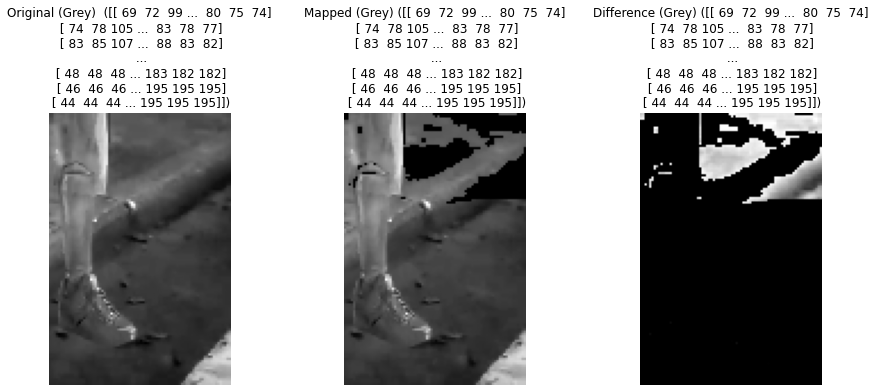

Modified Pixels for 445_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 69, Mapped: 69, New: 0
  Index: 1, Pixel: (0, 1), Original: 72, Mapped: 72, New: 0
  Index: 2, Pixel: (0, 26), Original: 65, Mapped: 65, New: 0
  Index: 3, Pixel: (0, 39), Original: 88, Mapped: 88, New: 0
  Index: 4, Pixel: (0, 40), Original: 87, Mapped: 87, New: 0
  Index: 5, Pixel: (0, 41), Original: 87, Mapped: 87, New: 0
  Index: 6, Pixel: (0, 42), Original: 84, Mapped: 84, New: 0
  Index: 7, Pixel: (0, 43), Original: 83, Mapped: 83, New: 0
  Index: 8, Pixel: (0, 44), Original: 83, Mapped: 83, New: 0
  Index: 9, Pixel: (0, 45), Original: 83, Mapped: 83, New: 0
  Index: 10, Pixel: (0, 46), Original: 83, Mapped: 83, New: 0
  Index: 11, Pixel: (0, 47), Original: 82, Mapped: 82, New: 0
  Index: 12, Pixel: (0, 48), Original: 76, Mapped: 76, New: 0
  Index: 13, Pixel: (0, 49), Original: 75, Mapped: 75, New: 0
  Index: 14, Pixel: (0, 50), Original: 75, Mapped: 75, New: 0
  Index: 15, Pixel: (0, 51), Original: 76, Map

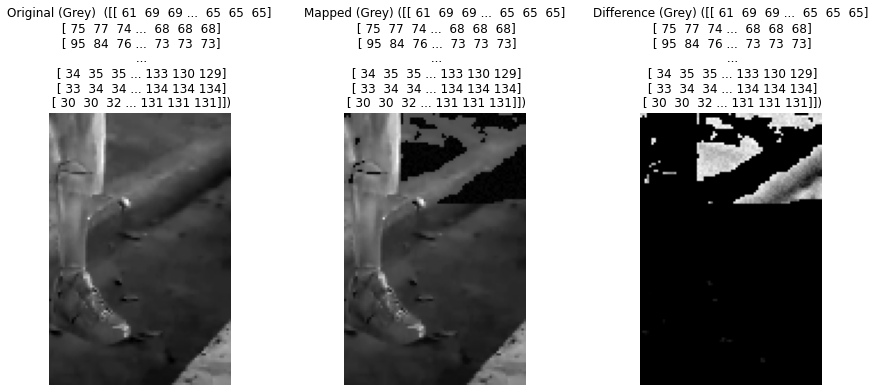

Modified Pixels for 446_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 61, Mapped: 61, New: 3
  Index: 1, Pixel: (0, 1), Original: 69, Mapped: 69, New: 9
  Index: 2, Pixel: (0, 2), Original: 69, Mapped: 69, New: 5
  Index: 3, Pixel: (0, 25), Original: 73, Mapped: 73, New: 9
  Index: 4, Pixel: (0, 39), Original: 75, Mapped: 75, New: 7
  Index: 5, Pixel: (0, 42), Original: 74, Mapped: 74, New: 7
  Index: 6, Pixel: (0, 43), Original: 70, Mapped: 70, New: 0
  Index: 7, Pixel: (0, 44), Original: 69, Mapped: 69, New: 4
  Index: 8, Pixel: (0, 45), Original: 69, Mapped: 69, New: 3
  Index: 9, Pixel: (0, 46), Original: 69, Mapped: 69, New: 4
  Index: 10, Pixel: (0, 47), Original: 68, Mapped: 68, New: 7
  Index: 11, Pixel: (0, 48), Original: 61, Mapped: 61, New: 5
  Index: 12, Pixel: (0, 49), Original: 61, Mapped: 61, New: 4
  Index: 13, Pixel: (0, 50), Original: 73, Mapped: 73, New: 4
  Index: 14, Pixel: (0, 51), Original: 75, Mapped: 75, New: 9
  Index: 15, Pixel: (0, 52), Original: 72, Mappe

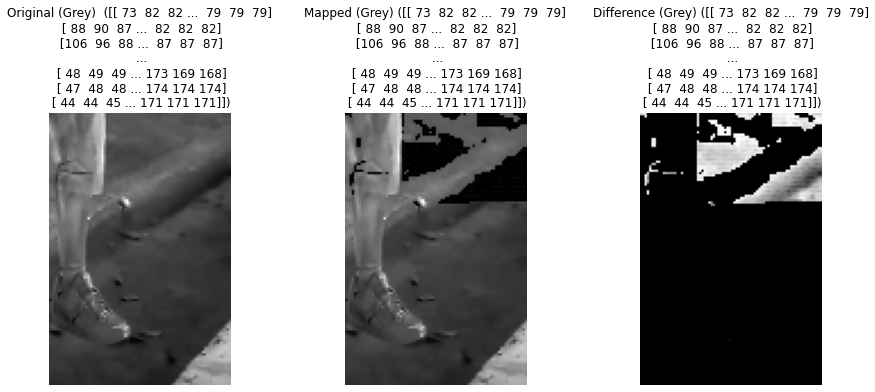

Modified Pixels for 446_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 82, Mapped: 82, New: 4
  Index: 2, Pixel: (0, 2), Original: 82, Mapped: 82, New: 8
  Index: 3, Pixel: (0, 25), Original: 83, Mapped: 83, New: 2
  Index: 4, Pixel: (0, 42), Original: 86, Mapped: 86, New: 6
  Index: 5, Pixel: (0, 43), Original: 83, Mapped: 83, New: 7
  Index: 6, Pixel: (0, 44), Original: 83, Mapped: 83, New: 7
  Index: 7, Pixel: (0, 45), Original: 83, Mapped: 83, New: 5
  Index: 8, Pixel: (0, 46), Original: 83, Mapped: 83, New: 2
  Index: 9, Pixel: (0, 47), Original: 82, Mapped: 82, New: 7
  Index: 10, Pixel: (0, 48), Original: 75, Mapped: 75, New: 2
  Index: 11, Pixel: (0, 49), Original: 75, Mapped: 75, New: 0
  Index: 12, Pixel: (0, 50), Original: 87, Mapped: 87, New: 3
  Index: 13, Pixel: (0, 52), Original: 87, Mapped: 87, New: 5
  Index: 14, Pixel: (0, 58), Original: 86, Mapped: 86, New: 5
  Index: 15, Pixel: (0, 59), Original: 84, Map

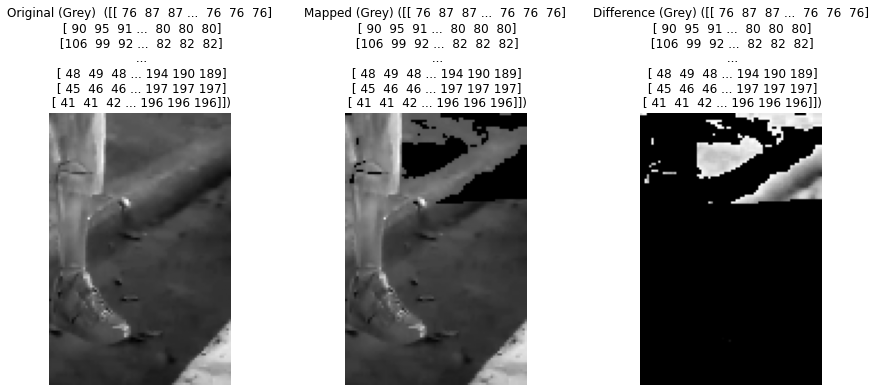

Modified Pixels for 446_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 0
  Index: 1, Pixel: (0, 1), Original: 87, Mapped: 87, New: 0
  Index: 2, Pixel: (0, 2), Original: 87, Mapped: 87, New: 0
  Index: 3, Pixel: (0, 42), Original: 87, Mapped: 87, New: 0
  Index: 4, Pixel: (0, 43), Original: 81, Mapped: 81, New: 0
  Index: 5, Pixel: (0, 44), Original: 83, Mapped: 83, New: 0
  Index: 6, Pixel: (0, 45), Original: 83, Mapped: 83, New: 0
  Index: 7, Pixel: (0, 46), Original: 83, Mapped: 83, New: 0
  Index: 8, Pixel: (0, 47), Original: 80, Mapped: 80, New: 0
  Index: 9, Pixel: (0, 48), Original: 70, Mapped: 70, New: 0
  Index: 10, Pixel: (0, 49), Original: 70, Mapped: 70, New: 0
  Index: 11, Pixel: (0, 50), Original: 82, Mapped: 82, New: 0
  Index: 12, Pixel: (0, 51), Original: 84, Mapped: 84, New: 0
  Index: 13, Pixel: (0, 52), Original: 80, Mapped: 80, New: 0
  Index: 14, Pixel: (0, 53), Original: 81, Mapped: 81, New: 0
  Index: 15, Pixel: (0, 54), Original: 81, Mapp

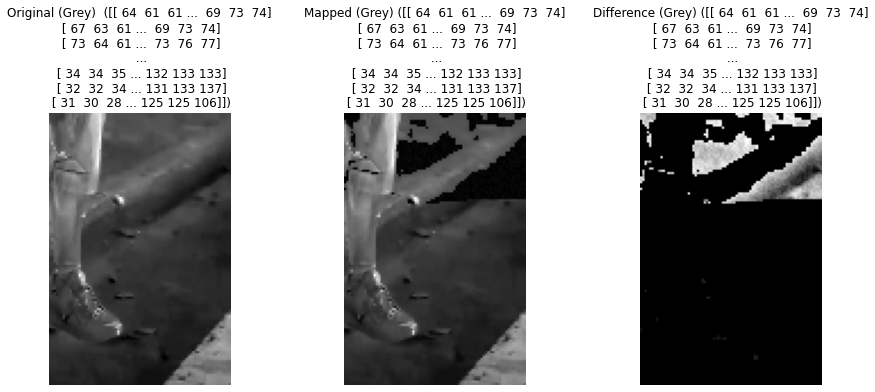

Modified Pixels for 447_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 64, Mapped: 64, New: 8
  Index: 1, Pixel: (0, 1), Original: 61, Mapped: 61, New: 7
  Index: 2, Pixel: (0, 2), Original: 61, Mapped: 61, New: 6
  Index: 3, Pixel: (0, 3), Original: 61, Mapped: 61, New: 2
  Index: 4, Pixel: (0, 4), Original: 57, Mapped: 57, New: 1
  Index: 5, Pixel: (0, 5), Original: 52, Mapped: 52, New: 1
  Index: 6, Pixel: (0, 6), Original: 56, Mapped: 56, New: 4
  Index: 7, Pixel: (0, 42), Original: 74, Mapped: 74, New: 1
  Index: 8, Pixel: (0, 43), Original: 70, Mapped: 70, New: 3
  Index: 9, Pixel: (0, 44), Original: 69, Mapped: 69, New: 1
  Index: 10, Pixel: (0, 45), Original: 68, Mapped: 68, New: 9
  Index: 11, Pixel: (0, 46), Original: 72, Mapped: 72, New: 2
  Index: 12, Pixel: (0, 47), Original: 74, Mapped: 74, New: 6
  Index: 13, Pixel: (0, 54), Original: 71, Mapped: 71, New: 7
  Index: 14, Pixel: (0, 55), Original: 68, Mapped: 68, New: 2
  Index: 15, Pixel: (0, 56), Original: 69, Mapped: 6

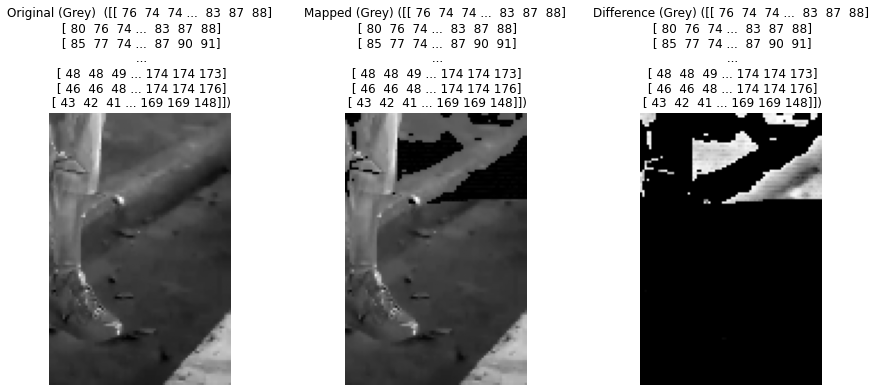

Modified Pixels for 447_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 4
  Index: 1, Pixel: (0, 1), Original: 74, Mapped: 74, New: 2
  Index: 2, Pixel: (0, 2), Original: 74, Mapped: 74, New: 0
  Index: 3, Pixel: (0, 3), Original: 74, Mapped: 74, New: 2
  Index: 4, Pixel: (0, 4), Original: 73, Mapped: 73, New: 4
  Index: 5, Pixel: (0, 5), Original: 67, Mapped: 67, New: 5
  Index: 6, Pixel: (0, 6), Original: 71, Mapped: 71, New: 4
  Index: 7, Pixel: (0, 42), Original: 86, Mapped: 86, New: 2
  Index: 8, Pixel: (0, 43), Original: 83, Mapped: 83, New: 0
  Index: 9, Pixel: (0, 44), Original: 82, Mapped: 82, New: 2
  Index: 10, Pixel: (0, 45), Original: 83, Mapped: 83, New: 4
  Index: 11, Pixel: (0, 46), Original: 86, Mapped: 86, New: 6
  Index: 12, Pixel: (0, 54), Original: 86, Mapped: 86, New: 7
  Index: 13, Pixel: (0, 55), Original: 83, Mapped: 83, New: 6
  Index: 14, Pixel: (0, 56), Original: 83, Mapped: 83, New: 5
  Index: 15, Pixel: (0, 57), Original: 83, Mapped:

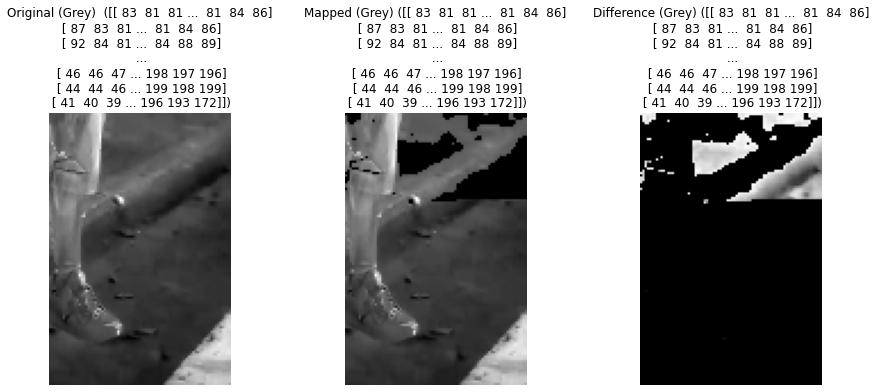

Modified Pixels for 447_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 83, Mapped: 83, New: 0
  Index: 1, Pixel: (0, 1), Original: 81, Mapped: 81, New: 0
  Index: 2, Pixel: (0, 2), Original: 81, Mapped: 81, New: 0
  Index: 3, Pixel: (0, 3), Original: 81, Mapped: 81, New: 0
  Index: 4, Pixel: (0, 4), Original: 82, Mapped: 82, New: 0
  Index: 5, Pixel: (0, 5), Original: 76, Mapped: 76, New: 0
  Index: 6, Pixel: (0, 6), Original: 80, Mapped: 80, New: 0
  Index: 7, Pixel: (0, 43), Original: 81, Mapped: 81, New: 0
  Index: 8, Pixel: (0, 44), Original: 77, Mapped: 77, New: 0
  Index: 9, Pixel: (0, 45), Original: 76, Mapped: 76, New: 0
  Index: 10, Pixel: (0, 46), Original: 81, Mapped: 81, New: 0
  Index: 11, Pixel: (0, 47), Original: 83, Mapped: 83, New: 0
  Index: 12, Pixel: (0, 48), Original: 84, Mapped: 84, New: 0
  Index: 13, Pixel: (0, 49), Original: 84, Mapped: 84, New: 0
  Index: 14, Pixel: (0, 50), Original: 84, Mapped: 84, New: 0
  Index: 15, Pixel: (0, 51), Original: 84, Mapped: 

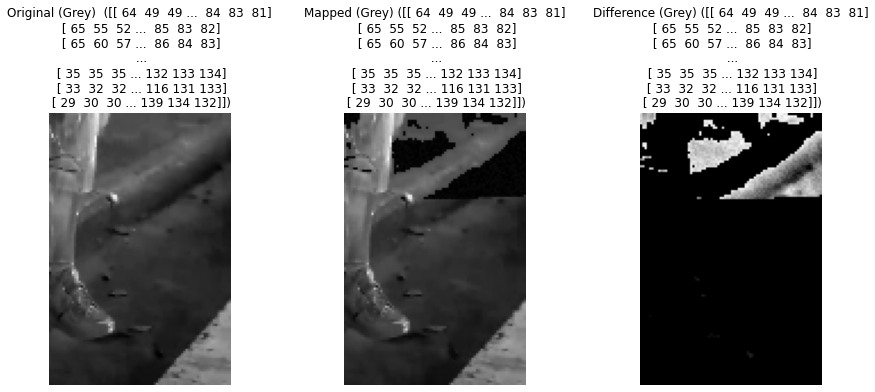

Modified Pixels for 448_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 64, Mapped: 64, New: 1
  Index: 1, Pixel: (0, 1), Original: 49, Mapped: 49, New: 8
  Index: 2, Pixel: (0, 2), Original: 49, Mapped: 49, New: 5
  Index: 3, Pixel: (0, 3), Original: 57, Mapped: 57, New: 4
  Index: 4, Pixel: (0, 4), Original: 55, Mapped: 55, New: 4
  Index: 5, Pixel: (0, 5), Original: 51, Mapped: 51, New: 9
  Index: 6, Pixel: (0, 6), Original: 65, Mapped: 65, New: 5
  Index: 7, Pixel: (0, 52), Original: 69, Mapped: 69, New: 0
  Index: 8, Pixel: (0, 53), Original: 67, Mapped: 67, New: 6
  Index: 9, Pixel: (0, 54), Original: 67, Mapped: 67, New: 9
  Index: 10, Pixel: (0, 55), Original: 68, Mapped: 68, New: 2
  Index: 11, Pixel: (0, 56), Original: 69, Mapped: 69, New: 4
  Index: 12, Pixel: (0, 57), Original: 74, Mapped: 74, New: 5
  Index: 13, Pixel: (0, 60), Original: 74, Mapped: 74, New: 4
  Index: 14, Pixel: (0, 61), Original: 73, Mapped: 73, New: 1
  Index: 15, Pixel: (0, 62), Original: 73, Mapped: 7

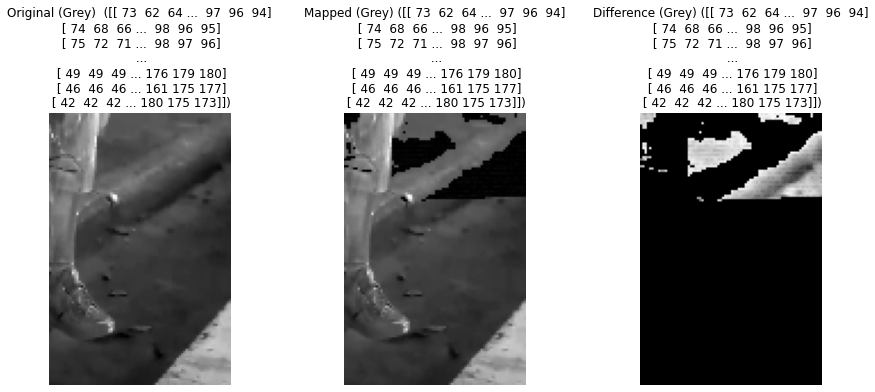

Modified Pixels for 448_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 73, Mapped: 73, New: 0
  Index: 1, Pixel: (0, 1), Original: 62, Mapped: 62, New: 2
  Index: 2, Pixel: (0, 2), Original: 64, Mapped: 64, New: 5
  Index: 3, Pixel: (0, 3), Original: 70, Mapped: 70, New: 2
  Index: 4, Pixel: (0, 4), Original: 71, Mapped: 71, New: 6
  Index: 5, Pixel: (0, 5), Original: 66, Mapped: 66, New: 7
  Index: 6, Pixel: (0, 6), Original: 80, Mapped: 80, New: 5
  Index: 7, Pixel: (0, 52), Original: 85, Mapped: 85, New: 1
  Index: 8, Pixel: (0, 53), Original: 82, Mapped: 82, New: 4
  Index: 9, Pixel: (0, 54), Original: 82, Mapped: 82, New: 1
  Index: 10, Pixel: (0, 55), Original: 82, Mapped: 82, New: 6
  Index: 11, Pixel: (0, 56), Original: 83, Mapped: 83, New: 0
  Index: 12, Pixel: (0, 57), Original: 86, Mapped: 86, New: 2
  Index: 13, Pixel: (0, 58), Original: 86, Mapped: 86, New: 1
  Index: 14, Pixel: (0, 59), Original: 86, Mapped: 86, New: 7
  Index: 15, Pixel: (0, 60), Original: 87, Mapped:

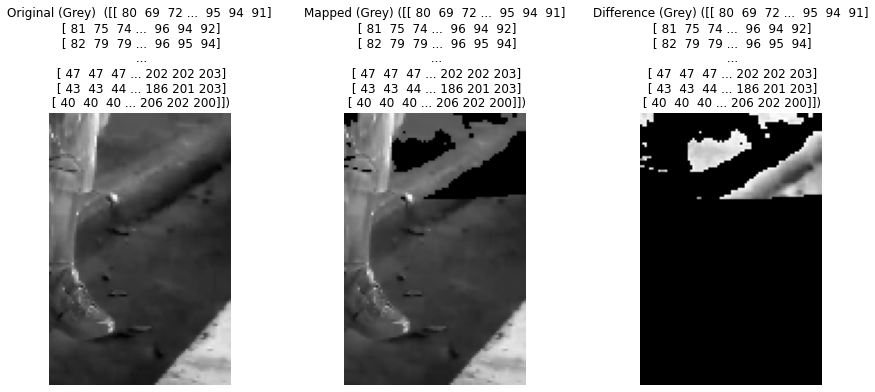

Modified Pixels for 448_Blue_Right:
  Index: 0, Pixel: (0, 0), Original: 80, Mapped: 80, New: 0
  Index: 1, Pixel: (0, 1), Original: 69, Mapped: 69, New: 0
  Index: 2, Pixel: (0, 2), Original: 72, Mapped: 72, New: 0
  Index: 3, Pixel: (0, 3), Original: 80, Mapped: 80, New: 0
  Index: 4, Pixel: (0, 4), Original: 79, Mapped: 79, New: 0
  Index: 5, Pixel: (0, 5), Original: 75, Mapped: 75, New: 0
  Index: 6, Pixel: (0, 48), Original: 85, Mapped: 85, New: 0
  Index: 7, Pixel: (0, 49), Original: 84, Mapped: 84, New: 0
  Index: 8, Pixel: (0, 50), Original: 84, Mapped: 84, New: 0
  Index: 9, Pixel: (0, 51), Original: 84, Mapped: 84, New: 0
  Index: 10, Pixel: (0, 52), Original: 78, Mapped: 78, New: 0
  Index: 11, Pixel: (0, 53), Original: 75, Mapped: 75, New: 0
  Index: 12, Pixel: (0, 54), Original: 75, Mapped: 75, New: 0
  Index: 13, Pixel: (0, 55), Original: 77, Mapped: 77, New: 0
  Index: 14, Pixel: (0, 56), Original: 78, Mapped: 78, New: 0
  Index: 15, Pixel: (0, 57), Original: 84, Mapped:

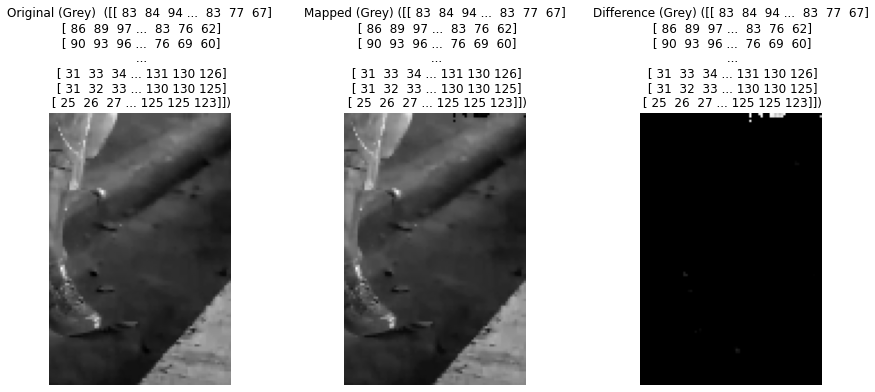

Modified Pixels for 449_Red_Right:
  Index: 0, Pixel: (0, 48), Original: 74, Mapped: 74, New: 3
  Index: 1, Pixel: (0, 52), Original: 74, Mapped: 74, New: 7
  Index: 2, Pixel: (0, 53), Original: 73, Mapped: 73, New: 2
  Index: 3, Pixel: (0, 57), Original: 73, Mapped: 73, New: 0
  Index: 4, Pixel: (0, 58), Original: 70, Mapped: 70, New: 0
  Index: 5, Pixel: (0, 59), Original: 65, Mapped: 65, New: 9
  Index: 6, Pixel: (0, 60), Original: 69, Mapped: 69, New: 6
  Index: 7, Pixel: (0, 61), Original: 63, Mapped: 63, New: 8
  Index: 8, Pixel: (0, 62), Original: 67, Mapped: 67, New: 6
  Index: 9, Pixel: (0, 63), Original: 74, Mapped: 74, New: 5
  Index: 10, Pixel: (1, 48), Original: 74, Mapped: 74, New: 1
  Index: 11, Pixel: (1, 53), Original: 74, Mapped: 74, New: 5
  Index: 12, Pixel: (1, 57), Original: 74, Mapped: 74, New: 4
  Index: 13, Pixel: (1, 58), Original: 71, Mapped: 71, New: 3
  Index: 14, Pixel: (1, 59), Original: 66, Mapped: 66, New: 7
  Index: 15, Pixel: (1, 60), Original: 69, Ma

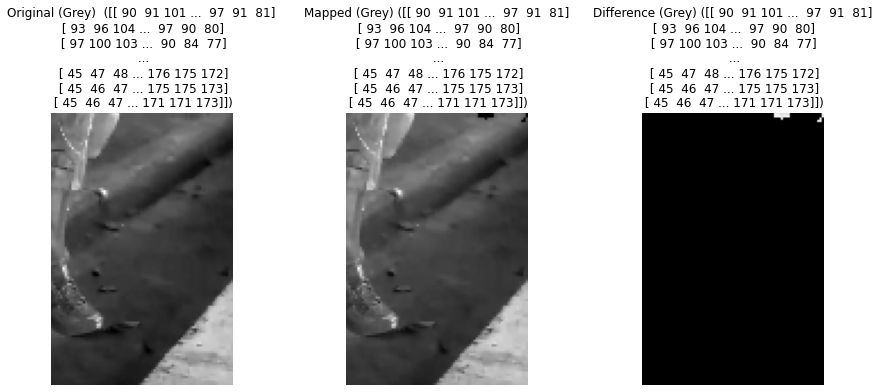

Modified Pixels for 449_Green_Right:
  Index: 0, Pixel: (0, 58), Original: 84, Mapped: 84, New: 1
  Index: 1, Pixel: (0, 59), Original: 79, Mapped: 79, New: 1
  Index: 2, Pixel: (0, 60), Original: 83, Mapped: 83, New: 7
  Index: 3, Pixel: (0, 61), Original: 77, Mapped: 77, New: 5
  Index: 4, Pixel: (0, 62), Original: 78, Mapped: 78, New: 1
  Index: 5, Pixel: (0, 63), Original: 80, Mapped: 80, New: 6
  Index: 6, Pixel: (0, 64), Original: 83, Mapped: 83, New: 9
  Index: 7, Pixel: (0, 79), Original: 81, Mapped: 81, New: 0
  Index: 8, Pixel: (2, 61), Original: 86, Mapped: 86, New: 9
  Index: 9, Pixel: (2, 78), Original: 84, Mapped: 84, New: 8
  Index: 10, Pixel: (1, 58), Original: 85, Mapped: 85, New: 1
  Index: 11, Pixel: (1, 59), Original: 80, Mapped: 80, New: 0
  Index: 12, Pixel: (1, 60), Original: 83, Mapped: 83, New: 0
  Index: 13, Pixel: (1, 61), Original: 77, Mapped: 77, New: 1
  Index: 14, Pixel: (1, 62), Original: 79, Mapped: 79, New: 2
  Index: 15, Pixel: (1, 63), Original: 81, 

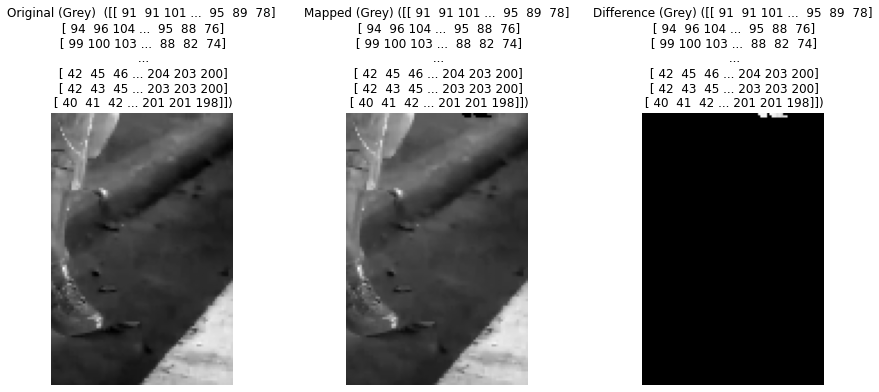

Modified Pixels for 449_Blue_Right:
  Index: 0, Pixel: (0, 51), Original: 84, Mapped: 84, New: 0
  Index: 1, Pixel: (0, 52), Original: 83, Mapped: 83, New: 0
  Index: 2, Pixel: (0, 53), Original: 82, Mapped: 82, New: 0
  Index: 3, Pixel: (0, 54), Original: 84, Mapped: 84, New: 0
  Index: 4, Pixel: (0, 56), Original: 86, Mapped: 86, New: 0
  Index: 5, Pixel: (0, 57), Original: 82, Mapped: 82, New: 0
  Index: 6, Pixel: (0, 58), Original: 80, Mapped: 80, New: 0
  Index: 7, Pixel: (0, 59), Original: 74, Mapped: 74, New: 0
  Index: 8, Pixel: (0, 60), Original: 78, Mapped: 78, New: 0
  Index: 9, Pixel: (0, 61), Original: 73, Mapped: 73, New: 0
  Index: 10, Pixel: (1, 52), Original: 85, Mapped: 85, New: 0
  Index: 11, Pixel: (1, 53), Original: 83, Mapped: 83, New: 0
  Index: 12, Pixel: (1, 54), Original: 85, Mapped: 85, New: 1
  Index: 13, Pixel: (1, 57), Original: 83, Mapped: 83, New: 1
  Index: 14, Pixel: (1, 58), Original: 81, Mapped: 81, New: 1
  Index: 15, Pixel: (1, 59), Original: 75, M

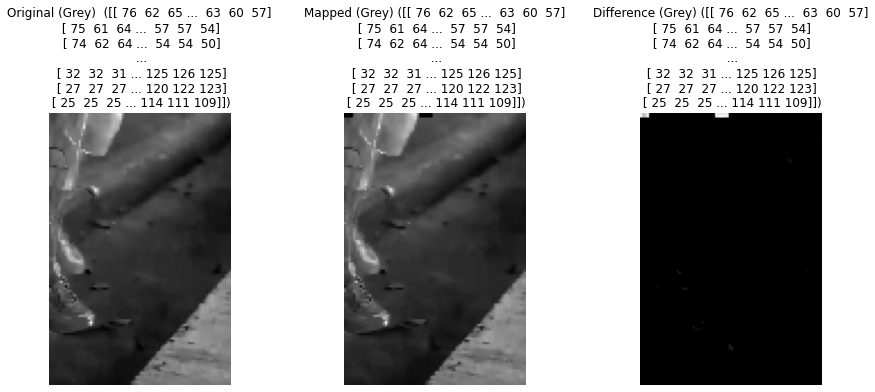

Modified Pixels for 450_Red_Right:
  Index: 0, Pixel: (0, 0), Original: 76, Mapped: 76, New: 3
  Index: 1, Pixel: (0, 1), Original: 62, Mapped: 62, New: 7
  Index: 2, Pixel: (0, 2), Original: 65, Mapped: 65, New: 2
  Index: 3, Pixel: (0, 3), Original: 73, Mapped: 73, New: 0
  Index: 4, Pixel: (0, 33), Original: 76, Mapped: 76, New: 0
  Index: 5, Pixel: (0, 34), Original: 76, Mapped: 76, New: 9
  Index: 6, Pixel: (0, 35), Original: 76, Mapped: 76, New: 6
  Index: 7, Pixel: (0, 36), Original: 76, Mapped: 76, New: 8
  Index: 8, Pixel: (0, 37), Original: 76, Mapped: 76, New: 6
  Index: 9, Pixel: (0, 38), Original: 76, Mapped: 76, New: 5
  Index: 10, Pixel: (1, 0), Original: 75, Mapped: 75, New: 1
  Index: 11, Pixel: (1, 1), Original: 61, Mapped: 61, New: 5
  Index: 12, Pixel: (1, 2), Original: 64, Mapped: 64, New: 4
  Index: 13, Pixel: (1, 3), Original: 73, Mapped: 73, New: 3
  Index: 14, Pixel: (1, 33), Original: 76, Mapped: 76, New: 7
  Index: 15, Pixel: (1, 34), Original: 76, Mapped: 76

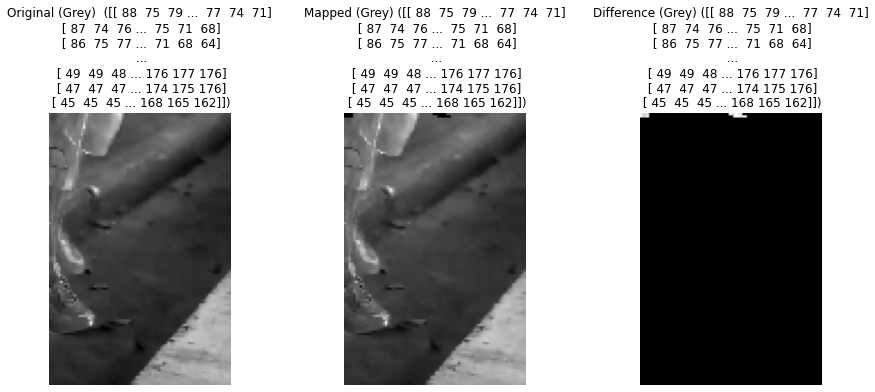

Modified Pixels for 450_Green_Right:
  Index: 0, Pixel: (0, 0), Original: 88, Mapped: 88, New: 1
  Index: 1, Pixel: (0, 1), Original: 75, Mapped: 75, New: 1
  Index: 2, Pixel: (0, 2), Original: 79, Mapped: 79, New: 7
  Index: 3, Pixel: (0, 3), Original: 87, Mapped: 87, New: 5
  Index: 4, Pixel: (0, 39), Original: 89, Mapped: 89, New: 1
  Index: 5, Pixel: (0, 40), Original: 89, Mapped: 89, New: 6
  Index: 6, Pixel: (0, 41), Original: 88, Mapped: 88, New: 9
  Index: 7, Pixel: (0, 42), Original: 89, Mapped: 89, New: 0
  Index: 8, Pixel: (0, 43), Original: 88, Mapped: 88, New: 9
  Index: 9, Pixel: (0, 44), Original: 85, Mapped: 85, New: 8
  Index: 10, Pixel: (1, 0), Original: 87, Mapped: 87, New: 1
  Index: 11, Pixel: (1, 1), Original: 74, Mapped: 74, New: 0
  Index: 12, Pixel: (1, 2), Original: 76, Mapped: 76, New: 0
  Index: 13, Pixel: (1, 3), Original: 86, Mapped: 86, New: 1
  Index: 14, Pixel: (1, 41), Original: 89, Mapped: 89, New: 2
  Index: 15, Pixel: (1, 42), Original: 89, Mapped: 

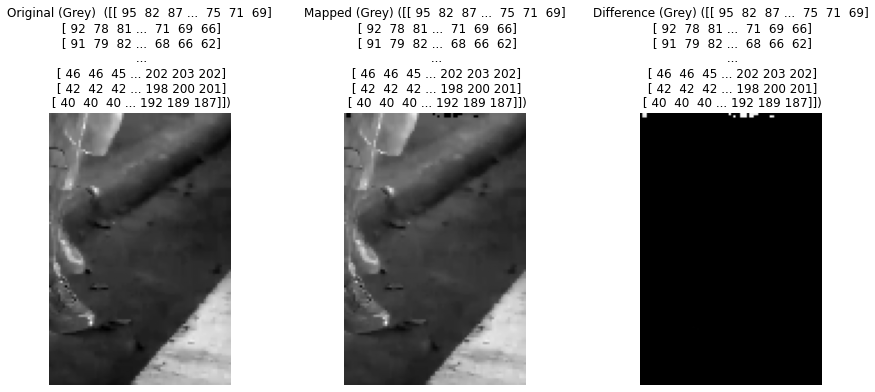

Modified Pixels for 450_Blue_Right:
  Index: 0, Pixel: (0, 1), Original: 82, Mapped: 82, New: 0
  Index: 1, Pixel: (0, 2), Original: 87, Mapped: 87, New: 0
  Index: 2, Pixel: (0, 39), Original: 89, Mapped: 89, New: 0
  Index: 3, Pixel: (0, 44), Original: 88, Mapped: 88, New: 0
  Index: 4, Pixel: (0, 45), Original: 88, Mapped: 88, New: 0
  Index: 5, Pixel: (0, 46), Original: 89, Mapped: 89, New: 0
  Index: 6, Pixel: (0, 48), Original: 86, Mapped: 86, New: 0
  Index: 7, Pixel: (0, 49), Original: 84, Mapped: 84, New: 0
  Index: 8, Pixel: (0, 50), Original: 84, Mapped: 84, New: 0
  Index: 9, Pixel: (0, 51), Original: 84, Mapped: 84, New: 0
  Index: 10, Pixel: (1, 1), Original: 78, Mapped: 78, New: 0
  Index: 11, Pixel: (1, 2), Original: 81, Mapped: 81, New: 0
  Index: 12, Pixel: (1, 41), Original: 89, Mapped: 89, New: 1
  Index: 13, Pixel: (1, 44), Original: 88, Mapped: 88, New: 1
  Index: 14, Pixel: (1, 45), Original: 88, Mapped: 88, New: 1
  Index: 15, Pixel: (1, 46), Original: 89, Mappe

In [176]:
#Map pixels between 0-9 to 10
encoded_results = 'encoded_results'
def map_to_10_levels(image):

    """Maps pixel values 0-9 to 10 levels (0-255)."""
    #mapped_image = np.where(image <= 9, 10, image)
    mapped_image = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            if image[i,j] <= 9:
                mapped_image[i,j]=10
            else:
                mapped_image[i,j]=image[i,j]
    return mapped_image.astype(np.uint8)

#pixels of value 10 and unique values used to embed audio
def encode_values(gray_mapped_image, num_values, results_folder, image_name, values):
    """Encodes num_values random values (0-9) into pixels, prioritizing value 10, then the next lowest values.
    Saves unique_values and selected_pixels as .npy files, and the modified image as a .png file in the results folder."""
    if not os.path.exists(encoded_results):
        os.makedirs(encoded_results)
    
    # Check if num_values is less than or equal to the total number of pixels in the image
    total_pixels = gray_mapped_image.size
    if num_values > total_pixels:
        raise ValueError(f"num_values ({num_values}) exceeds the total number of pixels in the image ({total_pixels}).")

    # Initialize the list of candidate pixels
    candidate_pixels = []

    # Start with pixels of value 10
    pixels_10 = np.where(gray_mapped_image == 10)
    pixels_10_indices = list(zip(pixels_10[0], pixels_10[1]))
    pixels_10_indices.sort()  # Sort by row index, then column index
    candidate_pixels.extend(pixels_10_indices)

    # Create a list of unique pixel values in the image (excluding value 10)
    unique_values = np.unique(gray_mapped_image)
    unique_values = unique_values[unique_values != 10]  # Exclude value 10
    unique_values.sort()  # Sort from lowest to highest

    # If we still need more pixels, find the next lowest values
    if len(candidate_pixels) < num_values:
        # Iterate through the sorted unique values and add their pixels to the candidate list
        for value in unique_values:
            if len(candidate_pixels) >= num_values:
                break  # Stop if we have enough candidates

            # Find pixels with the current value
            value_pixels = np.where(gray_mapped_image == value)
            value_pixels_indices = list(zip(value_pixels[0], value_pixels[1]))
            value_pixels_indices.sort()  # Sort by row index, then column index
            candidate_pixels.extend(value_pixels_indices)

    # Select the first num_values pixels from the sorted candidate list
    selected_pixels = candidate_pixels[:num_values]
    selected_pixels.sort()

    # Save selected_pixels as a .npy file with the image name
    selected_pixels_path = os.path.join(encoded_results, f"{image_name}_selected_pixels.npy")
    np.save(selected_pixels_path, selected_pixels)
    print(f"Selected pixels saved to: {selected_pixels_path}")

    # Encode random values into the selected pixels
    encoded_image = gray_mapped_image.copy()
    modified_pixels = []
    test_values=[]
    
    count = 0
    while count < len(values):
        for pixel in selected_pixels:    
            if pixel[0]%2==0:
                encoded_image[pixel] = values[count][0]
                modified_pixels.append((pixel, values[count][0]))
                test_values.append(values[count][0])
                count+=1
            if count == len(values):
                break
                
            
    count = 0
    while count < len(values):
        for pixel in selected_pixels:
            if pixel[0]%2!=0:
                encoded_image[pixel] = values[count][1]
                modified_pixels.append((pixel, values[count][1]))
                test_values.append(values[count][1])
                count+=1
            if count == len(values):
                break

    # Save unique_values as a .npy file with the image name
    unique_values_path = os.path.join(encoded_results, f"{image_name}_unique_test_values.npy")
    np.save(unique_values_path, np.asarray(test_values))
    print(test_values)
    print(f"Unique values saved to: {unique_values_path}")

    # Save the modified (encoded) image as a PNG file
    encoded_image_path = os.path.join(encoded_results, f"{image_name}_encoded.png")
    cv2.imwrite(encoded_image_path, encoded_image)
    print(f"Encoded image saved to: {encoded_image_path}")

    return encoded_image, modified_pixels

def display_images_and_diff(image, num_values, values, image_name):
    """Displays the original, modified, and difference images in grayscale and saves the remapped image."""

    mapped_image = map_to_10_levels(image)
    
    try:
        encoded_image, modified_pixels = encode_values(mapped_image, num_values, encoded_results, image_name,values)
    except ValueError as e:
        print(e)
        return
        
    diff_image = cv2.absdiff(image, encoded_image)


    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title(f'Original (Grey)  ({image})')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(encoded_image, cmap='gray')
    plt.title(f'Mapped (Grey) ({image})')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(diff_image, cmap='gray')
    plt.title(f'Difference (Grey) ({image})')
    plt.axis('off')

    plt.show()

    # Print modified pixels
    print(f"Modified Pixels for {image_name}:")
    for index, (pixel, value) in enumerate(modified_pixels):
        original_value = image[pixel]
        mapped_value = mapped_image[pixel]
        print(f"  Index: {index}, Pixel: {pixel}, Original: {original_value}, Mapped: {mapped_value}, New: {value}")
    
side = ['Left', 'Right']
size = sample_rate//30
sound_data = [left, right]
for direction in range(len(sound_data)):
    for frame in range(420,451): 
        for colour in range(len(colours)):
            image, test_vector = reading_frames(float(frame), colour)
            height, width = test_vector.shape
            if direction == 0:
                test_vector = test_vector[:, :width // 2] 
            else:
                test_vector = test_vector[:, width // 2:]
        
            samples = sound_data[direction]
            #The chunk per frame
            chunk = (frame+1) - 420
            if chunk == 1:
                samples = samples[:size]
            elif chunk == 30:
                samples = samples[size*30:]
            else:
                samples = samples[size*(chunk-1):size*chunk]
    
            #Making audios all the same size
            encoded, values = process_samples(samples)
            
            np.save(os.path.join(results_audio, f"chunk{chunk}_encoded_{side[direction]}.npy"), encoded)
            print(f"Encoded audio saved to 'chunk{chunk}_encoded_{side[direction]}.npy'.")
            np.save(os.path.join(results_audio, f"chunk{chunk}_neuron_values_{side[direction]}.npy"), values)
            print(f"Encoded audio saved to 'chunk{chunk}_neuron_values_{side[direction]}.npy'.")
            #image name to save files
            image_name = f'{frame}_{colours[colour]}_{side[direction]}'
            #Seperating frequency into colours
            val=[]
            for i in values:
                if colour == 0:
                    i=i[0:2]
                    val.append(i)
                elif colour == 1:
                    i=i[2:4]
                    val.append(i)
                elif colour == 2:
                    i=i[4:6]
                    val.append(i)
            
            #Function to encode and see difference
            #Num values is samplerate/amount of frames * 2 for left and right audio * 6 for each digit
            display_images_and_diff(test_vector, int(2*(sample_rate/30)*6),val, image_name)
        


Processing image: 431.0:Red


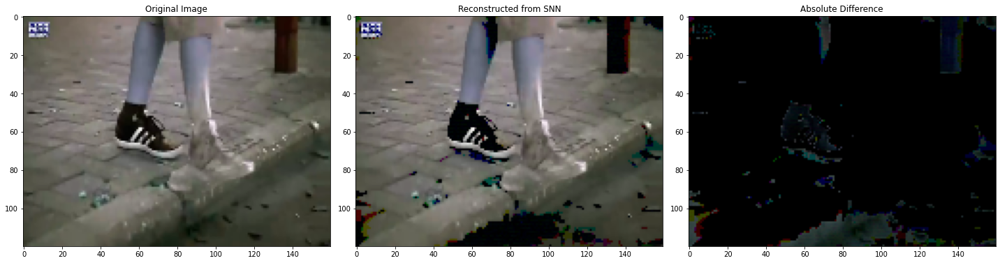

In [167]:
#Checking what encoded image looks like when putting left ad right side and 3 colours back together
image, test_vector = reading_frames(float(431), 0)

red_left = cv2.imread(f'encoded_results/{431}_Red_Left_encoded.png', cv2.COLOR_BGR2GRAY) 
green_left = cv2.imread(f'encoded_results/{431}_Green_Left_encoded.png', cv2.COLOR_BGR2GRAY)
blue_left = cv2.imread(f'encoded_results/{431}_Blue_Left_encoded.png', cv2.COLOR_BGR2GRAY)
red_right = cv2.imread(f'encoded_results/{431}_Red_Right_encoded.png', cv2.COLOR_BGR2GRAY) 
green_right = cv2.imread(f'encoded_results/{431}_Green_Right_encoded.png', cv2.COLOR_BGR2GRAY)
blue_right = cv2.imread(f'encoded_results/{431}_Blue_Right_encoded.png', cv2.COLOR_BGR2GRAY)

reconstructed_left_image = np.concatenate((red_left[..., np.newaxis], 
                                      green_left[..., np.newaxis], 
                                      blue_left[..., np.newaxis]), 
                                      axis=-1)

reconstructed_right_image = np.concatenate((red_right[..., np.newaxis], 
                                      green_right[..., np.newaxis], 
                                      blue_right[..., np.newaxis]), 
                                      axis=-1)

recombined_image = np.hstack((reconstructed_left_image, reconstructed_right_image))
    
# Calculate the difference between original and reconstructed images
diff_image = np.abs(image.astype(np.int16) - recombined_image.astype(np.int16)).astype(np.uint8)

# Plot the original, reconstructed, and difference images
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axes[0].imshow(image)
axes[0].set_title("Original Image")
recombined_image = cv2.cvtColor(recombined_image, cv2.COLOR_RGB2BGR)
axes[1].imshow(recombined_image)
axes[1].set_title("Reconstructed from SNN")
axes[2].imshow(diff_image)
axes[2].set_title("Absolute Difference")
plt.tight_layout()
plt.show()

The code below processes a series of image frames which have audio encoded into them, converting them into spiking neural network (SNN) activity. It iterates through frames, colors, and audio directions, loading encoded grayscale images. For each image, it maps pixel values to pre-defined spiking patterns and corresponding currents, storing these mappings. It then sets up a NEST simulation, creating an input neuron layer with noise injection via Poisson generators. The code assigns currents to neurons based on the image's pixel values and schedules spikes according to the mapped spiking patterns. The simulation is run, and the resulting spike events are recorded and saved. Finally, it prints the number of spikes recorded in each layer and the total simulation time, effectively transforming visual information into a temporal spike representation within a neural network.

In [168]:
encoded_data = 'encoded_data'
#Converting the frames into spike patterns
unique_patterns_dict_for_frame=np.load("results/unique_spiking_patterns_for_frame.npy", allow_pickle=True).item()
currents_vector_for_frame=np.load("results/currents_vector_for_frame.npy")
sim_length = 128
results_frames = 'results_frames'

#420 to 450 is the frames within 14 and 15 seconds
for direction in range(len(sound_data)):
    for frame in range(420,451): 
        for colour in range(len(colours)):
            image_name = f'{frame}_{colours[colour]}_{side[direction]}'
            image_path = os.path.join(encoded_results, f'{image_name}_encoded.png') 
            try:
                image = cv2.imread(image_path, cv2.COLOR_BGR2GRAY)
                if image is None:
                    raise FileNotFoundError(f"Error: Could not read image file: {image_path}")
                image = cv2.resize(image, (target_size[1], target_size[0]))
                print(f"\nProcessing image: {frame}:{colours[colour]}")
            except FileNotFoundError as e:
                print(e)
            except Exception as e:
                print(f"An error occurred while processing {number}: {e}")
                
            # Encoding Phase
            print("Starting encoding image...")
            start_encoding = time.time()
            mapped_spike_patterns = np.empty(image.shape, dtype=object)
            mapped_currents = np.zeros(image.shape[0:2], dtype=np.float32)
            
            for i in range(image.shape[0]):
                for j in range(image.shape[1]):
                    pixel_value = image[i, j]
                    mapped_spike_patterns[i, j] = unique_patterns_dict_for_frame.get(pixel_value, [])
                    mapped_currents[i, j] = currents_vector_for_frame[pixel_value]
            end_encoding = time.time()
            encoding_time = end_encoding - start_encoding
            print(f"Encoding Time: {encoding_time:.4f} seconds")
    
            np.save(os.path.join(encoded_data, f"mapped_spiking_pattern_{image_name}.npy"), mapped_spike_patterns)
            np.save(os.path.join(encoded_data, f"mapped_currents_{image_name}.npy"), mapped_currents)
            
    
            print("Simulation started...")
            start_simulation = time.time()
            nest.ResetKernel()
            nest.set_verbosity("M_WARNING")
            
            num_neurons = image.size
            
            # Create neuron populations
            neuron_populations = {
                "input_layer": nest.Create("iaf_psc_alpha", num_neurons, params={"V_th": -10., "V_reset": -80}),
            }
            for layer in neuron_populations.values():
                    nest.SetStatus(layer, {"I_e": 300.0})
    
                
            #Adding noise using poisson generator
            noise_ex = nest.Create("poisson_generator",3, {'rate':10000.0})
            #Connection parameters
            syn_dict_ex = {"weight": 1.2}
            #Connecting the noise to layer 1 to 2
            nest.Connect(noise_ex, neuron_populations['input_layer'], syn_spec=syn_dict_ex)
    
            
            # Create spike recorders for all neuron populations
            spike_recorders = {layer: nest.Create("spike_recorder") for layer in neuron_populations}
            # Connect spike recorders to neuron populations
            for layer, recorder in spike_recorders.items():
                nest.Connect(neuron_populations[layer], recorder)
            
            
            for idx, current in np.ndenumerate(mapped_currents):
                neuron_id = np.ravel_multi_index(idx, image.shape)
                nest.SetStatus(neuron_populations['input_layer'][neuron_id], {"I_e": current})
            
        
            spike_times_all = []
            for idx, pattern in np.ndenumerate(mapped_spike_patterns):
                neuron_id = np.ravel_multi_index(idx, image.shape)
                for spike_time in pattern:
                    if spike_time < sim_length:
                        spike_times_all.append((spike_time, neuron_populations['input_layer'][neuron_id]))
            
            spike_times_all.sort(key=lambda x: x[0])
                
            current_time = 0.0
            for spike_time, neuron in spike_times_all:
                if spike_time > current_time:
                    nest.Simulate(spike_time - current_time)
                    current_time = spike_time
            
            if current_time < sim_length:
                nest.Simulate(sim_length - current_time)
            
            events = spike_recorders['input_layer'].get("events")
            spike_times = events["times"]
            senders = events["senders"]
            end_simulation = time.time()
            simulation_time = end_simulation - start_simulation

    
            np.save(os.path.join(results_frames, f"events_{image_name}.npy"), events)
    
            print('-----------------')
            print('Spike Activity')
            print('-----------------')
    
            for layer, recorder in spike_recorders.items():
                events = recorder.get("events")
                spike_times = events["times"] 
                print(f"Spikes recorded in {layer}: {len(spike_times)}")
    
            print(f'Finished simulating in {simulation_time:4f} seconds')
    


Processing image: 420:Red
Starting encoding image...
Encoding Time: 0.0497 seconds
Simulation started...
-----------------
Spike Activity
-----------------
Spikes recorded in input_layer: 113899
Finished simulating in 10.843132 seconds

Processing image: 420:Green
Starting encoding image...
Encoding Time: 0.0392 seconds
Simulation started...
-----------------
Spike Activity
-----------------
Spikes recorded in input_layer: 113854
Finished simulating in 11.293094 seconds

Processing image: 420:Blue
Starting encoding image...
Encoding Time: 0.0378 seconds
Simulation started...
-----------------
Spike Activity
-----------------
Spikes recorded in input_layer: 114224
Finished simulating in 10.222961 seconds

Processing image: 421:Red
Starting encoding image...
Encoding Time: 0.0352 seconds
Simulation started...
-----------------
Spike Activity
-----------------
Spikes recorded in input_layer: 113885
Finished simulating in 9.895859 seconds

Processing image: 421:Green
Starting encoding ima

The code below generates a raster plot visualizing spike activity from a neural network simulation. It iterates through red green and blue, loading spike event data for each color from a saved NumPy file. For each color, it extracts spike times and neuron IDs (senders) and plots them as vertical lines on a graph. The plot displays spike times against neuron IDs, with each color's spikes represented by a different colored line.

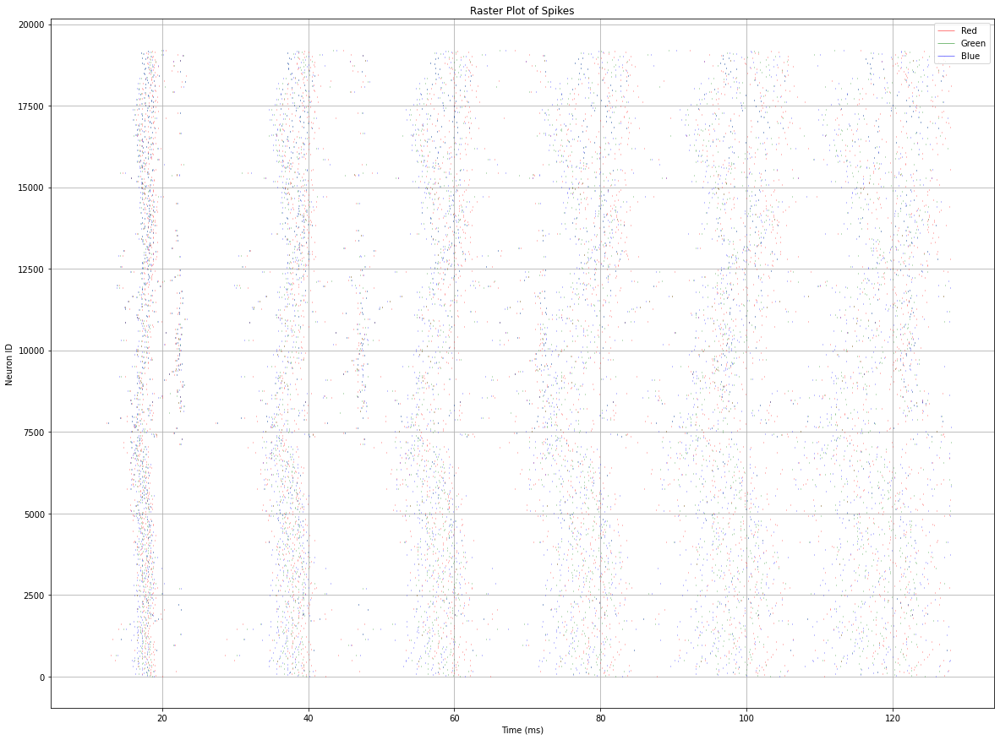

✅ Test completed in 6.765688180923462 seconds


In [174]:
#Visualising 1 raster plot with left side of the image with all 3 colours combined
start_rasterplot = time.time()
plt.figure(figsize=(20, 15))

for i in range(len(colours)):
    events = np.load(f"results_frames/events_{420}_{colours[i]}_Left.npy", allow_pickle=True).item()
    
    spike_time = events["times"]
    sender = events["senders"]
    plt.vlines(spike_time, sender - 0.5, sender + 0.5, colors=colours[i], label =colours[i],linewidth=0.5)

    plt.xlabel("Time (ms)")
    plt.ylabel("Neuron ID")
    plt.title("Raster Plot of Spikes")
    plt.grid(True)
    plt.legend()
plt.show()
    
end_rasterplot = time.time()
rasterplot_time = end_rasterplot-start_rasterplot
print(f"✅ Test completed in {rasterplot_time} seconds")

In [ ]:
#Saving each rasterplot for each frame
start_rasterplot = time.time()
plt.figure(figsize=(20, 15))

for direction in range(len(sound_data)):
    for frame in range(420,451):
        for colour in range(len(colours)):
            events = np.load(f"{results_frames}/events_{image_name}.npy", allow_pickle=True).item()
            
            spike_time = events["times"]
            sender = events["senders"]
            plt.vlines(spike_time, sender - 0.5, sender + 0.5, colors=colours[colour], label =colours[colour],linewidth=0.5)
        
            plt.xlabel("Time (ms)")
            plt.ylabel("Neuron ID")
            plt.title("Raster Plot of Spikes")
            plt.grid(True)
            plt.legend()
            plt.savefig(os.path.join(results_frames, f"raster_plot_{image_name}.png"))
        
        rasterplot_time = end_rasterplot-end_rasterplot
        print(f"Raster plot Time: {rasterplot_time:.4f} seconds")
        print(f"✅ Test completed for frame {frame}")

#Haven't saved the rest as not using to decode and system can't handle making all the raster plots

Raster plot Time: 0.0000 seconds
✅ Test completed for frame 420
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 421
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 422
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 423
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 424
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 425
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 426
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 427
Raster plot Time: 0.0000 seconds
✅ Test completed for frame 428


# The code above represents the effort and intellectual property of Ruth Amey. As an ethical principle, please respect this ownership and refrain from using, copying, or distributing this code without explicit permission.